In [18]:
import yfinance as yf
import pandas as pd
from prettytable import PrettyTable
from datetime import datetime, timedelta

# Function to check if a given date is a working day
def is_working_day(date_str):
    # Parse the date string to datetime format
    date_obj = datetime.strptime(date_str, '%Y-%m-%d')

    # Check if the date falls on a weekend (Saturday or Sunday)
    if date_obj.weekday() >= 5:
        return False

    # Check if the date falls on a special working day
    special_working_days = {"2024-01-27", "2024-03-02"}  # Example: Christmas Eve
    if date_str in special_working_days:
        return True

    # Check if the date falls on a holiday
    # Add your holiday logic here
    holidays = {"2023-01-26", "2023-03-07", "2023-03-30", "2023-04-04", "2023-04-07",
                "2023-04-14", "2023-05-01", "2023-06-29", "2023-07-29", "2023-08-15",
                "2023-09-19", "2023-10-02", "2023-10-24", "2023-11-14", "2023-11-27",
                "2023-12-25","2024-01-22",
                "2024-01-26", "2024-03-08", "2024-03-25", "2024-03-29", "2024-04-11",
                "2024-04-17", "2024-05-01", "2024-06-17", "2024-07-17", "2024-08-15",
                "2024-10-02", "2024-11-01", "2024-11-15", "2024-12-25"}
    if date_str in holidays:
        return False

    # If the date is not a weekend, holiday, or special working day, it's a regular working day
    return True

# Function to get the next working date if the provided date is not a working day
def get_next_working_date(date_str):
    # Parse the date string to datetime format
    date_obj = datetime.strptime(date_str, '%Y-%m-%d')

    # Check if the date is a working day
    if is_working_day(date_str):
        return date_obj

    # If the date is not a working day, find the next working date
    while True:
        date_obj += timedelta(days=1)
        if is_working_day(date_obj.strftime('%Y-%m-%d')):
            return date_obj

# Define start and end dates
start_date = '2021-01-14'
end_date = '2024-03-12'


# Path to the Excel file
# excel_file_path = "C:/Users/91908/Documents/Raja/Share market/Analysis/Trendlyne/Data/Bajel_Increased/MCAP31122023_mylist.xlsx"

excel_file_path = "C:/Users/91908/Documents/Raja/Share market/Analysis/Trendlyne/Data/Bajel_Increased/MinimalWatchList/Azure/MCAP/2024-02-13-multigroup.xlsx"


# Read the Excel file
df = pd.read_excel(excel_file_path)


df = df[ 

                    
                (df['Market Capitalization'] > 25)&
                # (df['Market Capitalization'] < 100)&

                (df['Long Term Debt To Equity Annual'] < 1) &

                # (df['FII holding current Qtr %'] > 0)&
                # (df['FII holding current Qtr %'] > 0)&
                # (df['Current Price'] > 750)&



                # ((df['PE TTM Price to Earnings'] * df['EPS Annual Rs']) > (2*df['Current Price Rs']) )& - misunderstood dont use

                (df['Price to Book Value']< 6 ) &
                # (df['Price to Book Value'] < df['Industry Price to Book TTM']) &
                # (df['PE TTM Price to Earnings'] > 0) & 
                (df['PE TTM Price to Earnings'] < 50) 
                # (df['EPS Qtr YoY Growth %'] < 1 )&
                # (df['PEG TTM PE to Growth'] <5 ) &

                # (df['Promoter holding pledge percentage % Qtr']< 1 ) & 
    
                
                # (df['Revenue QoQ Growth %'] > 0) &
                    # (df['Revenue Growth Qtr YoY %'] > 0) & 
                    # (df['Revenue Growth Qtr YoY %'] < 200) &
                    # (df['Total Revenue Qtr'] > df['Total Revenue 1Qtr ago']  )&
                    # (df['Total Revenue 1Qtr ago'] > df['Total Revenue 2Qtr'])
                # (df['Total Revenue 2Qtr Cr'] > df['Total Revenue 3Qtr Cr'])


                # (df['Net Cash Flow YoY Growth %'] < 1 )&

                # (df['Stock In PE Buy Zone'] < 1 )&
                # (df['Stock In PBV Buy Zone'] < 1 )&
                # (df['%Days traded below current PE Price to Earnings'] < 1 )&
                # (df['%Days traded below current Price to Book Value'] < 1 )&
                
                # (df['RSI'].notna() < 50 ) &
                # (df['% Distance from 52week high'] > 1) 

                ]

# Extract stock codes from the 'Symbol' column
# stock_codes = df['Symbol'].tolist()
stock_codes = df['NSE code'].tolist()

# print(stock_codes)

    # Result of (df['Price to Book Value']< 5 ) &     #             # (df['Price to Book Value'] < df['Industry Price to Book TTM']) &     #             (df['PE TTM Price to Earnings'] > 0) &     #             (df['PE TTM Price to Earnings'] < 40) & 

# Existing list of stock codes
existing_stock_codes = ['AGI', 'ASHOKA', 'BCLIND', 'BAJAJFINSV', 'CLSEL', 'CREDITACC', 'EKC', 'FIVESTAR', 'GEOJITFSL', 'HUDCO', 'JAGRAN', 'KOPRAN', 'MMFL', 'MOREPENLAB', 'NESCO', 'OMINFRAL', 'PFS', 'PARAGMILK', 'POCL', 'RBL', 'REDINGTON', 'BASF', 'BFINVEST', 'GICRE', 'IFGLEXPOR', 'INDIAGLYCO', 'INDRAMEDCO', 'JKTYRE', 'LINCOLN', 'MASTEK', 'GREENPOWER', 'PTC', 'RUSHIL']

other_stocks = ['IKIO', 'STOVEKRAFT', 'BIOCON','IDEAFORGE','SONACOMS','TATATECH','IKIO','TRACXN','NURECA','CARTRADE','BANDHANBNK','AFFLE','RELAXO','HESTERBIO','TVSSCS','TREL','WHIRLPOOL','DEEPAKFERT','ACLGATI','TANLA', 'KPIT','PGINVIT','TMB','GHCL']
other_stocks_two = ['SBICARD','FUSION','HMAAGRO','SBFC']

# ipo_stocks = [ 'CAPITALSFB', 'MUTHOOTMF','PARKHOTELS','MEDIASSIST','FEDFINA','JIOFIN']

# error_stocks = ['JSFB','PROPEQUITY']

# Concatenate the two lists
stock_codes = stock_codes + existing_stock_codes + other_stocks + other_stocks_two
# stock_codes = ['SONACOMS']
# stock_codes = stock_codes

# Print the combined list

# Define the error stocks to be removed
# weekly_tf_remove_stocks = ['COMSYN','MUTHOOTMF','TATATECH']

# # Remove error_stocks from stock_codes
# for stock in weekly_tf_remove_stocks:
#     if stock in stock_codes:
#         stock_codes.remove(stock)

# Print the updated stock_codes list
# print(stock_codes)
# print(len(stock_codes))


# Take the second 30 stocks -------------->>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>> latest 120220242114
selected_stock_codes = stock_codes[0:1000]
print(selected_stock_codes)



['20MICRONS', 'AGI', 'AICHAMP', 'AMDIND', 'AVG', 'AYMSYNTEX', 'AAKASH', 'AARTIDRUGS', 'AARTISURF', 'AAVAS', 'AHL', 'ACCURACY', 'ADROITINFO', 'AEGISCHEM', 'AGARIND', 'AIROLAM', 'AKSHAR', 'AKSHARCHEM', 'ALICON', 'ALLCARGO', 'ALOKINDS', 'AMNPLST', 'ANANTRAJ', 'ANMOL', 'AWHCL', 'APCOTEXIND', 'APOLSINHOT', 'APOLLOTYRE', 'APTUS', 'ARCHIDPLY', 'ARIES', '531381', 'AROGRANITE', 'ARVIND', 'ASAHISONG', 'ASHIANA', 'ASHIMASYN', 'ASHOKA', 'ASIANTILES', 'ASIANHOTNR', 'ASALCBR', 'AUBANK', 'AVADHSUGAR', 'BBTCL', 'BCLIND', 'BPL', 'BAFNAPH', 'BAJAJHCARE', 'BAJAJHIND', 'BALKRISIND', 'BALKRISHNA', 'BALRAMCHIN', 'BANG', 'MAHABANK', 'BANKA', 'BASML', 'BANARISUG', 'BANSWRAS', 'BVCL', 'BEARDSELL', 'BESTAGRO', 'BHAGYANGR', 'BHANDARI', 'BHARATGEAR', 'BPCL', 'BHARATWIRE', 'BIL', 'BIOCON', 'BIRLACABLE', 'BIRLACORPN', 'BOMDYEING', 'CCL', 'CSBBANK', 'CSLFINANCE', 'CALSOFT', 'CTE', 'CAMLINFINE', 'CANBK', 'CAPACITE', 'CEATLTD', 'CELEBRITY', 'CENTRALBK', 'CENTEXT', 'CLSEL', 'CHAMBLFERT', 'CHENNPETRO', 'CINEVISTA', 'CUB

In [19]:
import pandas as pd
from fuzzywuzzy import fuzz
import re

# Load the Excel file into a DataFrame
excel_file = r'C:\Users\91908\Documents\Raja\Share market\Analysis\Trendlyne\Data\Scrip\BSE NSE FindingScripNumber\NSE_BSE_Combined_List.xlsx'
df = pd.read_excel(excel_file)

# Define a function to preprocess SecurityName using the provided logic
def preprocess_security_name(security_name):
    # Remove special characters and convert to lowercase
    processed_name = re.sub(r'[^a-zA-Z\s]', '', security_name.lower()) if pd.notnull(security_name) and "Bank of" not in security_name else security_name
    # Remove 'LTD' from the end of the string
    processed_name = re.sub(r'\s*(ltd|LTD|Ltd|Limited)\.?$', '', processed_name, flags=re.IGNORECASE)
    return processed_name

# Define a function to perform fuzzy matching
def find_matching_security(security_code):
    # Initialize variables to store the best match and its score
    best_match = None
    best_score = -1
    # Iterate over the rows of the DataFrame
    for index, row in df.iterrows():
        # Perform fuzzy matching using token_set_ratio
        match_score = fuzz.token_set_ratio(security_code, row['SecurityCode'])
        # Update the best match if the score is higher than the previous best
        if match_score > best_score:
            best_match = row['SecurityName']
            best_score = match_score
    # Preprocess the best match
    processed_name = preprocess_security_name(best_match)
    return processed_name

# List of security codes to search
# security_codes_to_search = ['ABB', 'AEGISLOG', 'ARE&M', 'SBIN', 'IDFCFIRST', 'ANSALAPI']
security_codes_to_search = selected_stock_codes


# List to store the resulting security names
security_names = []

# Iterate over the security codes and find the corresponding SecurityName
for security_code in security_codes_to_search:
    security_name = find_matching_security(security_code)
    if security_name:
        security_names.append(security_name)
    else:
        print(f"No match found for security code: {security_code}")

# Print the resulting security names
print("Resulting Security Names:", security_names)


Resulting Security Names: [' microns', 'agi greenpac', 'ai champdany industries', 'amd industries', 'avg logistics', 'aym syntex', 'aakash exploration services', 'aarti drugs', 'aarti surfactants', 'aavas financiers', 'abans holdings', 'accuracy shipping', 'adroit infotech', 'aegis logistics', 'agarwal industrial corporation', 'airo lam', 'akshar spintex', 'aksharchem india', 'alicon castalloy', 'allcargo logistics', 'alok industries', 'amines  plasticizers', 'anant raj', 'anmol india', 'antony waste handling cell', 'apcotex industries', 'apollo sindoori hotels', 'apollo tyres', 'aptus value housing finance india', 'archidply industries', 'aries agro', 'nippon india equity hybrid fund   segregated portfolio dividend plandividend reinvestment', 'aro granite industries', 'arvind', 'asahi songwon colors', 'ashiana housing', 'ashima', 'ashoka buildcon', 'asian granito india', 'asian hotels north', 'associated alcohols  breweries', 'au small finance bank', 'avadh sugar  energy', 'bb triplew

stock_names_in_portfolio ['abb india', 'aegis logistics', 'amara raja energy  mobility', 'ambalal sarabhai enterprises', 'andhra petrochemicals', 'ansal properties  infrastructure', 'utique enterprises', 'aruna hotels', 'bombay dyeing  mfgco', 'asian hotels north', 'atul ltd', 'atv projects india', 'bajaj electricals', 'bajaj hindusthan sugar', 'force motors', 'bajaj finance', 'balrampur chini mills', 'banco products india', 'century textiles  industries', 'bannari amman sugars', 'basf india', 'bata india', 'beml ltd', 'bharat electronics', 'bhansali engineering polymers', 'bihar sponge iron', 'binani industries', 'birla cable', 'blue star', 'disa india', 'quest capital markets', 'bpl ltd', 'oriental aromatics', 'century extrusions', 'cesc ltd', 'chambal fertilisers  chemicals', 'exide industries', 'cipla ltd', 'dic india', 'crisil ltd', 'cg power and industrial solutions', 'dabur india', 'dalmia bharat sugar and industries', 'arvind ltd', 'bharat heavy electricals', 'hindustan petrole

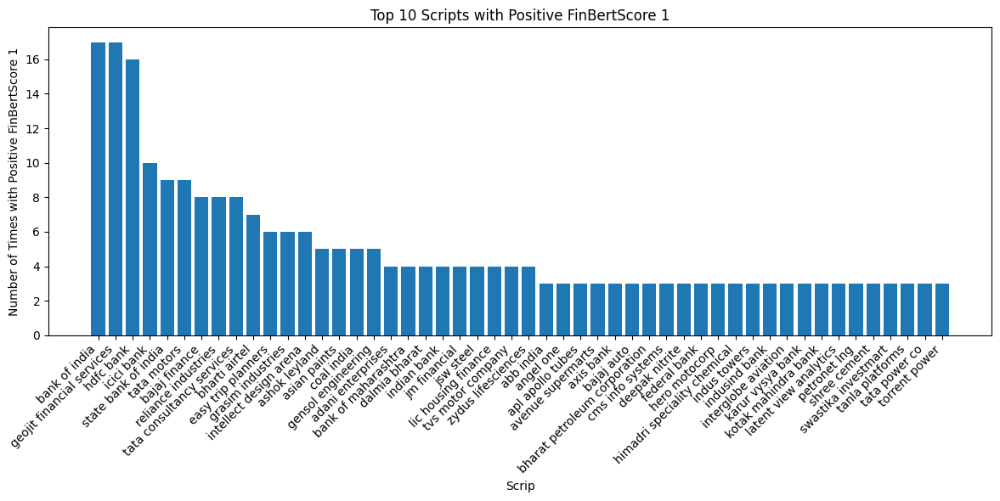

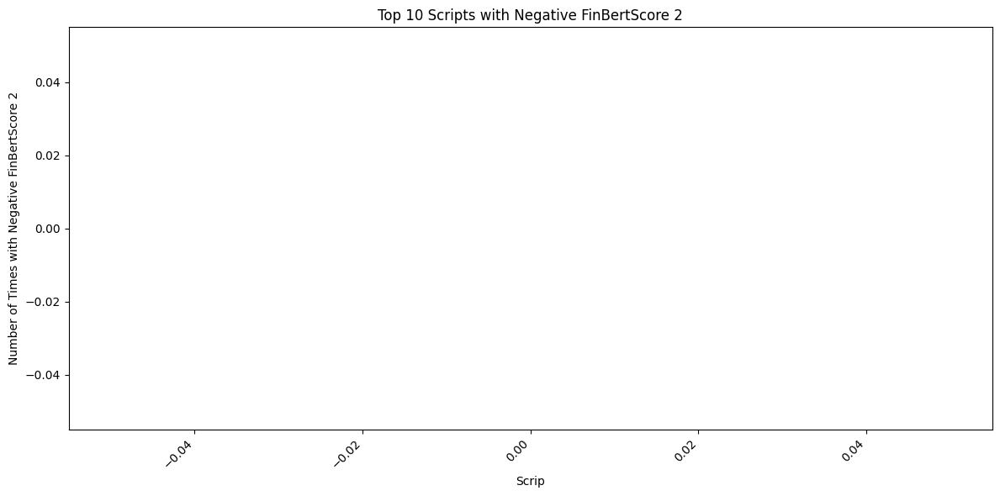

In [1]:
import requests
from bs4 import BeautifulSoup
import numpy as np
import pandas as pd
import textwrap
from pymongo import MongoClient
from tabulate import tabulate
import matplotlib.pyplot as plt
import re
import pandas as pd
from datetime import datetime

# def preprocess_security_name(security_name):
#     # Remove special characters and convert to lowercase
#     processed_name = re.sub(r'[^a-zA-Z\s]', '', security_name.lower()) if pd.notnull(security_name) and "Bank of" not in security_name else security_name
#     # Remove 'LTD' from the end of the string
#     processed_name = re.sub(r'\s*(ltd|LTD|Ltd|Limited)\.?$', '', processed_name, flags=re.IGNORECASE)
#     return processed_name


def preprocess_security_name(security_name):
    # Remove special characters including dots and convert to lowercase
    processed_name = re.sub(r'[^a-zA-Z0-9\s]', '', security_name.lower()) if pd.notnull(security_name) else security_name
    
    # Remove 'LTD' from the end of the string
    processed_name = re.sub(r'\s*(ltd|LTD|Ltd|Limited)\.?$', '', processed_name, flags=re.IGNORECASE)
    
    if pd.notnull(processed_name) and len(processed_name.split()) == 1:
        return re.sub(r'[^a-zA-Z0-9\s]', '', security_name.lower()) if pd.notnull(security_name) else security_name

    else:
        return processed_name

# MongoDB connection URI (replace with your actual URI)
uri = "mongodb://localhost:27017"

# Specify the database and collection
database_name = "NewsAnalytics"
collection_name = "RawNews_Hindu"
# collection_name = "RawNews_StockEdge"

# Path to the Excel file
# excel_file_path = r'C:\Users\91908\Documents\Raja\Share market\Analysis\Trendlyne\Data\Scrip\Scrip29022024.xlsx'
excel_file_path = r'C:\Users\91908\Documents\Raja\Share market\Analysis\Trendlyne\Data\Scrip\BSE NSE FindingScripNumber\NSE_BSE_Combined_List.xlsx'


try:
    # Create a new client and connect to the MongoDB server
    with MongoClient(uri) as client:
        
        collection = client[database_name][collection_name]
    
        # Query all records in the collection
        # all_records = collection.find()
    
        start_date = datetime(2024, 1, 1, 0, 0, 0)
        end_date = datetime(2024, 3, 13, 0, 0, 0)
        
    
        # find_query = {
        #     "created_at": {
        #         "$gte": start_date,
        #         "$lt": end_date
        #     }
            
        # }
        find_query = {
            "created_at": {
                "$gte": start_date,
                "$lt": end_date
            }, "FinBertScore": 1
            
        }


        
        all_records = collection.find(find_query)
        mongo_documents = list(all_records)

        if not mongo_documents:
            print("No records found from DB")
        else:
    
            # Read the "Portfolio" sheet from the Excel file
            # portfolio_df = pd.read_excel(excel_file_path, sheet_name='Top1000NSE', header=0)
            # Assuming the column containing stock names is named "Portfolio"
            # stock_names_in_portfolio = portfolio_df['Top1000NSE'].tolist()
            # stock_names_in_portfolio = ['sona blw']
            
            # this is from collective list from previous cell result
            # stock_names_in_portfolio = security_names
            
            ## collective finding starts
            portfolio_df = pd.read_excel(excel_file_path, sheet_name='Sheet1', header=0)
            stock_names_in_portfolio = portfolio_df['SecurityName'].tolist()
            ## Slice the list to get the first two elements
            stock_names_in_portfolio = stock_names_in_portfolio[0:8000]
            ## Preprocess each security name in the list
            stock_names_in_portfolio = [preprocess_security_name(name) for name in stock_names_in_portfolio]
            # print("stock_names_in_portfolio",stock_names_in_portfolio)
            ## collective finding ends
            
            # Create a list to store tuples of (Scrip, paragraph_content, label, confidence, date, strength)
            result_list = []
    
            # Check if each stock name in the portfolio is present in MongoDB documents
            for document in mongo_documents:
                for stock_name in stock_names_in_portfolio:
                    if stock_name.lower() in document['paragraph_content'].lower():
                        # Wrap paragraph content to a maximum of five words per line
                        wrapped_content = '\n'.join(textwrap.wrap(document['paragraph_content'], width=110))
                        
                        # Extract the numeric part from the 'Score' column
                        numeric_score = int(''.join(filter(str.isdigit, document['sentiment']['label'])))
                        
                        result_list.append((
                            stock_name,
                            wrapped_content,
                            numeric_score,  # Use the extracted numeric score
                            document['sentiment']['confidence'],
                            document['created_at'].strftime('%Y-%m-%d'),  # Extract date from created_at
                            document['FinBertScore'],
                            None  # Placeholder for Strength column
                        ))
                        break  # Break if at least one match is found for the current document
    
            # Create a DataFrame from the result list
            result_df = pd.DataFrame(result_list, columns=['Scrip', 'Paragraph_content', 'Score', 'Confidence', 'Date', 'FinBertScore', 'Strength'])
    
            # Check if Positive/Negative sheet is present in the Excel file
            xls = pd.ExcelFile(excel_file_path, engine='openpyxl')  # Use openpyxl engine
            if 'PositiveNegative' in xls.sheet_names:
                # Read the Positive/Negative sheet from the Excel file
                positive_negative_df = pd.read_excel(xls, sheet_name='PositiveNegative', header=0)
    
                # Assuming the column containing positive/negative words is named "PositiveNegative"
                positive_negative_words = positive_negative_df['PositiveNegative'].tolist()
    
                # Update the Strength column based on positive/negative words
                result_df['Strength'] = result_df.apply(
                    lambda row: ', '.join(
                        positive_negative_word
                        for positive_negative_word in positive_negative_words
                        if positive_negative_word.lower() in row['Paragraph_content'].lower()
                    ),
                    axis=1
                )
                
                # Wrap the entire 'Strength' column to a maximum width of 140 characters
            result_df['Strength'] = result_df['Strength'].apply(lambda x: '\n'.join(textwrap.wrap(str(x), width=17)))
    
            # Sort the DataFrame based on multiple columns in ascending order
            result_df['Confidence'] = result_df['Confidence'].apply(lambda x: f"{x:.5f}")
            result_df = result_df.sort_values(by=['Date', 'Scrip', 'Score', 'Confidence'], ascending=[False, True, False, False])
    
            # Display the DataFrame
            print(tabulate(result_df, headers='keys', tablefmt='pretty'))
    
    
    
            # Assuming 'result_df' is your DataFrame
            
            # Convert 'Scrip' to lowercase and trim spaces
            result_df['Scrip'] = result_df['Scrip'].str.lower().str.strip()
            
            # Calculate the counts of positive FinBertScores for each 'Scrip'
            positive_counts_1 = result_df[result_df['FinBertScore'] == 1].groupby('Scrip').size()
            
            # Select the top 10 results for FinBertScore 1
            top_10_results_1 = positive_counts_1.nlargest(50)
            
            # Set a larger figure size
            plt.figure(figsize=(12, 6))
            
            # Plot the results for FinBertScore 1
            plt.bar(top_10_results_1.index, top_10_results_1)
            plt.xlabel('Scrip')
            plt.ylabel('Number of Times with Positive FinBertScore 1')
            plt.title('Top 10 Scripts with Positive FinBertScore 1')
            plt.xticks(rotation=45, ha='right')
            plt.tight_layout()
            plt.show()
    
            
            # Calculate the counts of positive FinBertScores for each 'Scrip'
            positive_counts_2 = result_df[result_df['FinBertScore'] == 2].groupby('Scrip').size()
            
            # Select the top 10 results for FinBertScore 1
            top_10_results_2 = positive_counts_2.nlargest(50)
           
            # Set a larger figure size
            plt.figure(figsize=(12, 6))
            
            # Plot the results for FinBertScore 1
            plt.bar(top_10_results_2.index, top_10_results_2)
            plt.xlabel('Scrip')
            plt.ylabel('Number of Times with Negative FinBertScore 2')
            plt.title('Top 10 Scripts with Negative FinBertScore 2')
            plt.xticks(rotation=45, ha='right')
            plt.tight_layout()
            plt.show()
    
    

except Exception as e:
    print(e)


In [2]:
import pandas as pd
from fuzzywuzzy import fuzz

# Load the Excel file into a DataFrame
excel_file = r'C:\Users\91908\Documents\Raja\Share market\Analysis\Trendlyne\Data\Scrip\BSE NSE FindingScripNumber\NSE_BSE_Combined_List.xlsx'
df = pd.read_excel(excel_file)

# Define a function to perform fuzzy matching
def find_matching_security(stock_name):
    # Tokenize the search query
    tokens = stock_name.split()
    # Initialize variables to store the best match and its score
    best_match = None
    best_score = -1
    # Iterate over the rows of the DataFrame
    for index, row in df.iterrows():
        # Perform fuzzy matching using token_set_ratio
        match_score = fuzz.token_set_ratio(stock_name, row['SecurityName'])
        # Update the best match if the score is higher than the previous best
        if match_score > best_score:
            best_match = row['SecurityCode']
            best_score = match_score
    # Return the best match
    return best_match

# List of stock names in your portfolio
stock_names_in_portfolio = result_df[['Date', 'Scrip']]

# List to store tuples of (Date, Security Code)
resulting_codes = []

# Iterate over the stock names and find the corresponding SecurityCode
for index, row in stock_names_in_portfolio.iterrows():
    # Get the date and scrip name from the current row
    date = row['Date']
    scrip = row['Scrip']
    # Find the matching security code for the scrip
    security_code = find_matching_security(scrip)
    if security_code:
        # Append the tuple of (Date, Security Code) to the resulting_codes list
        resulting_codes.append((date, security_code))
    else:
        print(f"No match found for stock name: {scrip}")

# Print the resulting list of tuples
print("Resulting Date-Security Code pairs:", resulting_codes)


C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\fuzzywuzzy\fuzz.py:11: UserWarning: Using slow pure-python SequenceMatcher. Install python-Levenshtein to remove this warning
  warnings.warn('Using slow pure-python SequenceMatcher. Install python-Levenshtein to remove this warning')


Resulting Date-Security Code pairs: [('2024-03-12', 'APLAPOLLO'), ('2024-03-12', 'ASIANPAINT'), ('2024-03-12', 'TORNTPOWER'), ('2024-03-11', 'AZAD'), ('2024-03-11', 'DRONACHRYA'), ('2024-03-11', 'JKLAKSHMI'), ('2024-03-07', 'BHARTIARTL'), ('2024-03-07', 'ICICIBANK'), ('2024-03-07', 'PERSISTENT'), ('2024-03-07', 'TATAMOTORS'), ('2024-03-07', 'TATAMOTORS'), ('2024-03-07', 'TORNTPOWER'), ('2024-03-06', 'MAHABANK'), ('2024-03-06', 'ICICIBANK'), ('2024-03-06', 'KPIGREEN'), ('2024-03-06', 'LTIM'), ('2024-03-06', 'SONATSOFTW'), ('2024-03-06', 'STARHEALTH'), ('2024-03-06', 'TATAMOTORS'), ('2024-03-06', 'TATAPOWER'), ('2024-03-05', 'SBIN'), ('2024-03-05', 'EICHERMOT'), ('2024-03-05', 'GLOBALCA'), ('2024-03-05', 'GODREJPROP'), ('2024-03-05', 'JUBLINGREA'), ('2024-03-05', 'STAR'), ('2024-03-05', 'TATAMOTORS'), ('2024-03-04', 'AWL'), ('2024-03-04', 'BHARTIARTL'), ('2024-03-04', 'BLUESTARCO'), ('2024-03-04', 'WEL'), ('2024-03-01', 'ADANIENT'), ('2024-03-01', 'BAJAJ-AUTO'), ('2024-03-01', 'CMSINFO')

In [3]:
import yfinance as yf
from datetime import datetime, timedelta
import pandas as pd
import os

def is_working_day(date_str):
    # Parse the date string to datetime format
    date_obj = datetime.strptime(date_str, '%Y-%m-%d')
    
    # Check if the date falls on a weekend (Saturday or Sunday)
    if date_obj.weekday() >= 5:
        return False
    
    # Check if the date falls on a holiday
    # Add your holiday logic here
    holidays = {"2023-01-26", "2023-03-07", "2023-03-30", "2023-04-04", "2023-04-07", 
                "2023-04-14", "2023-05-01", "2023-06-29", "2023-07-29", "2023-08-15", 
                "2023-09-19", "2023-10-02", "2023-10-24", "2023-11-14", "2023-11-27", 
                "2023-12-25","2024-01-22",
                "2024-01-26", "2024-03-08", "2024-03-25", "2024-03-29", "2024-04-11", 
                "2024-04-17", "2024-05-01", "2024-06-17", "2024-07-17", "2024-08-15", 
                "2024-10-02", "2024-11-01", "2024-11-15", "2024-12-25"}
    if date_str in holidays:
        return False
    
    # If the date is not a weekend or holiday, it's a regular working day
    return True

def is_working_day_if_not_next_working_date(date):
    # Check if the input is already a string
    if isinstance(date, str):
        # Parse the date string to datetime format
        date_obj = datetime.strptime(date, '%Y-%m-%d')
    else:
        # Use the provided Timestamp object
        date_obj = date
    
    # Check if the date is a working day
    if is_working_day(date_obj.strftime('%Y-%m-%d')):
        return date_obj
    
    # If the date is not a working day, find the next working date
    while True:
        date_obj += timedelta(days=1)
        if is_working_day(date_obj.strftime('%Y-%m-%d')):
            return date_obj

def download_stock_data(symbol, start_date, end_date):
    data = yf.download(symbol, start=start_date, end=end_date)
    return data


# Iterate over resulting_codes
# Iterate over resulting_codes
stock_data_list = []
for date, security_code in resulting_codes:
    # Assuming resulting_codes contains tuples of (Date, Security Code)
    file_date = datetime.strptime(date, '%Y-%m-%d')  # Convert date string to datetime object
    start_date = file_date  # Select the file date as the start date
    start_date_pass = is_working_day_if_not_next_working_date(start_date)
    end_date = (start_date_pass + timedelta(days=120)).strftime("%Y-%m-%d")
    
    # Download stock data for the next day
    if isinstance(security_code, str):
        stock_data = download_stock_data(security_code + ".NS", start_date_pass, end_date)
        stock_data_list.append((security_code,file_date, stock_data))


[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed


C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')


[*********************100%%**********************]  1 of 1 completed


1 Failed download:
['DRONACHRYA.NS']: Exception('%ticker%: No timezone found, symbol may be delisted')



[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')


[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed


C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')


[*********************100%%**********************]  1 of 1 completed


1 Failed download:
['GLOBALCA.NS']: Exception('%ticker%: No timezone found, symbol may be delisted')



[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')


[*********************100%%**********************]  1 of 1 completed


C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')


[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed


C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')


[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')


[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')


[*********************100%%**********************]  1 of 1 completed


1 Failed download:
['ROCKINGDCE.NS']: Exception('%ticker%: No timezone found, symbol may be delisted')



[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')


[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')


[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')


[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')


[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')


[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')


[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')


[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')


[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')


[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')


[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')


[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')


[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')


[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')


[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')


[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


1 Failed download:
['MAFATIND.NS']: Exception('%ticker%: No timezone found, symbol may be delisted')



[*********************100%%**********************]  1 of 1 completed


1 Failed download:
['MEERA.NS']: Exception('%ticker%: No timezone found, symbol may be delisted')



[*********************100%%**********************]  1 of 1 completed


C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')


[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')


C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')


[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')


C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')


[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')


C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')


[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')


[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed


C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')


[*********************100%%**********************]  1 of 1 completed


1 Failed download:
['ATISHAY.NS']: Exception('%ticker%: No timezone found, symbol may be delisted')



[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')


[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')


[*********************100%%**********************]  1 of 1 completed


C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')


[*********************100%%**********************]  1 of 1 completed


C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')


[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed


C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')


[*********************100%%**********************]  1 of 1 completed


C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')


[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')


[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')


[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')


C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')


[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')


[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')


[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')


[*********************100%%**********************]  1 of 1 completed


C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')


[*********************100%%**********************]  1 of 1 completed


1 Failed download:
['SWASTIKA.NS']: Exception('%ticker%: No timezone found, symbol may be delisted')



[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')


C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')


[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')


[*********************100%%**********************]  1 of 1 completed


C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')


[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed


C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')


[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')


[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')


[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')


[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')


[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')

1 Failed download:
['SWASTIKA.NS']: Exception('%ticker%: No timezone found, symbol may be delisted')



[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')


[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')


[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed


C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')


[*********************100%%**********************]  1 of 1 completed


C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')


[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')


C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')


[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')

1 Failed download:
['SWASTIKA.NS']: Exception('%ticker%: No timezone found, symbol may be delisted')



[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')


C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')


[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed


C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')


[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')


[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')


C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')


[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed


C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')


[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')


[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')


[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')


[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')


[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')


[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')


[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')


[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')


[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')


[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')


[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')


[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')


[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')


[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')


[*********************100%%**********************]  1 of 1 completed


1 Failed download:
['GSTL.NS']: Exception('%ticker%: No timezone found, symbol may be delisted')



[*********************100%%**********************]  1 of 1 completed


C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')


[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed


C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')


[*********************100%%**********************]  1 of 1 completed


C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')


[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')


[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')


[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')

1 Failed download:
['DRONACHRYA.NS']: Exception('%ticker%: No timezone found, symbol may be delisted')



[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')


C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')


[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


1 Failed download:
['RACLGEAR.NS']: Exception('%ticker%: No timezone found, symbol may be delisted')



[*********************100%%**********************]  1 of 1 completed


1 Failed download:
['SEACOAST.NS']: Exception('%ticker%: No timezone found, symbol may be delisted')



[*********************100%%**********************]  1 of 1 completed


C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')


[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed


C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')


[*********************100%%**********************]  1 of 1 completed


C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')


[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed


C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')


[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')


[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')
C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')



[*********************100%%**********************]  1 of 1 completed


C:\Users\91908\AppData\Roaming\Python\Python39\site-packages\yfinance\utils.py:782: FutureWarning: The 'unit' keyword in TimedeltaIndex construction is deprecated and will be removed in a future version. Use pd.to_timedelta instead.
  df.index += _pd.TimedeltaIndex(dst_error_hours, 'h')


In [4]:
from prettytable import PrettyTable


def calculate_percentage_changes(file_date, data, stock_code):
    result_dict = {
        "Stock Code": stock_code,
        "Start Date": file_date
    }

    periods = [1, 5, 10, 15, 20, 25]

    for period in periods:
        if len(data) >= period + 1:
            close_change_1d = volume_change = None
            
            # Calculate percentage change in close price
            close_change_1d = ((data['Close'].iloc[period] - data['Close'].iloc[0]) / data['Close'].iloc[0]) * 100
            
            # Calculate percentage change in volume
            volume_change = ((data['Volume'].iloc[period] - data['Volume'].iloc[0]) / data['Volume'].iloc[0]) * 100

            # Add percentage changes to the result dictionary
            result_dict[f"{period}D P (%)"] = f"{close_change_1d:.2f}" if close_change_1d is not None else "nan"
            result_dict[f"{period}D V (%)"] = f"{volume_change:.2f}" if volume_change is not None else "nan"

    return result_dict


# Initialize a PrettyTable for displaying results
table = PrettyTable()

# Define the headers for the table
header = ["Stock Code","Start Date"]
for period in [1, 5, 10, 15, 20, 25]:
    header.append(f"{period}D P (%)")
    header.append(f"{period}D V (%)")
table.field_names = header

# Iterate over stock_data_list
for stock_code,file_date, stock_data in stock_data_list:
    # Calculate percentage changes
    percentage_changes = calculate_percentage_changes(file_date, stock_data, stock_code)
    
    # Add the result to the PrettyTable
    table.add_row([percentage_changes.get(field, "nan") for field in table.field_names])

# Print the table of percentage changes
print("\nPercentage Changes:")
print(table)



Percentage Changes:
+------------+---------------------+----------+----------+----------+----------+-----------+-----------+-----------+-----------+-----------+-----------+-----------+-----------+
| Stock Code |      Start Date     | 1D P (%) | 1D V (%) | 5D P (%) | 5D V (%) | 10D P (%) | 10D V (%) | 15D P (%) | 15D V (%) | 20D P (%) | 20D V (%) | 25D P (%) | 25D V (%) |
+------------+---------------------+----------+----------+----------+----------+-----------+-----------+-----------+-----------+-----------+-----------+-----------+-----------+
| APLAPOLLO  | 2024-03-12 00:00:00 |   nan    |   nan    |   nan    |   nan    |    nan    |    nan    |    nan    |    nan    |    nan    |    nan    |    nan    |    nan    |
| ASIANPAINT | 2024-03-12 00:00:00 |   nan    |   nan    |   nan    |   nan    |    nan    |    nan    |    nan    |    nan    |    nan    |    nan    |    nan    |    nan    |
| TORNTPOWER | 2024-03-12 00:00:00 |   nan    |   nan    |   nan    |   nan    |    nan    |  

In [7]:
# Assuming stock_data_list is a list of tuples containing the stock data
# Filter out the tuples with non-empty DataFrames
stock_data_list = [(stock_code, file_date, stock_data) for stock_code, file_date, stock_data in stock_data_list if not stock_data.empty]


APLAPOLLO
2024-03-12 00:00:00


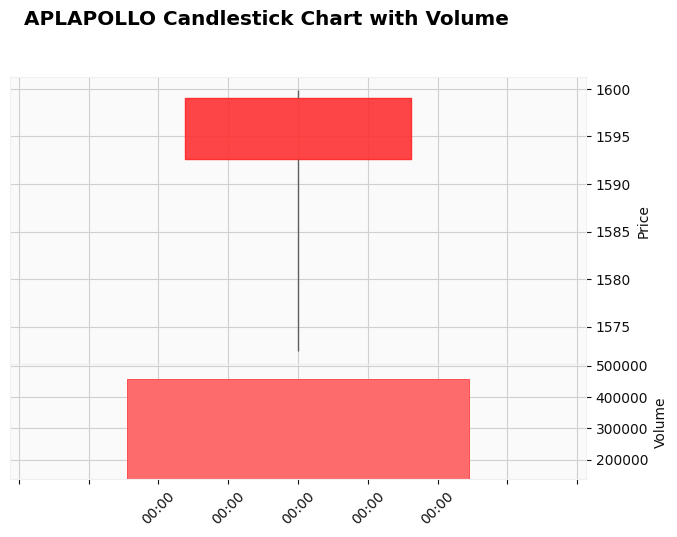

ASIANPAINT
2024-03-12 00:00:00


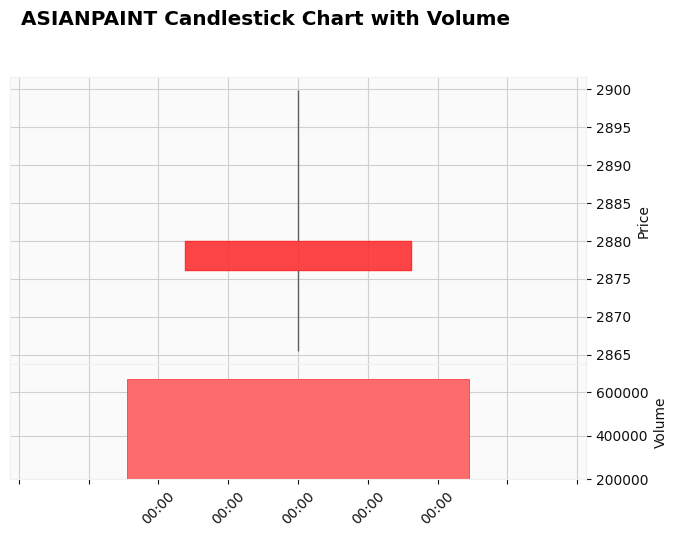

TORNTPOWER
2024-03-12 00:00:00


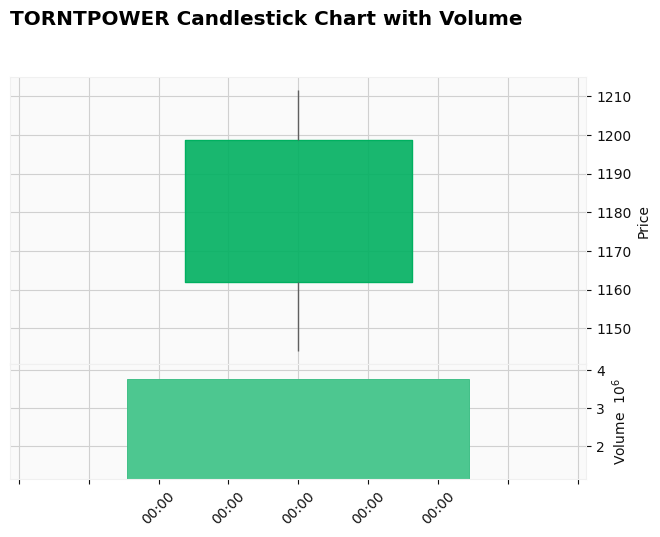

AZAD
2024-03-11 00:00:00


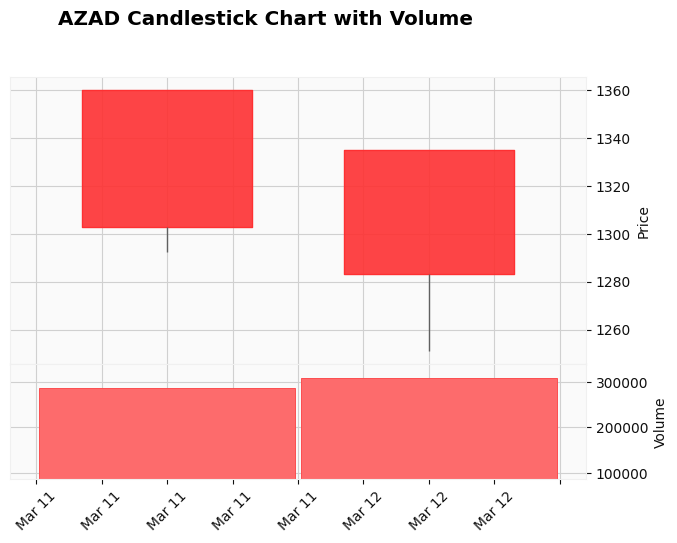

JKLAKSHMI
2024-03-11 00:00:00


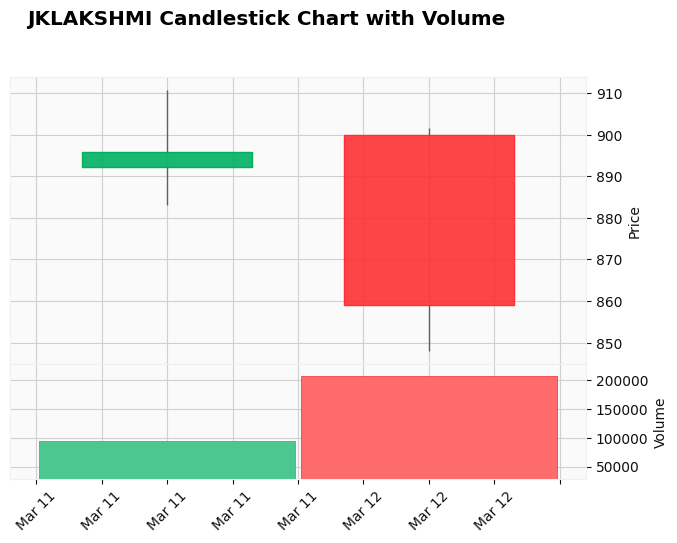

BHARTIARTL
2024-03-07 00:00:00


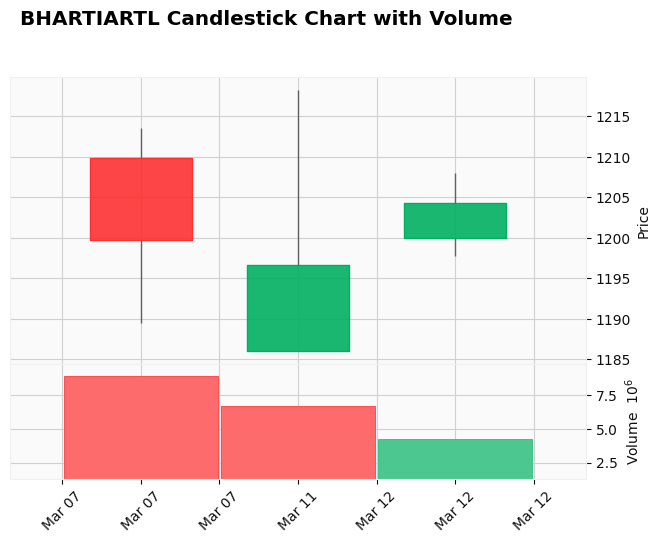

ICICIBANK
2024-03-07 00:00:00


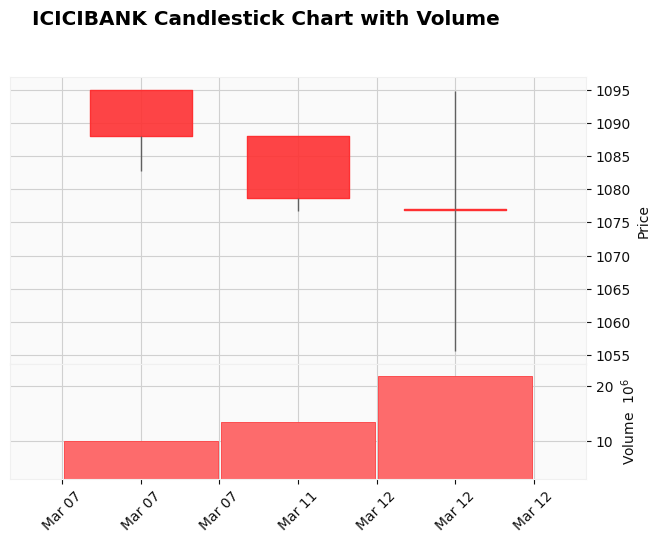

PERSISTENT
2024-03-07 00:00:00


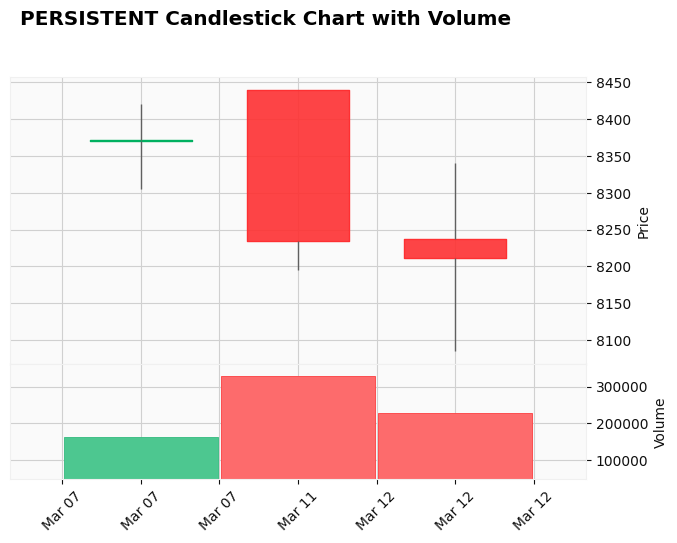

TATAMOTORS
2024-03-07 00:00:00


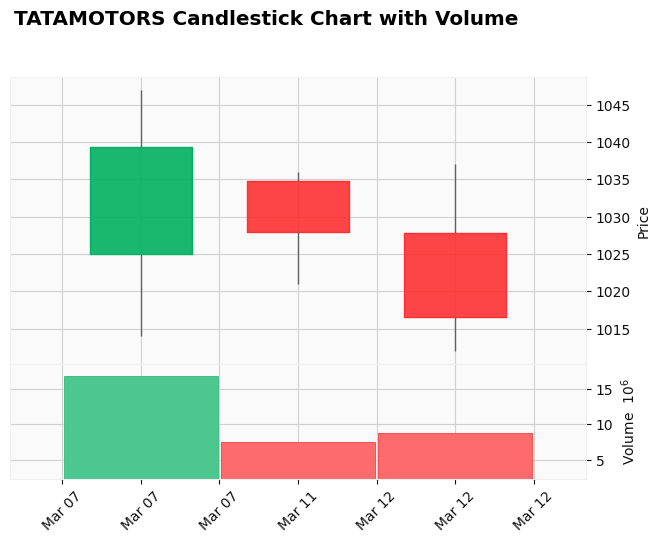

TATAMOTORS
2024-03-07 00:00:00


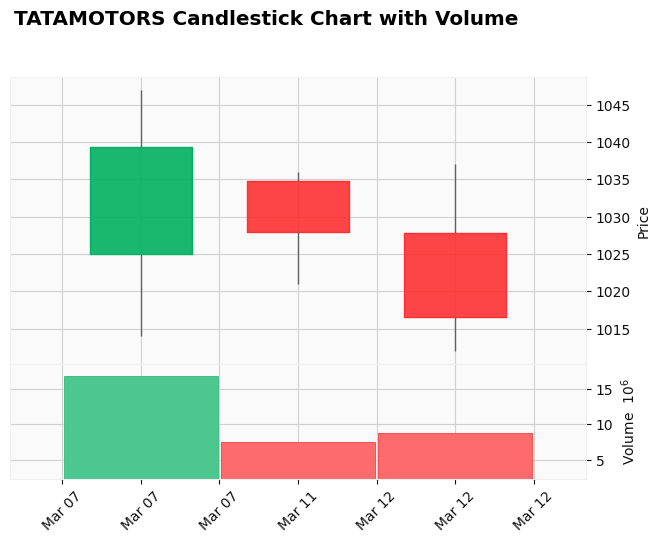

TORNTPOWER
2024-03-07 00:00:00


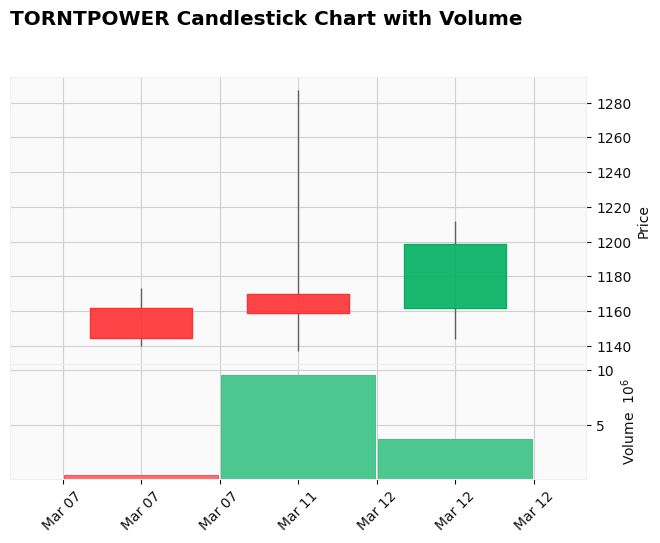

MAHABANK
2024-03-06 00:00:00


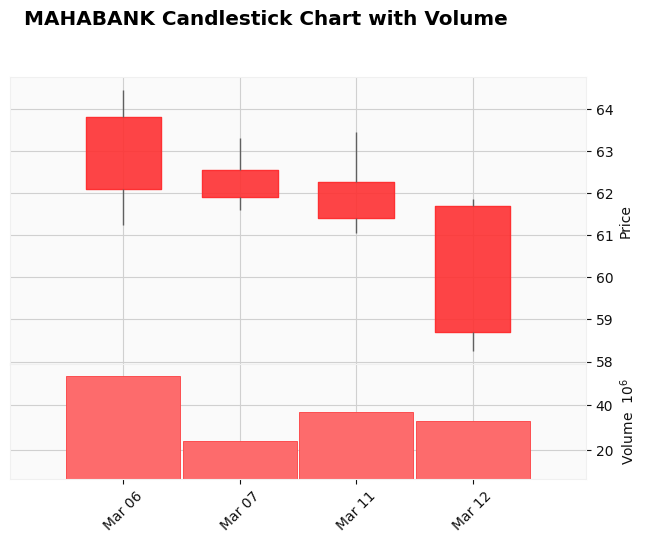

ICICIBANK
2024-03-06 00:00:00


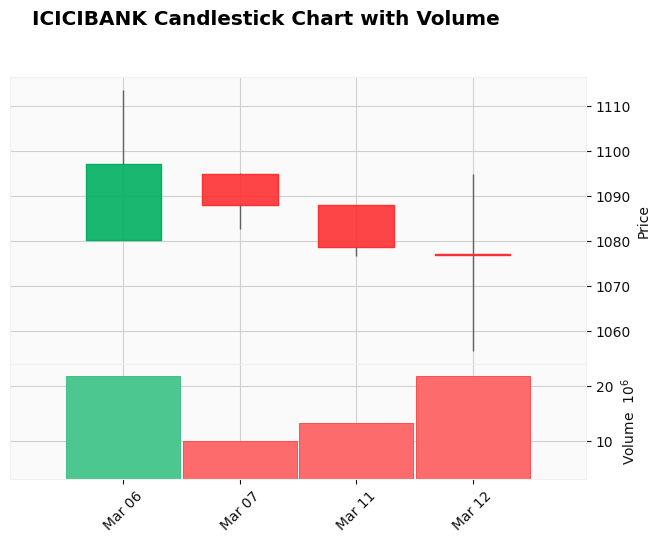

KPIGREEN
2024-03-06 00:00:00


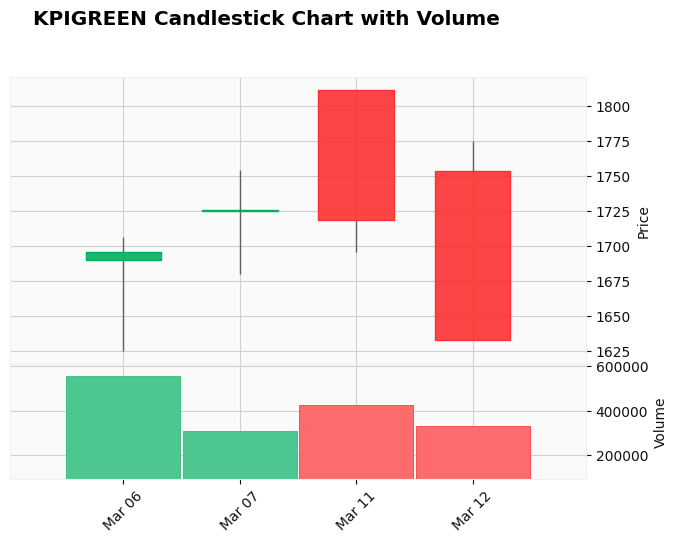

LTIM
2024-03-06 00:00:00


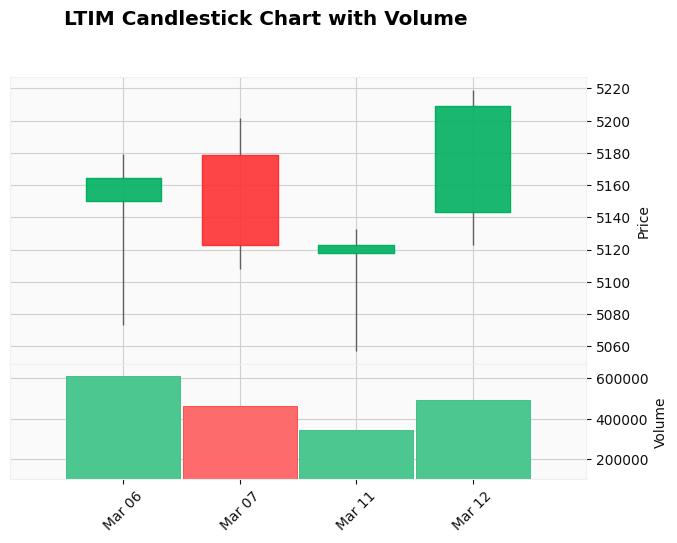

SONATSOFTW
2024-03-06 00:00:00


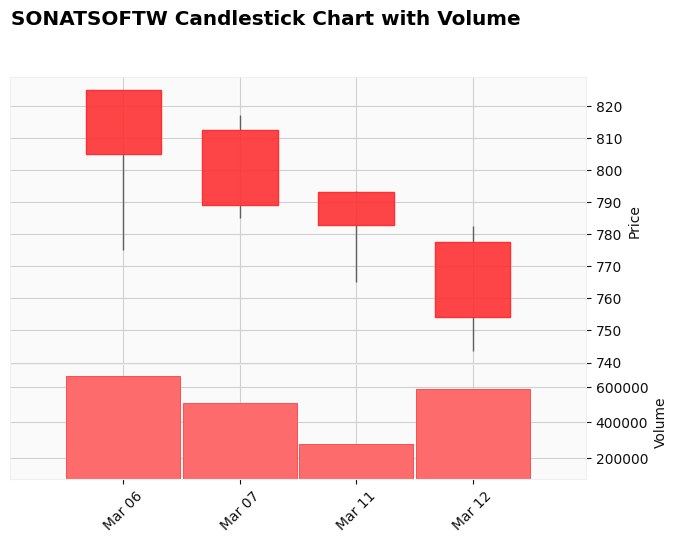

STARHEALTH
2024-03-06 00:00:00


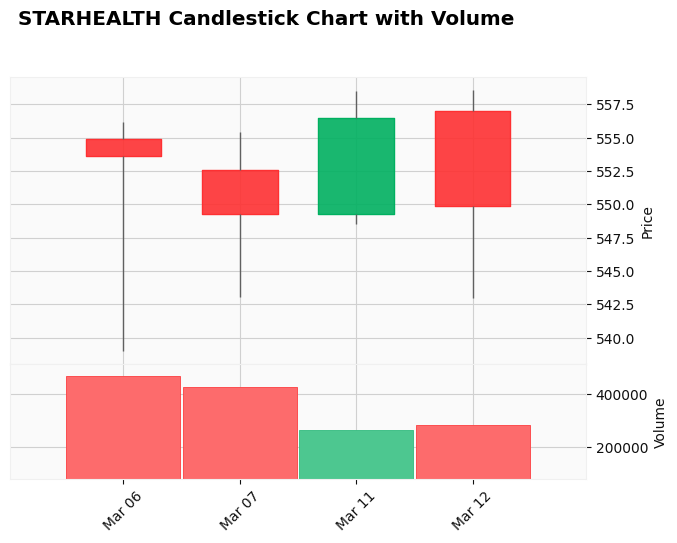

TATAMOTORS
2024-03-06 00:00:00


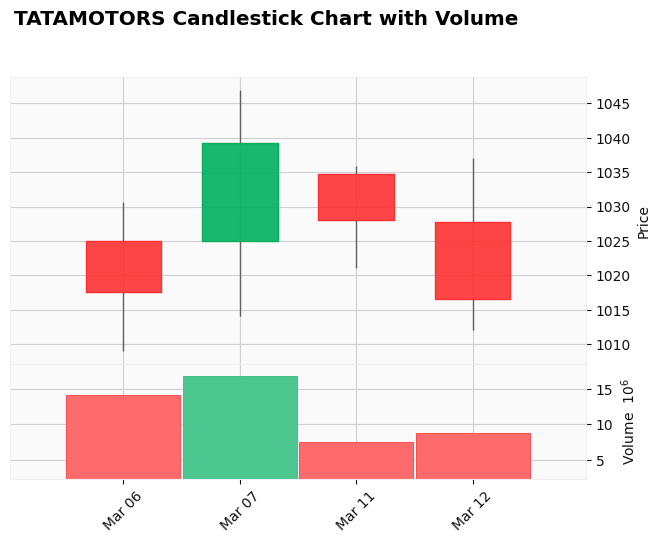

TATAPOWER
2024-03-06 00:00:00


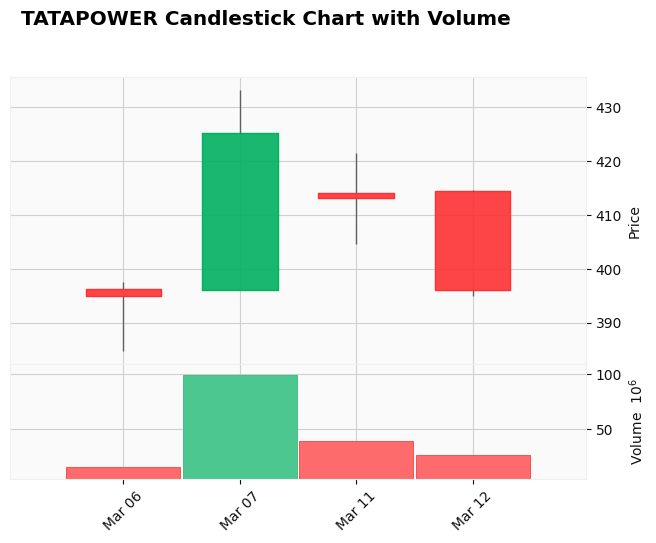

SBIN
2024-03-05 00:00:00


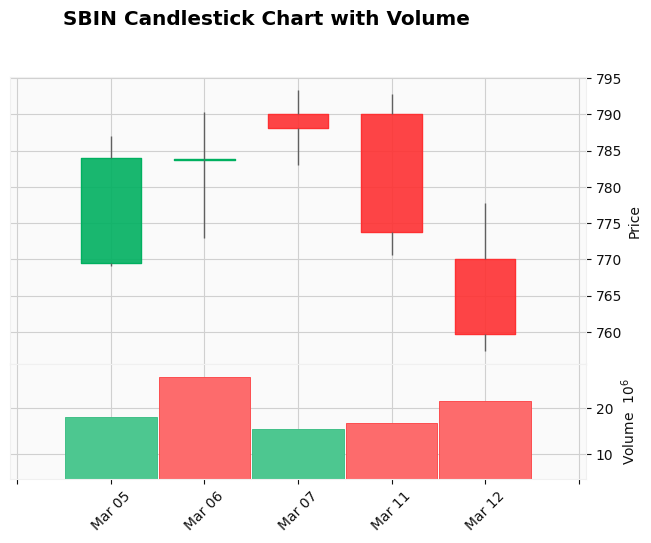

EICHERMOT
2024-03-05 00:00:00


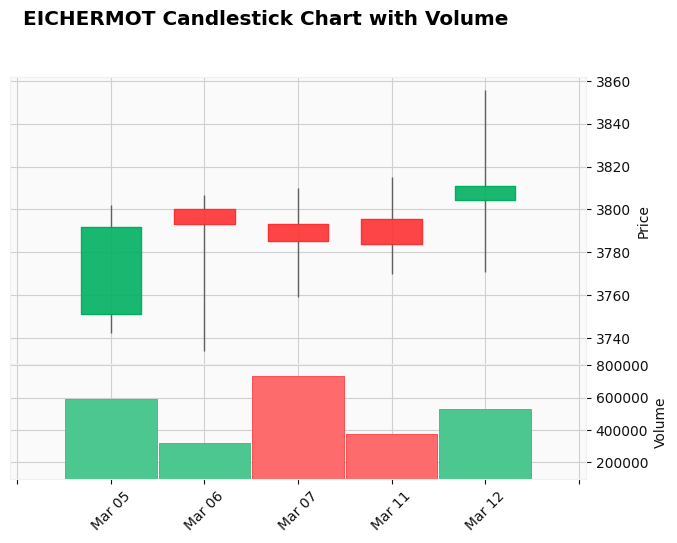

GODREJPROP
2024-03-05 00:00:00


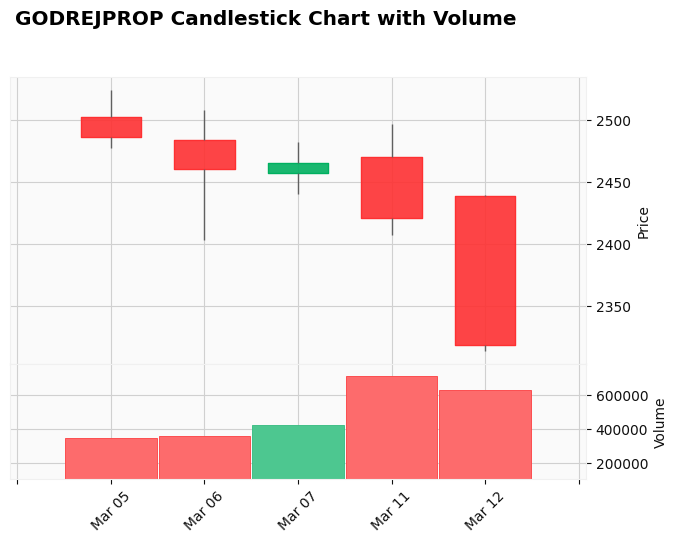

JUBLINGREA
2024-03-05 00:00:00


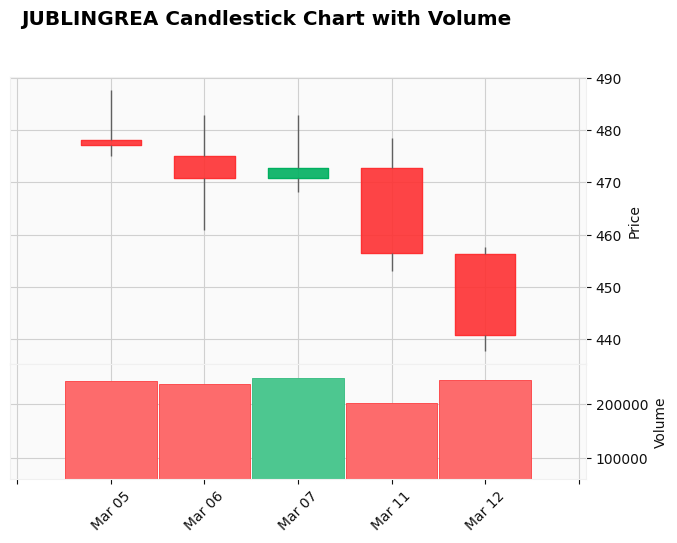

STAR
2024-03-05 00:00:00


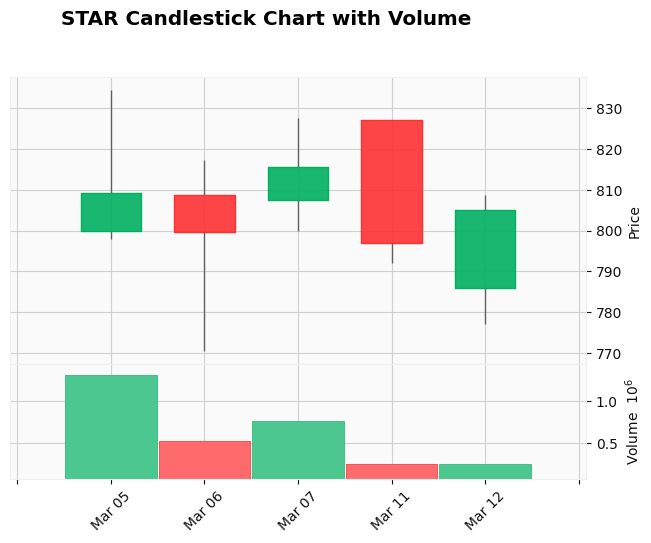

TATAMOTORS
2024-03-05 00:00:00


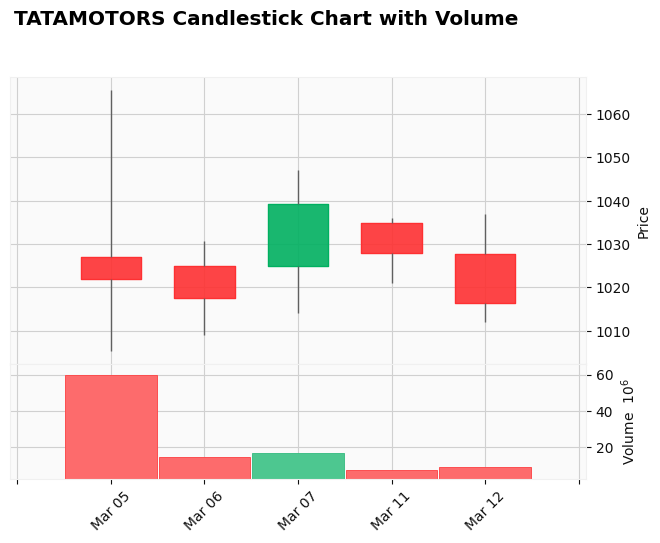

AWL
2024-03-04 00:00:00


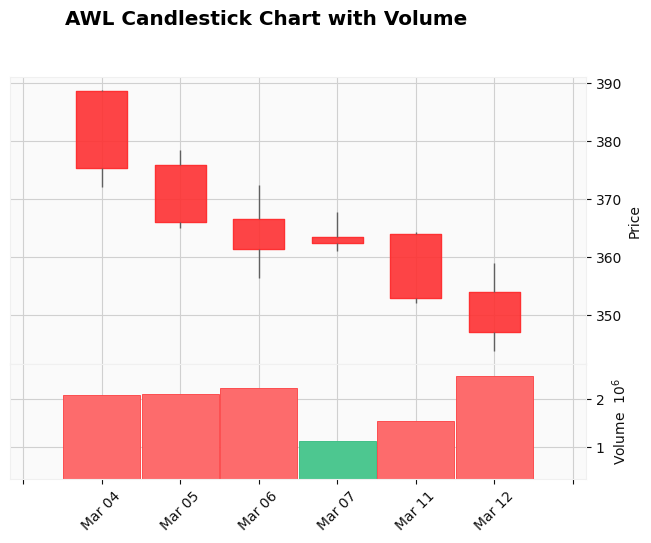

BHARTIARTL
2024-03-04 00:00:00


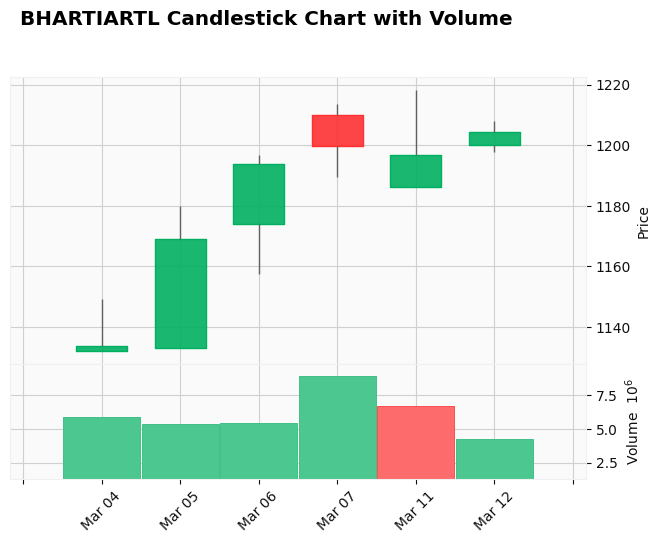

BLUESTARCO
2024-03-04 00:00:00


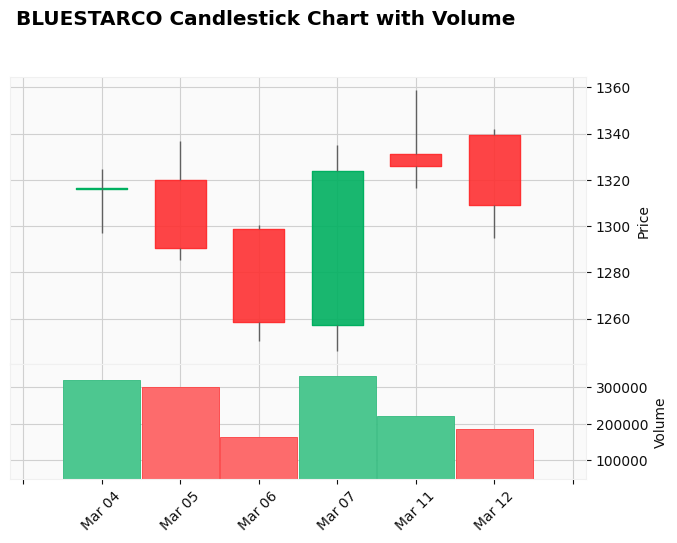

WEL
2024-03-04 00:00:00


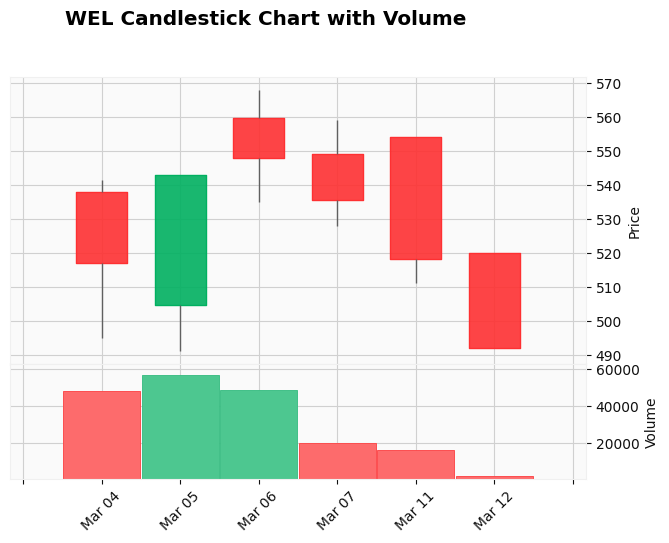

ADANIENT
2024-03-01 00:00:00


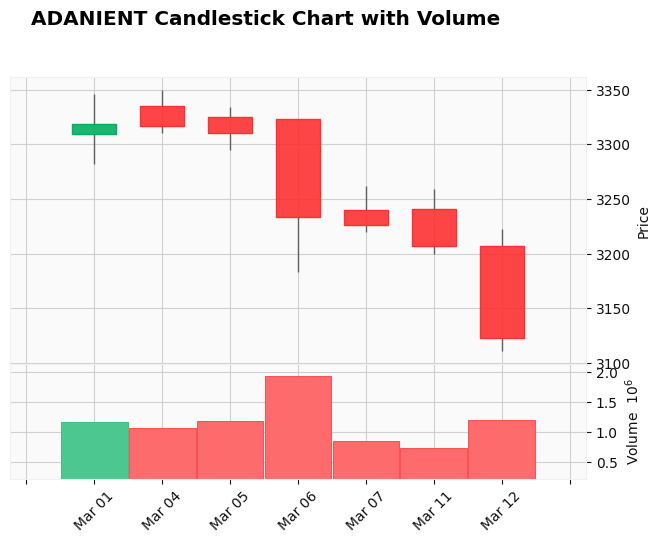

BAJAJ-AUTO
2024-03-01 00:00:00


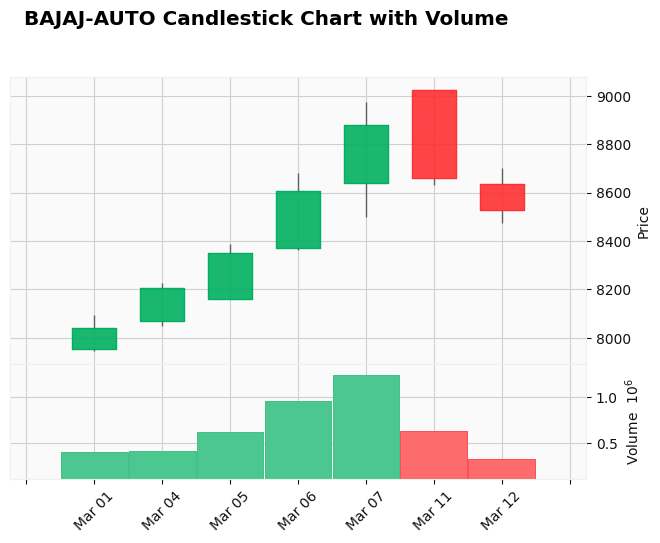

CMSINFO
2024-03-01 00:00:00


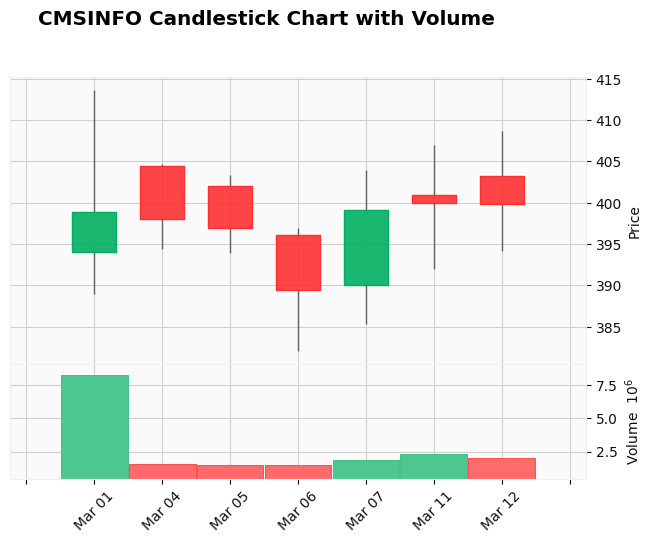

SBIN
2024-03-01 00:00:00


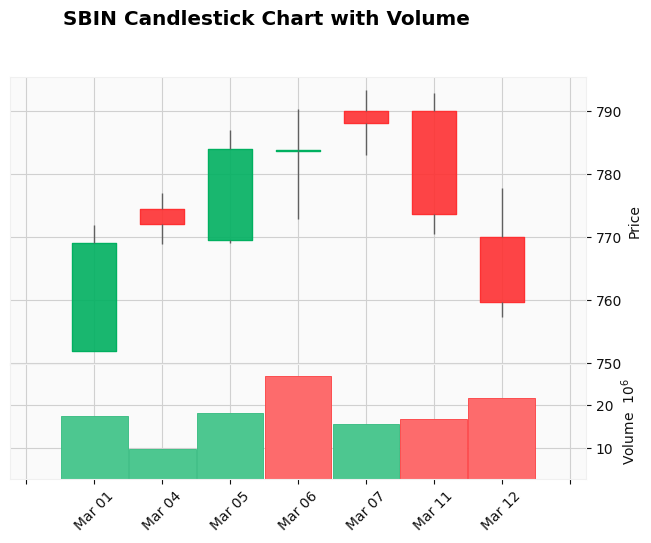

TANLA
2024-03-01 00:00:00


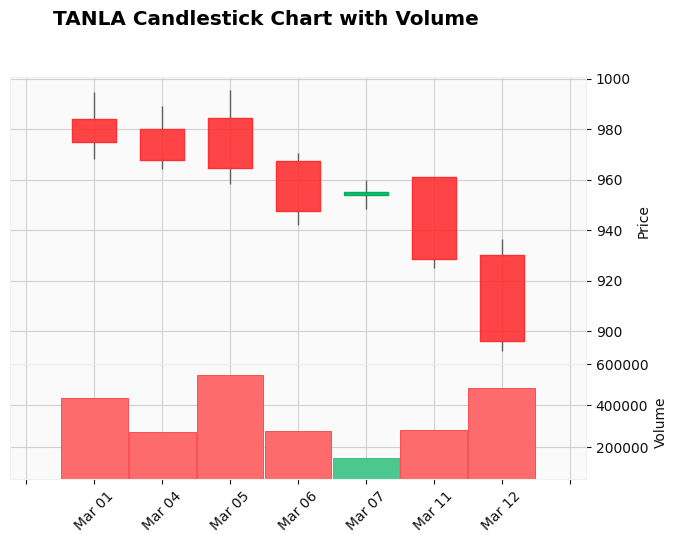

TATAINVEST
2024-03-01 00:00:00


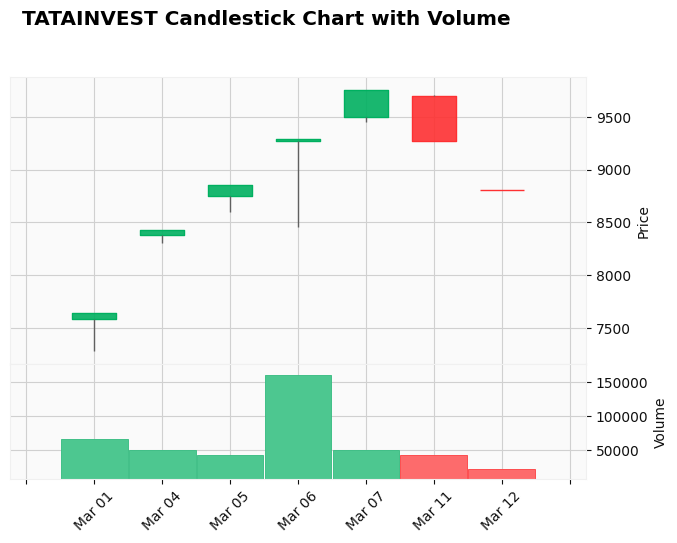

TVSMOTOR
2024-03-01 00:00:00


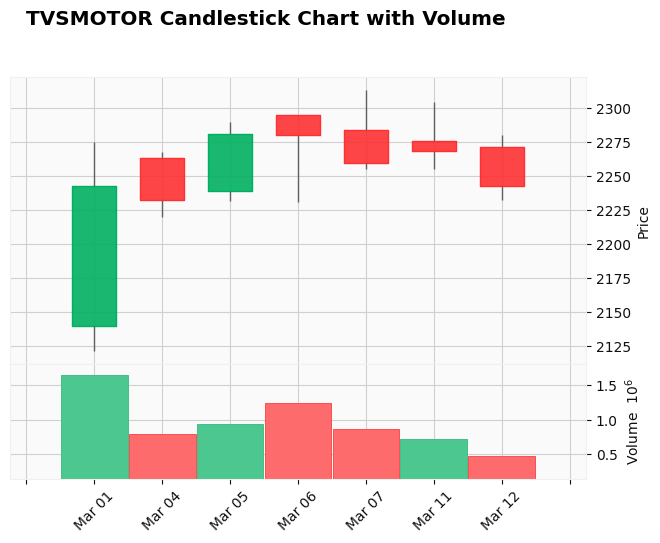

USHAMART
2024-03-01 00:00:00


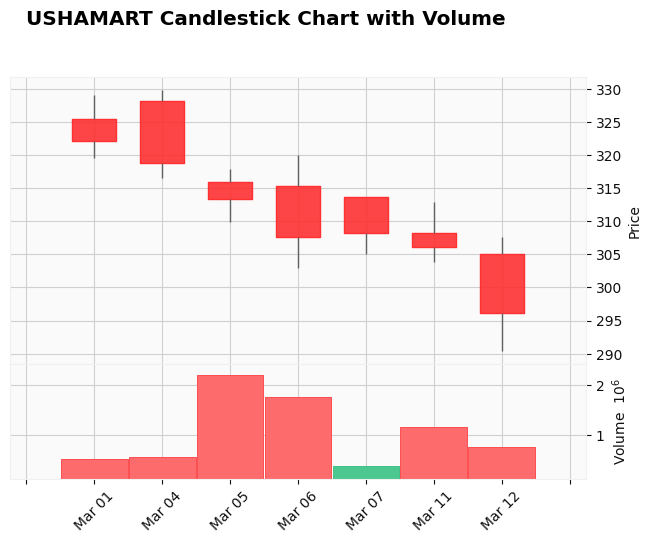

BEL
2024-02-29 00:00:00


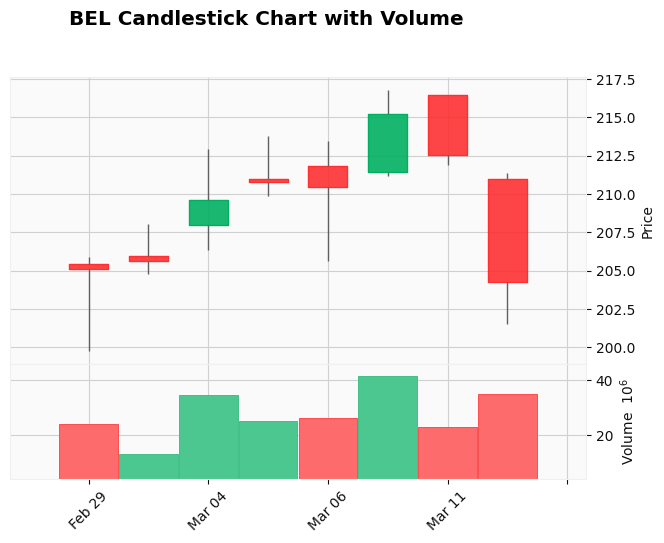

EMSLIMITED
2024-02-29 00:00:00


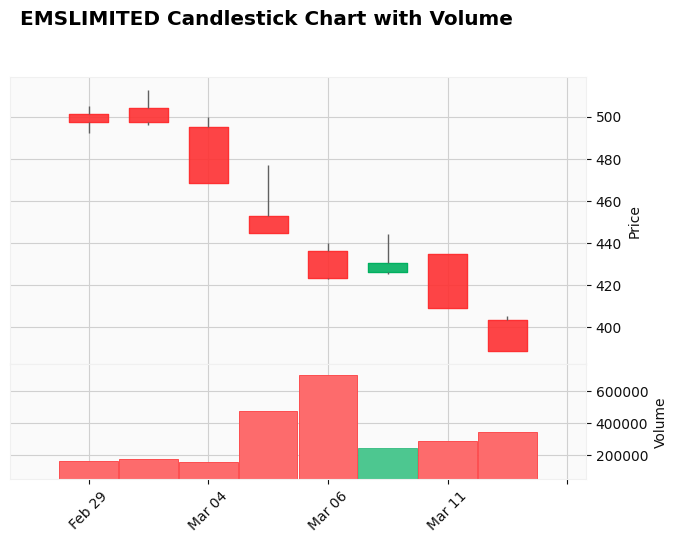

RELIANCE
2024-02-29 00:00:00


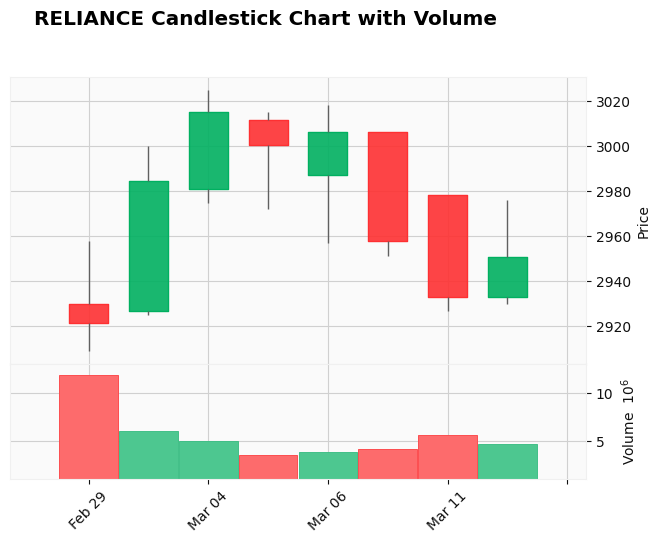

TATAMOTORS
2024-02-29 00:00:00


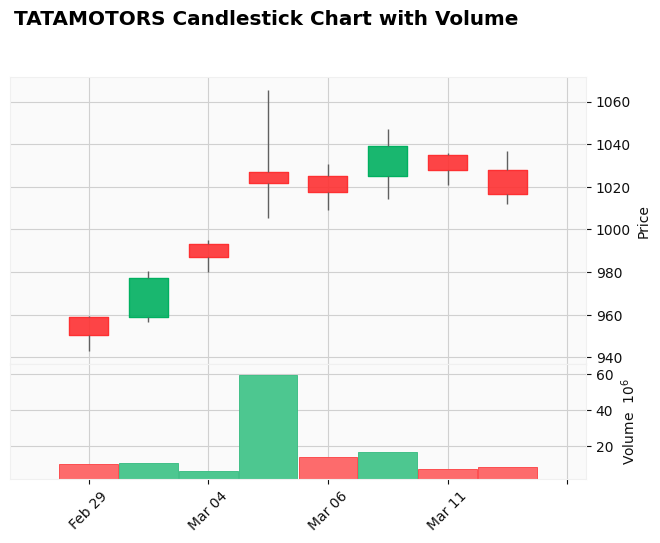

5PAISA
2024-02-28 00:00:00


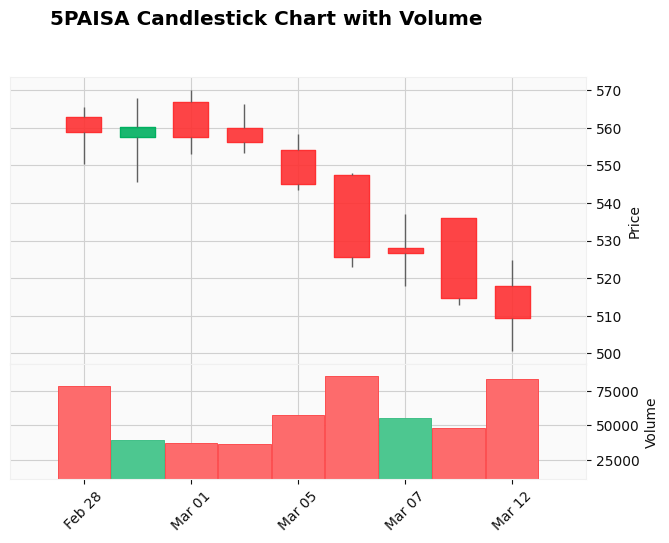

GENSOL
2024-02-28 00:00:00


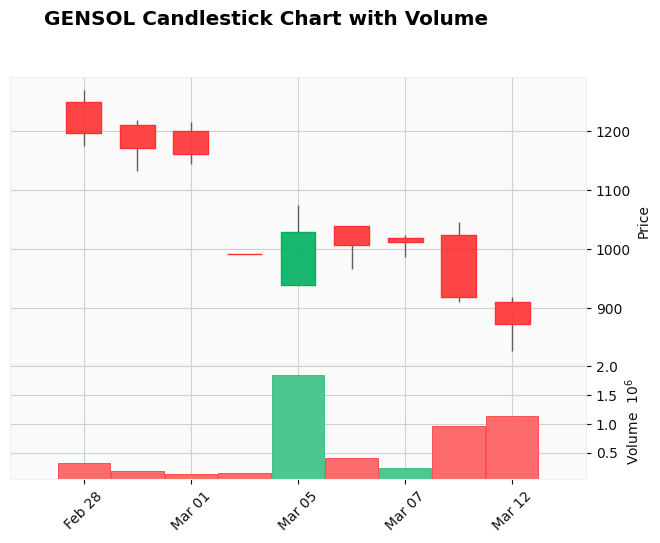

GENSOL
2024-02-28 00:00:00


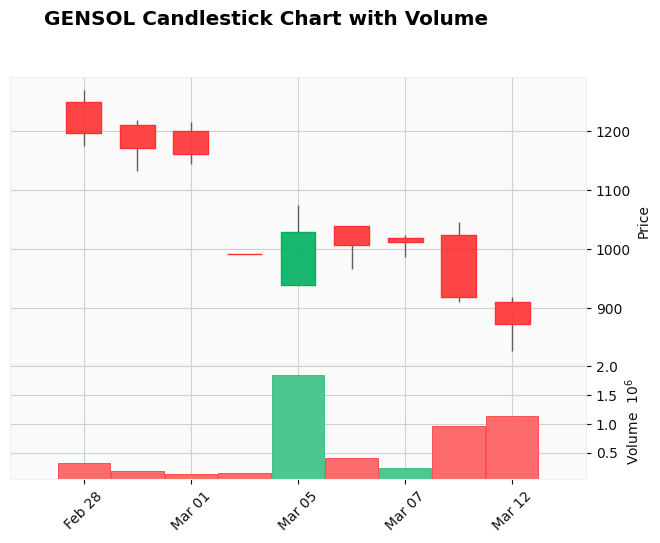

ICICIBANK
2024-02-28 00:00:00


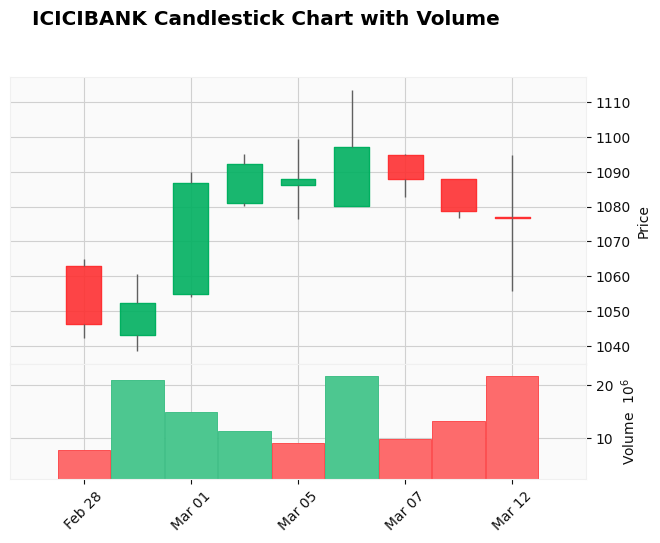

INTELLECT
2024-02-28 00:00:00


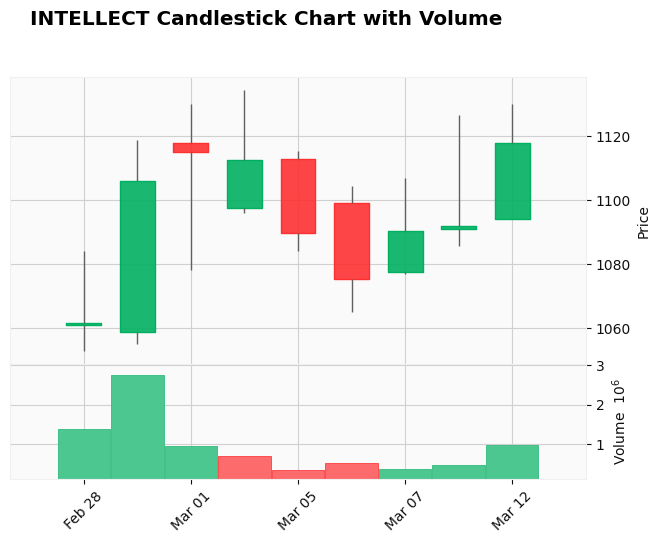

MAZDOCK
2024-02-28 00:00:00


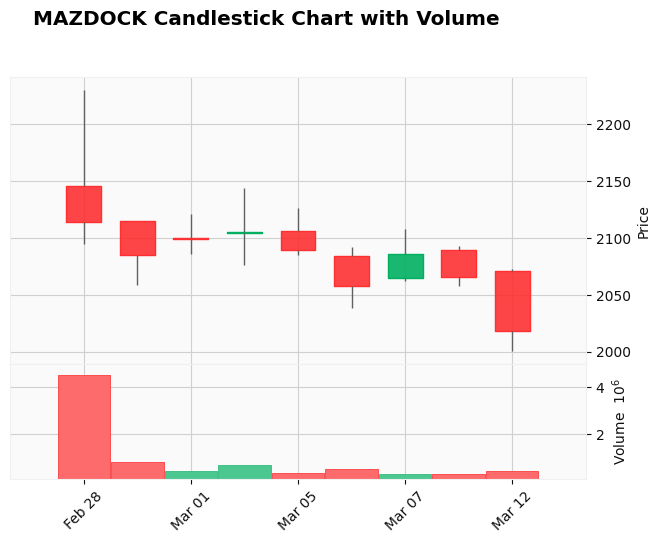

RAMCOSYS
2024-02-28 00:00:00


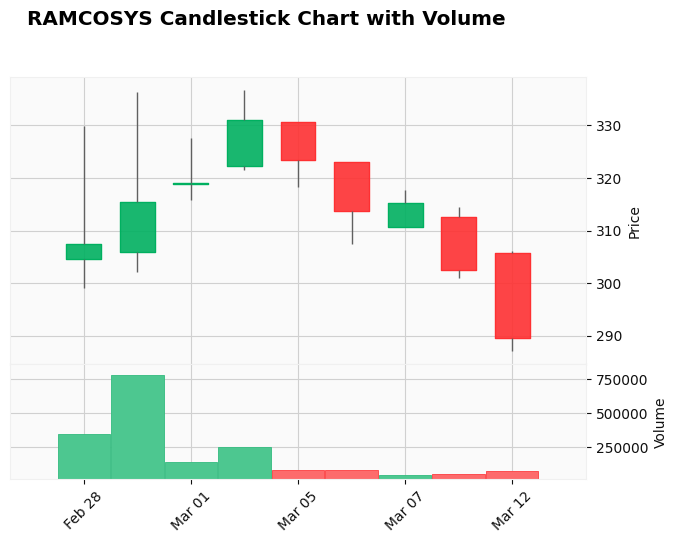

SBIN
2024-02-28 00:00:00


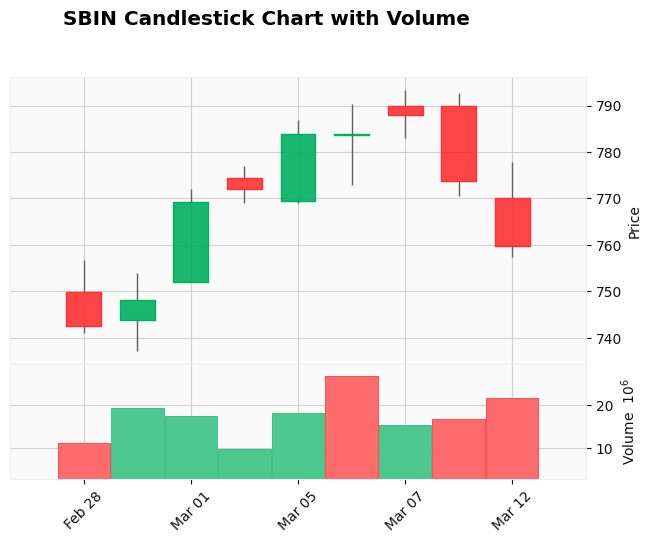

TATAMOTORS
2024-02-28 00:00:00


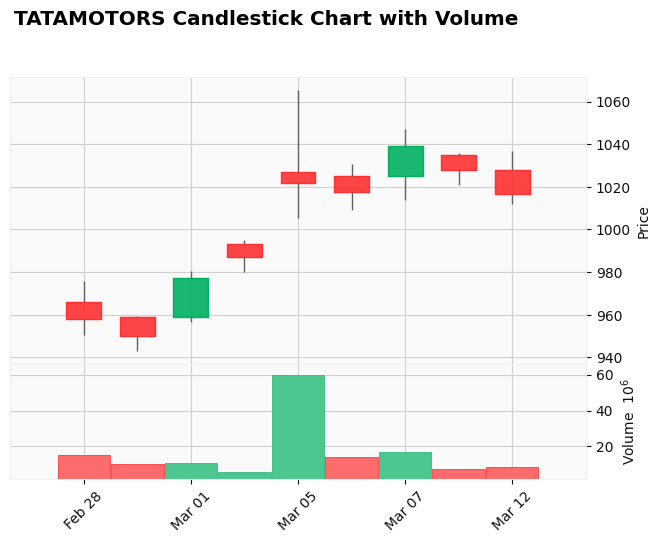

BAJFINANCE
2024-02-27 00:00:00


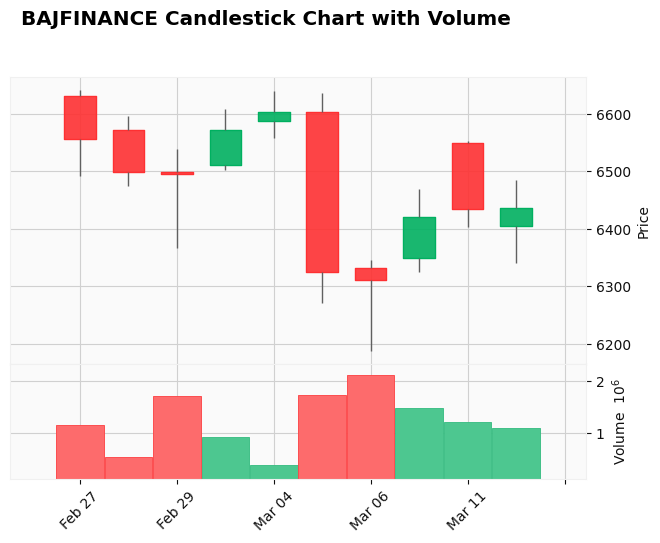

BAJFINANCE
2024-02-27 00:00:00


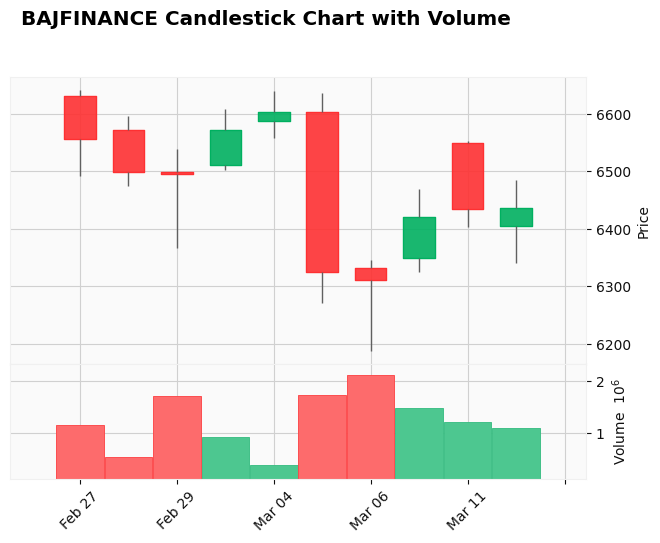

BHARATFORG
2024-02-27 00:00:00


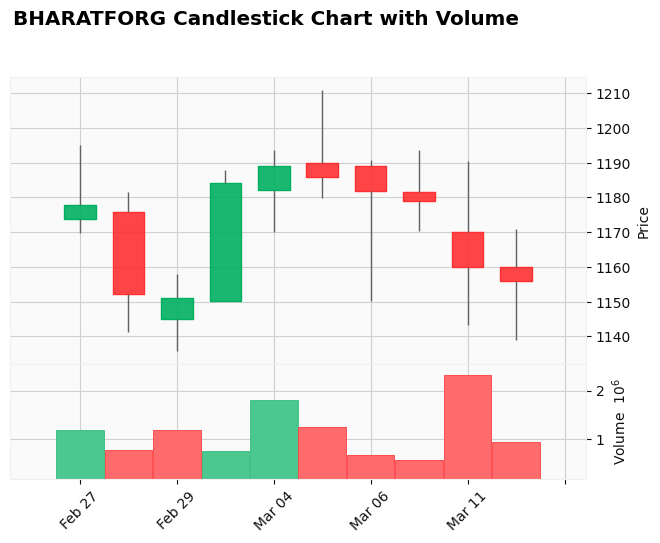

BHARTIARTL
2024-02-27 00:00:00


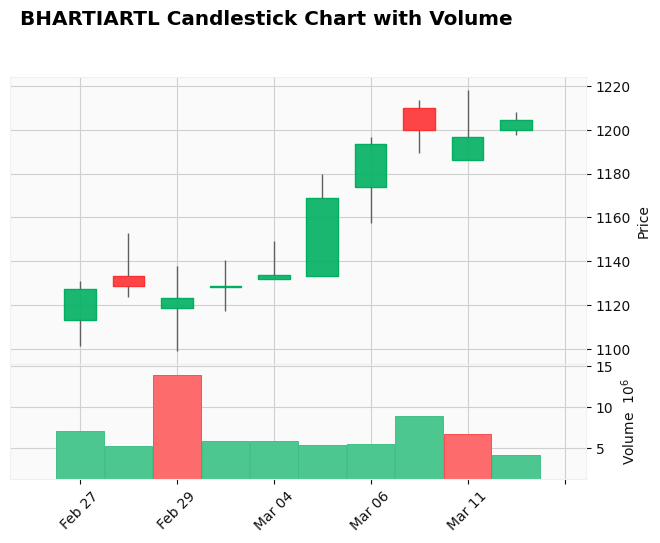

CASTROLIND
2024-02-27 00:00:00


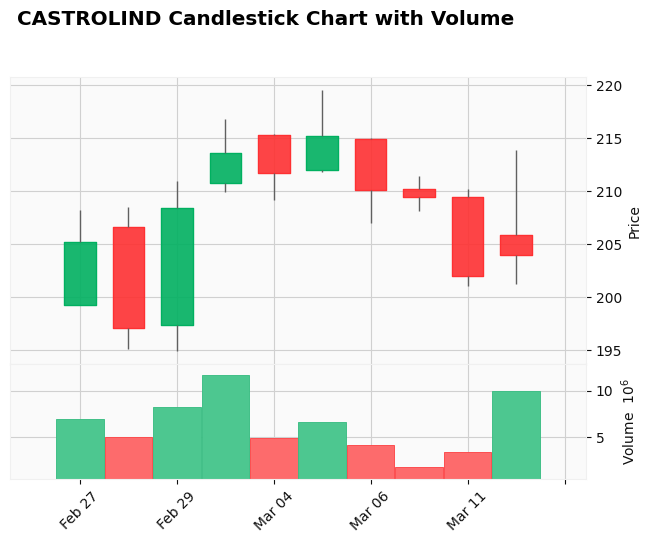

CROMPTON
2024-02-27 00:00:00


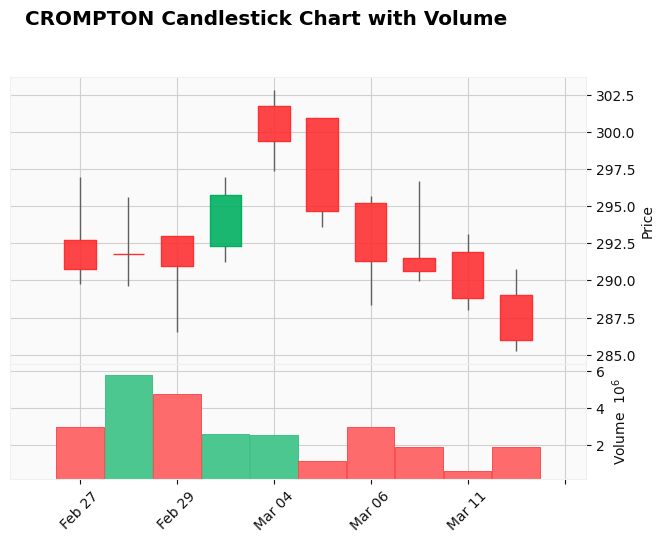

DEEPAKNTR
2024-02-27 00:00:00


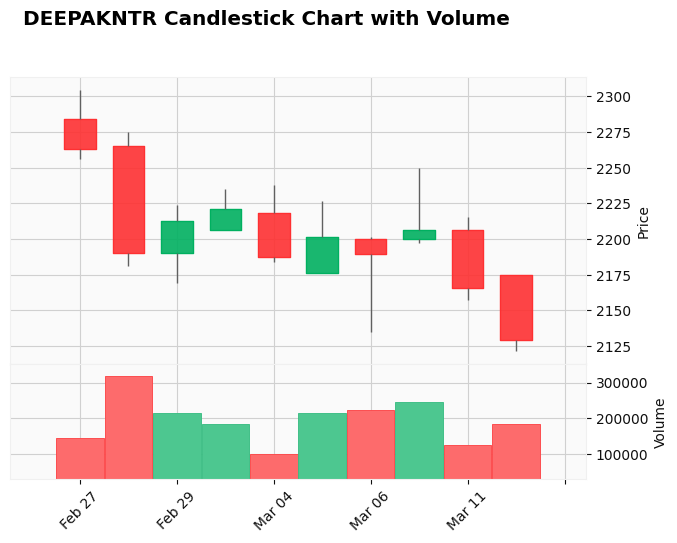

EASEMYTRIP
2024-02-27 00:00:00


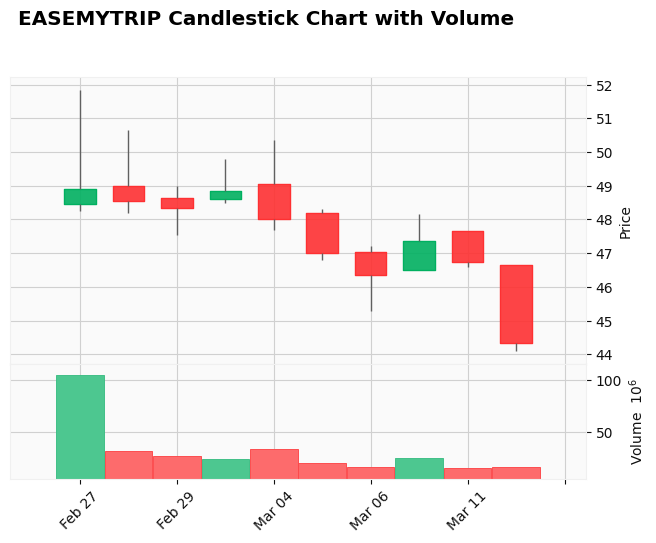

GOLDIAM
2024-02-27 00:00:00


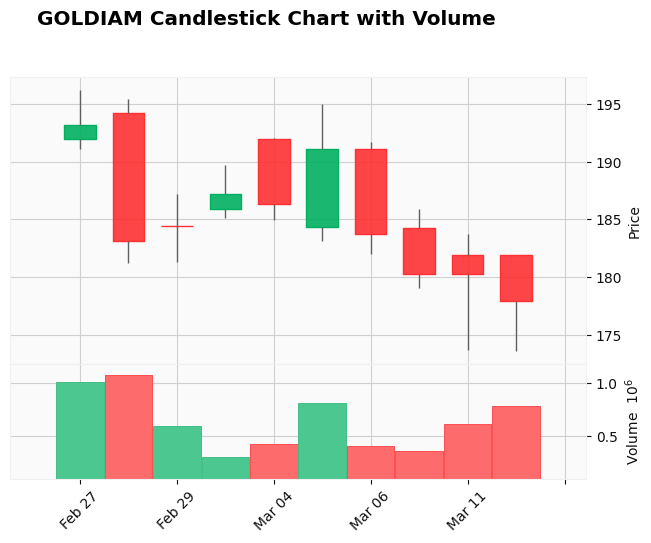

INDUSTOWER
2024-02-27 00:00:00


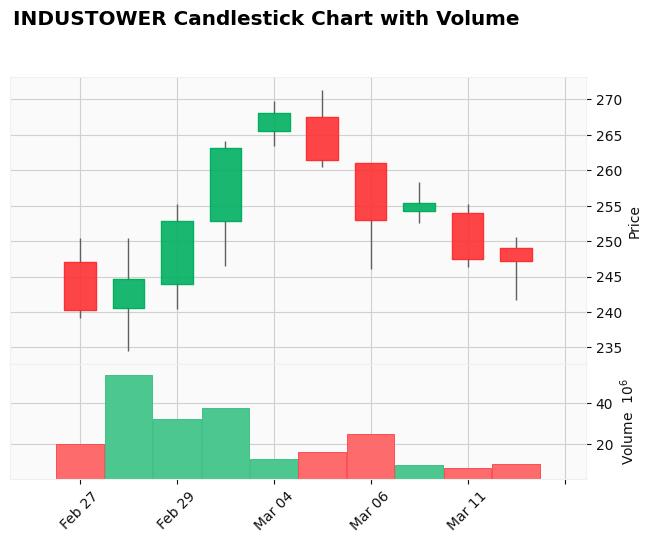

JKLAKSHMI
2024-02-27 00:00:00


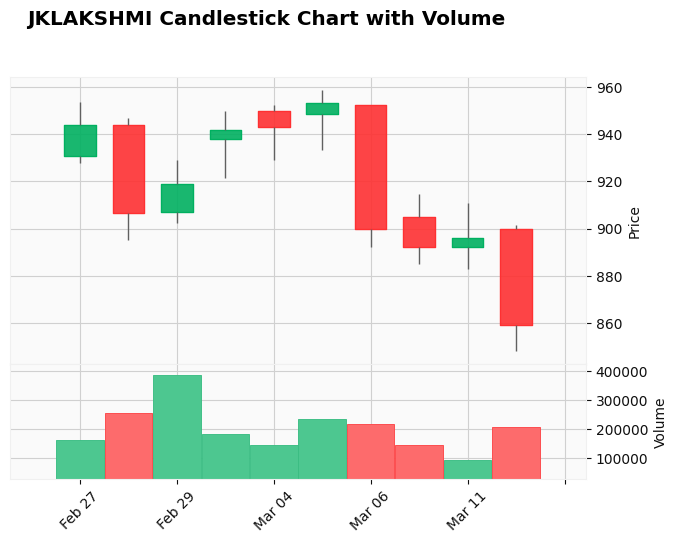

JMFINANCIL
2024-02-27 00:00:00


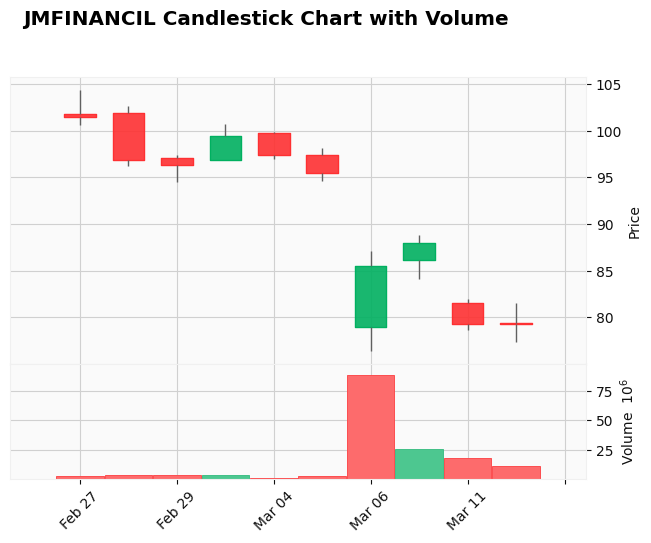

LICHSGFIN
2024-02-27 00:00:00


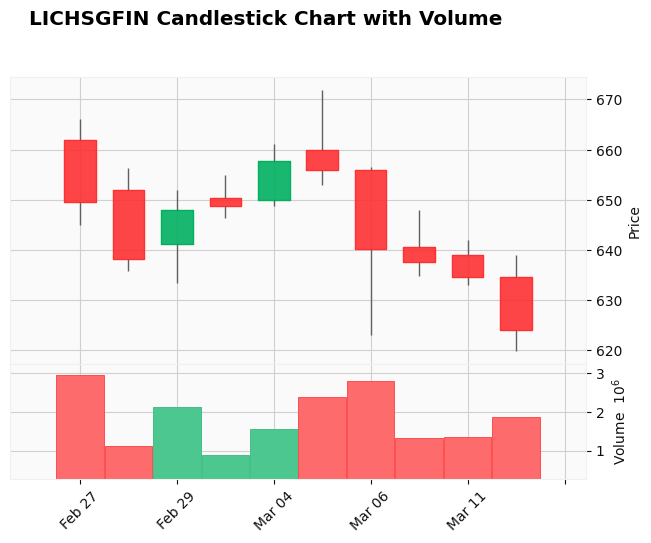

PAISALO
2024-02-27 00:00:00


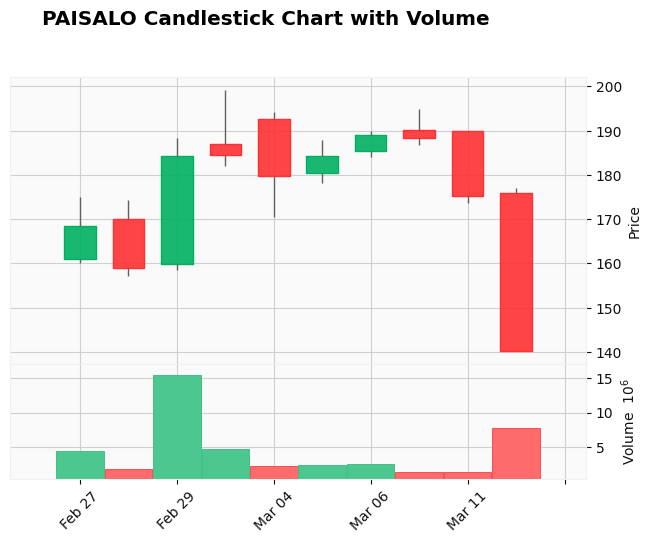

ADANIENT
2024-02-26 00:00:00


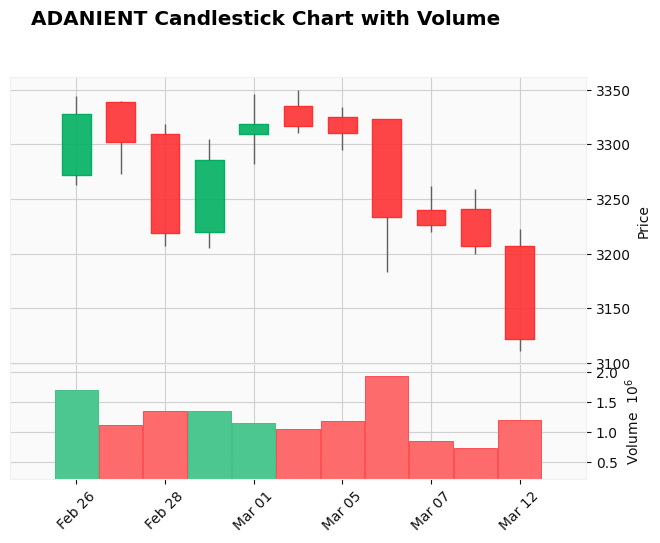

BALRAMCHIN
2024-02-26 00:00:00


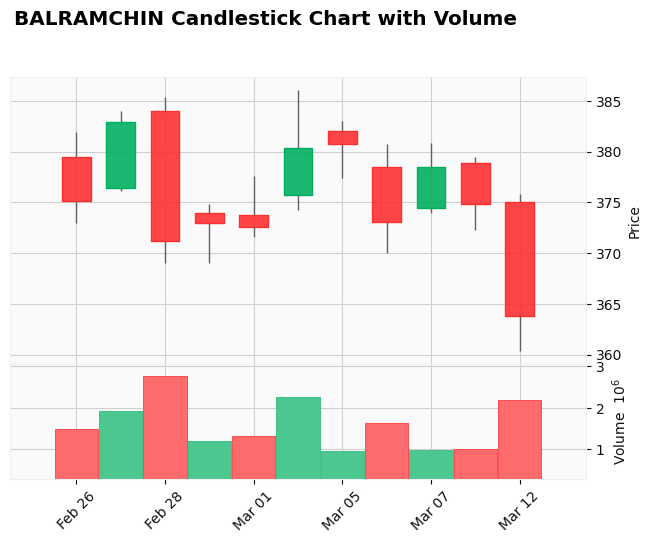

CEATLTD
2024-02-26 00:00:00


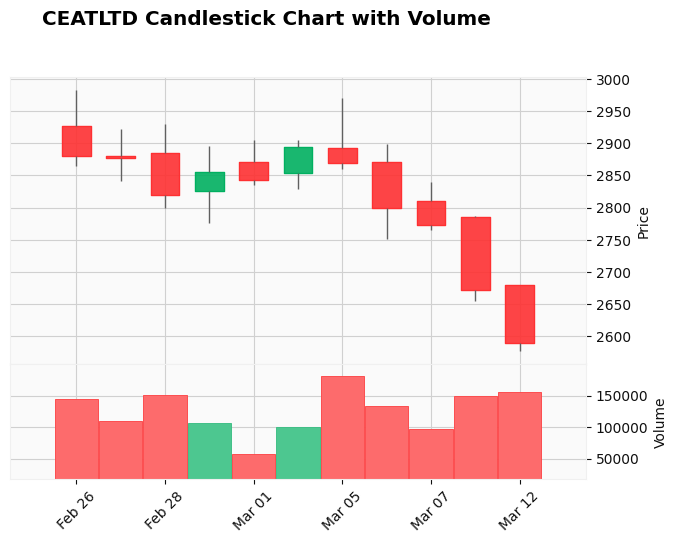

CAMS
2024-02-26 00:00:00


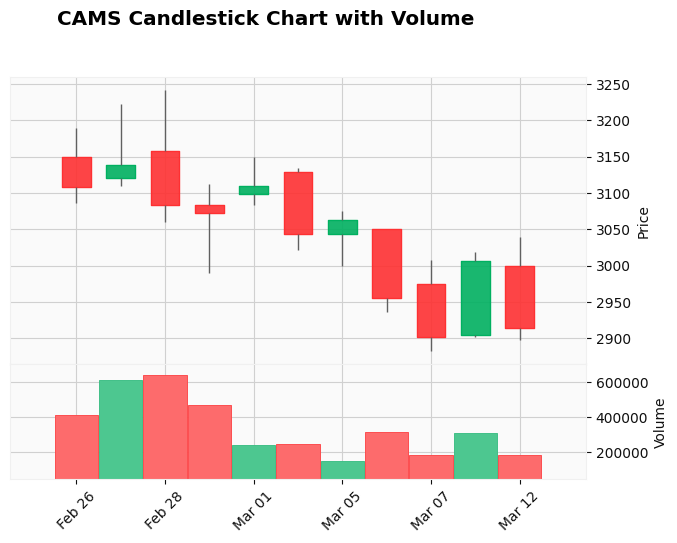

CREDITACC
2024-02-26 00:00:00


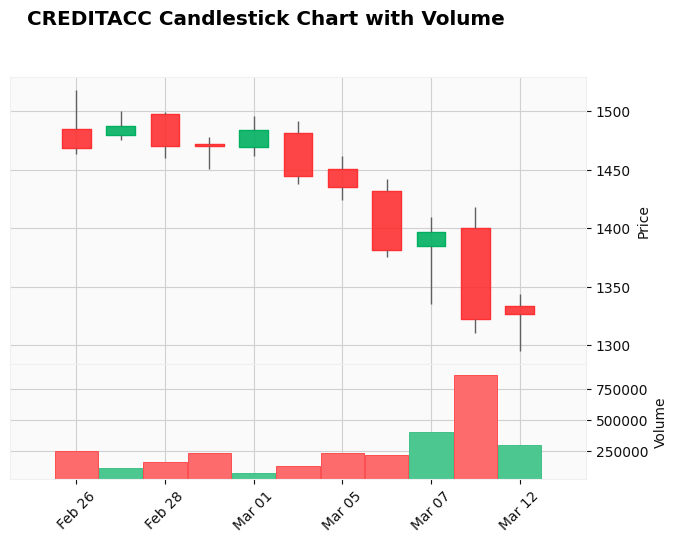

GENSOL
2024-02-26 00:00:00


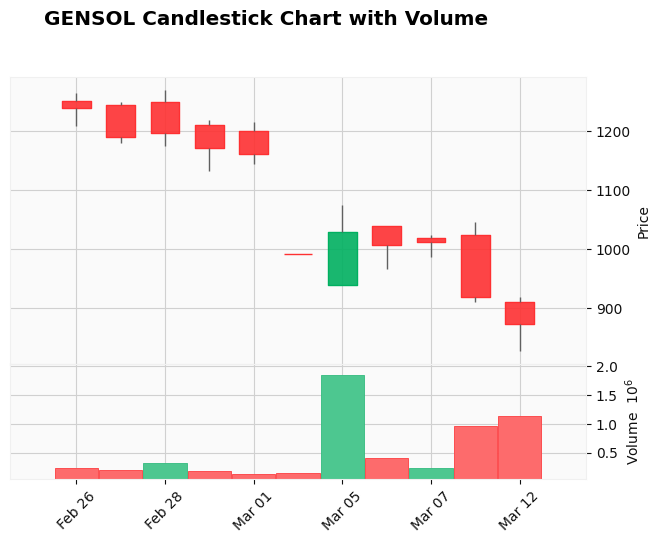

ICICIBANK
2024-02-26 00:00:00


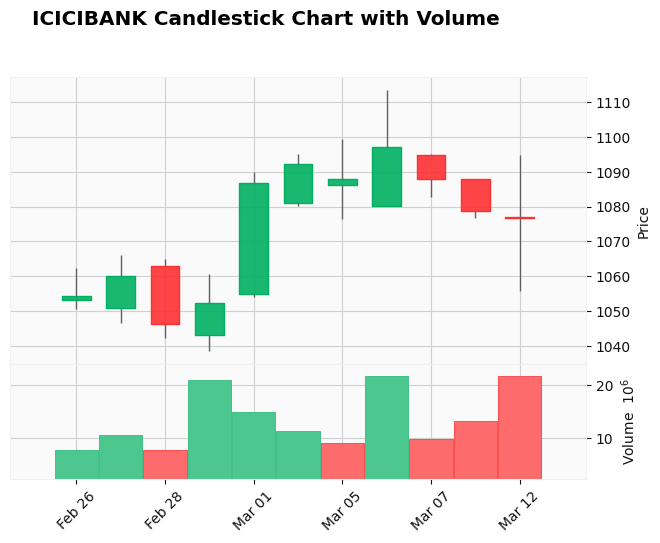

ICIL
2024-02-26 00:00:00


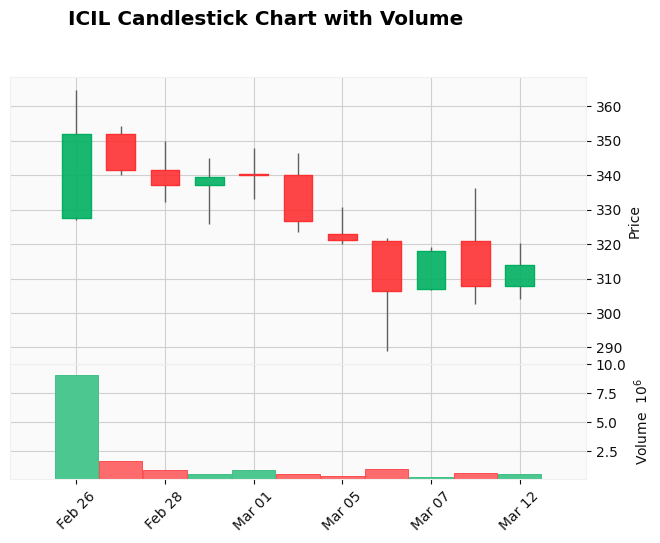

INTELLECT
2024-02-26 00:00:00


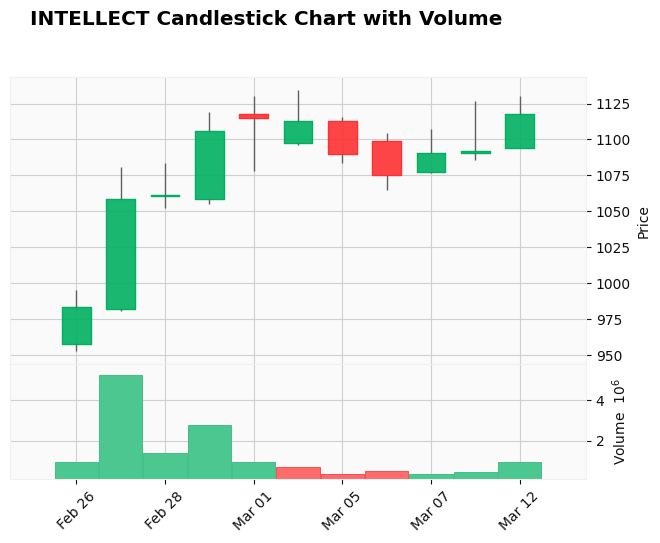

INDIGO
2024-02-26 00:00:00


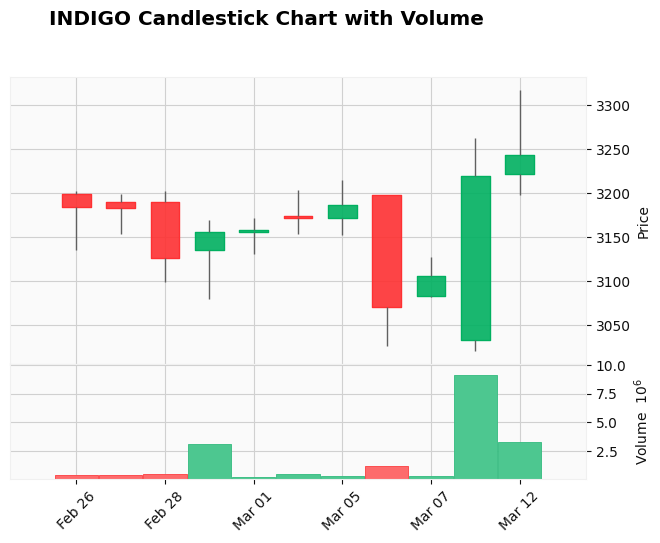

POWERGRID
2024-02-26 00:00:00


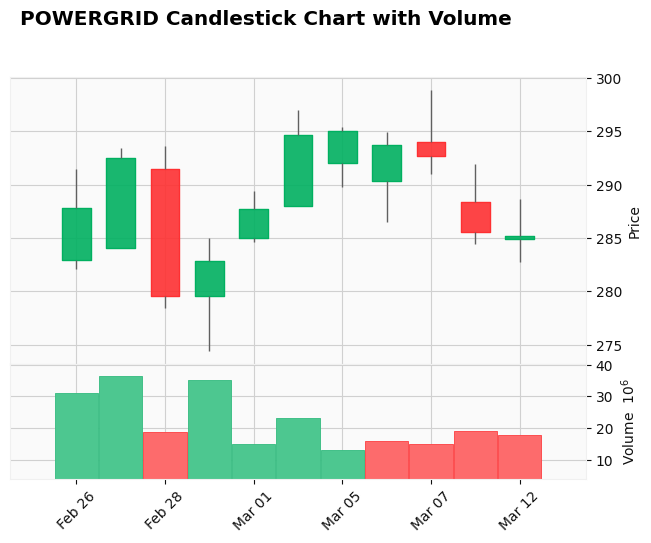

RELIANCE
2024-02-26 00:00:00


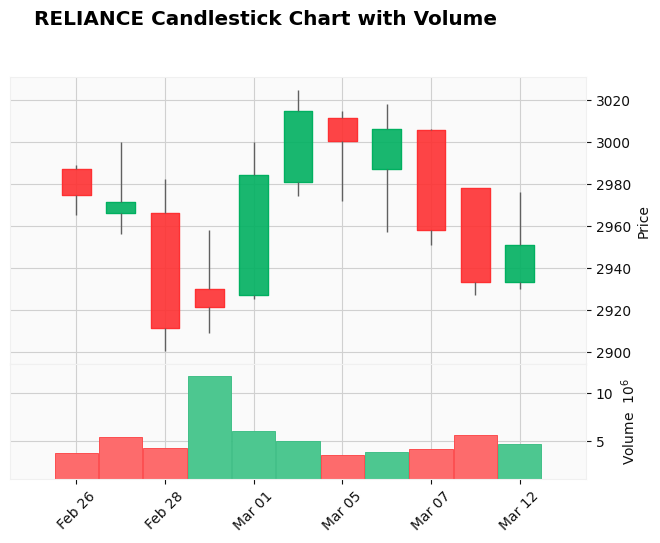

RELIANCE
2024-02-26 00:00:00


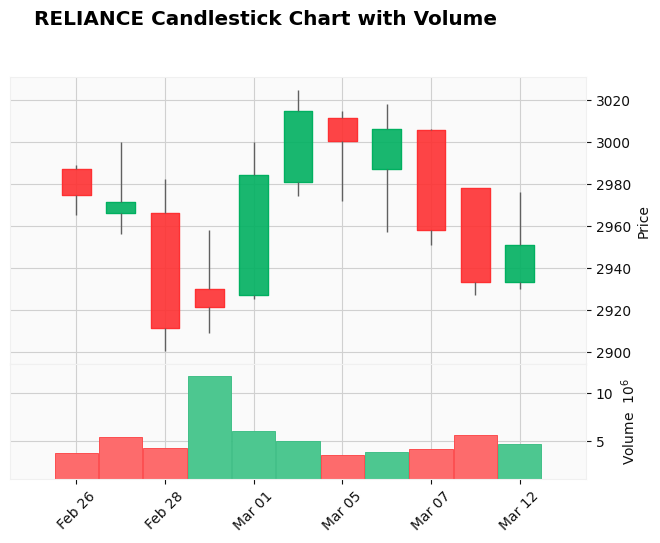

SHILPAMED
2024-02-26 00:00:00


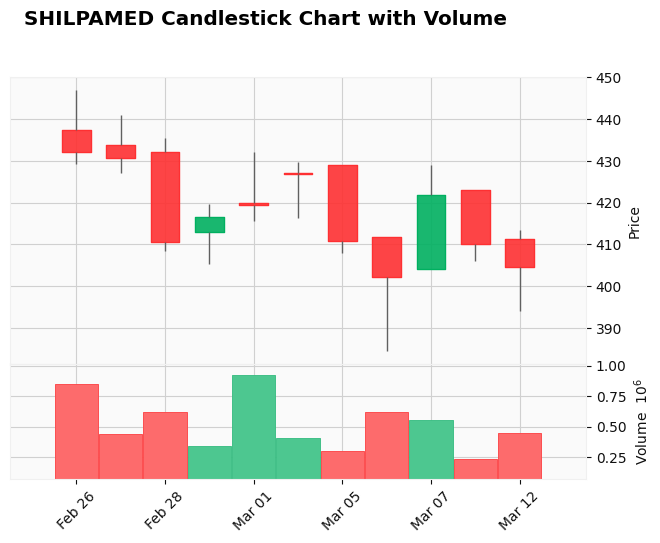

TFCILTD
2024-02-26 00:00:00


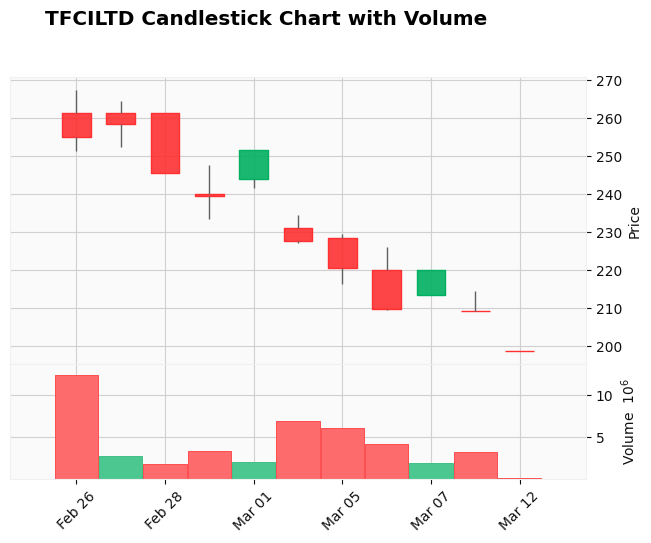

TVSMOTOR
2024-02-26 00:00:00


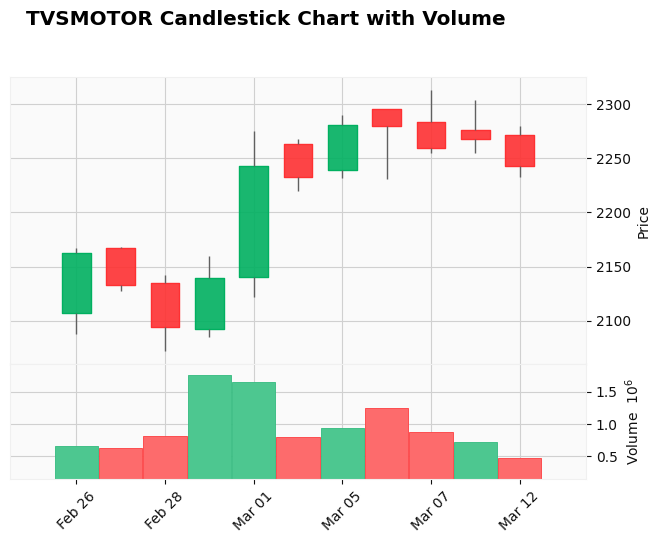

GRASIM
2024-02-23 00:00:00


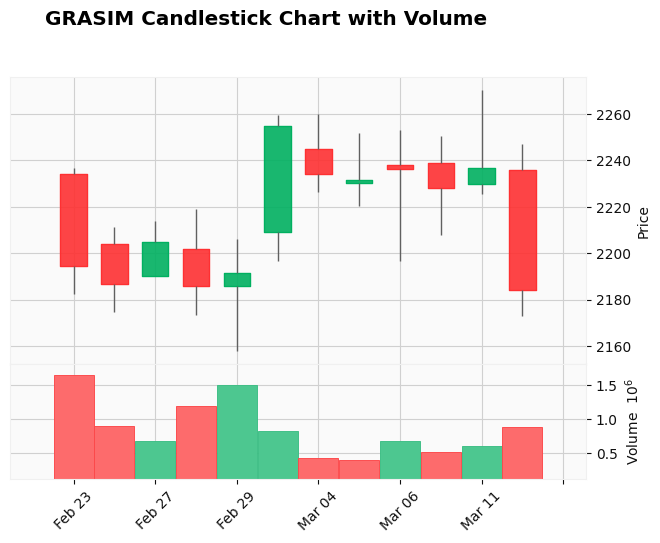

HINDPETRO
2024-02-23 00:00:00


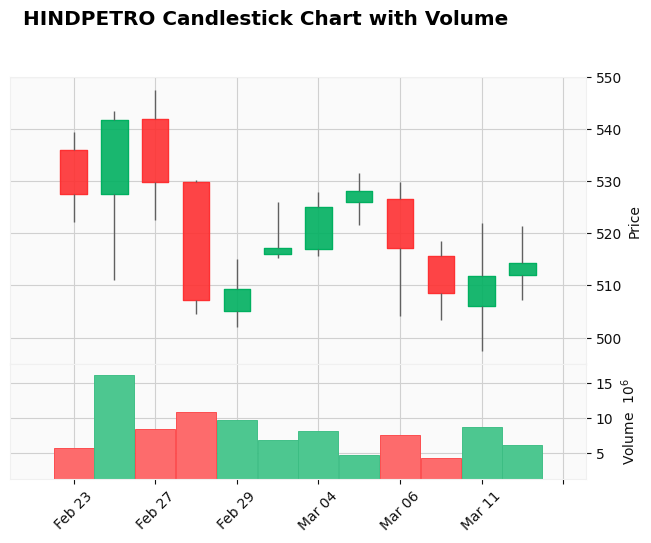

ICICIBANK
2024-02-23 00:00:00


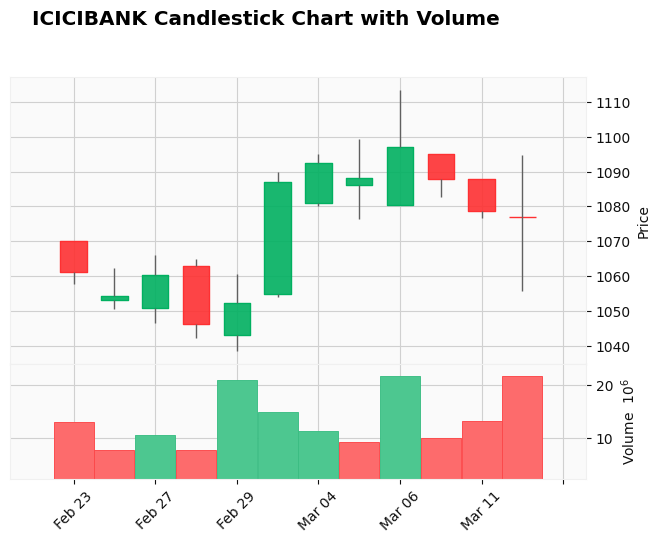

INTELLECT
2024-02-23 00:00:00


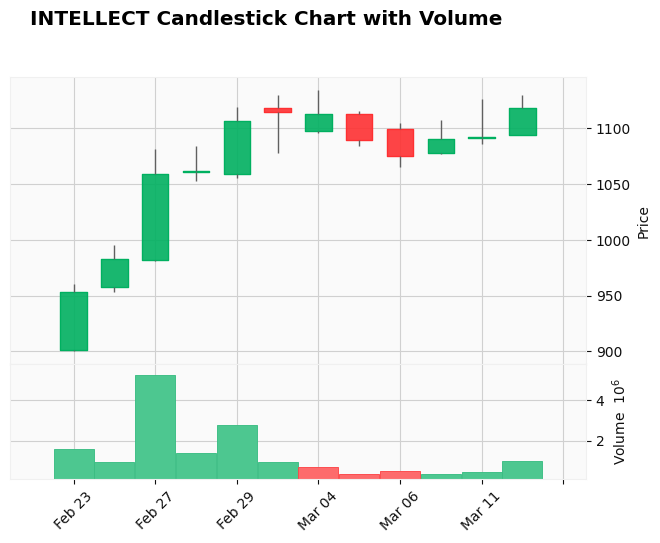

INTELLECT
2024-02-23 00:00:00


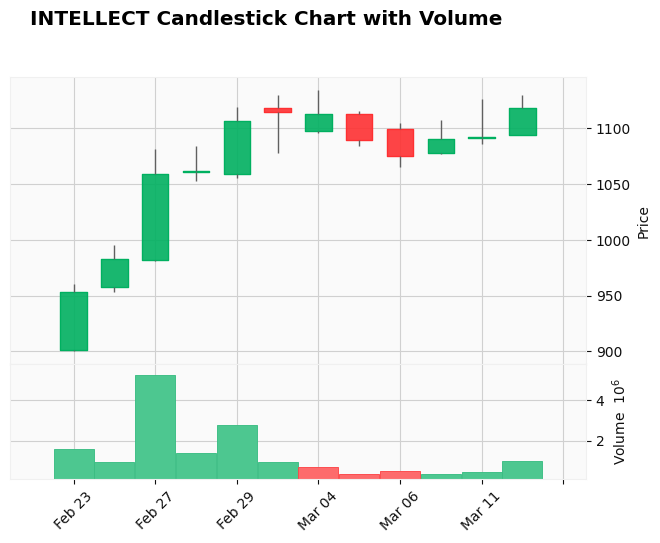

ORCHPHARMA
2024-02-23 00:00:00


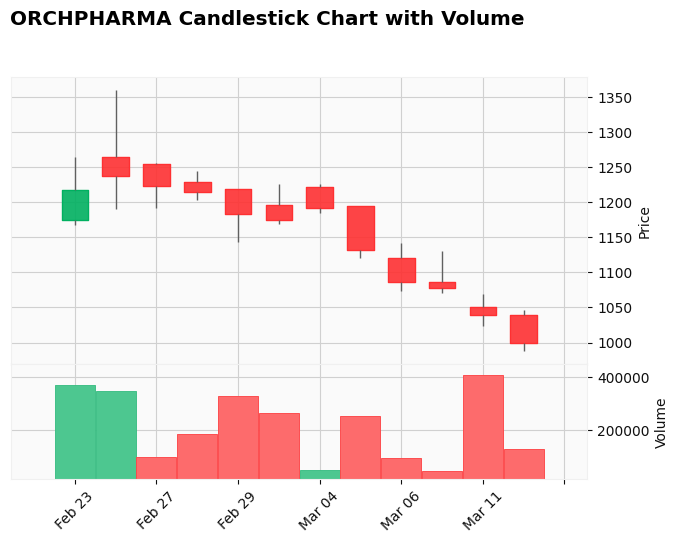

ORCHPHARMA
2024-02-23 00:00:00


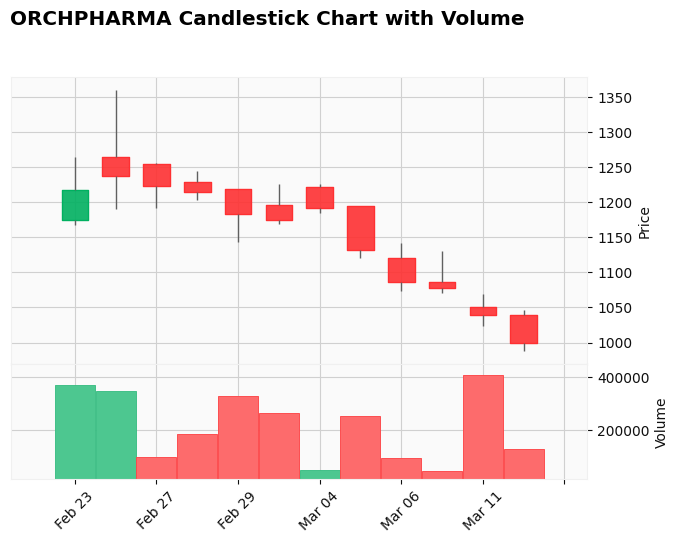

RIIL
2024-02-23 00:00:00


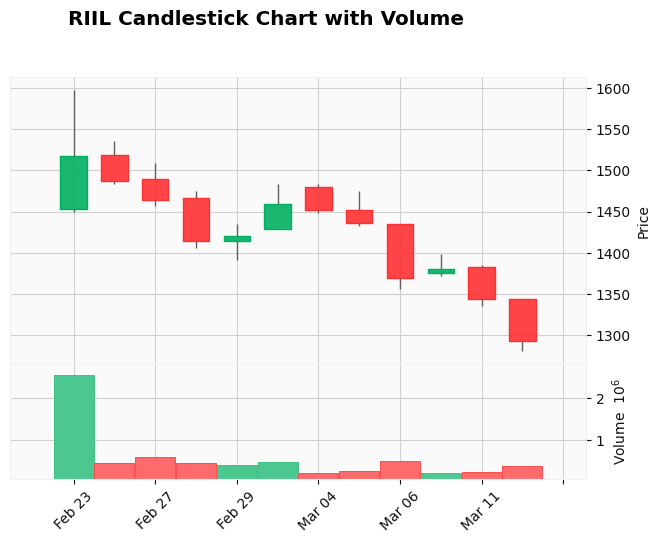

ZEEL
2024-02-23 00:00:00


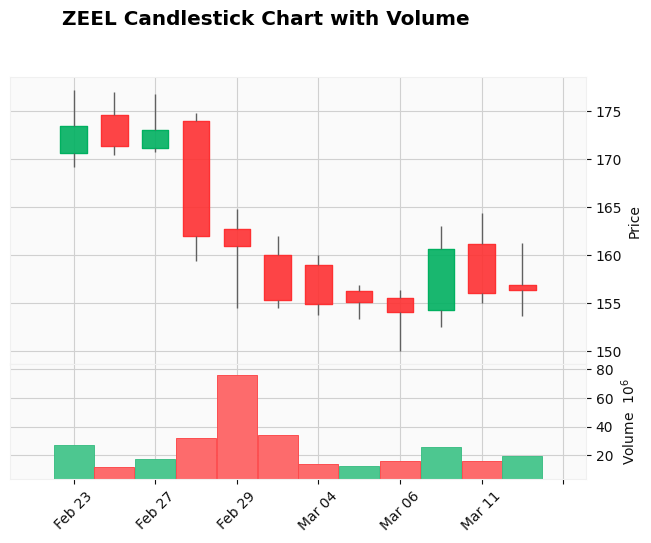

ABB
2024-02-22 00:00:00


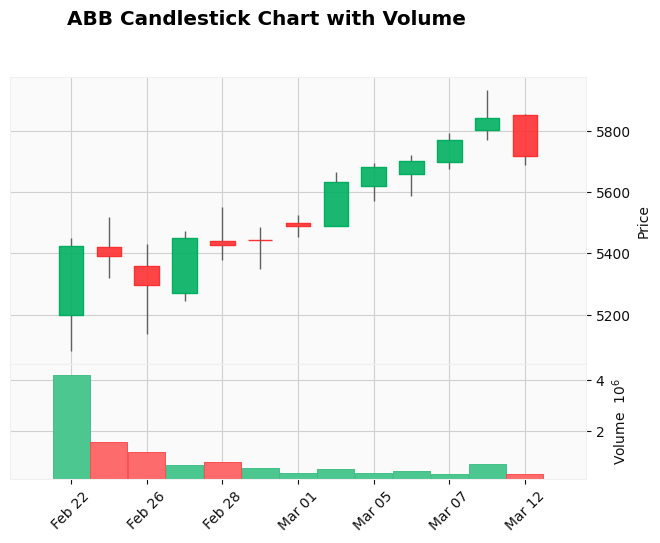

ABB
2024-02-22 00:00:00


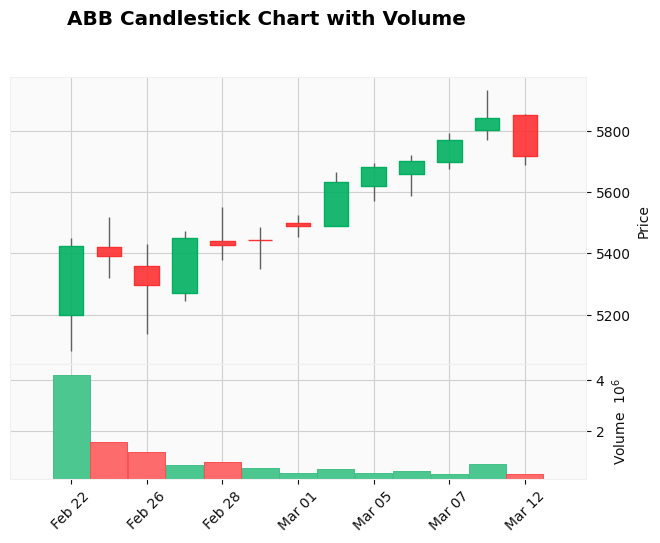

ABB
2024-02-22 00:00:00


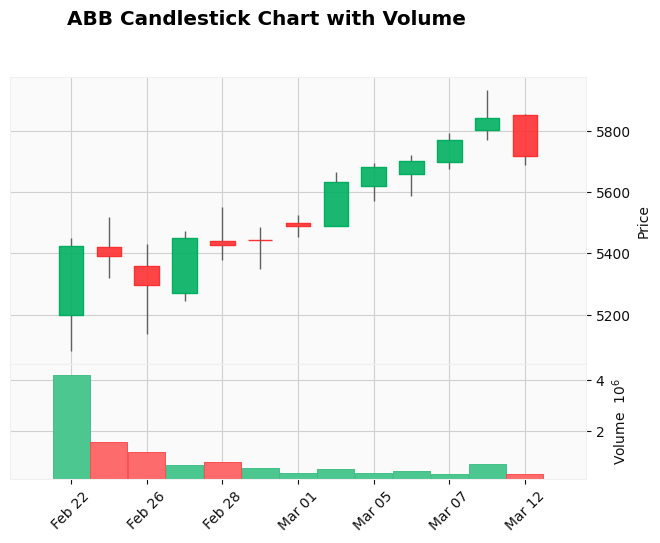

BRIGADE
2024-02-22 00:00:00


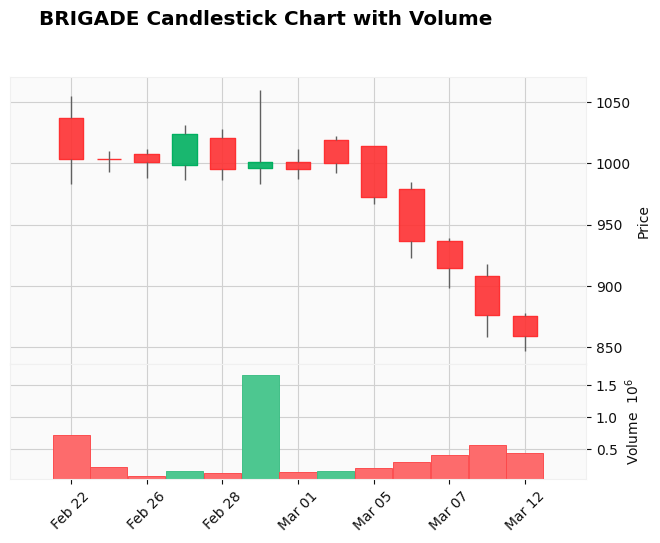

GEOJITFSL
2024-02-22 00:00:00


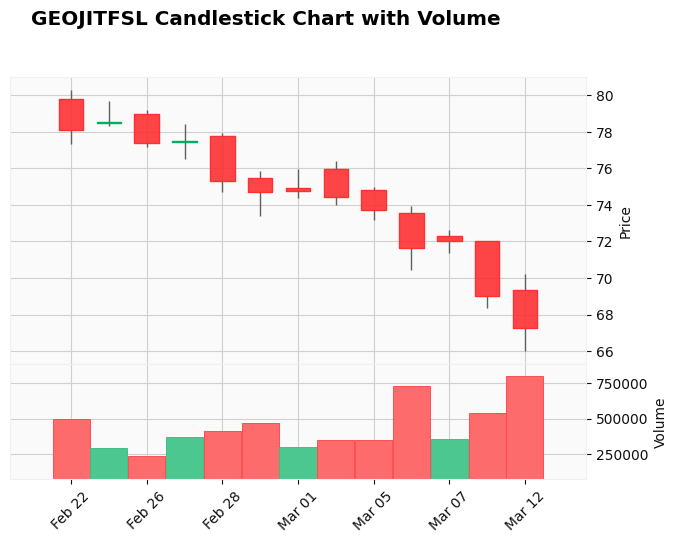

GEOJITFSL
2024-02-22 00:00:00


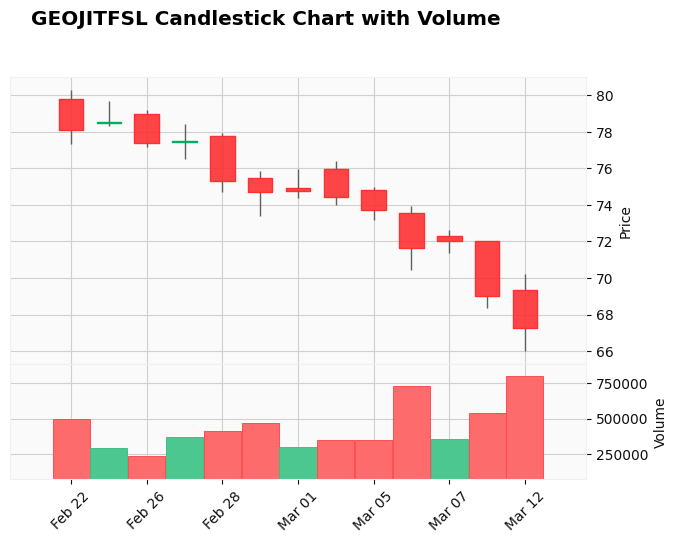

GRASIM
2024-02-22 00:00:00


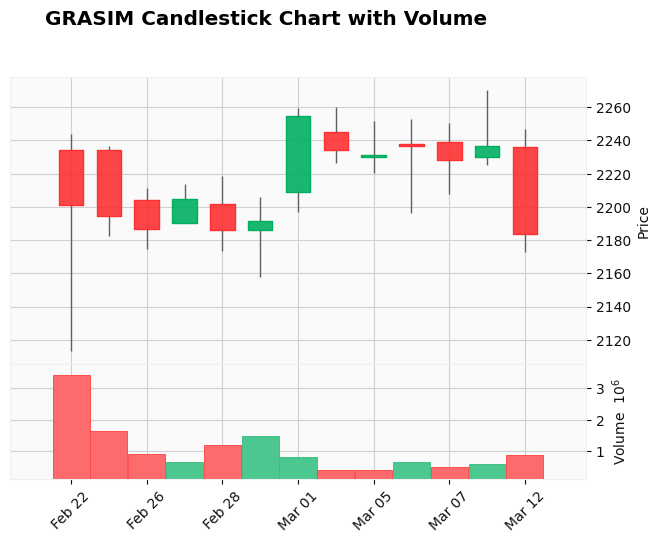

GRASIM
2024-02-22 00:00:00


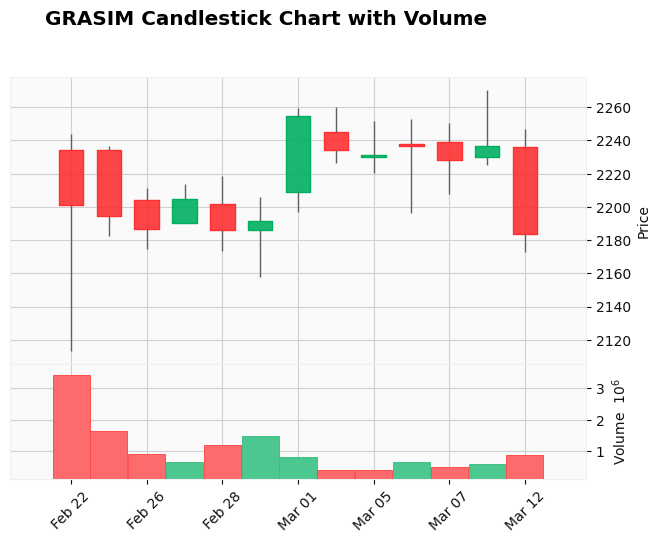

IOC
2024-02-22 00:00:00


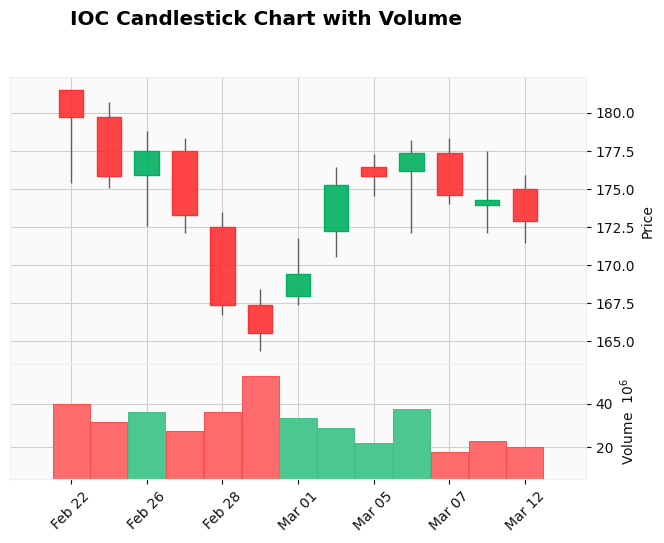

MAHLIFE
2024-02-22 00:00:00


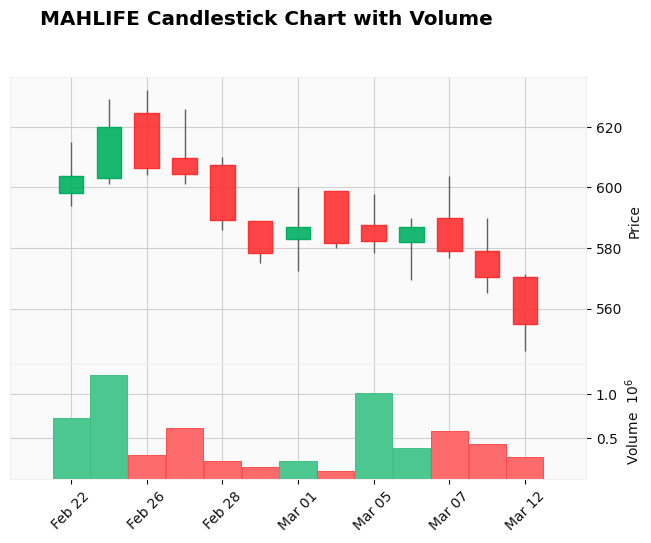

OIL
2024-02-22 00:00:00


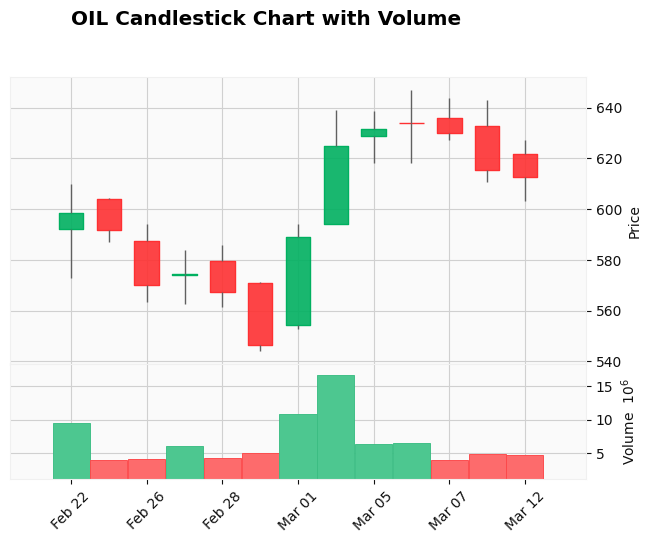

OLECTRA
2024-02-22 00:00:00


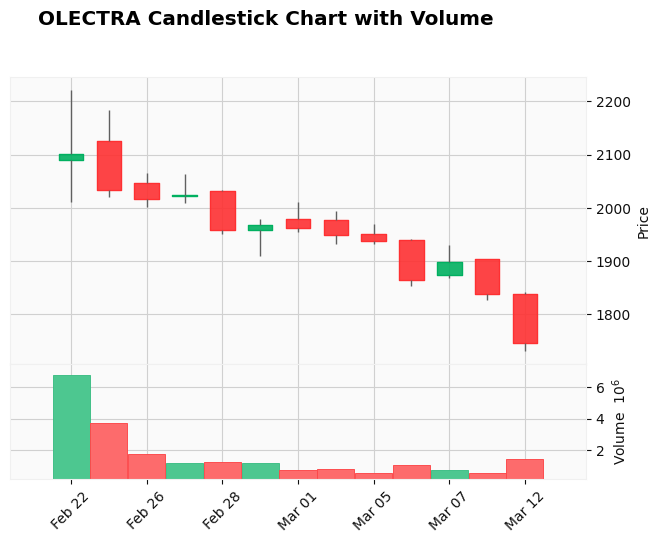

SALZERELEC
2024-02-22 00:00:00


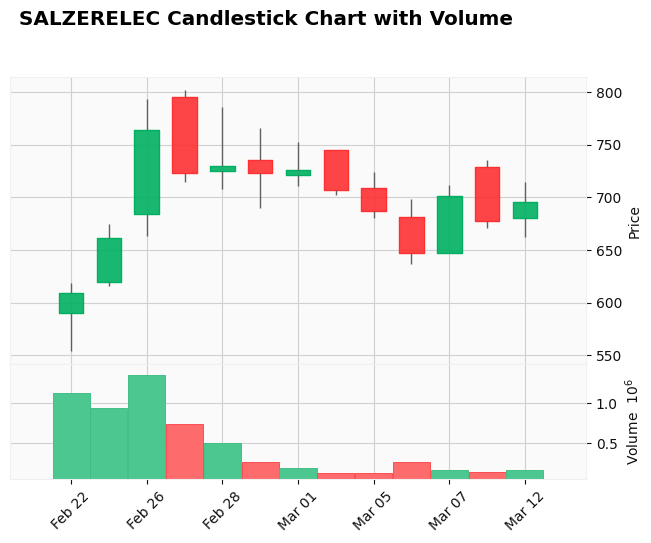

ADANIENT
2024-02-21 00:00:00


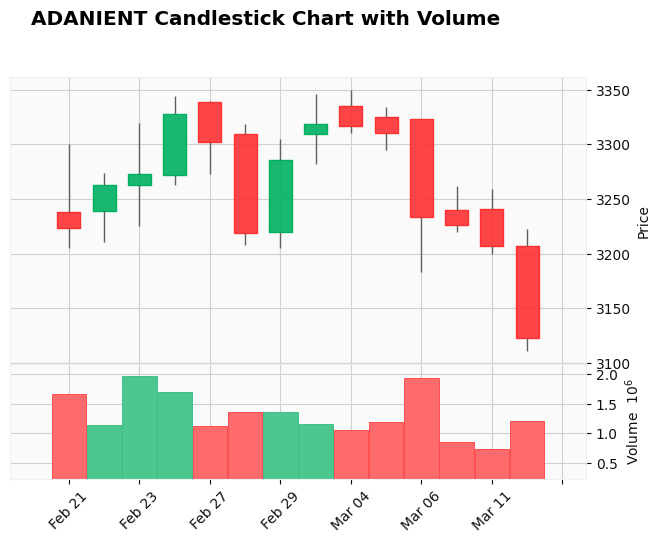

AURIONPRO
2024-02-21 00:00:00


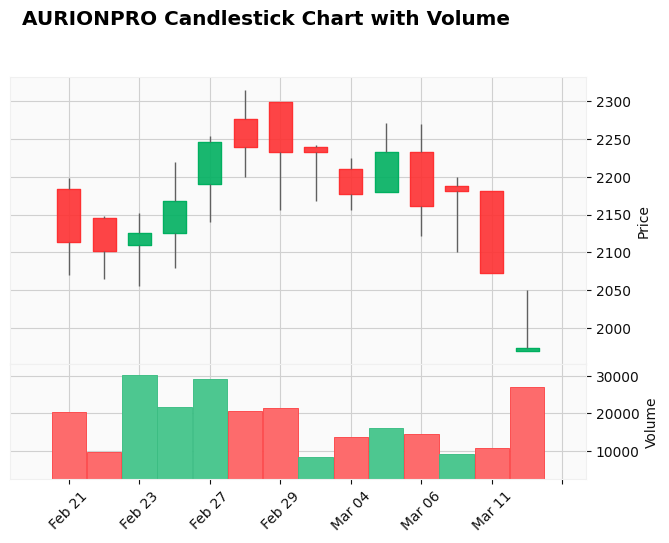

BAJAJELEC
2024-02-21 00:00:00


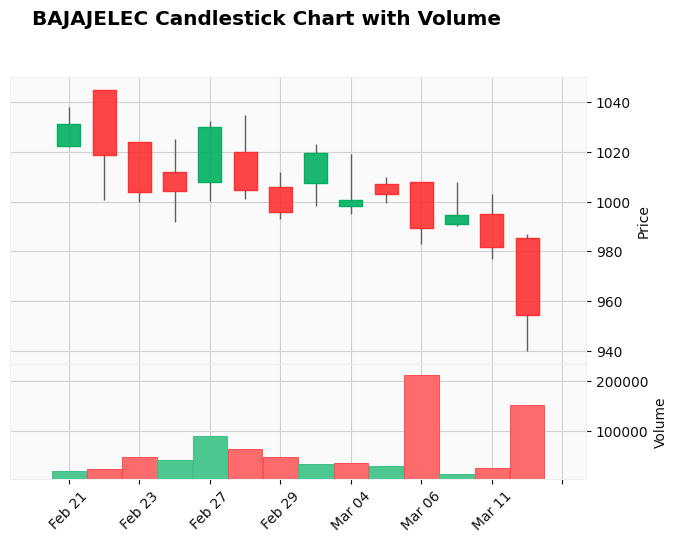

BHARTIARTL
2024-02-21 00:00:00


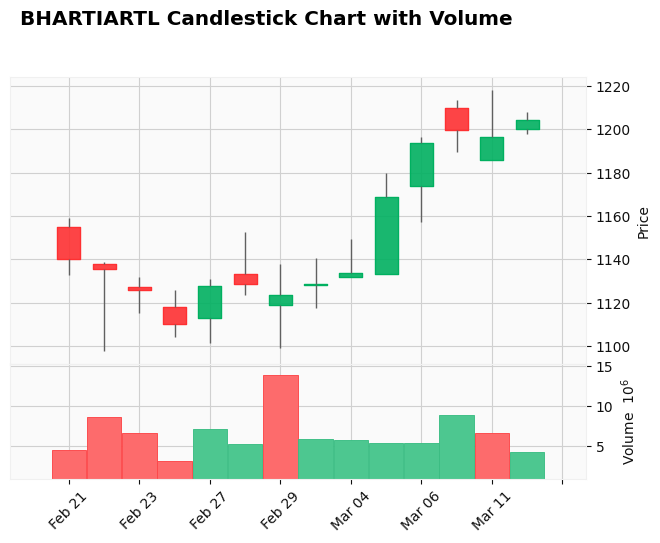

CROMPTON
2024-02-21 00:00:00


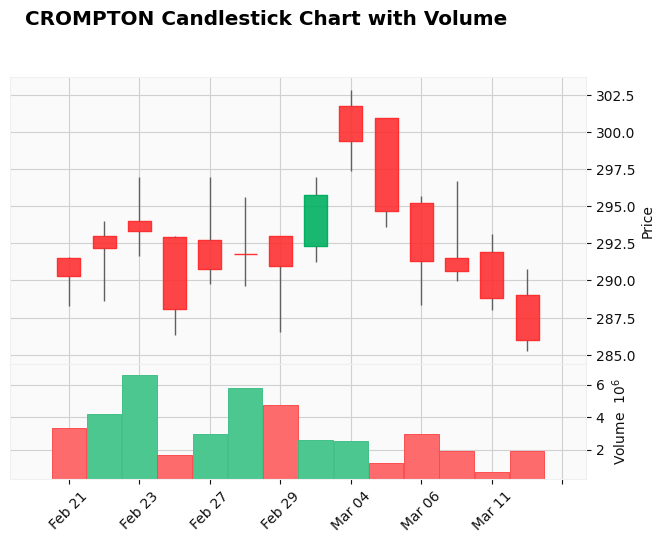

DEEPAKNTR
2024-02-21 00:00:00


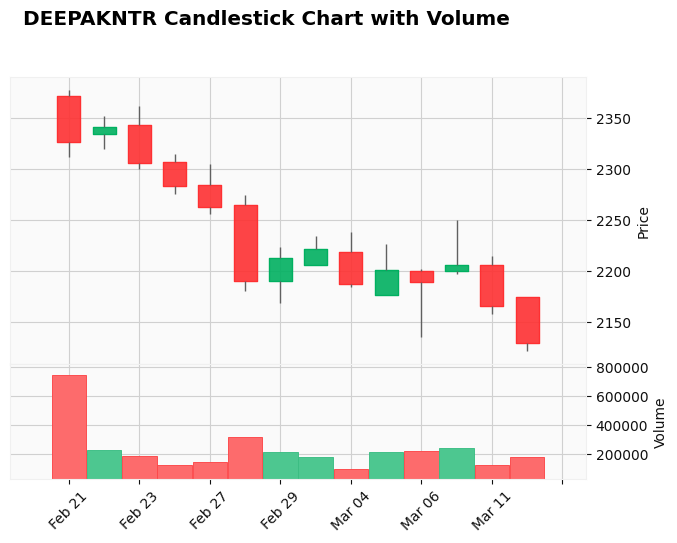

EASEMYTRIP
2024-02-21 00:00:00


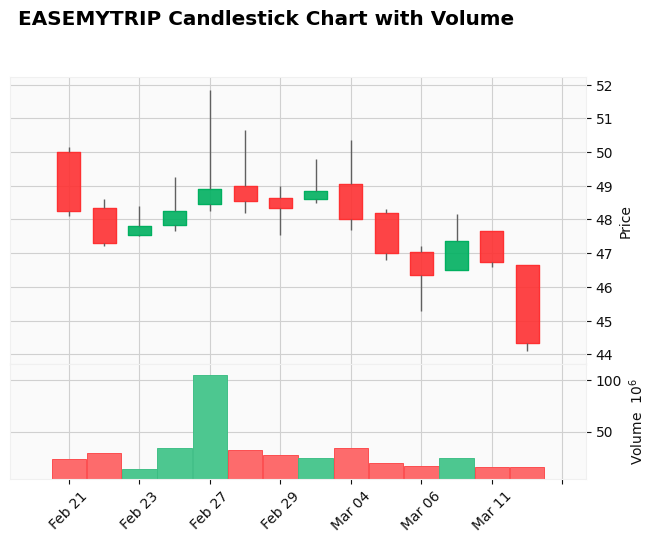

EASEMYTRIP
2024-02-21 00:00:00


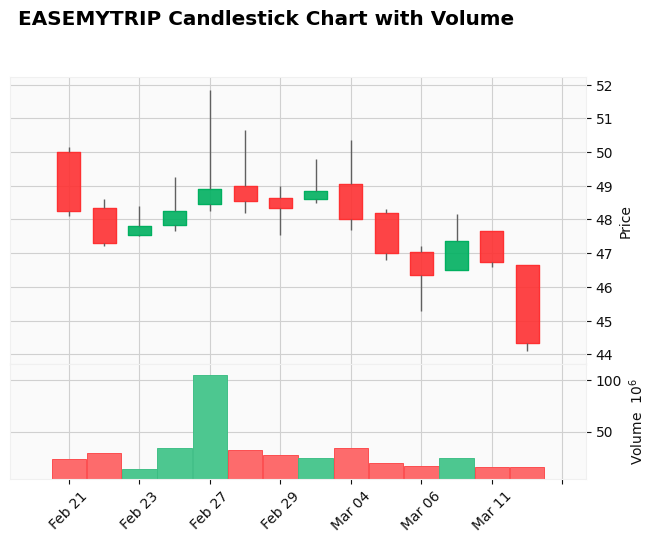

ESAFSFB
2024-02-21 00:00:00


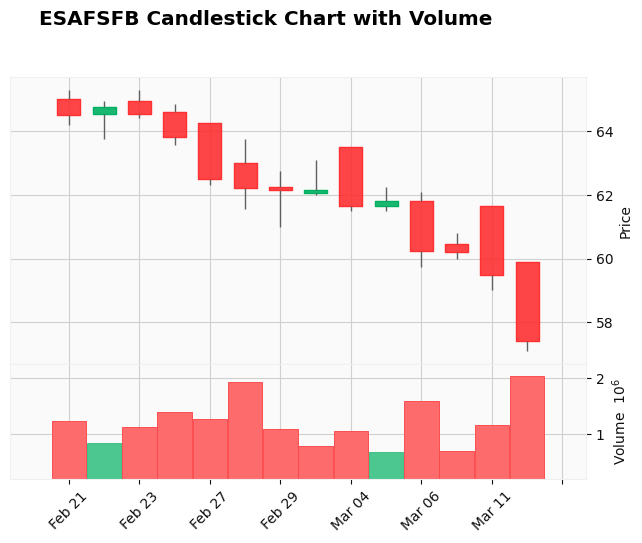

GEOJITFSL
2024-02-21 00:00:00


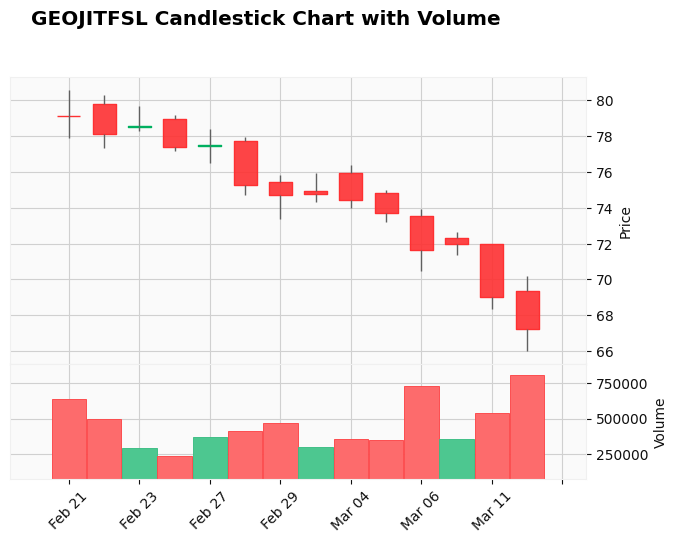

HDFCBANK
2024-02-21 00:00:00


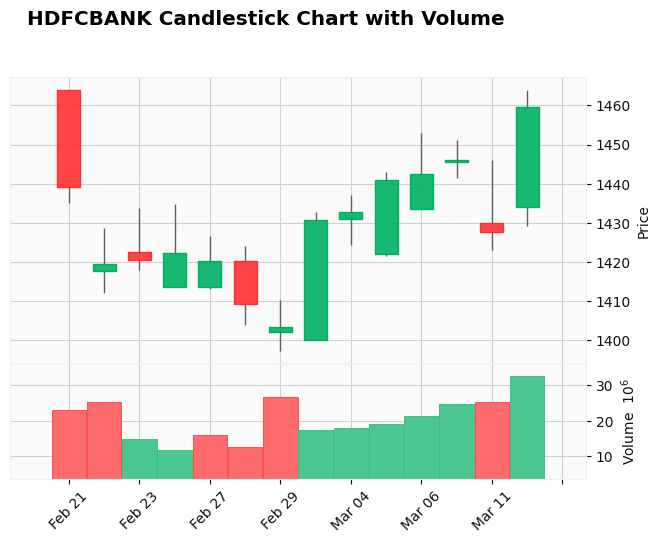

HDFCBANK
2024-02-21 00:00:00


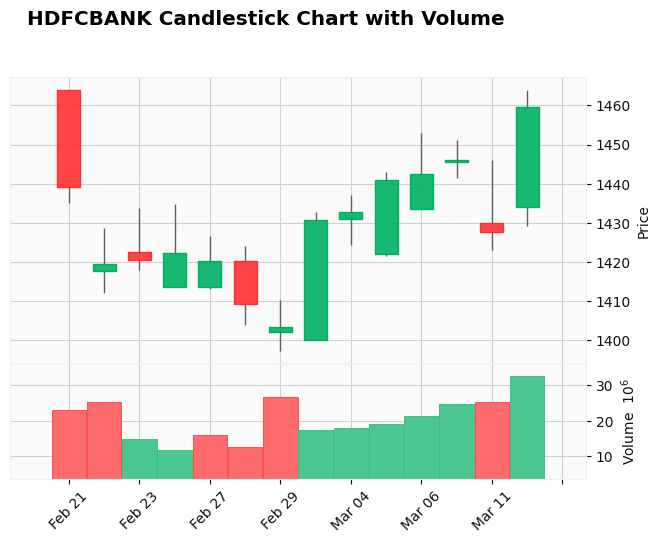

HIMATSEIDE
2024-02-21 00:00:00


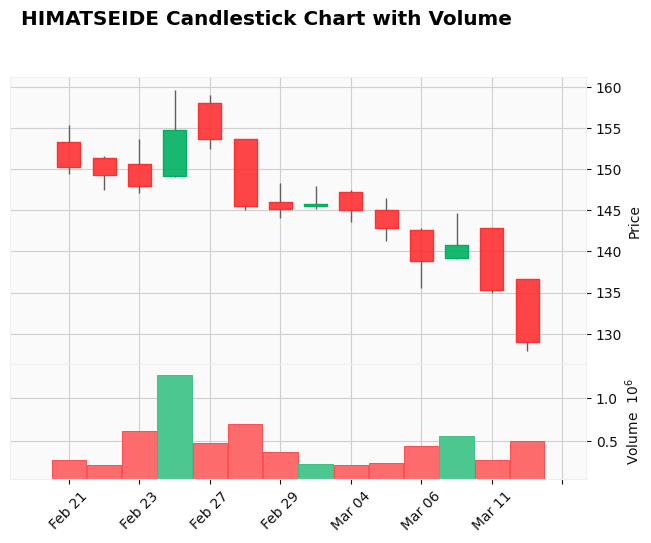

KIRLOSBROS
2024-02-21 00:00:00


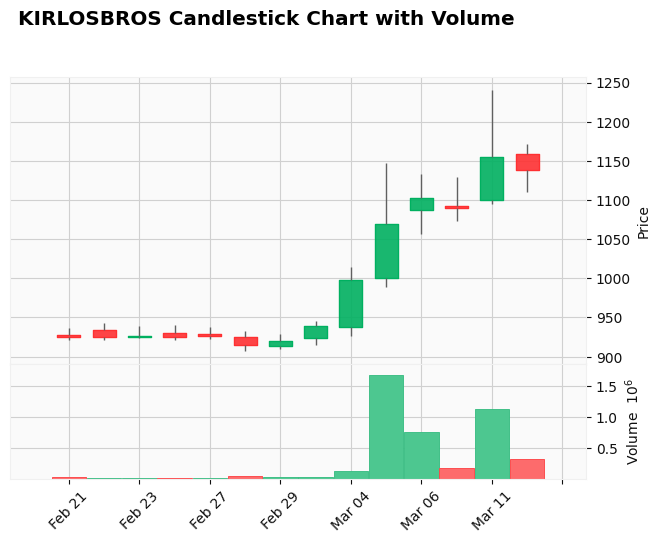

LICHSGFIN
2024-02-21 00:00:00


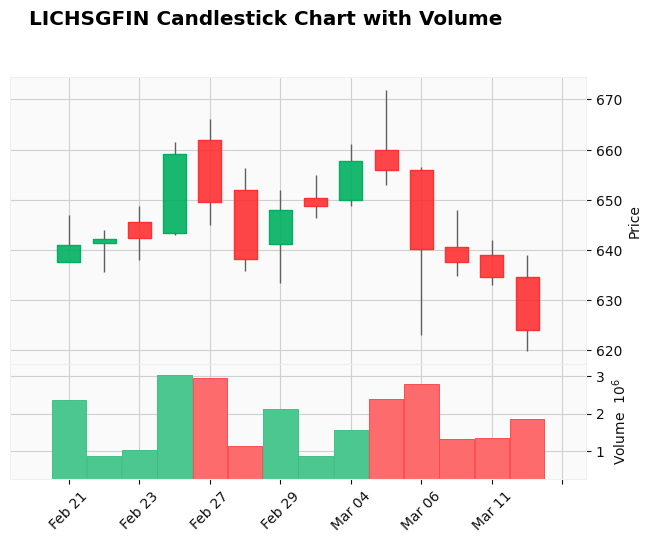

MMFL
2024-02-21 00:00:00


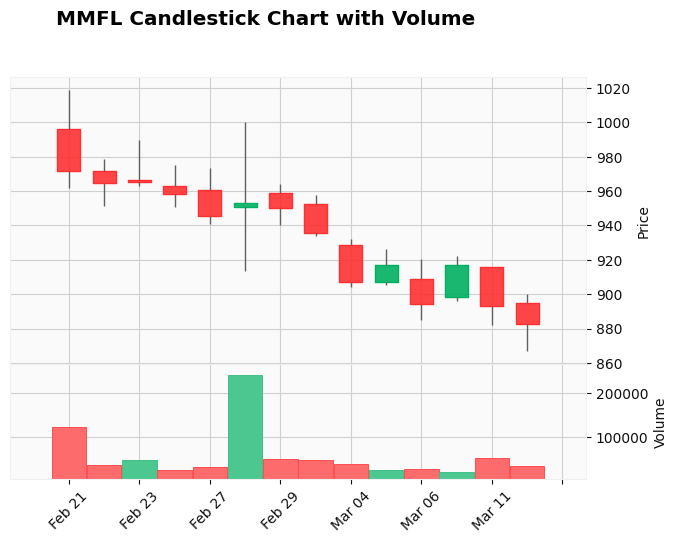

OIL
2024-02-21 00:00:00


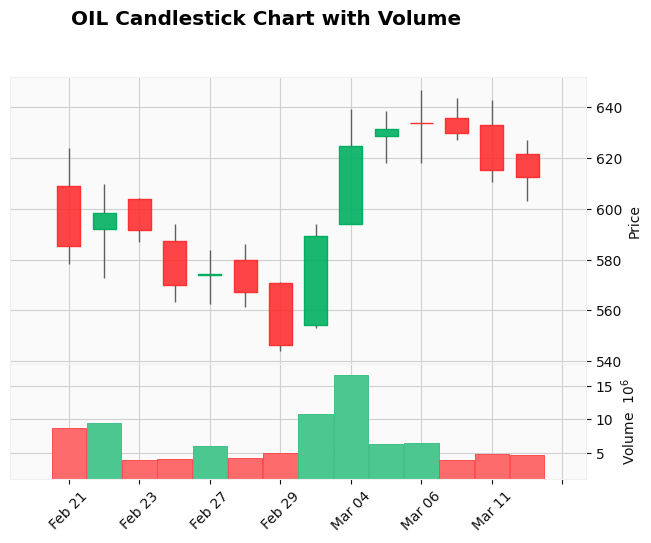

SATIN
2024-02-21 00:00:00


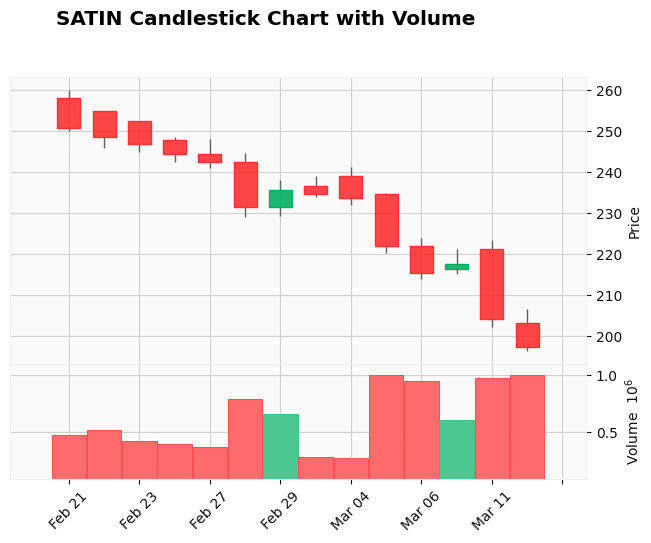

SCHAEFFLER
2024-02-21 00:00:00


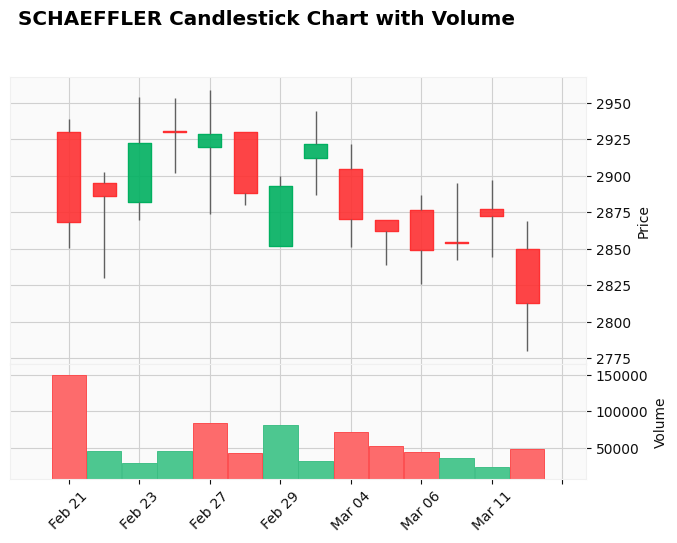

SMCGLOBAL
2024-02-21 00:00:00


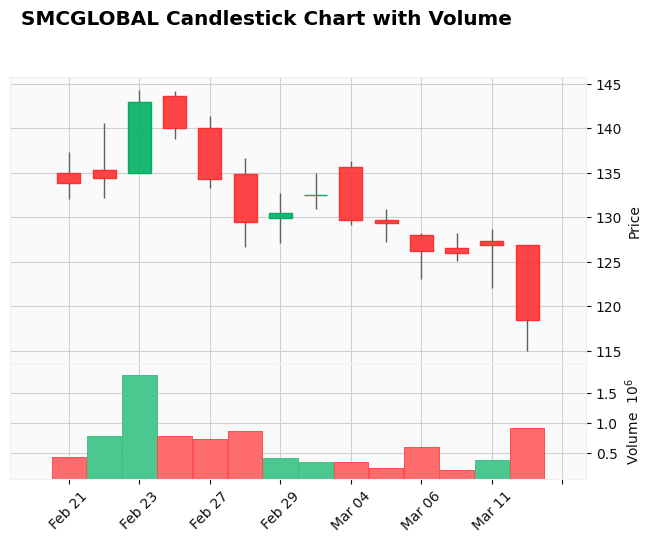

STLTECH
2024-02-21 00:00:00


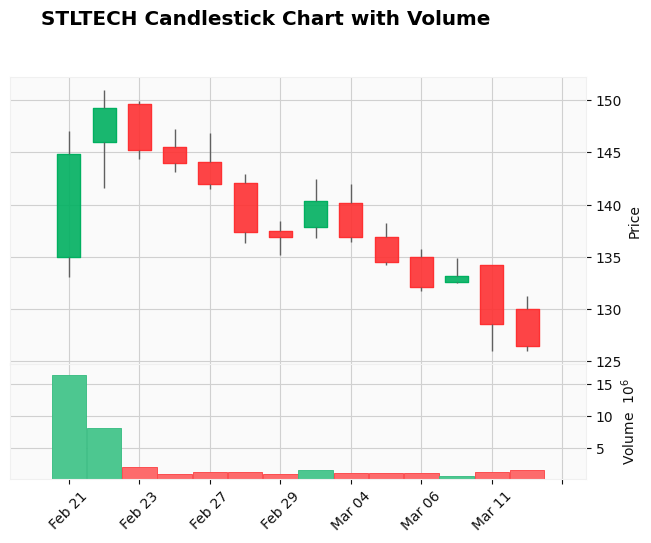

ZENTEC
2024-02-21 00:00:00


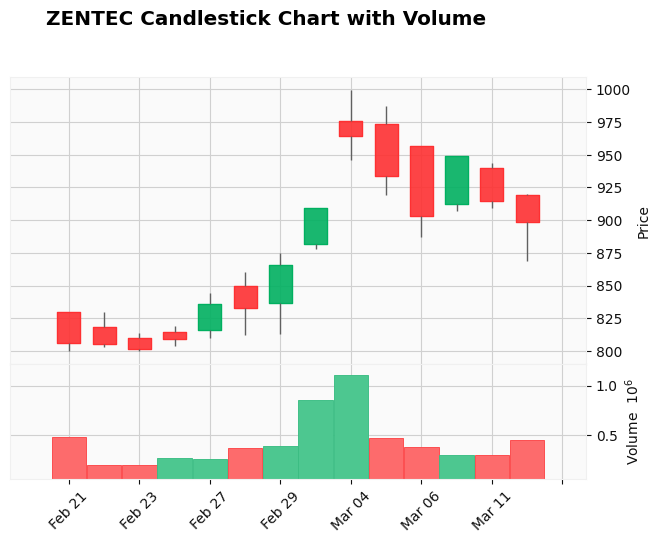

ZYDUSLIFE
2024-02-21 00:00:00


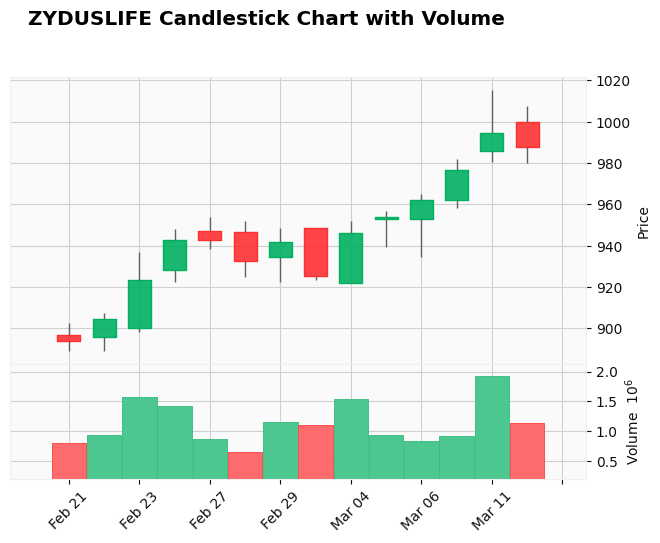

SBIN
2024-02-18 00:00:00


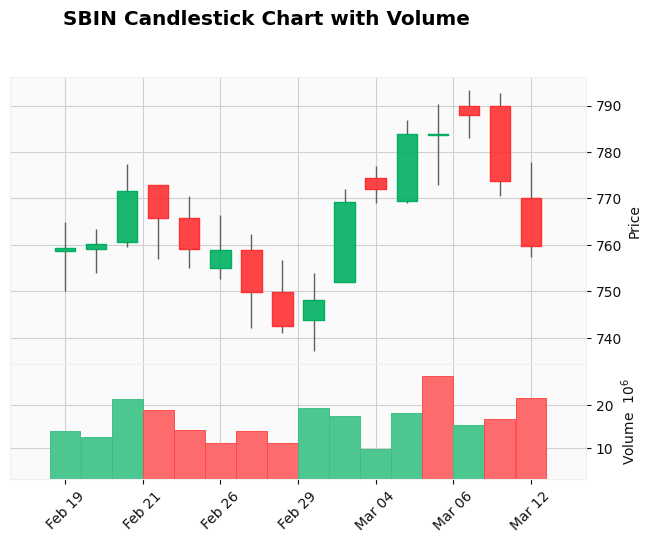

BORORENEW
2024-02-18 00:00:00


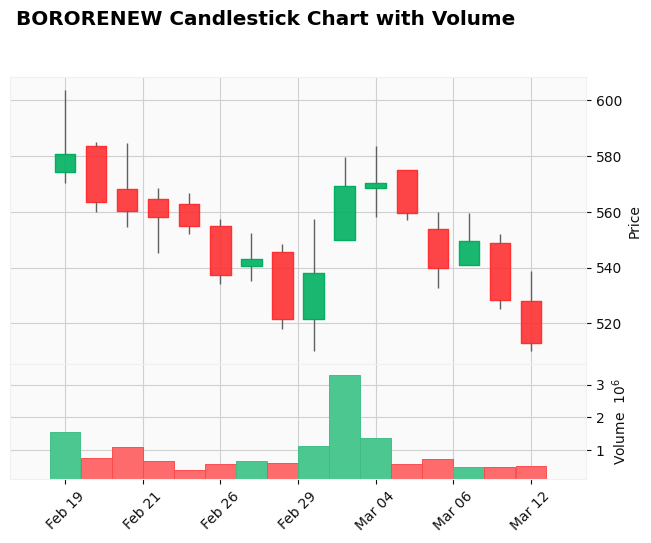

CUB
2024-02-18 00:00:00


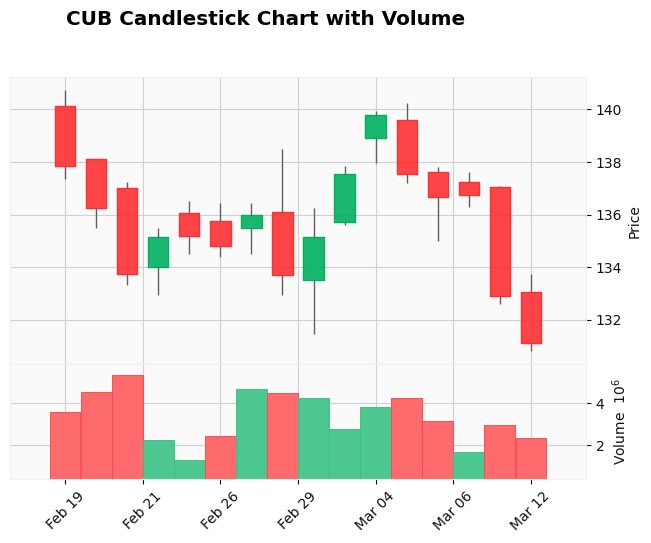

DBL
2024-02-18 00:00:00


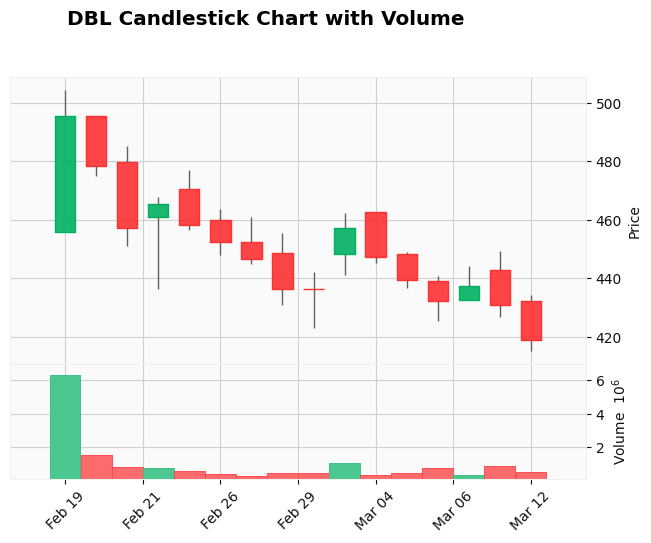

GENUSPOWER
2024-02-18 00:00:00


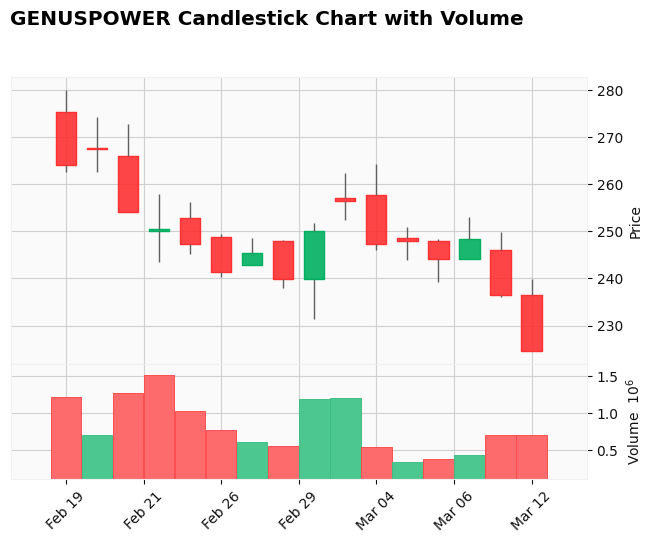

GEOJITFSL
2024-02-18 00:00:00


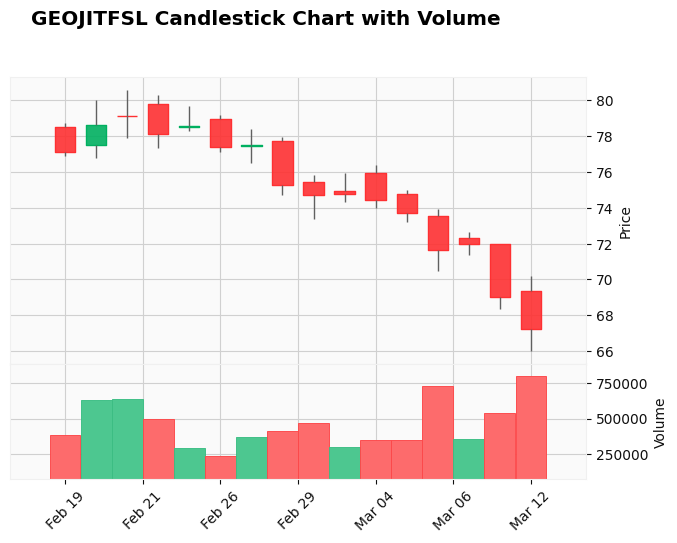

GEOJITFSL
2024-02-18 00:00:00


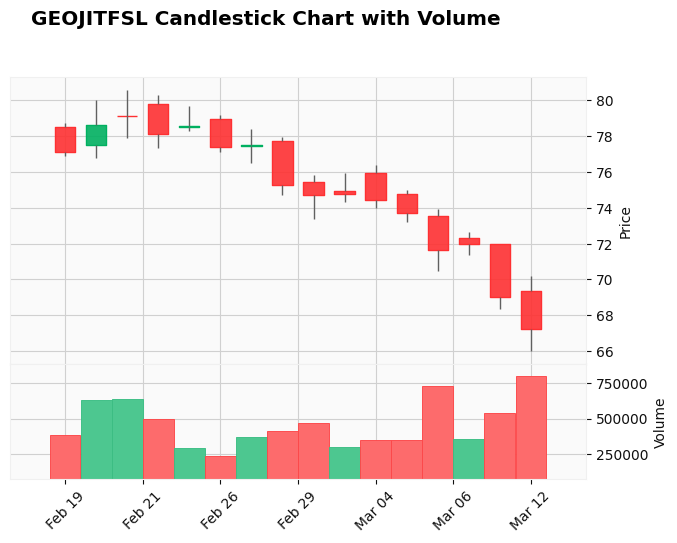

HDFCBANK
2024-02-18 00:00:00


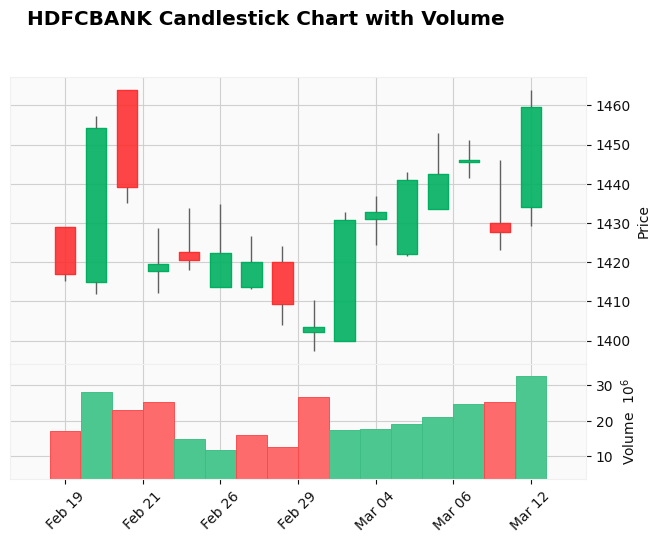

ICICIBANK
2024-02-18 00:00:00


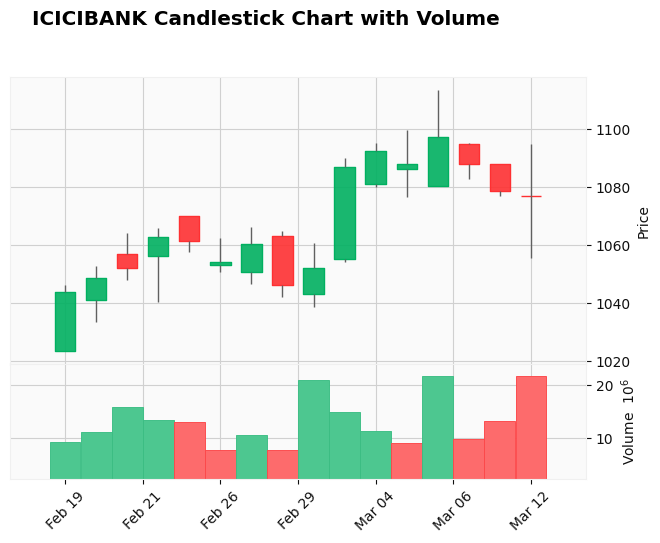

KIRLOSENG
2024-02-18 00:00:00


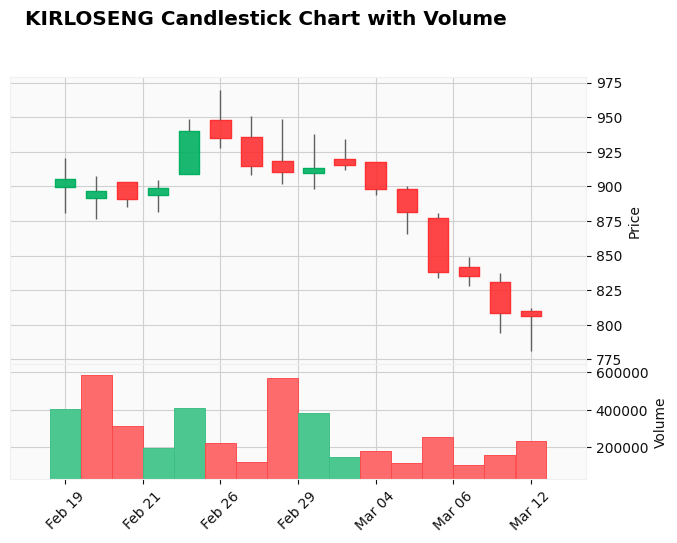

LUPIN
2024-02-18 00:00:00


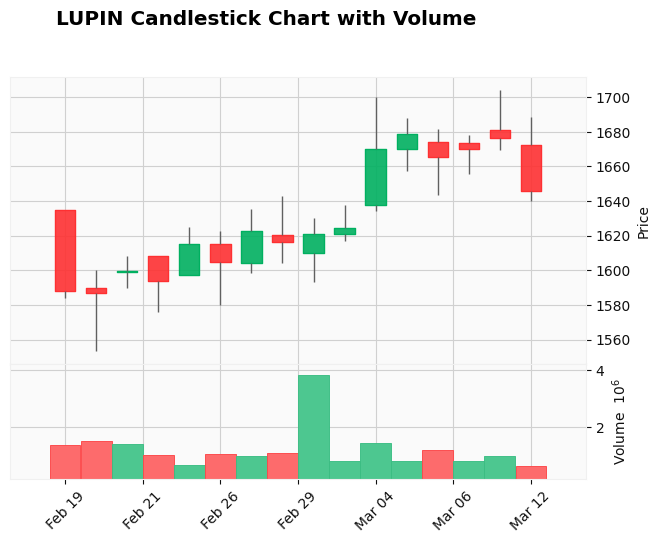

MICEL
2024-02-18 00:00:00


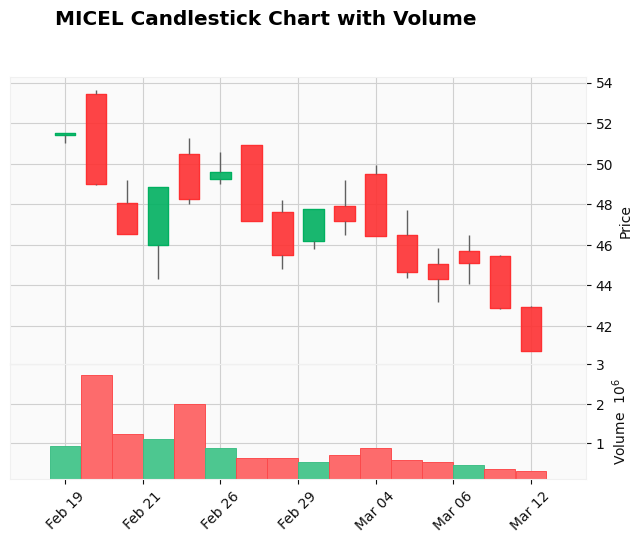

NATCOPHARM
2024-02-18 00:00:00


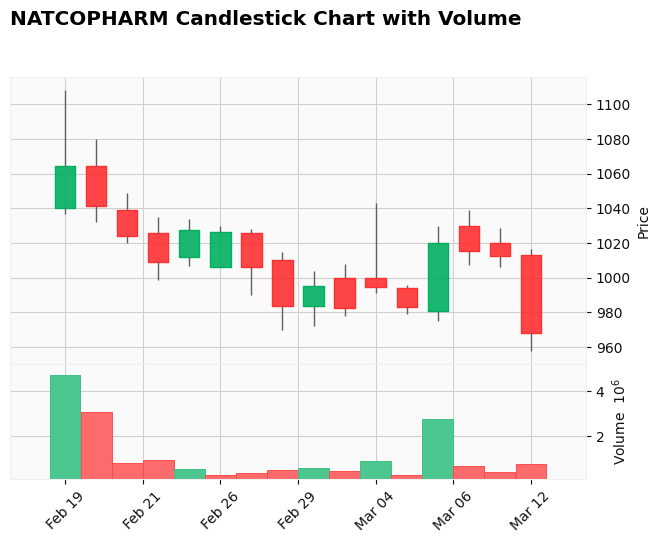

PODDARHOUS
2024-02-18 00:00:00


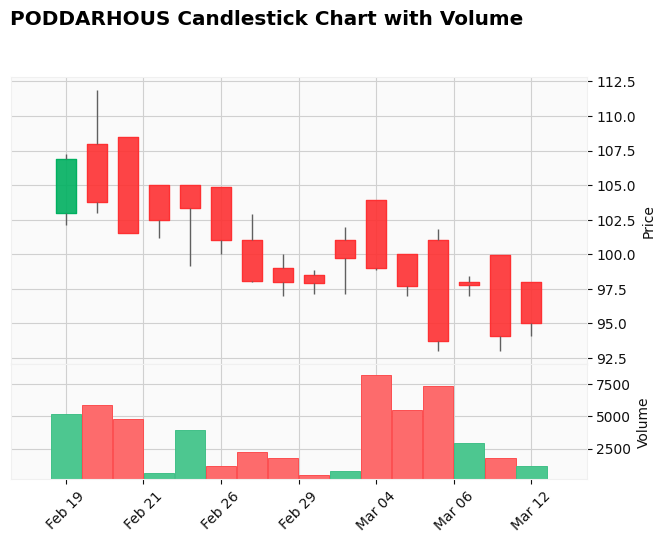

SECURKLOUD
2024-02-18 00:00:00


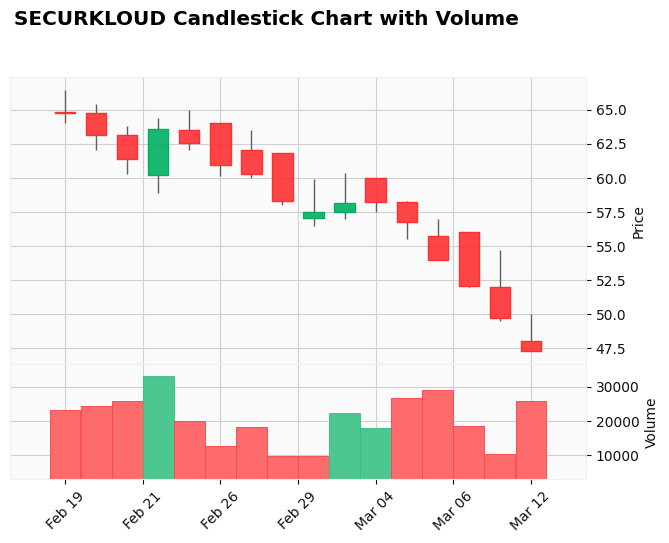

SHAILY
2024-02-18 00:00:00


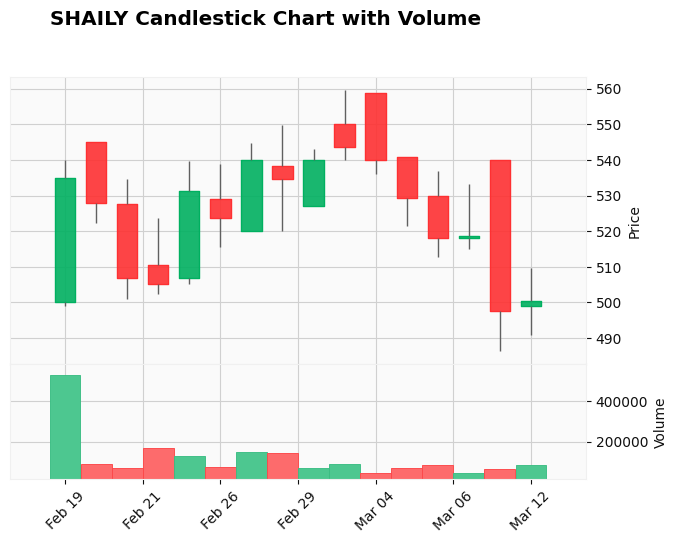

TORNTPOWER
2024-02-18 00:00:00


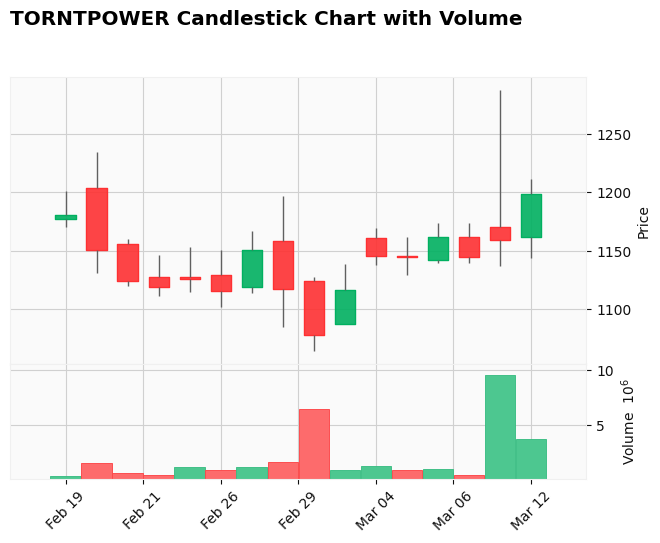

YESBANK
2024-02-18 00:00:00


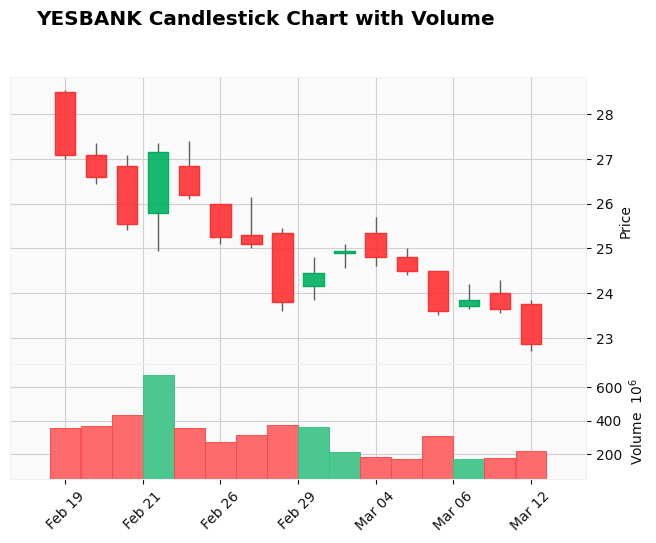

YESBANK
2024-02-18 00:00:00


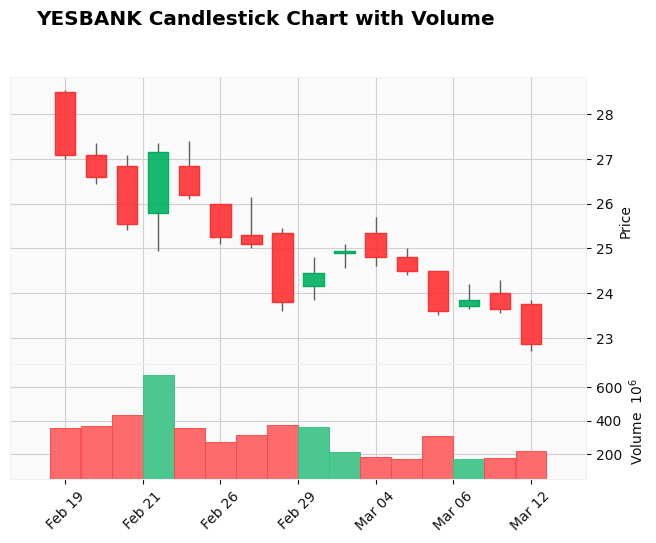

ADANIENT
2024-02-14 00:00:00


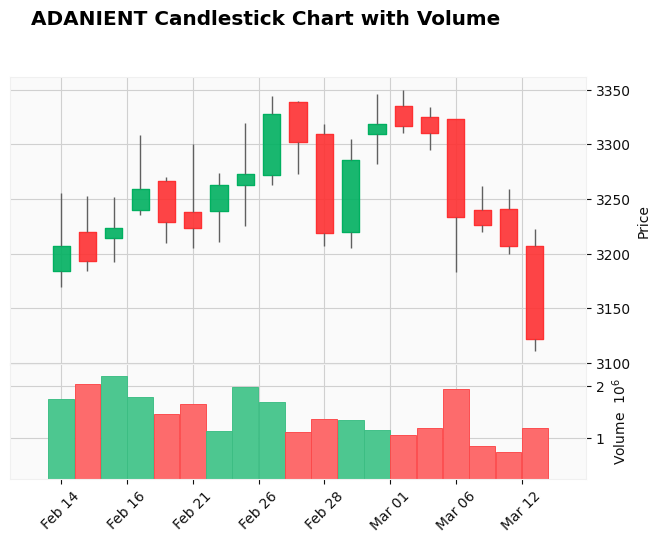

ANGELONE
2024-02-14 00:00:00


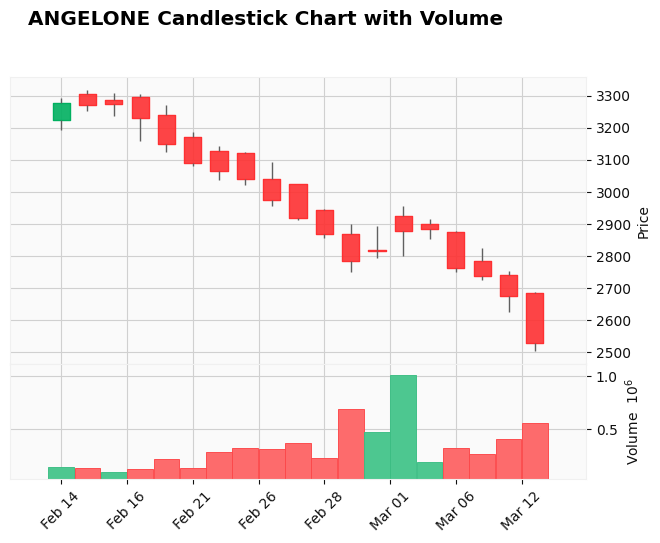

COALINDIA
2024-02-14 00:00:00


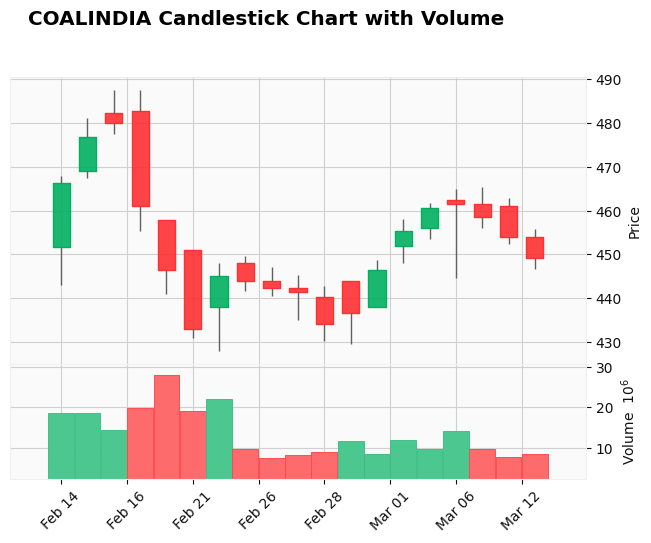

GEOJITFSL
2024-02-14 00:00:00


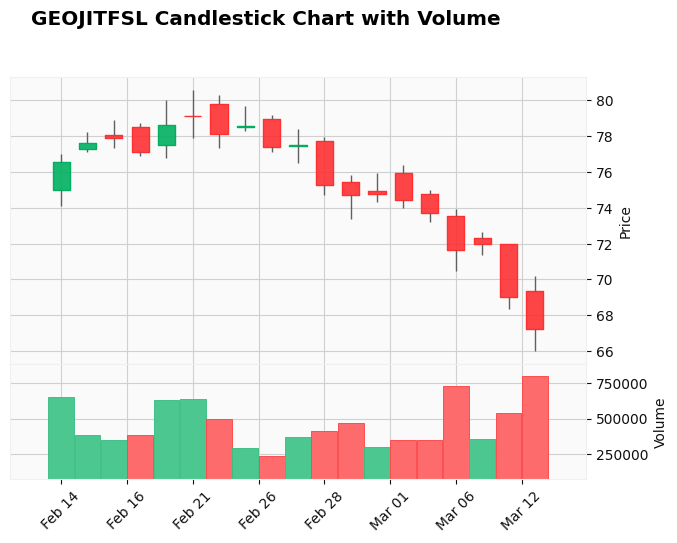

INDIGO
2024-02-14 00:00:00


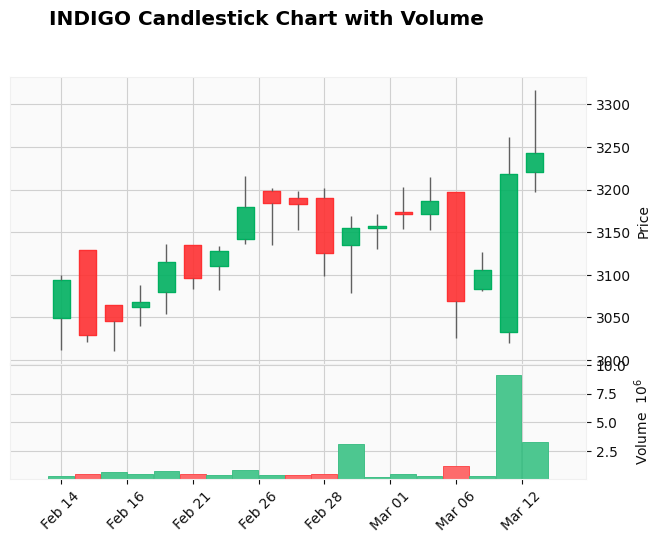

NUVAMA
2024-02-14 00:00:00


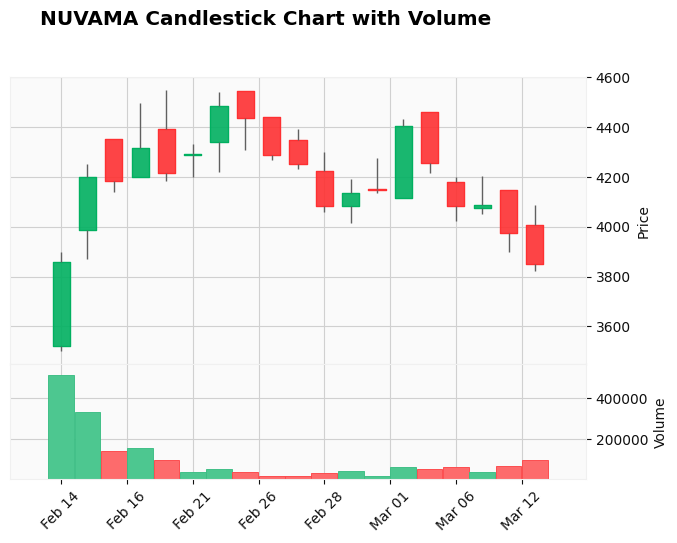

RELINFRA
2024-02-14 00:00:00


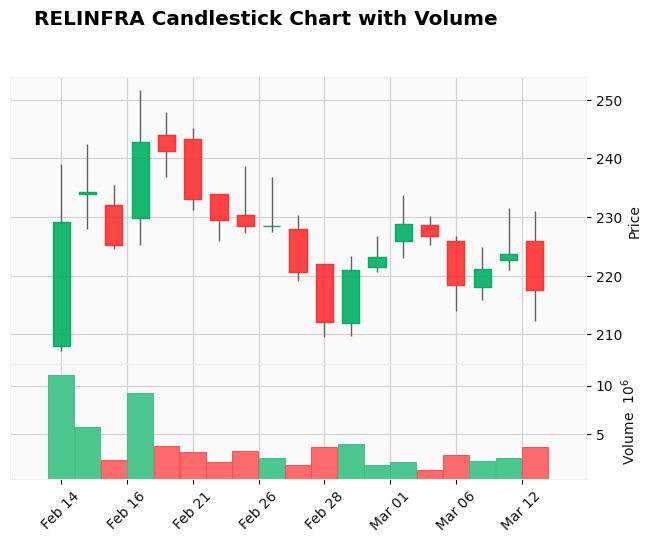

UCOBANK
2024-02-14 00:00:00


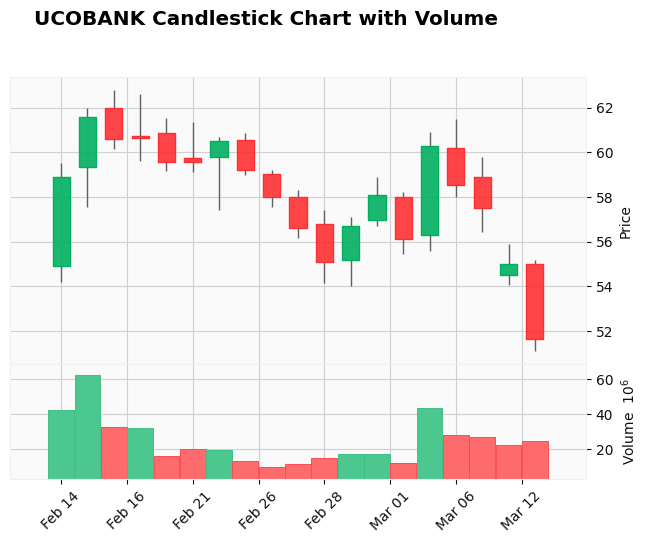

YUKEN
2024-02-14 00:00:00


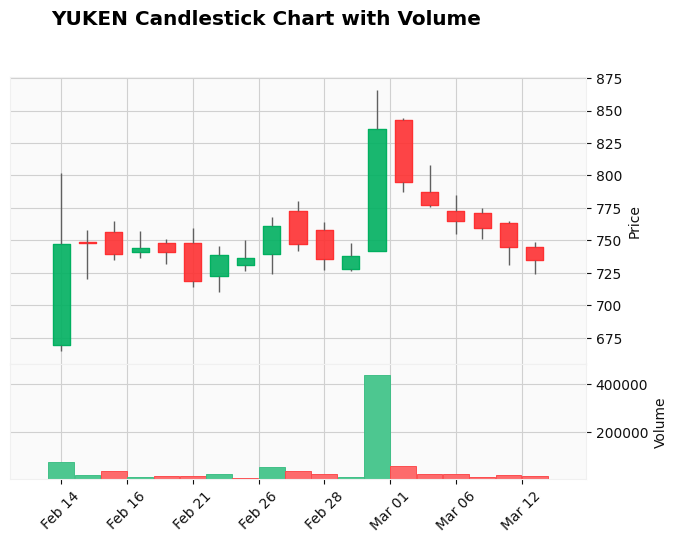

ALICON
2024-02-13 00:00:00


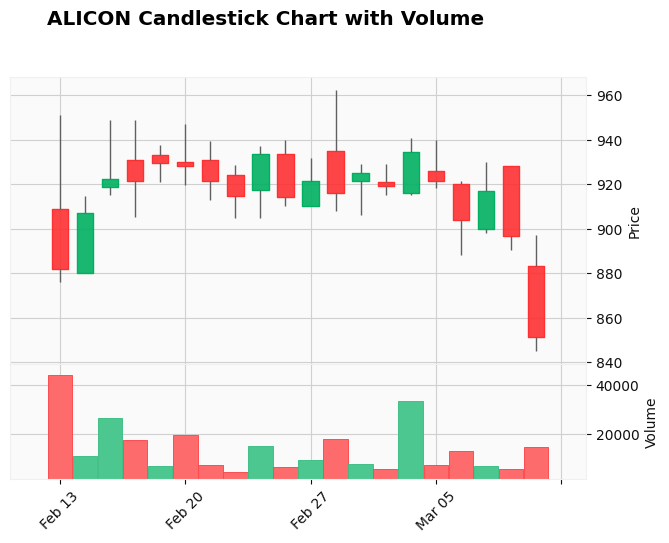

ALKEM
2024-02-13 00:00:00


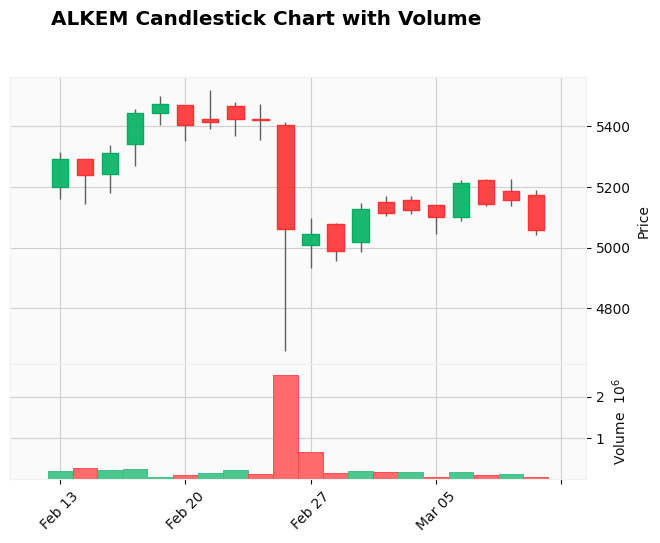

APOLLOHOSP
2024-02-13 00:00:00


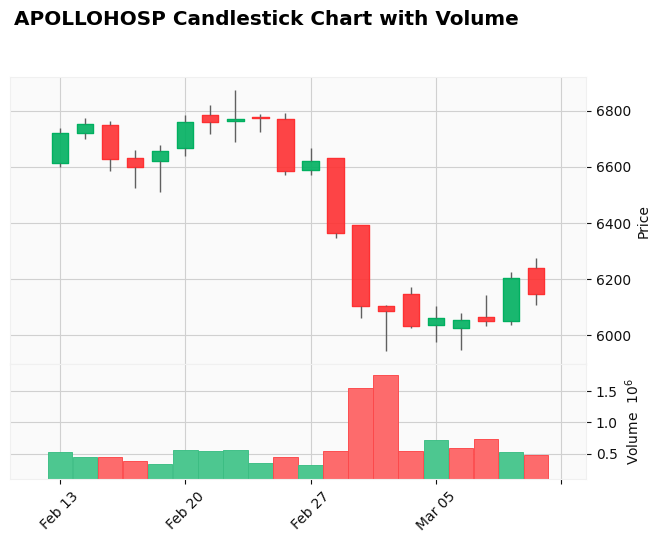

ASTERDM
2024-02-13 00:00:00


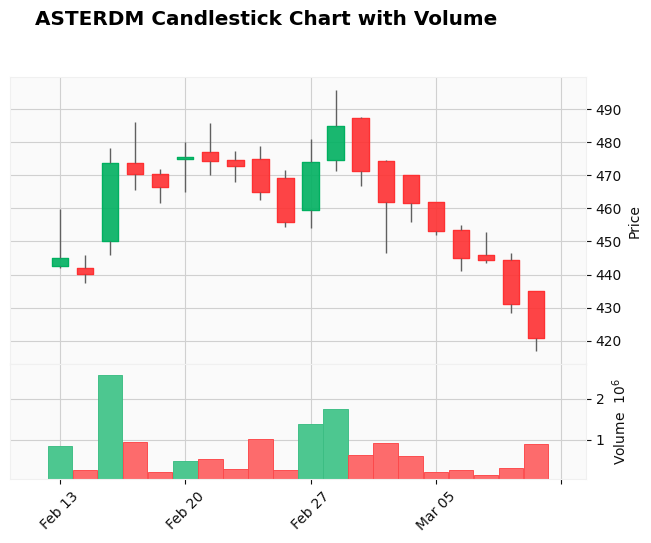

ASTRAMICRO
2024-02-13 00:00:00


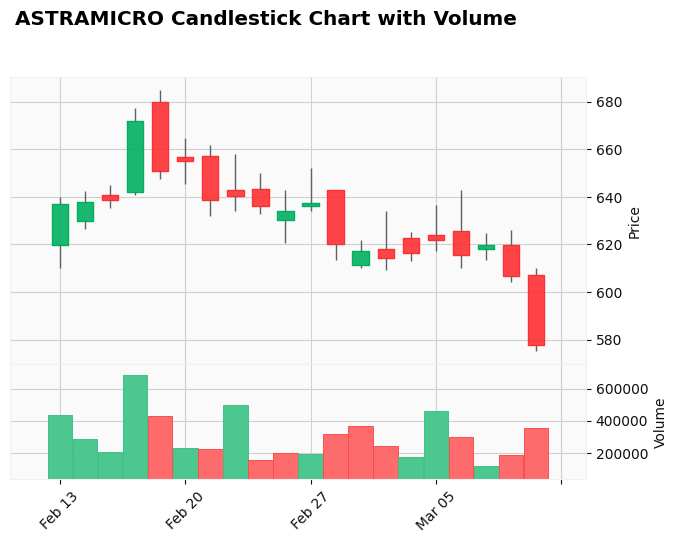

SBIN
2024-02-13 00:00:00


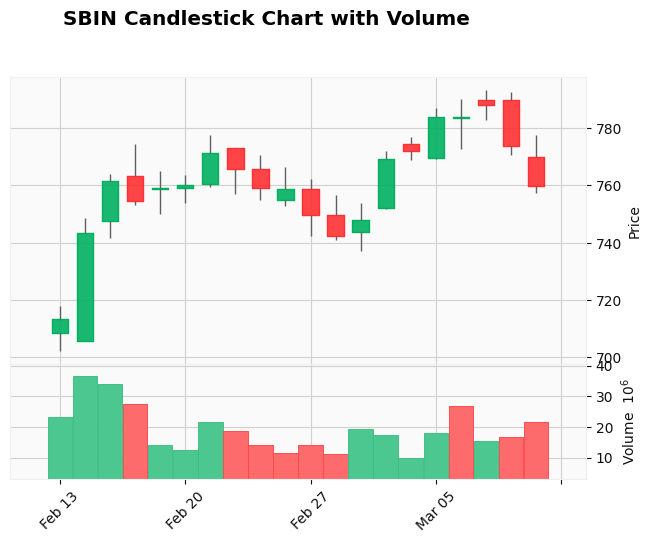

SBIN
2024-02-13 00:00:00


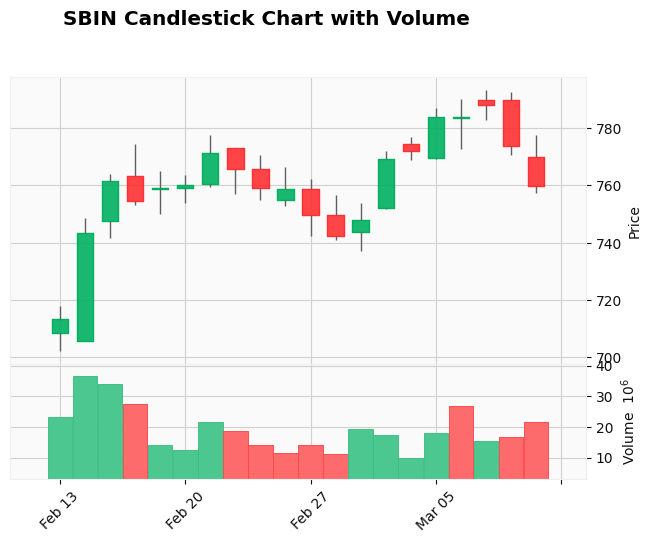

BHARATFORG
2024-02-13 00:00:00


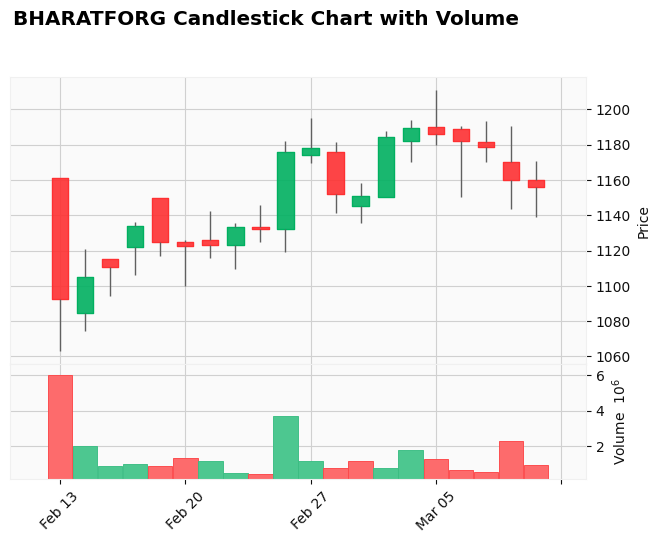

COALINDIA
2024-02-13 00:00:00


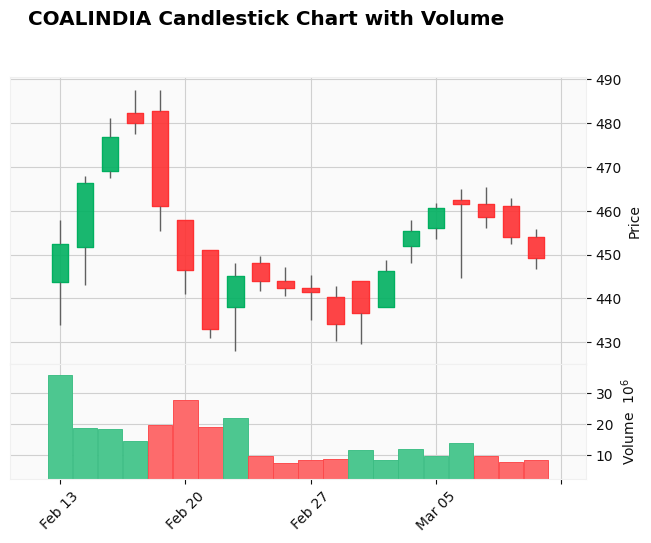

COALINDIA
2024-02-13 00:00:00


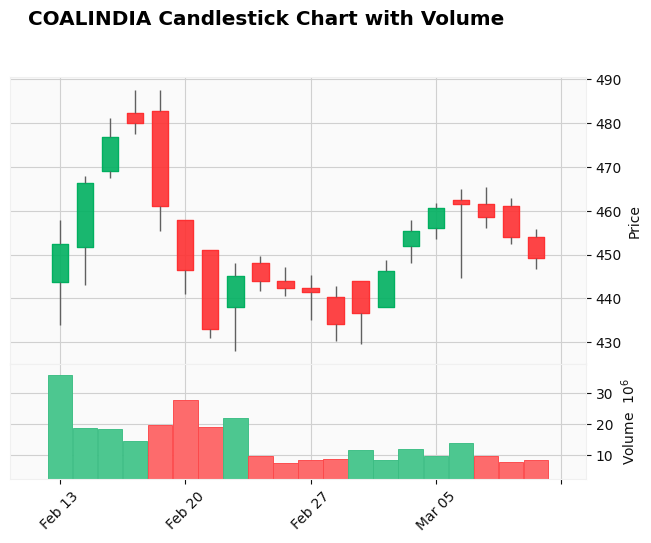

EASEMYTRIP
2024-02-13 00:00:00


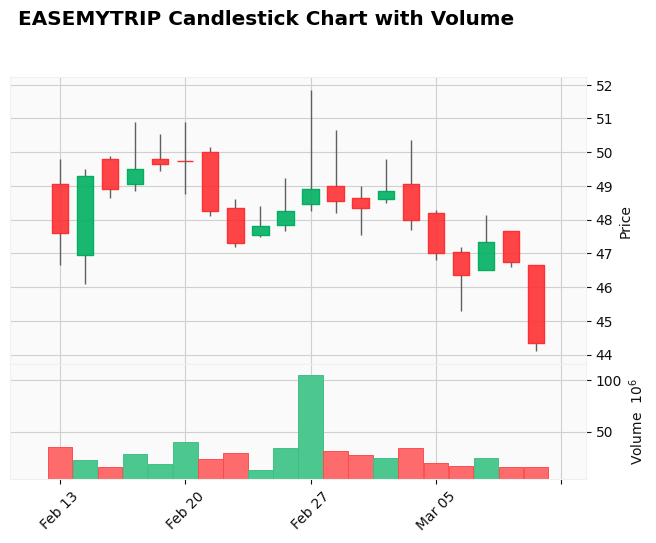

GENSOL
2024-02-13 00:00:00


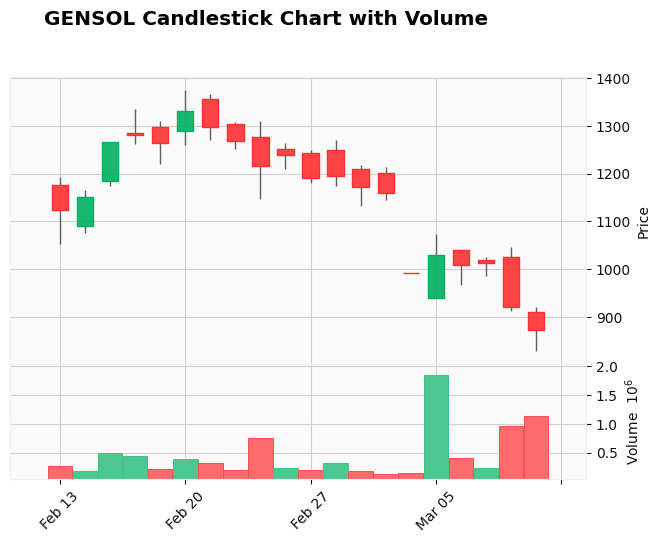

GEOJITFSL
2024-02-13 00:00:00


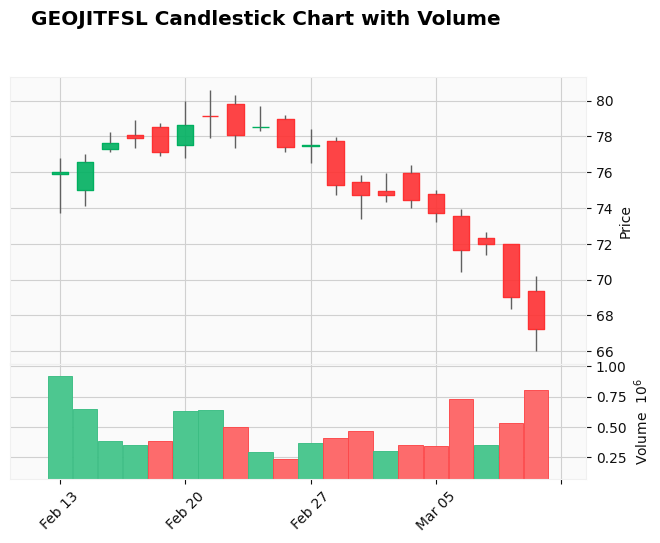

HINDALCO
2024-02-13 00:00:00


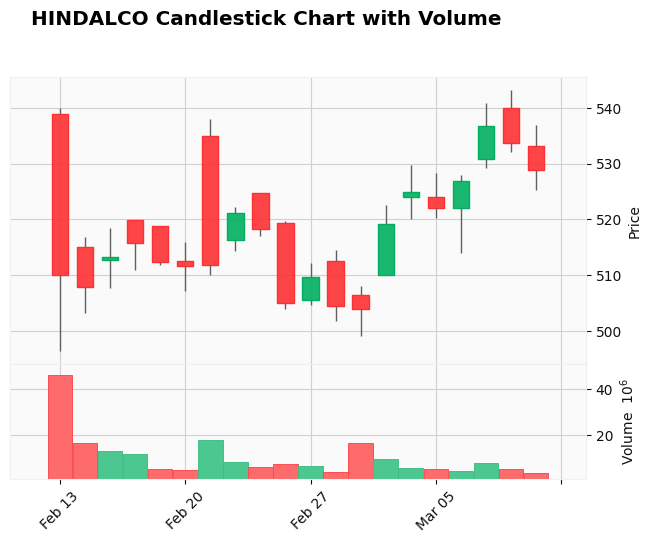

INDIGOPNTS
2024-02-13 00:00:00


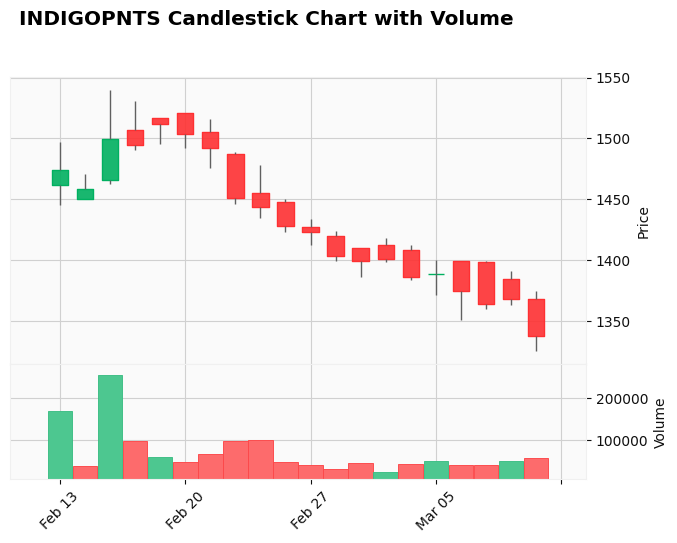

IRIS
2024-02-13 00:00:00


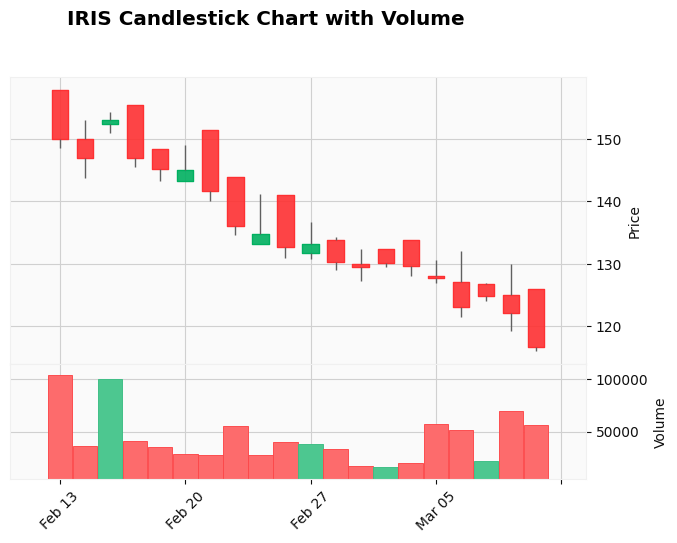

ITDCEM
2024-02-13 00:00:00


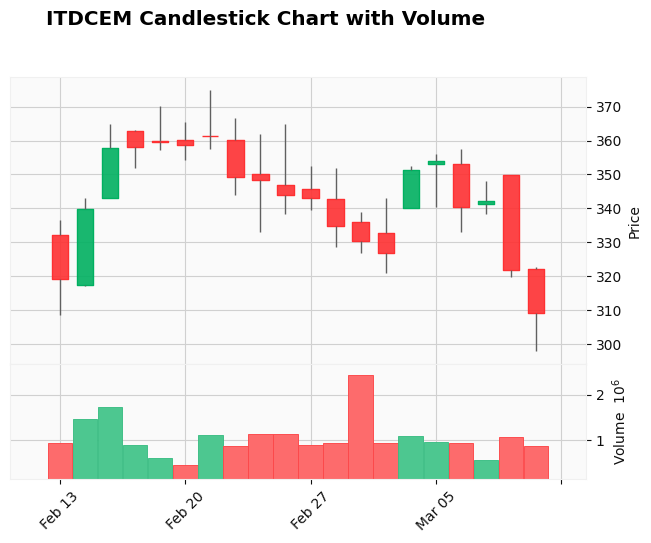

JLHL
2024-02-13 00:00:00


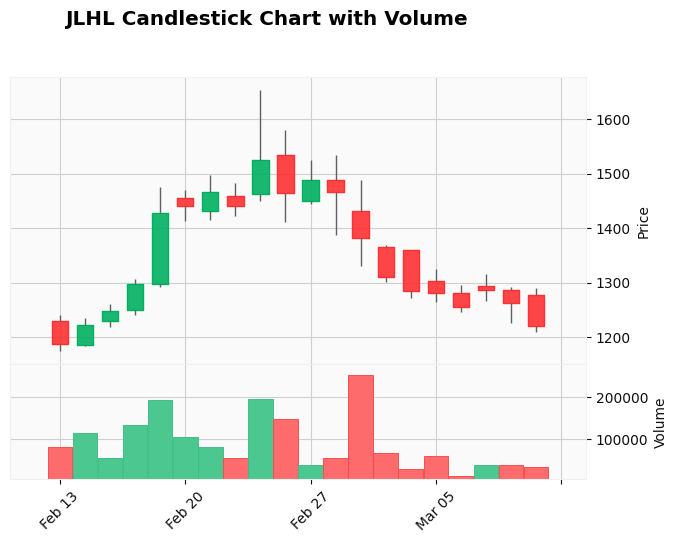

ONEPOINT
2024-02-13 00:00:00


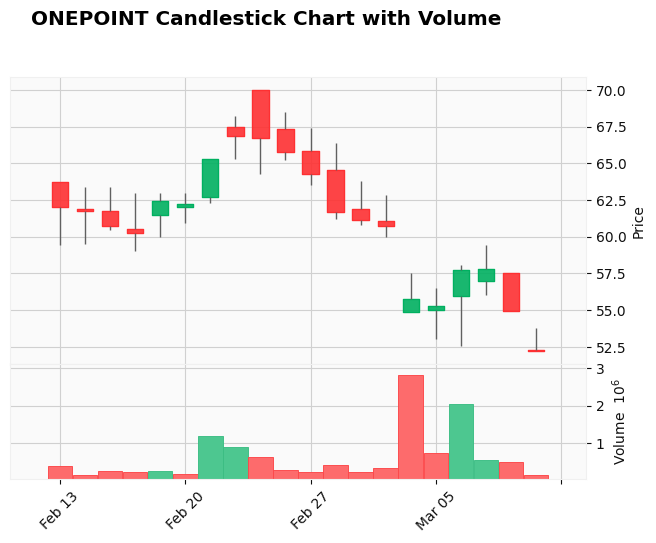

POLICYBZR
2024-02-13 00:00:00


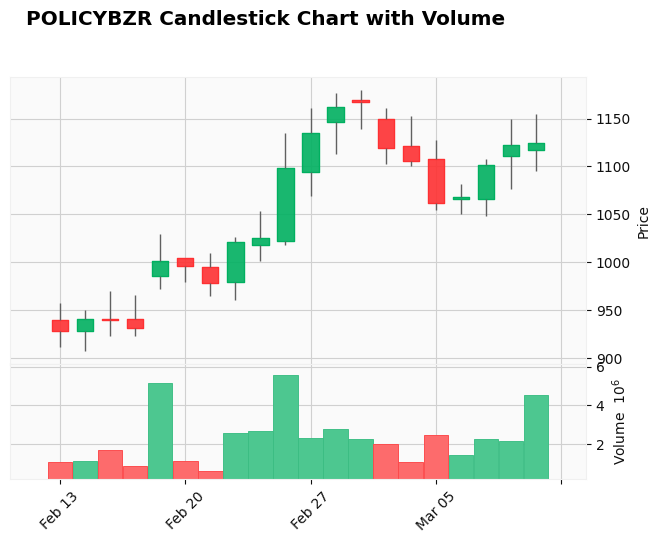

PIIND
2024-02-13 00:00:00


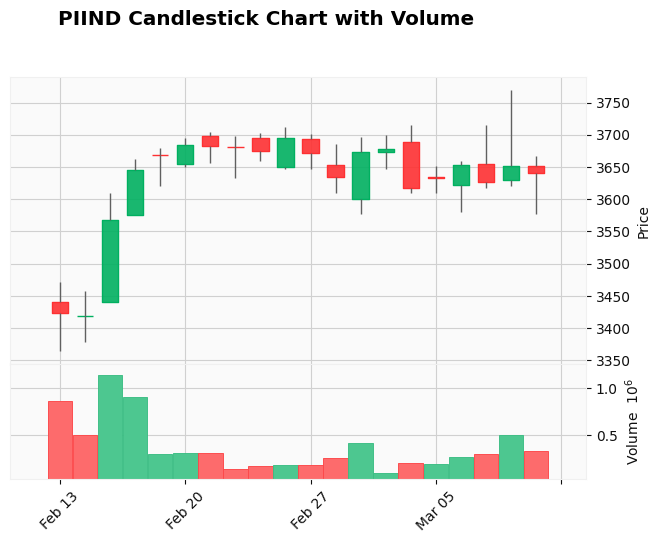

PIXTRANS
2024-02-13 00:00:00


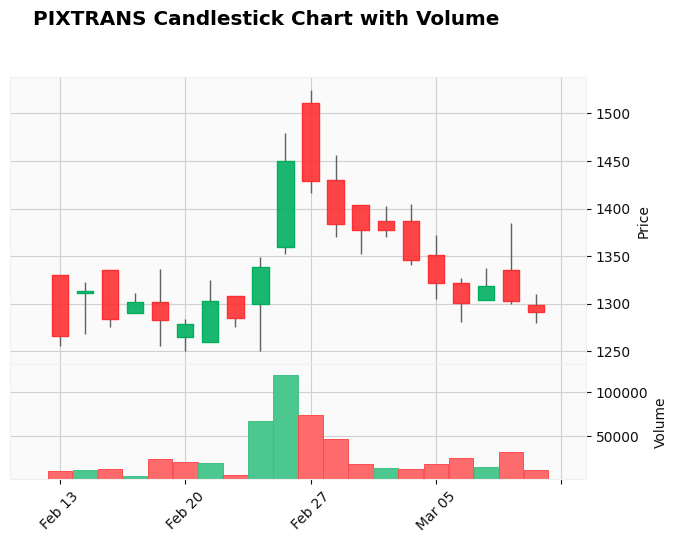

PFC
2024-02-13 00:00:00


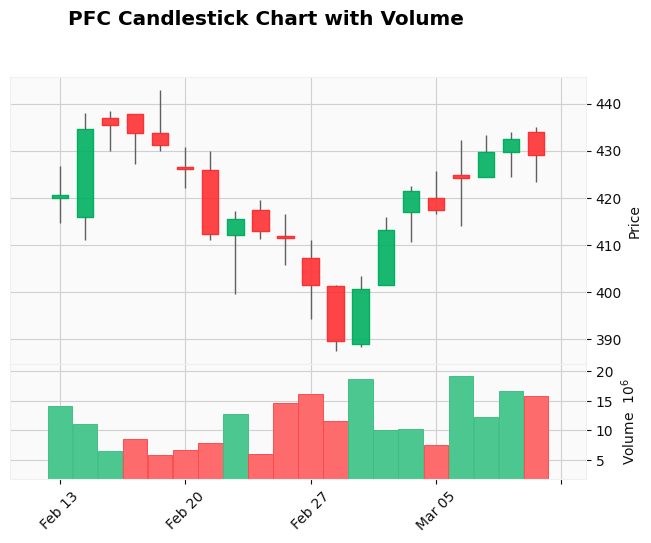

RATEGAIN
2024-02-13 00:00:00


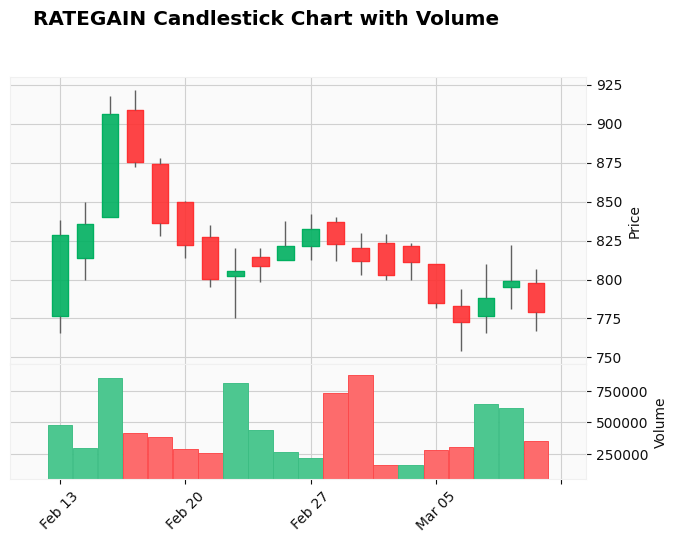

SCHNEIDER
2024-02-13 00:00:00


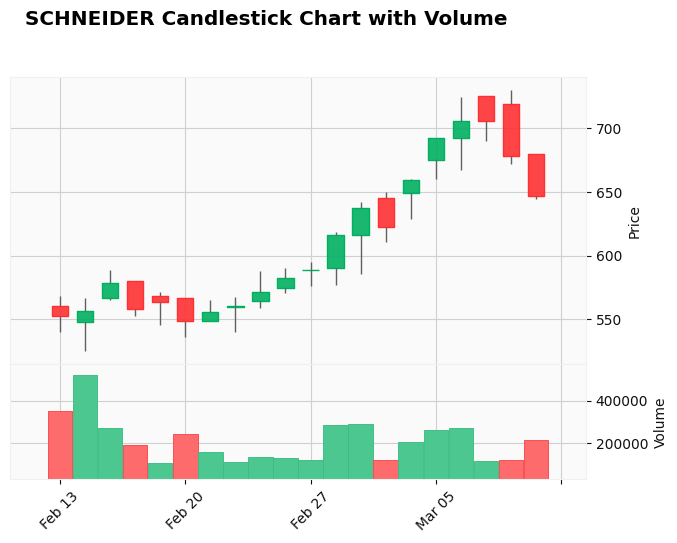

SIEMENS
2024-02-13 00:00:00


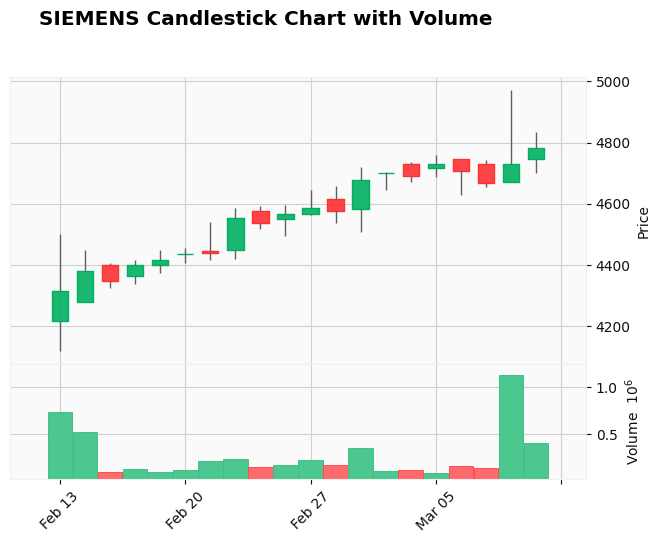

SBIN
2024-02-13 00:00:00


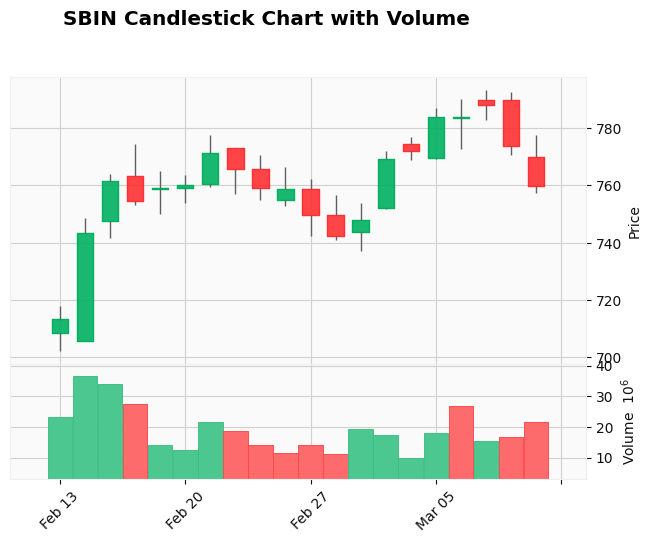

TATAPOWER
2024-02-13 00:00:00


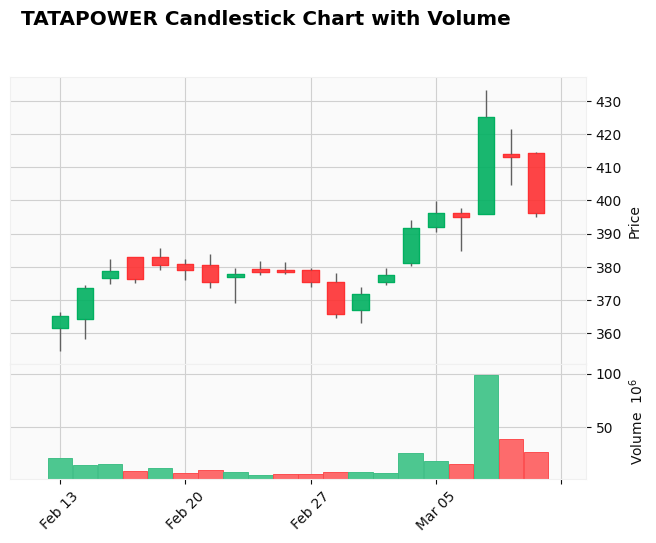

WABAG
2024-02-13 00:00:00


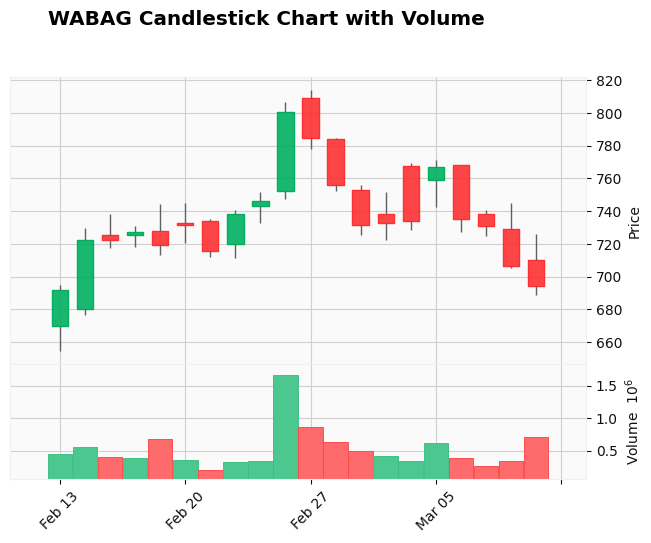

WABAG
2024-02-13 00:00:00


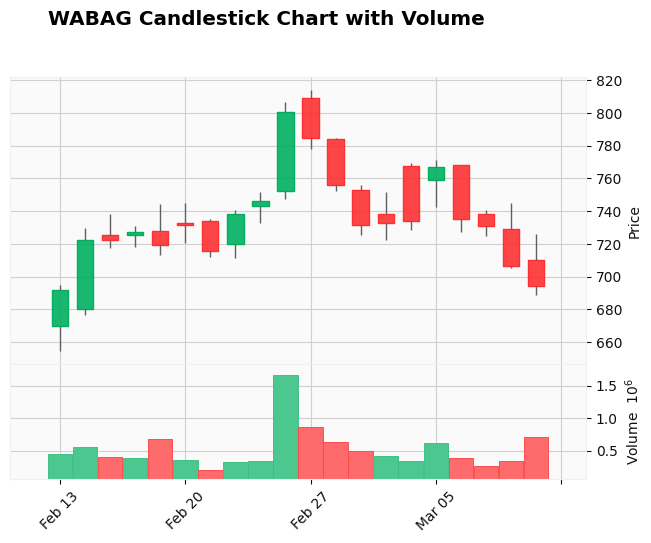

VINDHYATEL
2024-02-13 00:00:00


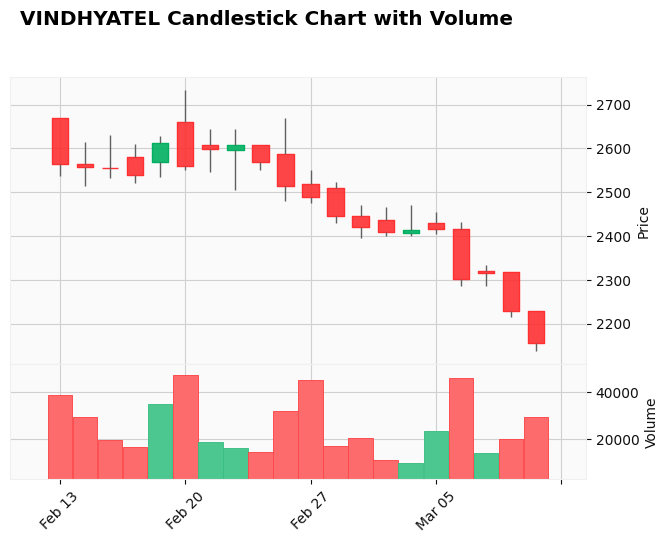

WONDERLA
2024-02-13 00:00:00


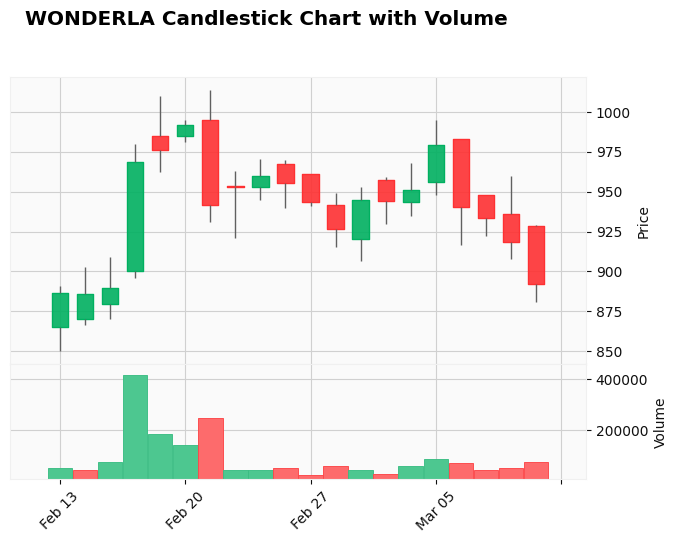

BSE
2024-02-09 00:00:00


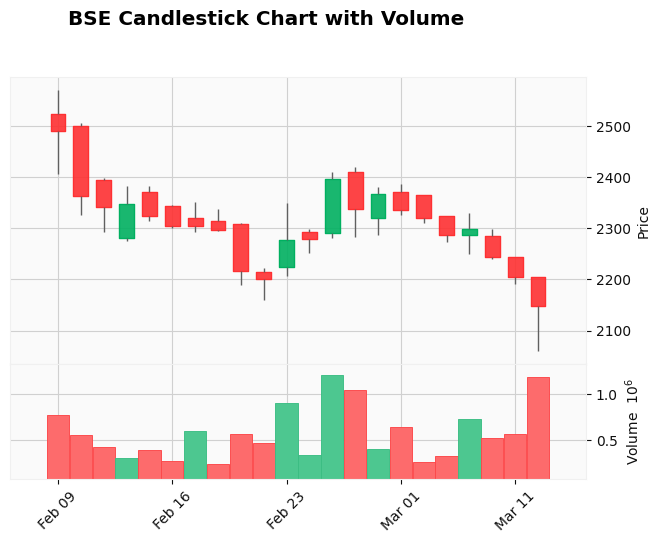

CONCOR
2024-02-09 00:00:00


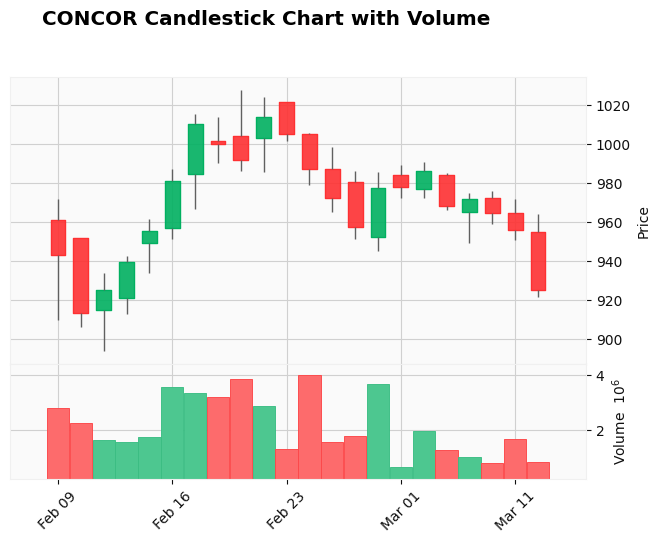

EASEMYTRIP
2024-02-09 00:00:00


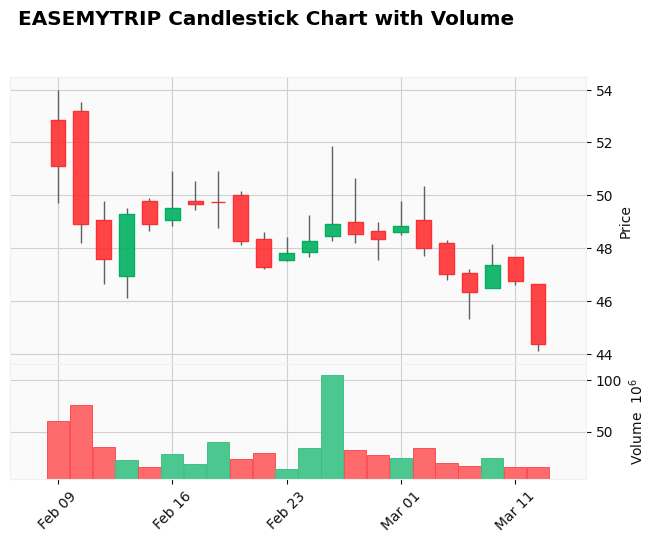

ESAFSFB
2024-02-09 00:00:00


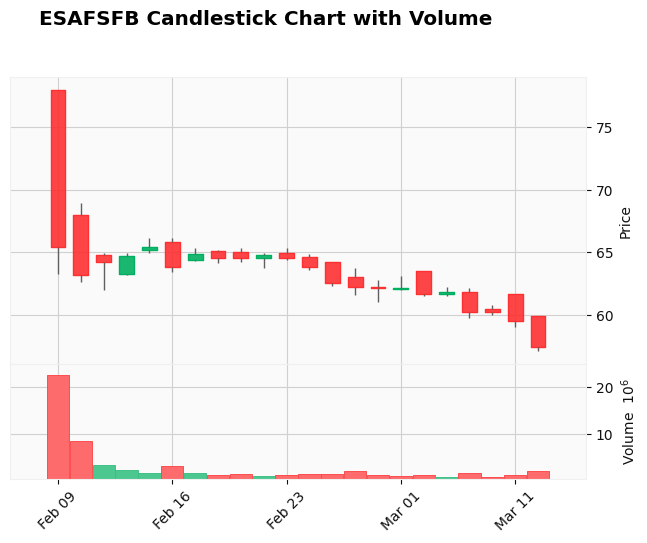

GEOJITFSL
2024-02-09 00:00:00


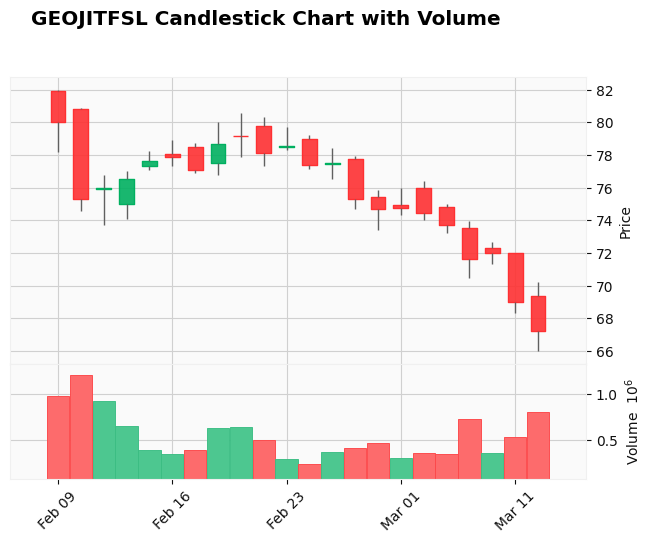

HDFCBANK
2024-02-09 00:00:00


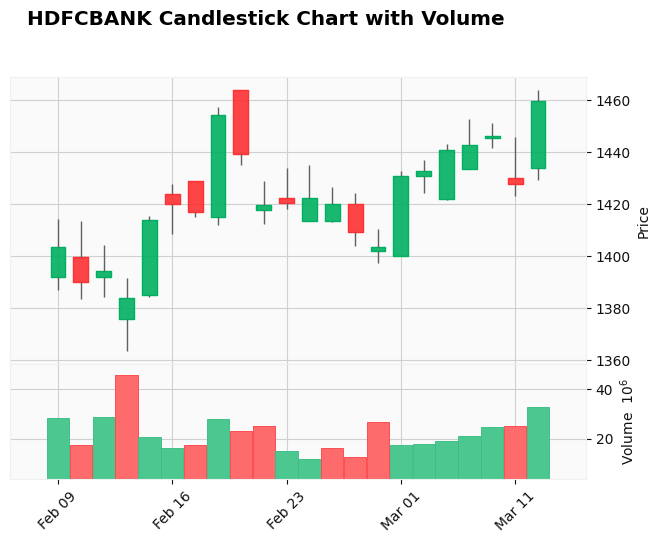

ICICIBANK
2024-02-09 00:00:00


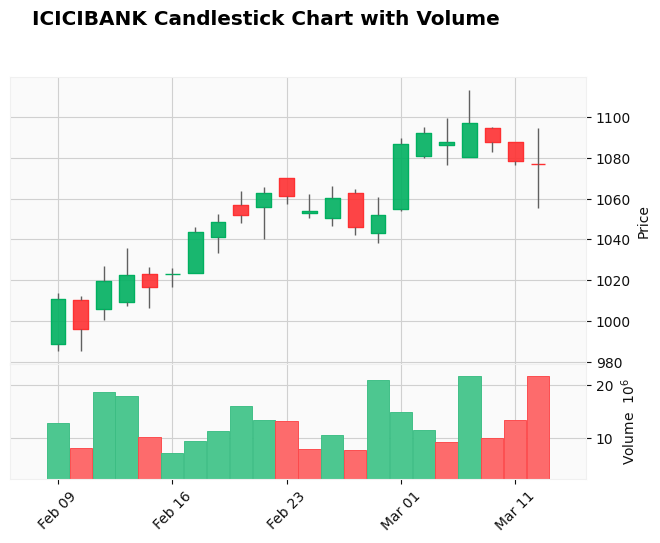

SBIN
2024-02-09 00:00:00


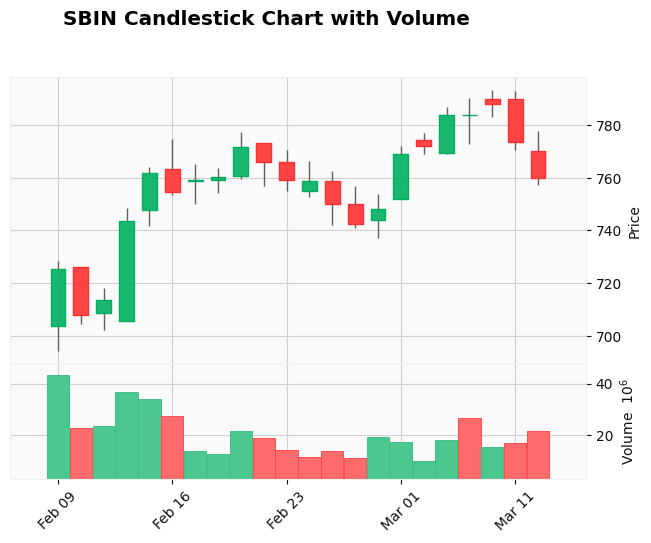

ASKAUTOLTD
2024-02-08 00:00:00


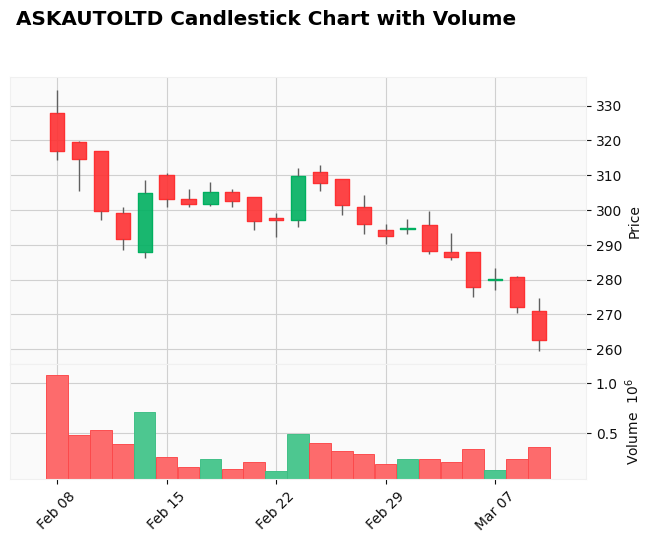

SBIN
2024-02-08 00:00:00


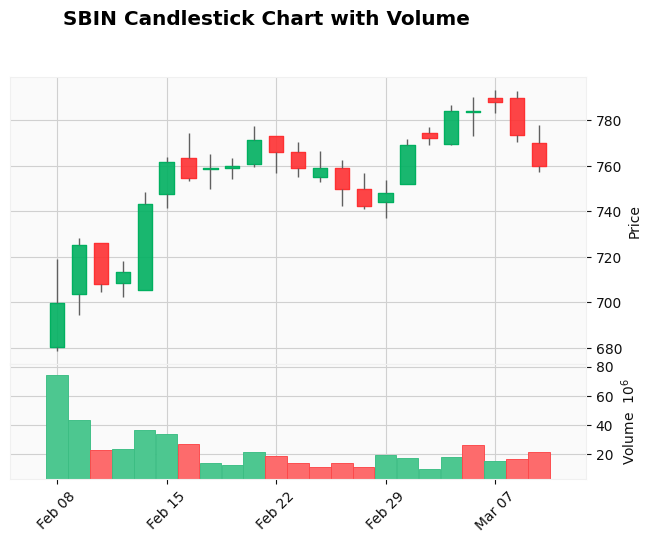

SBIN
2024-02-08 00:00:00


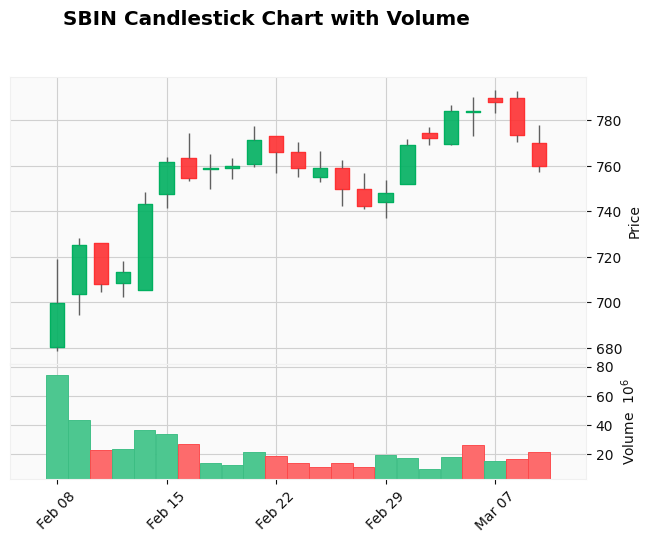

SBIN
2024-02-08 00:00:00


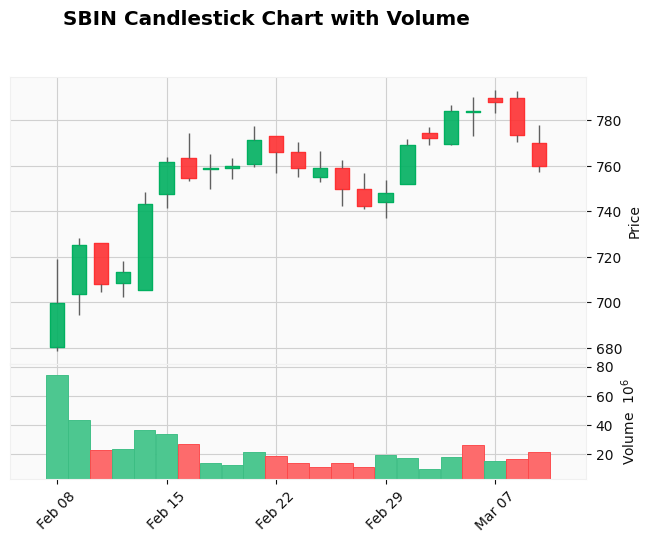

SBIN
2024-02-08 00:00:00


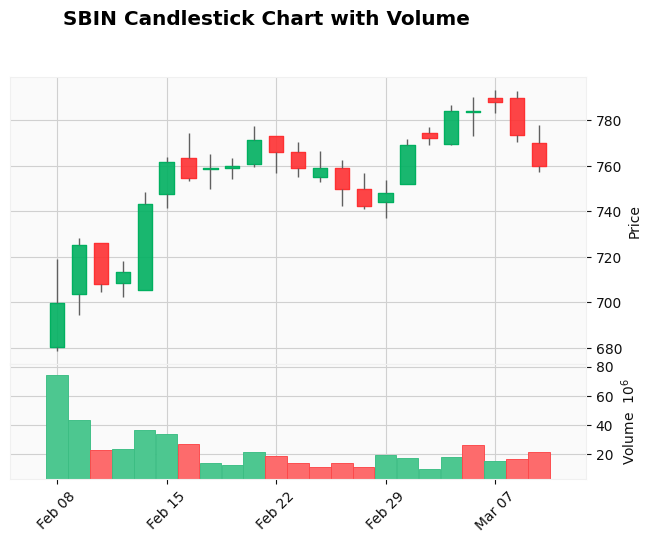

CARTRADE
2024-02-08 00:00:00


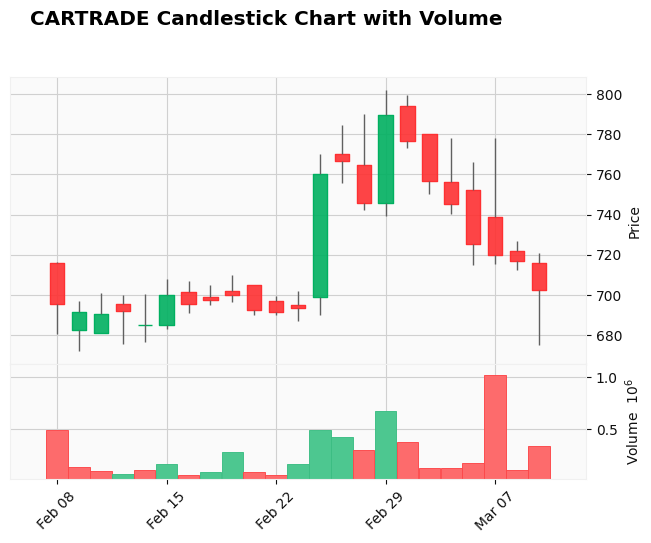

GEOJITFSL
2024-02-08 00:00:00


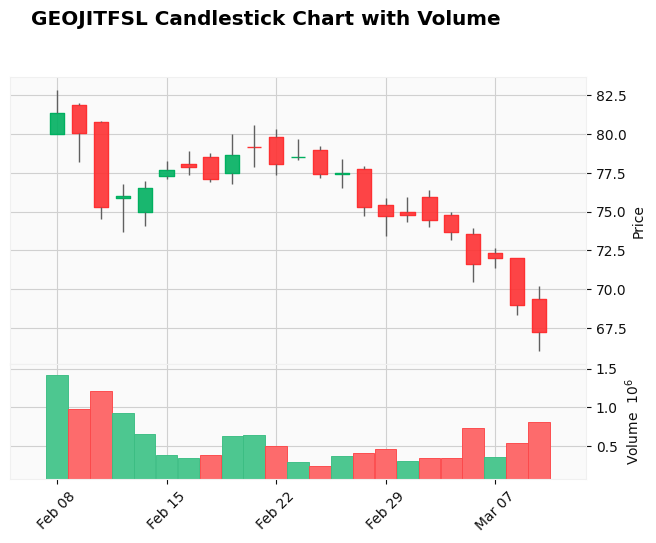

GREAVESCOT
2024-02-08 00:00:00


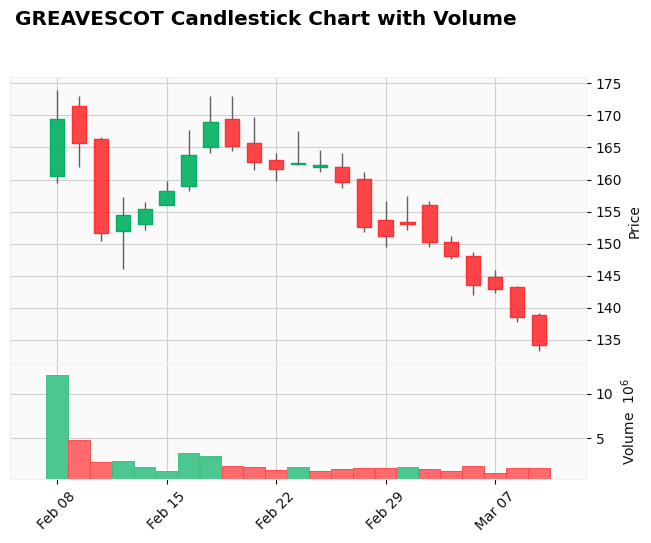

HDFCBANK
2024-02-08 00:00:00


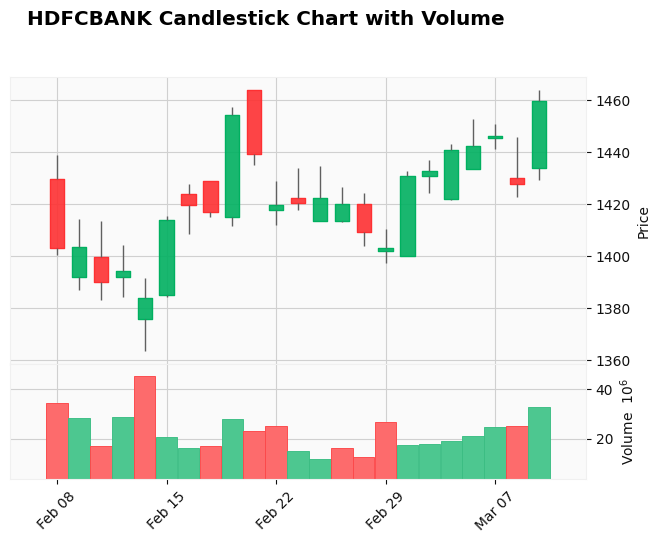

INOXWIND
2024-02-08 00:00:00


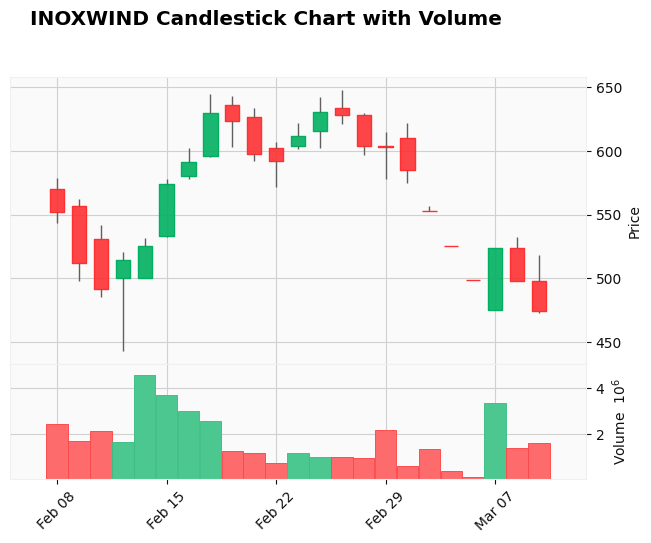

KSL
2024-02-08 00:00:00


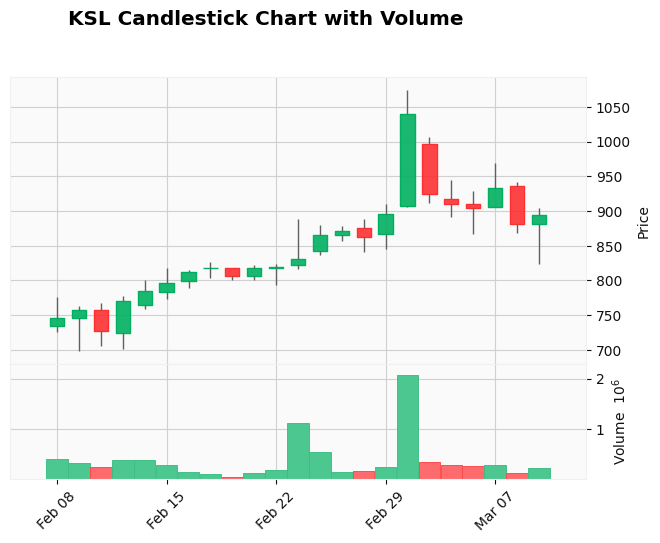

LANDMARK
2024-02-08 00:00:00


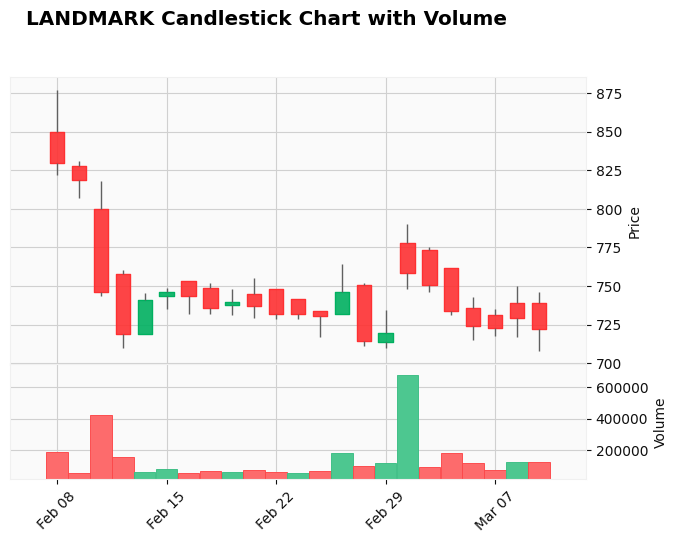

LICHSGFIN
2024-02-08 00:00:00


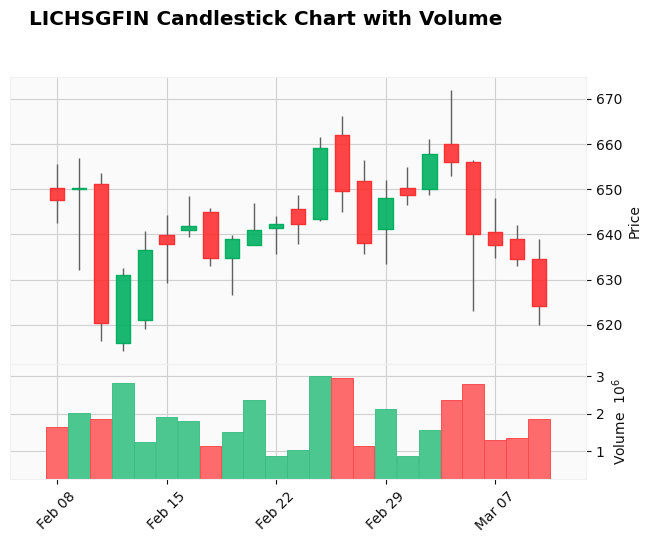

PTCIL
2024-02-08 00:00:00


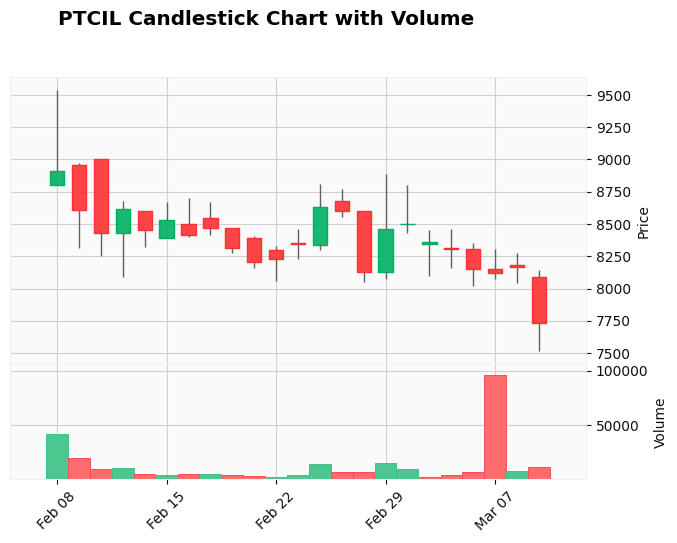

SBIN
2024-02-08 00:00:00


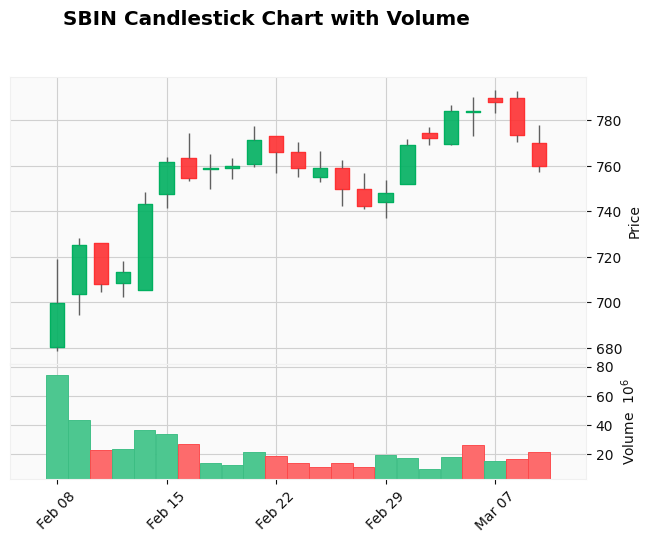

TCS
2024-02-08 00:00:00


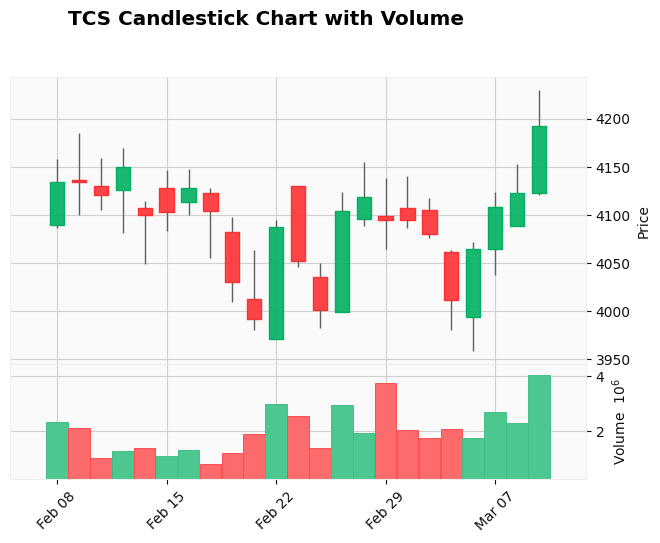

UGROCAP
2024-02-08 00:00:00


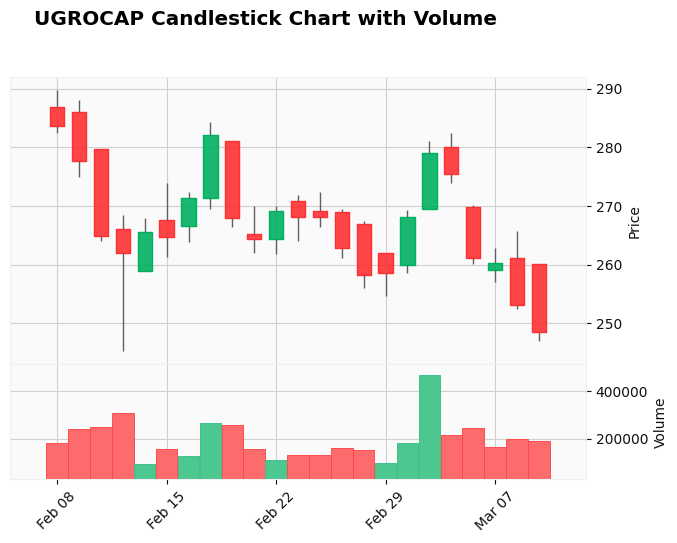

ZYDUSLIFE
2024-02-08 00:00:00


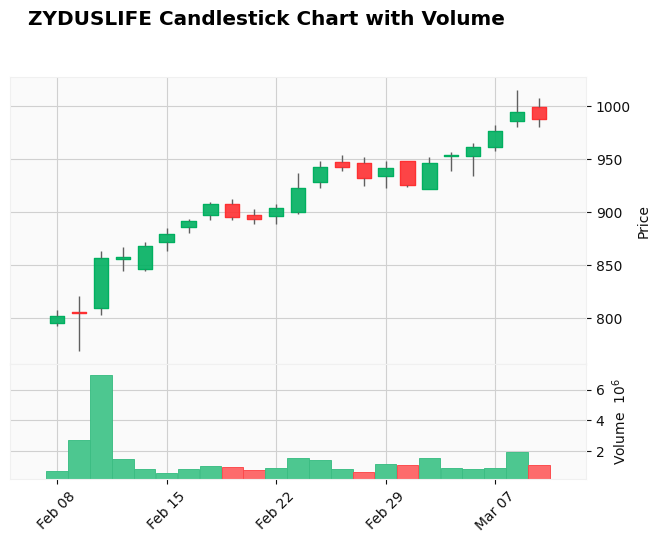

ATGL
2024-02-07 00:00:00


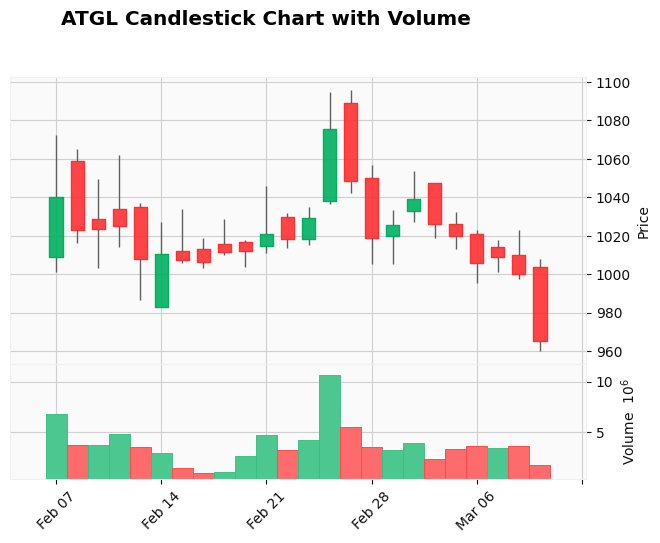

AKZOINDIA
2024-02-07 00:00:00


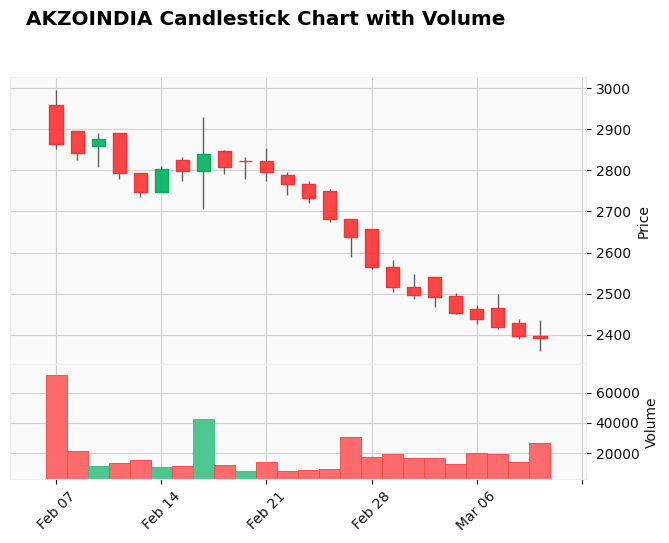

ASHOKLEY
2024-02-07 00:00:00


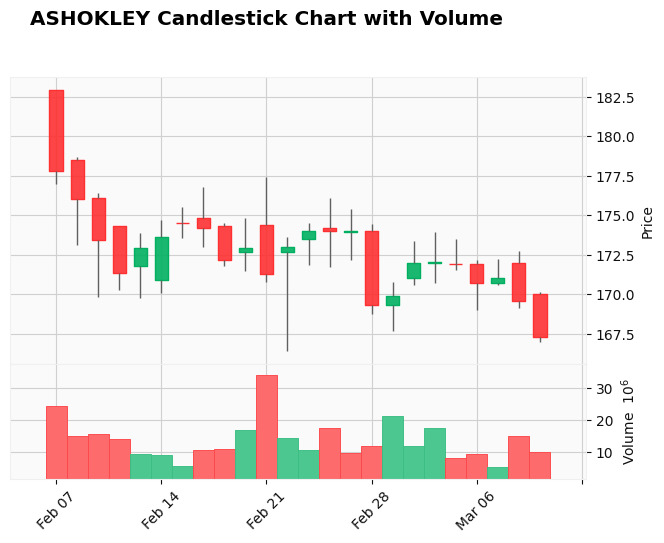

BAJFINANCE
2024-02-07 00:00:00


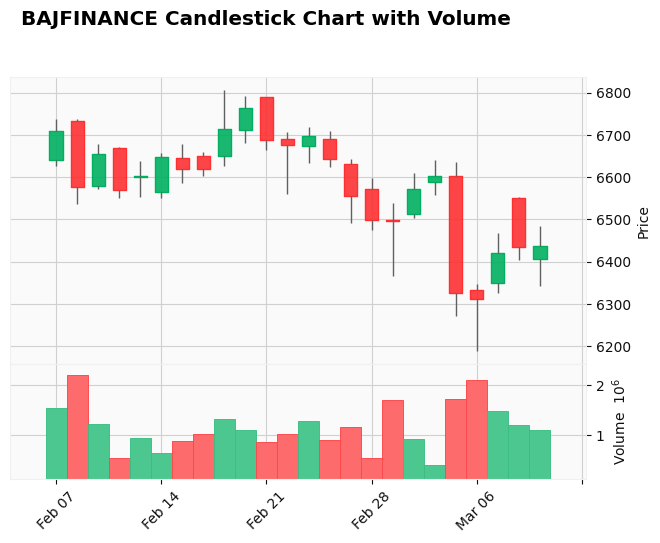

BHARTIARTL
2024-02-07 00:00:00


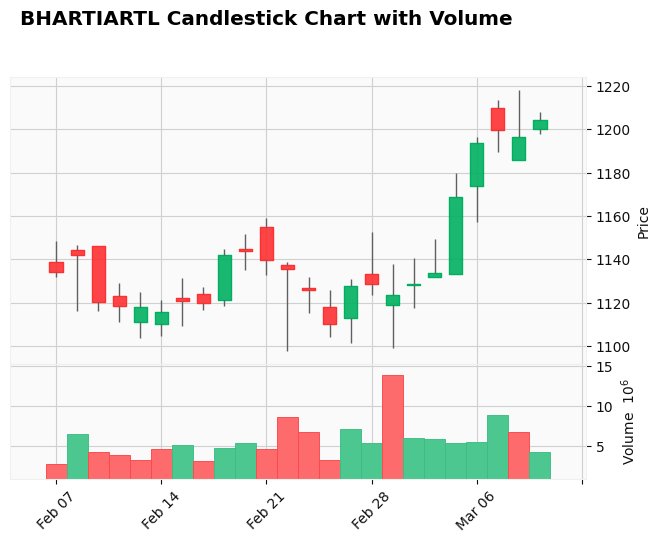

BRITANNIA
2024-02-07 00:00:00


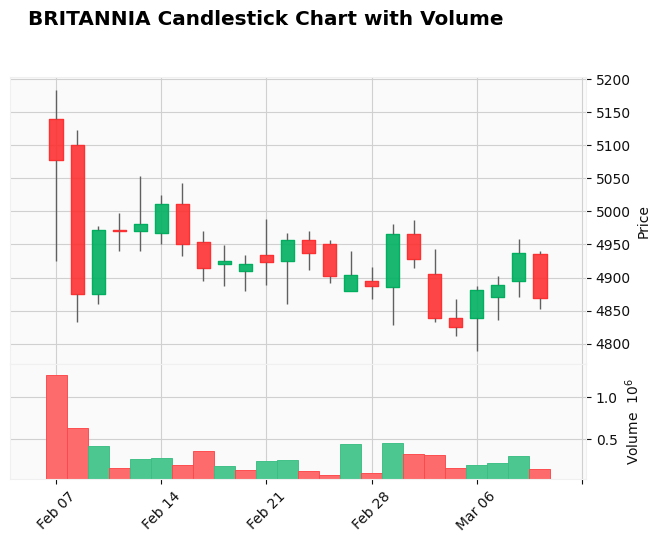

EASEMYTRIP
2024-02-07 00:00:00


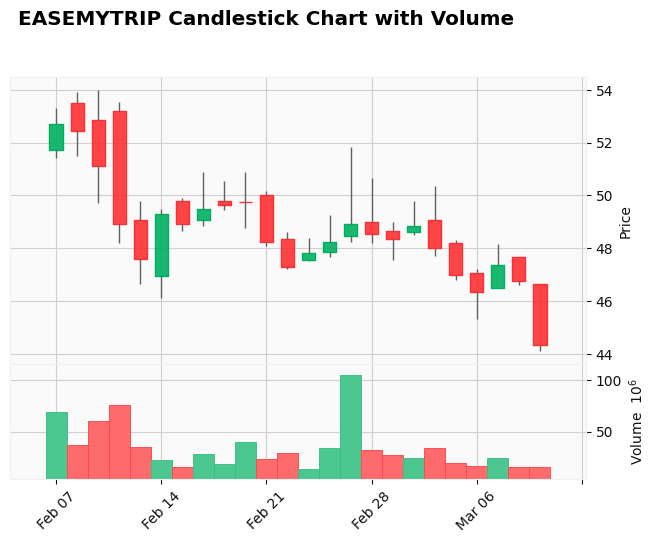

GEOJITFSL
2024-02-07 00:00:00


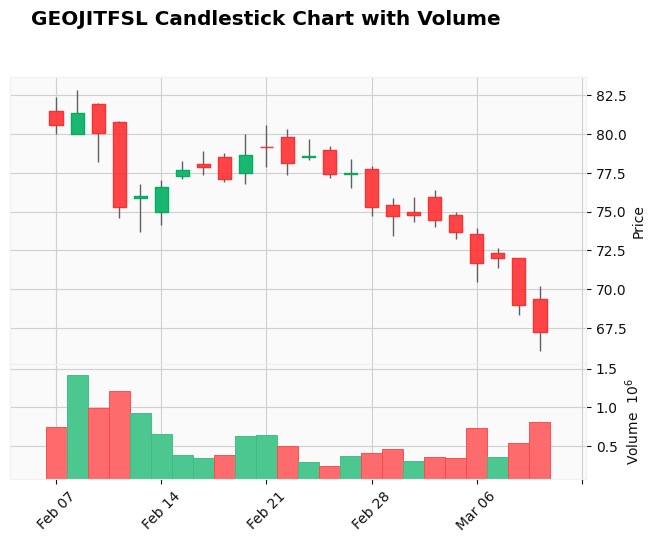

GPIL
2024-02-07 00:00:00


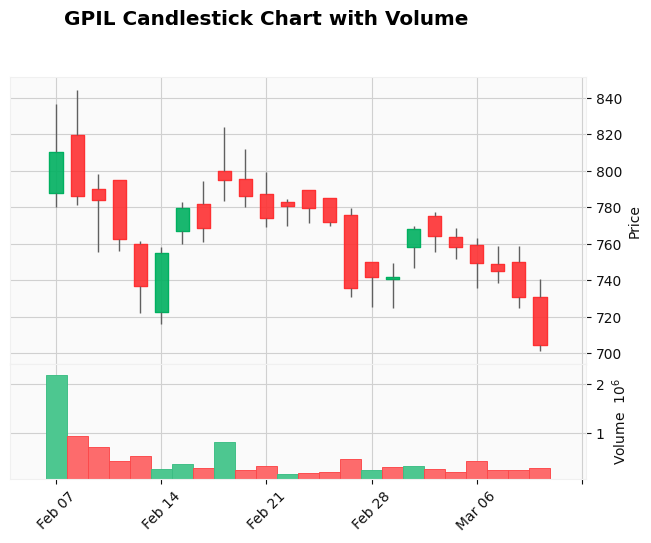

GODREJPROP
2024-02-07 00:00:00


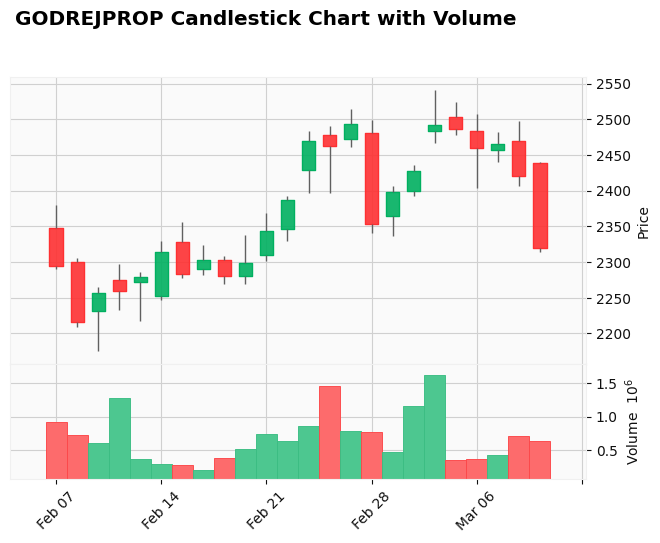

GRASIM
2024-02-07 00:00:00


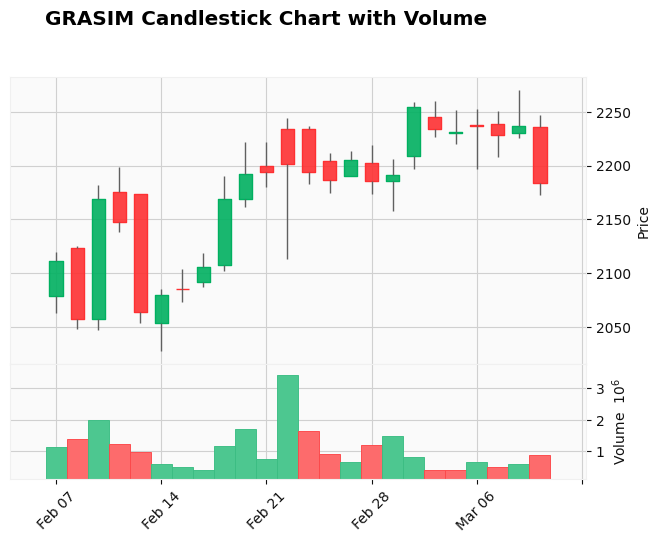

JMFINANCIL
2024-02-07 00:00:00


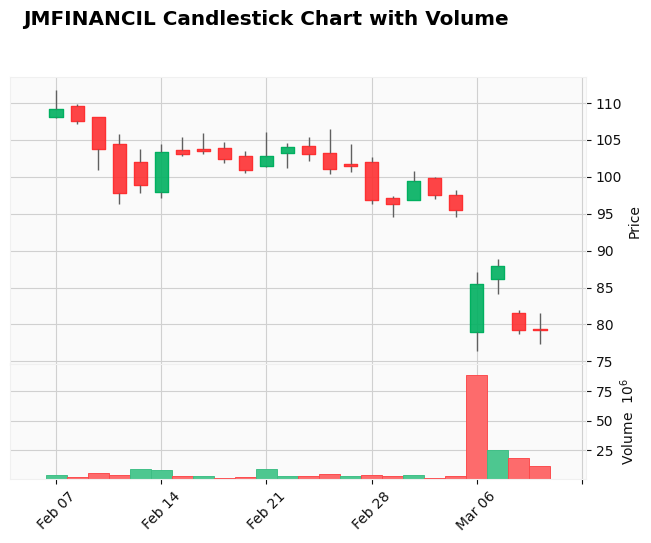

JYOTISTRUC
2024-02-07 00:00:00


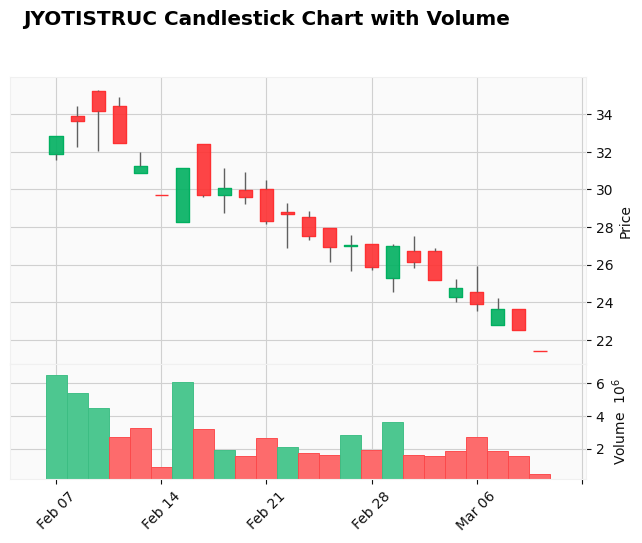

KPIL
2024-02-07 00:00:00


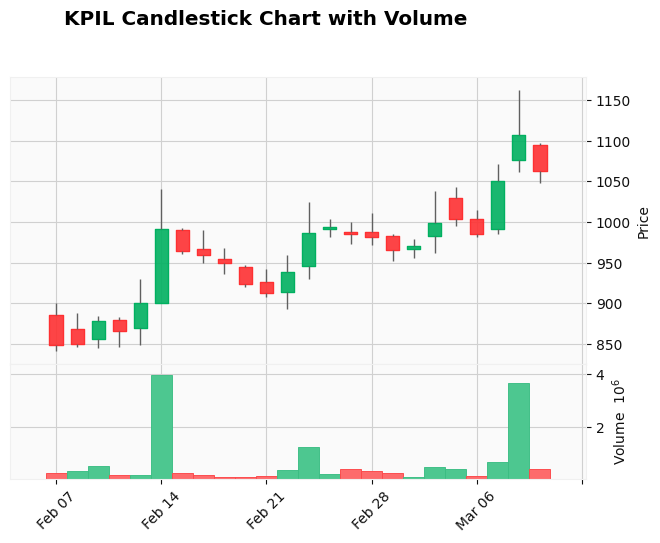

LANDMARK
2024-02-07 00:00:00


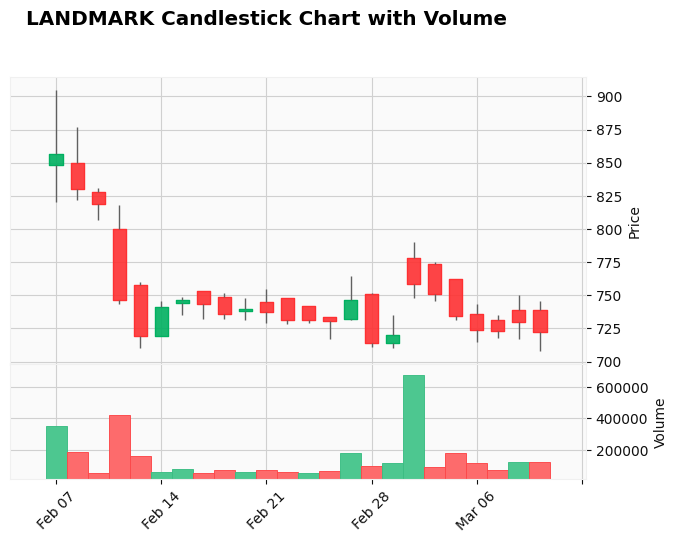

NESTLEIND
2024-02-07 00:00:00


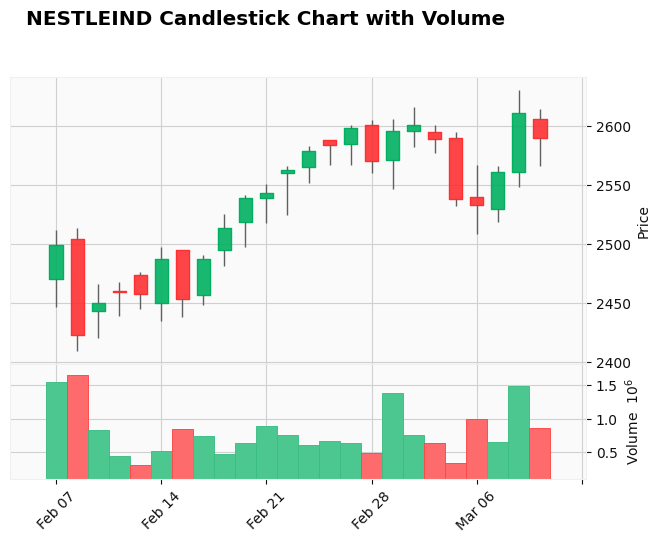

PETRONET
2024-02-07 00:00:00


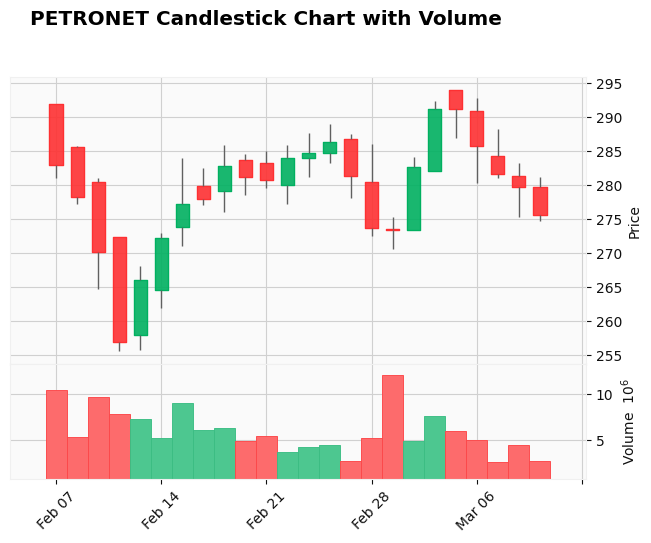

STYRENIX
2024-02-07 00:00:00


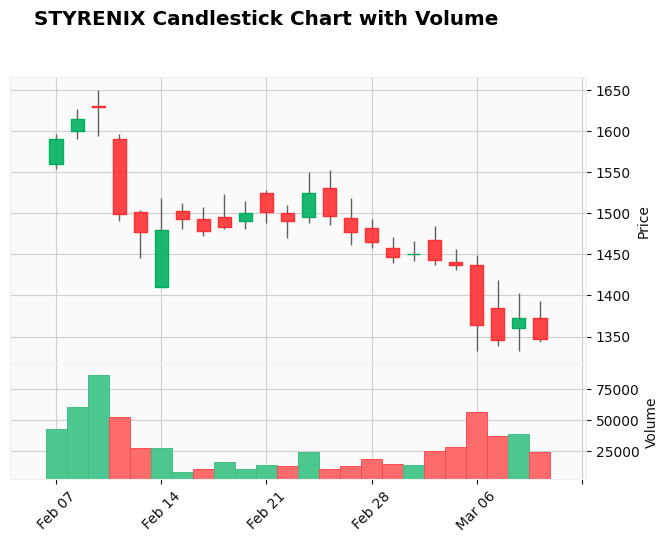

SUNDARMFIN
2024-02-07 00:00:00


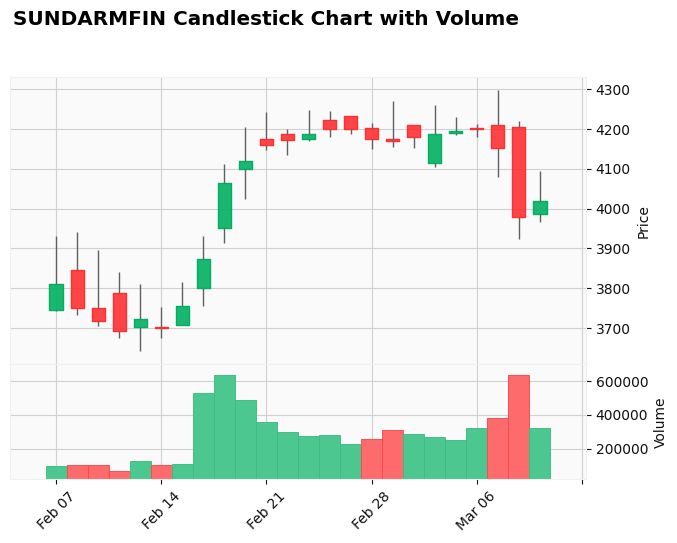

TCS
2024-02-07 00:00:00


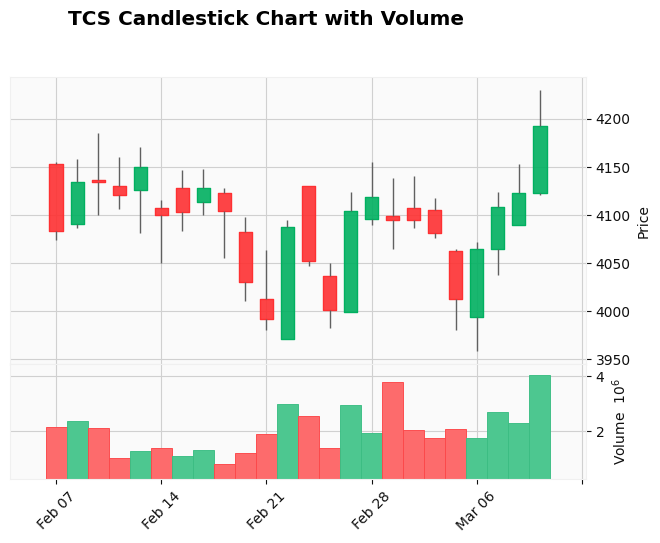

TATASTEEL
2024-02-07 00:00:00


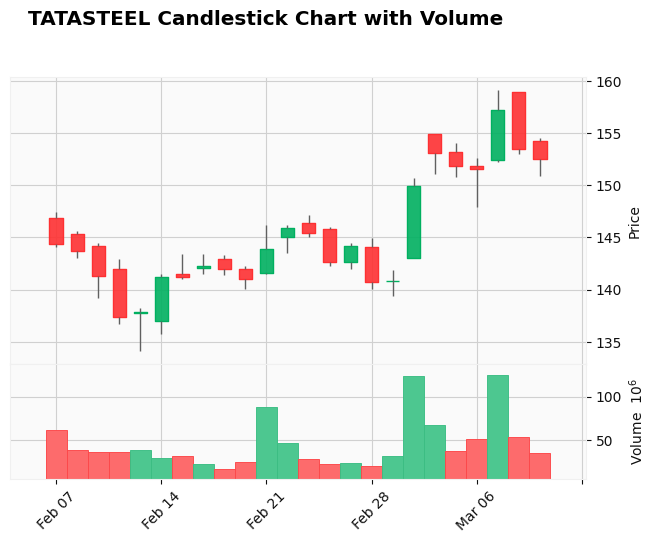

TRITURBINE
2024-02-07 00:00:00


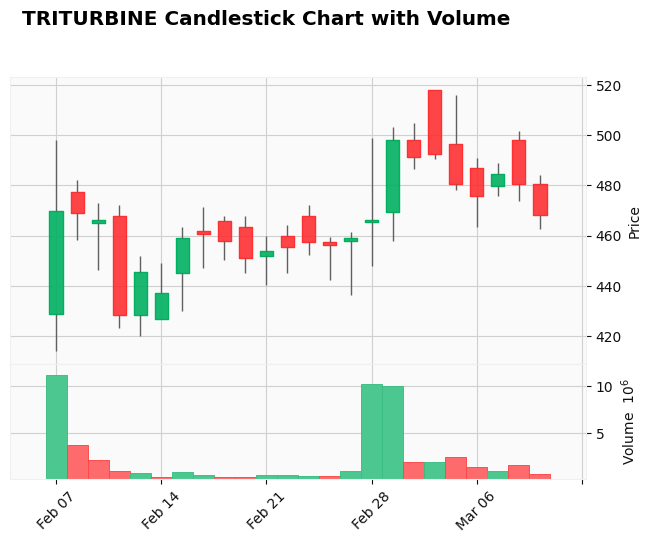

AURIONPRO
2024-02-05 00:00:00


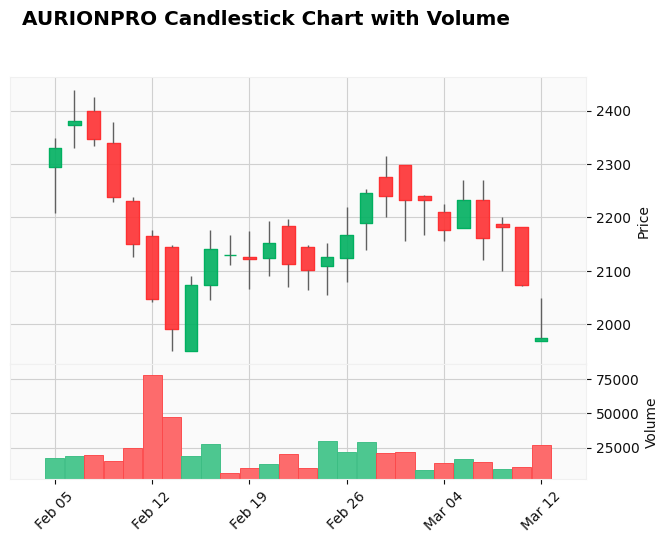

GODREJCP
2024-02-05 00:00:00


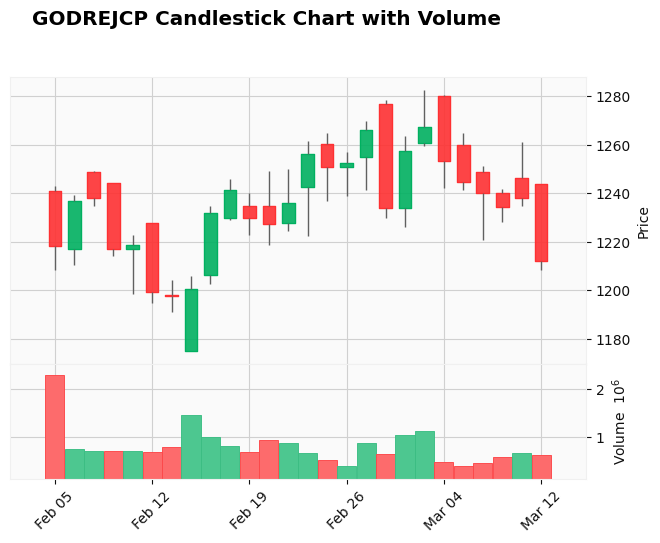

HDFCBANK
2024-02-05 00:00:00


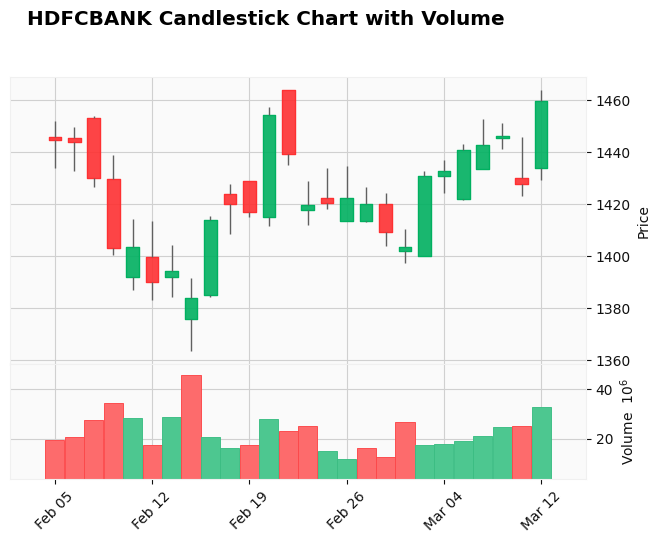

INTELLECT
2024-02-05 00:00:00


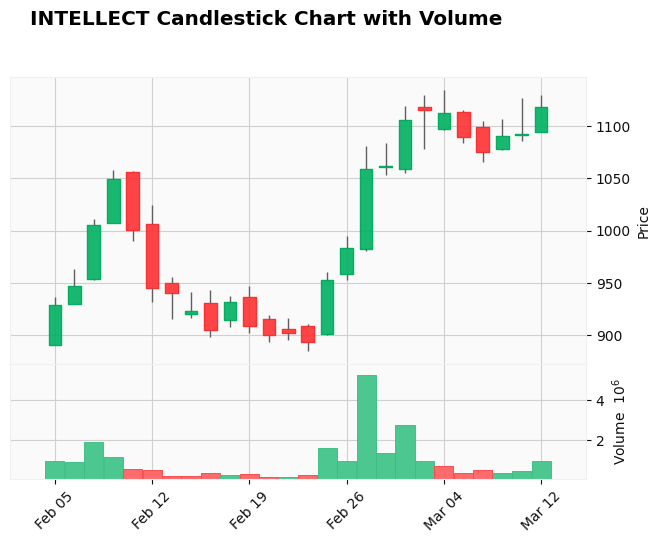

LICHSGFIN
2024-02-05 00:00:00


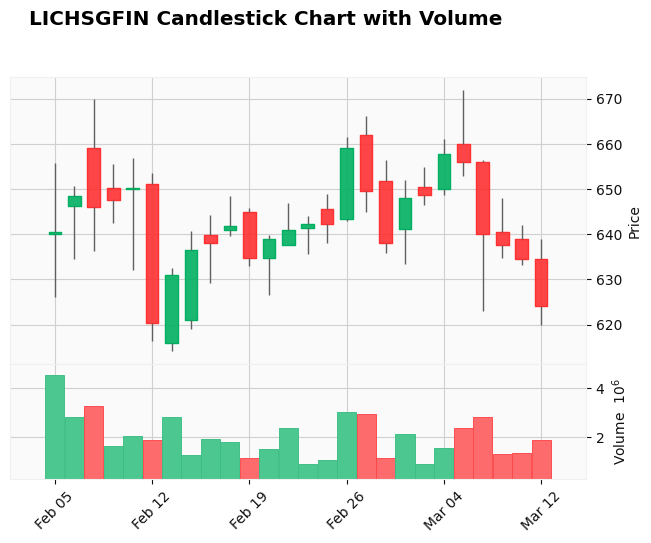

MPHASIS
2024-02-05 00:00:00


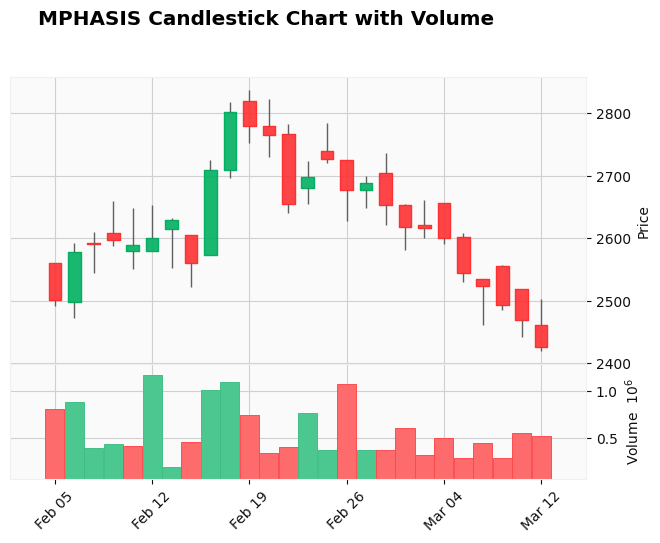

NATCOPHARM
2024-02-05 00:00:00


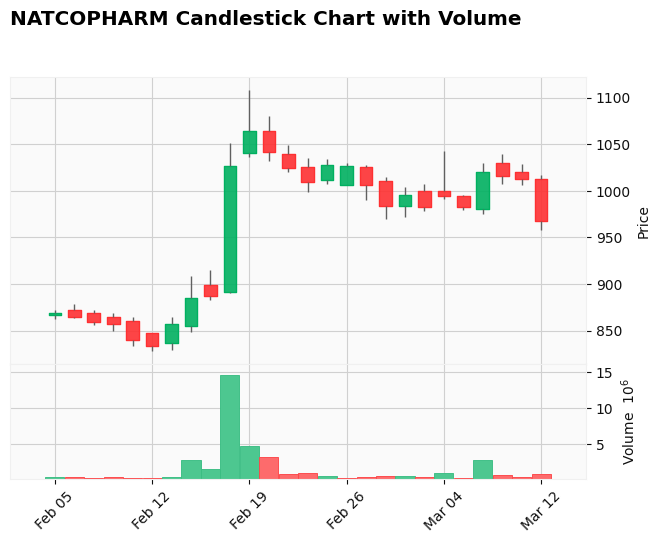

NLCINDIA
2024-02-05 00:00:00


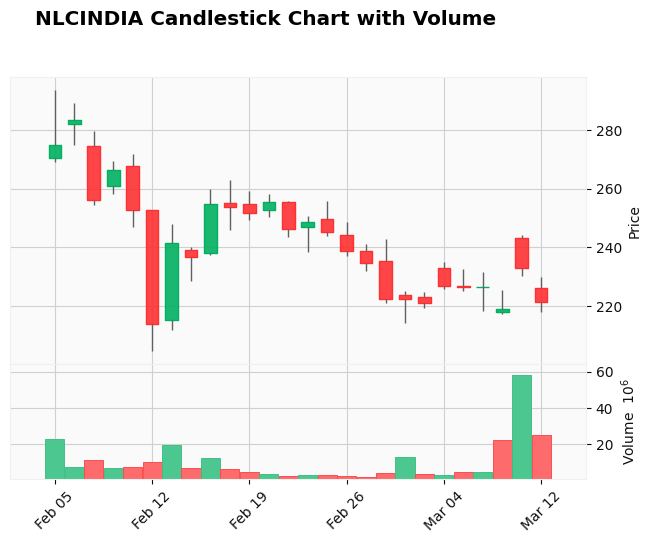

SUNDARMFIN
2024-02-05 00:00:00


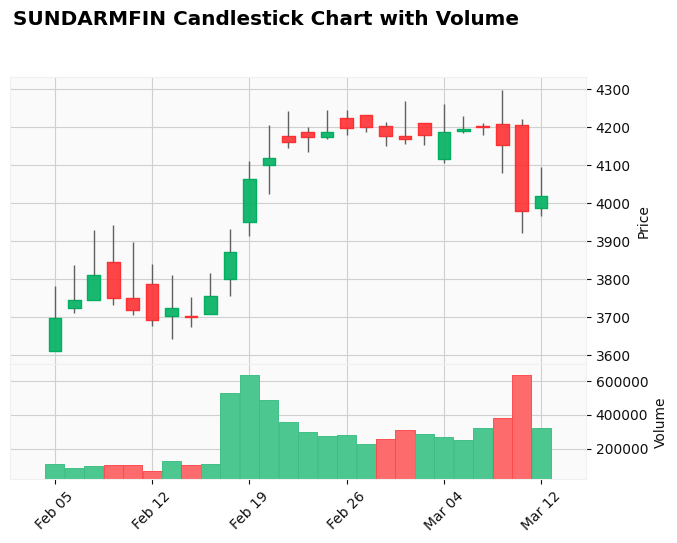

TCS
2024-02-05 00:00:00


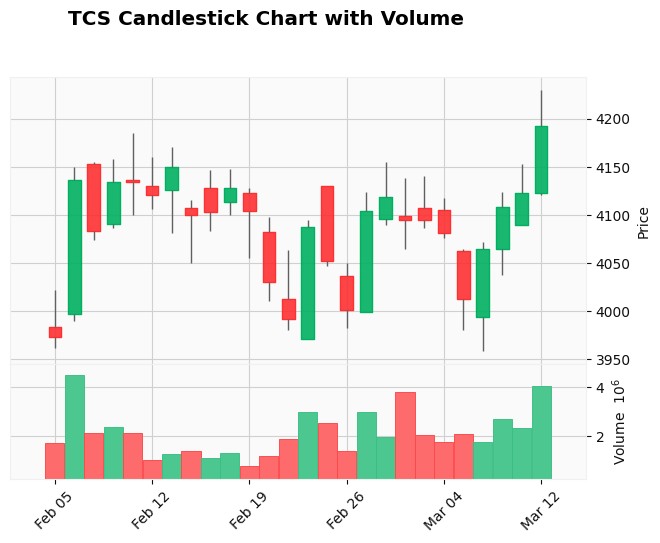

TATAMOTORS
2024-02-05 00:00:00


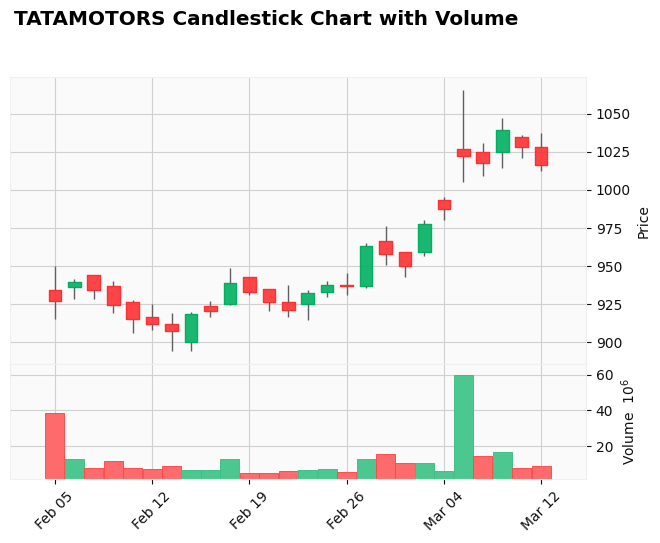

THYROCARE
2024-02-05 00:00:00


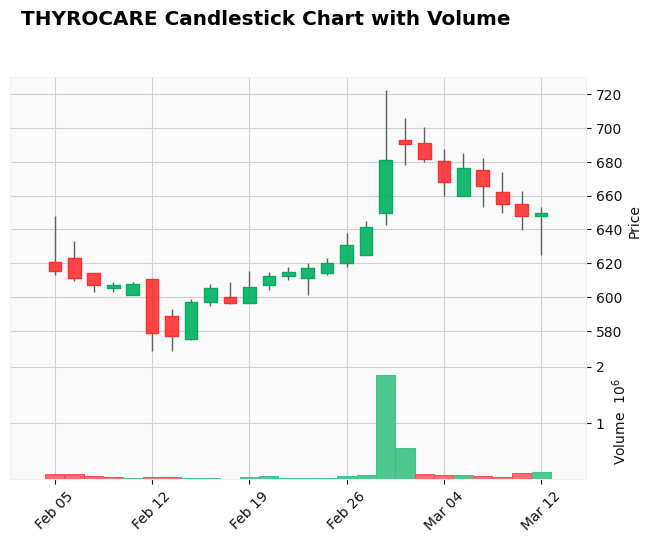

TITAGARH
2024-02-05 00:00:00


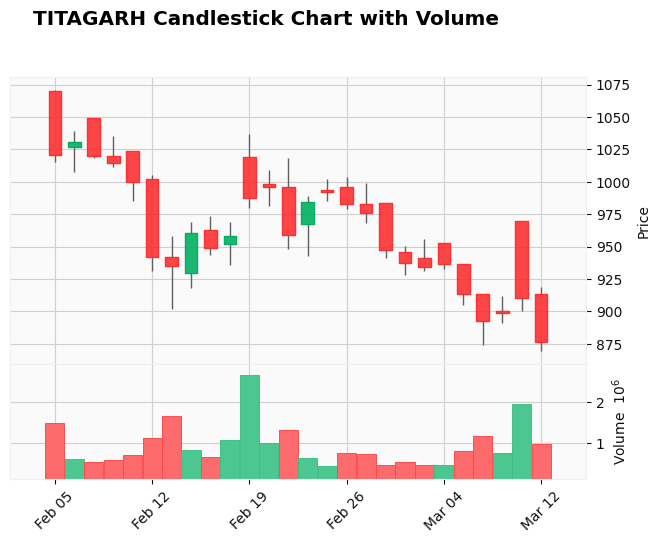

WABAG
2024-02-05 00:00:00


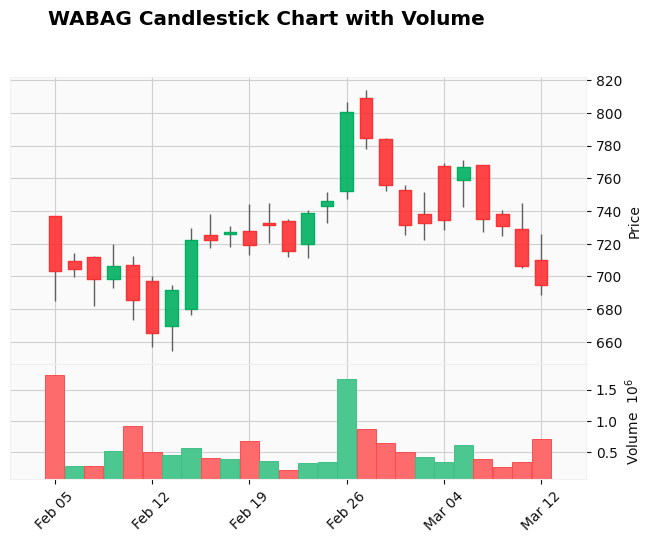

VBL
2024-02-05 00:00:00


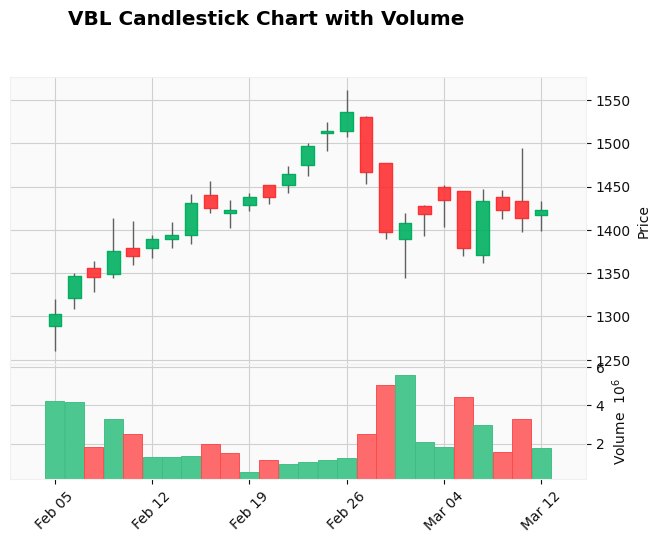

ALKYLAMINE
2024-02-02 00:00:00


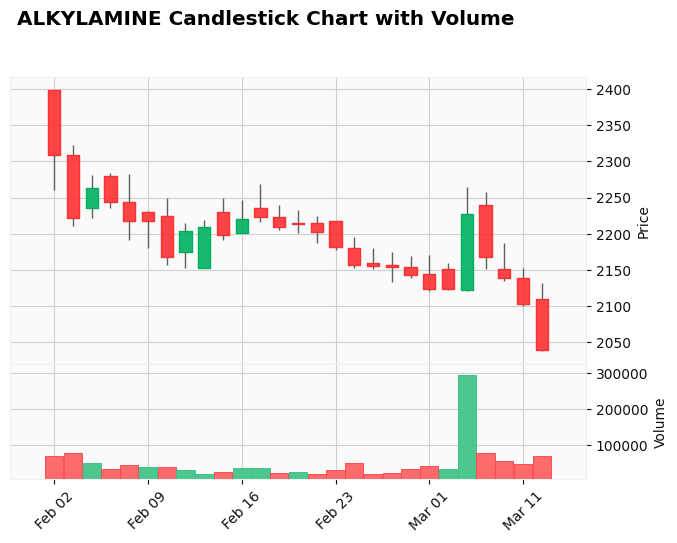

CARERATING
2024-02-02 00:00:00


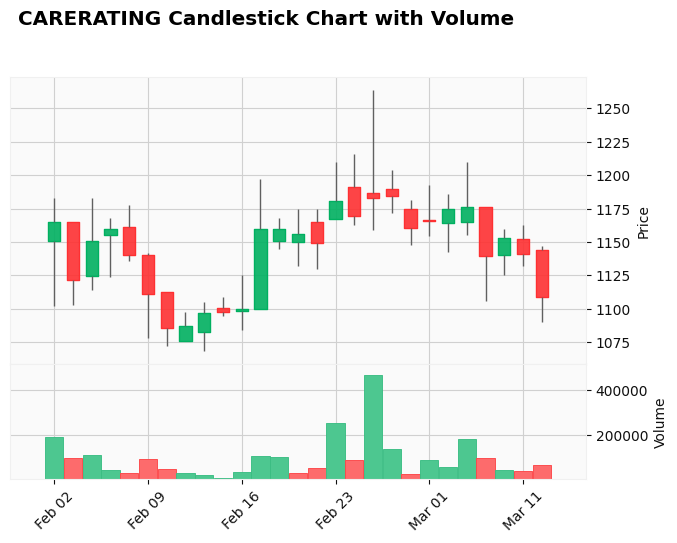

CASTROLIND
2024-02-02 00:00:00


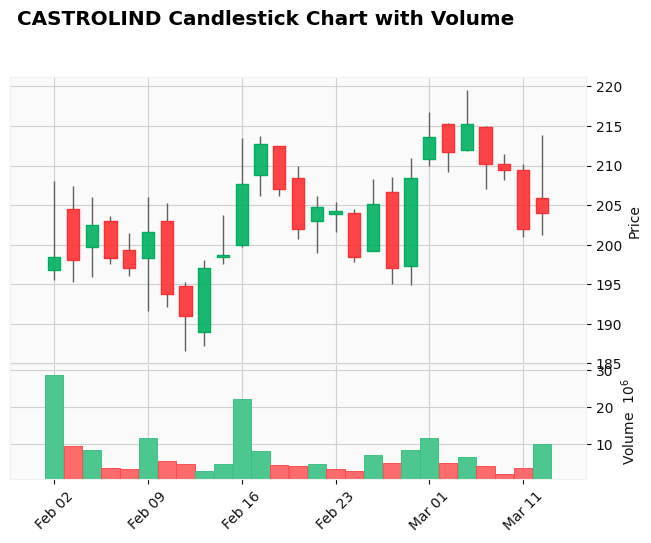

COALINDIA
2024-02-02 00:00:00


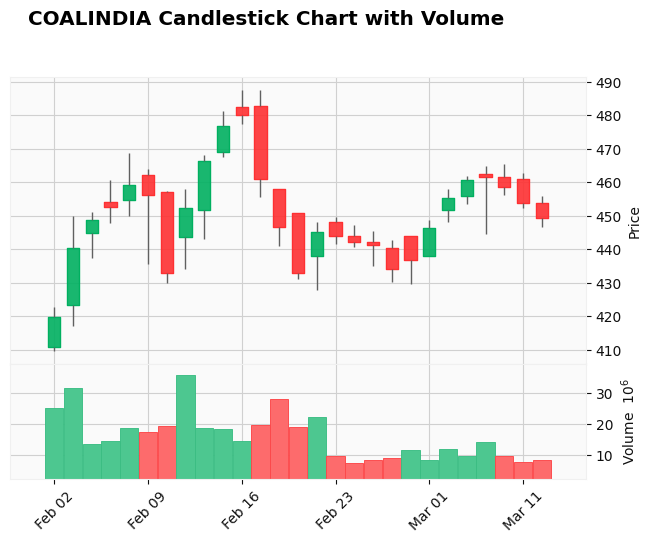

EMSLIMITED
2024-02-02 00:00:00


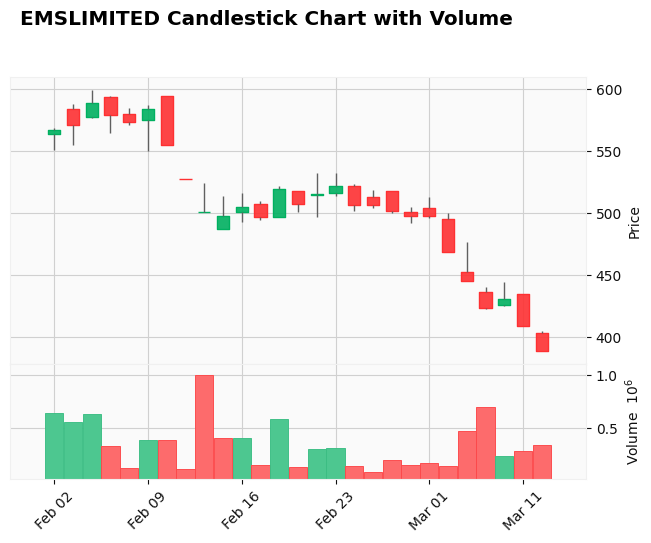

GOODLUCK
2024-02-02 00:00:00


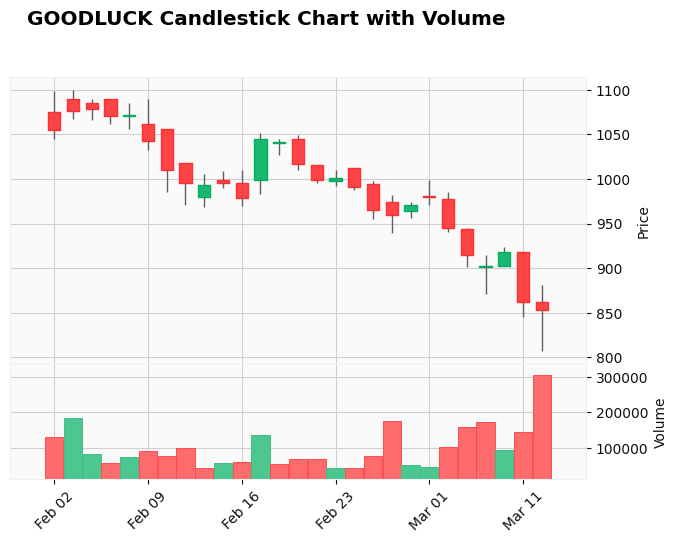

GAEL
2024-02-02 00:00:00


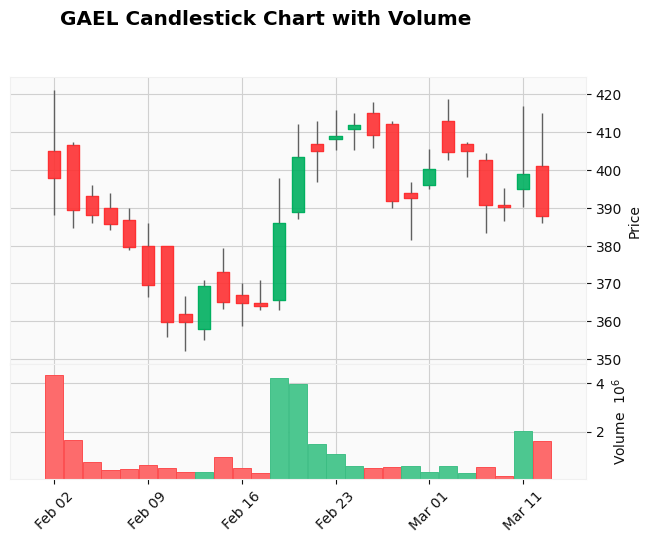

JSWINFRA
2024-02-02 00:00:00


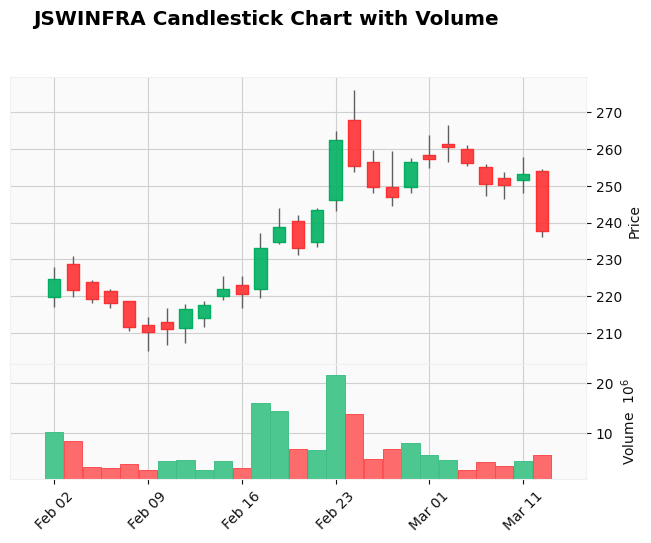

MARUTI
2024-02-02 00:00:00


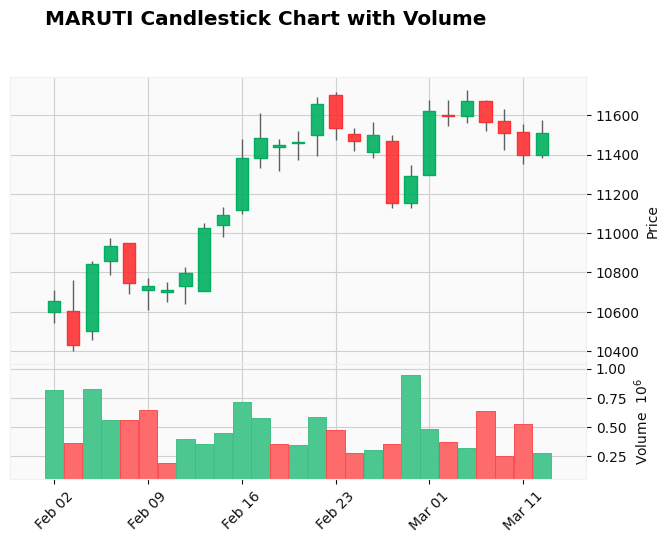

SBIN
2024-02-02 00:00:00


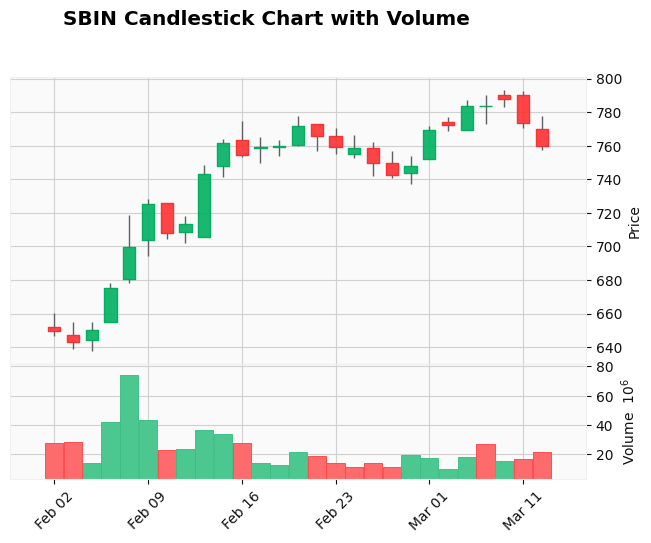

TATAMOTORS
2024-02-02 00:00:00


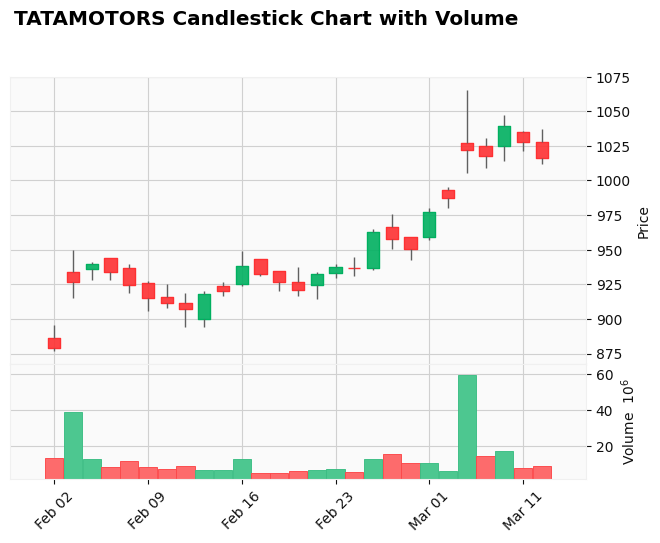

GEOJITFSL
2024-02-01 00:00:00


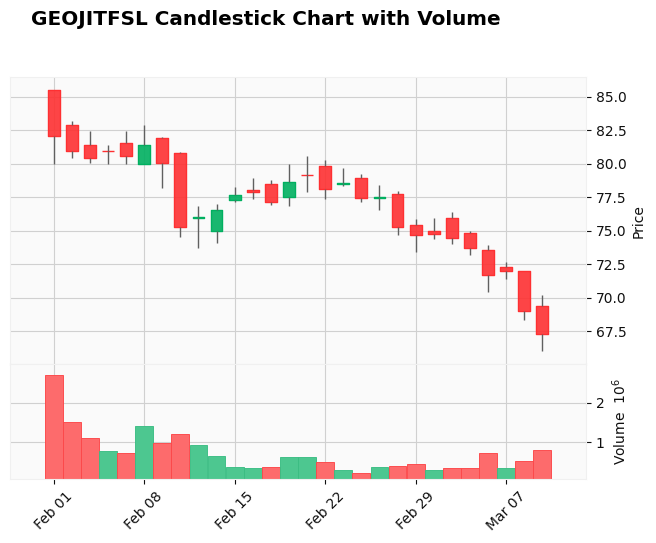

GEOJITFSL
2024-02-01 00:00:00


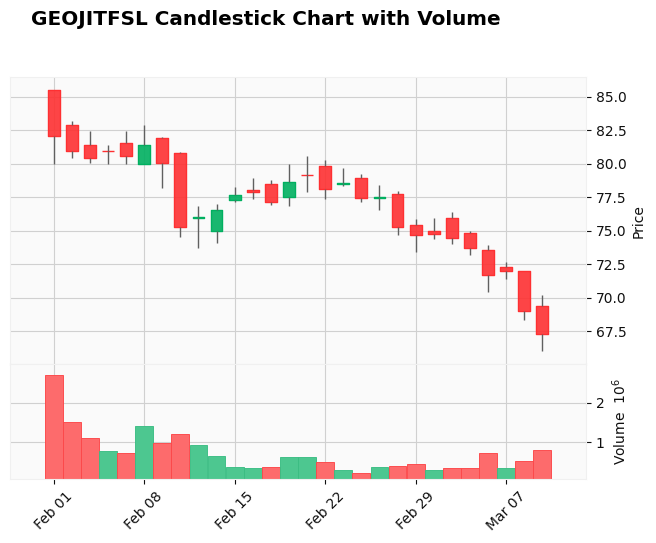

SOUTHBANK
2024-02-01 00:00:00


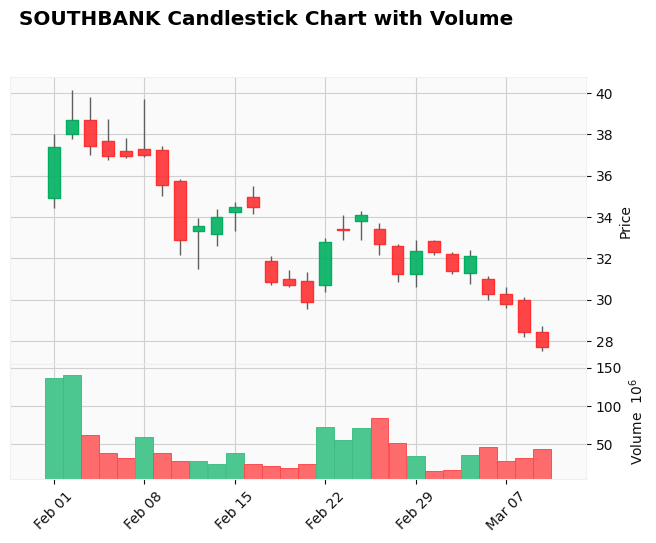

MOTILALOFS
2024-02-01 00:00:00


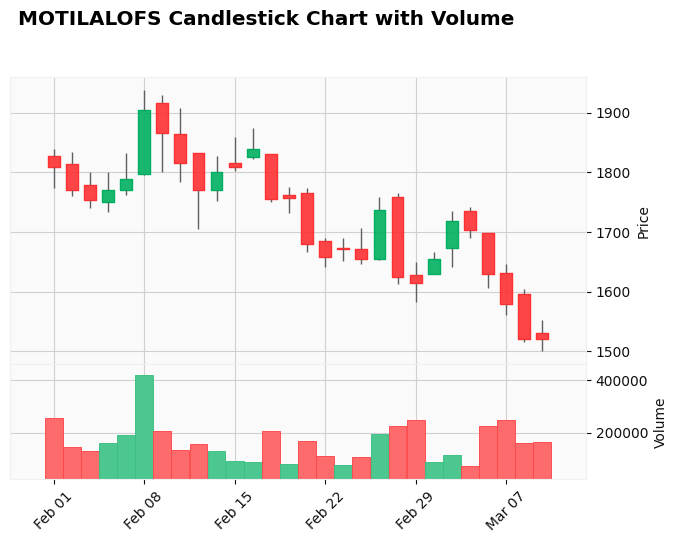

ORIENTELEC
2024-02-01 00:00:00


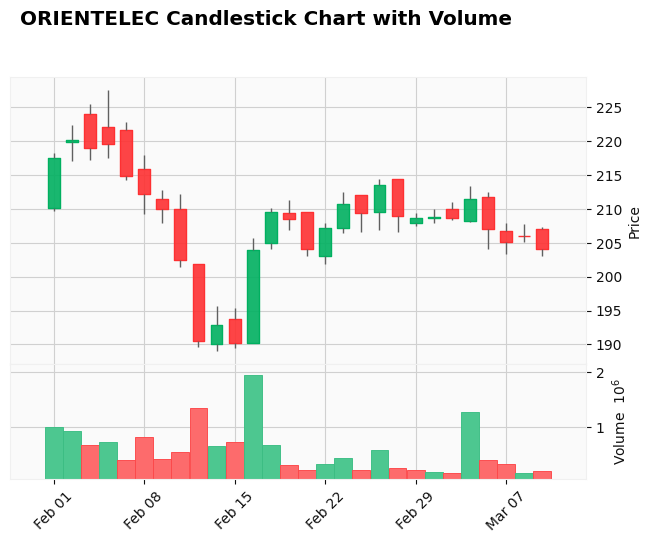

SHREECEM
2024-02-01 00:00:00


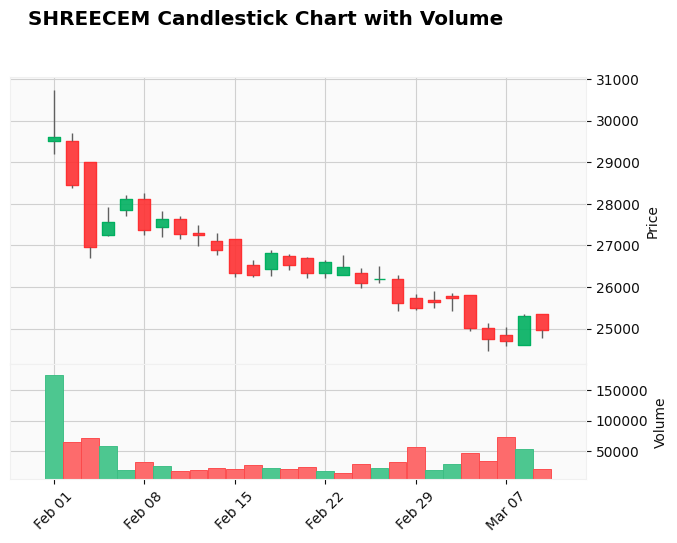

TITAGARH
2024-02-01 00:00:00


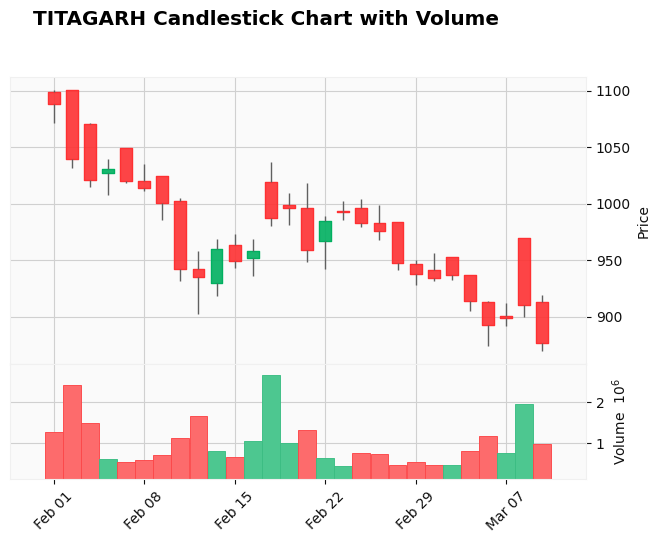

TITAN
2024-02-01 00:00:00


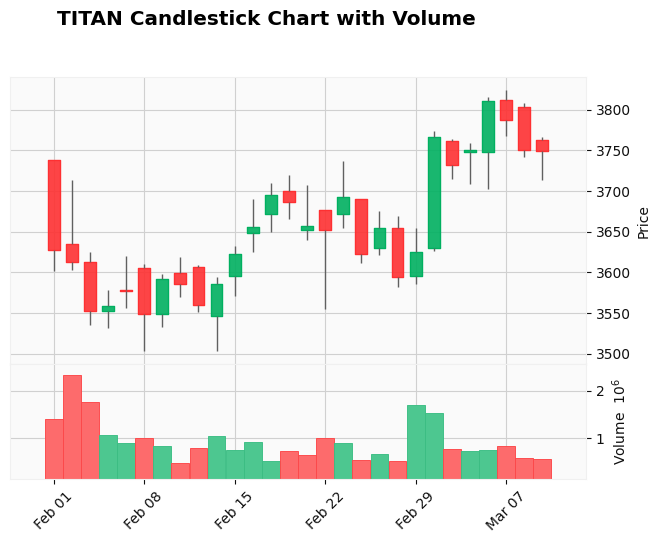

AXISBANK
2024-01-31 00:00:00


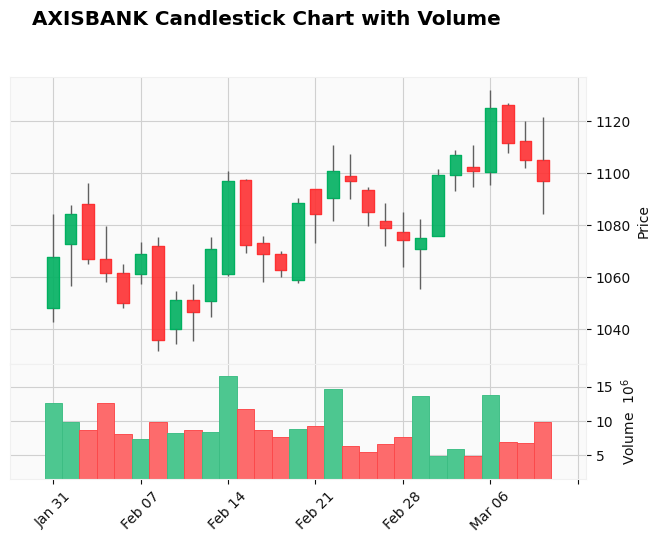

BAJFINANCE
2024-01-31 00:00:00


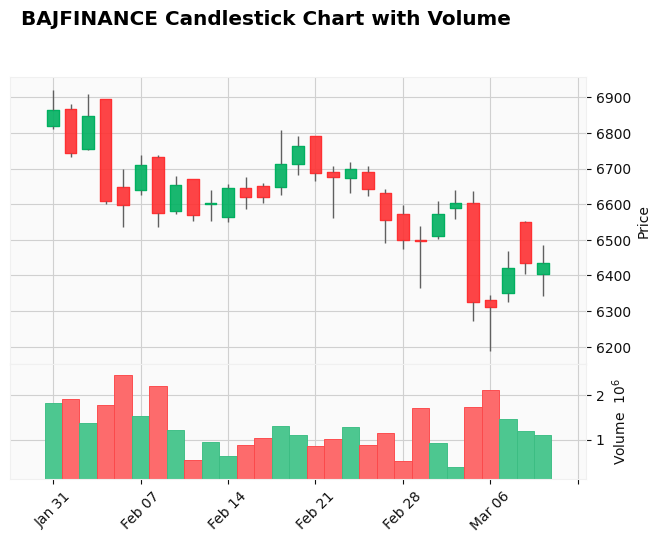

BANKBARODA
2024-01-31 00:00:00


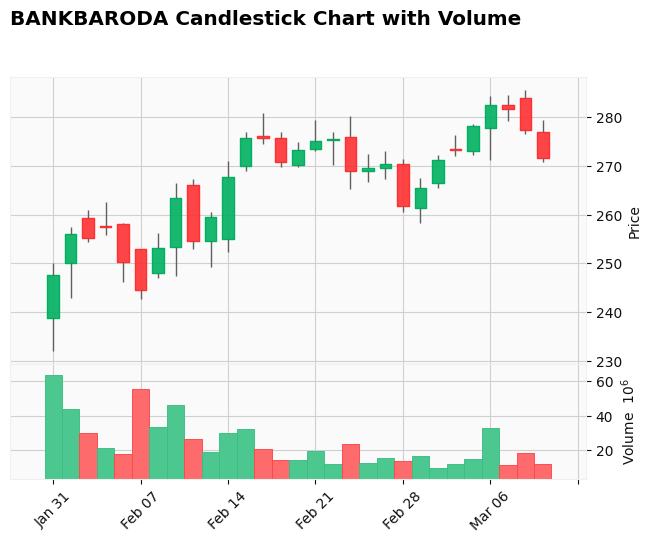

BPCL
2024-01-31 00:00:00


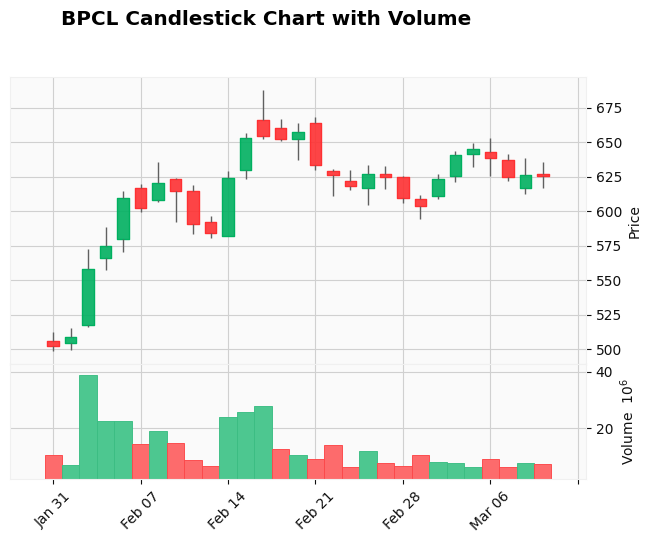

CREDITACC
2024-01-31 00:00:00


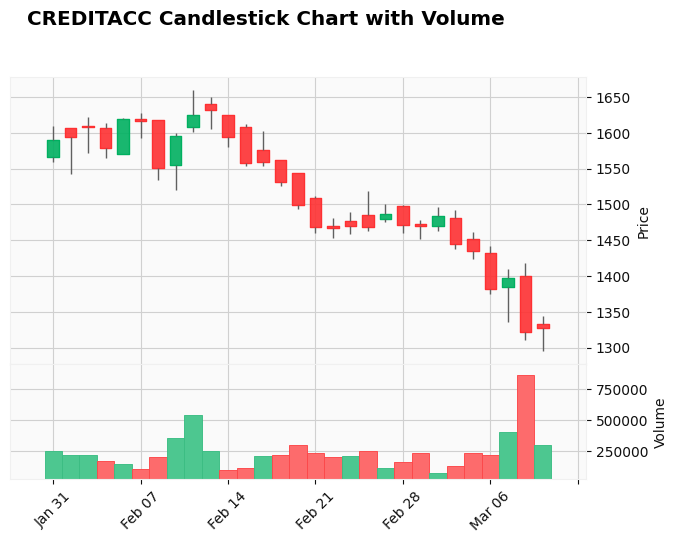

HDFCBANK
2024-01-31 00:00:00


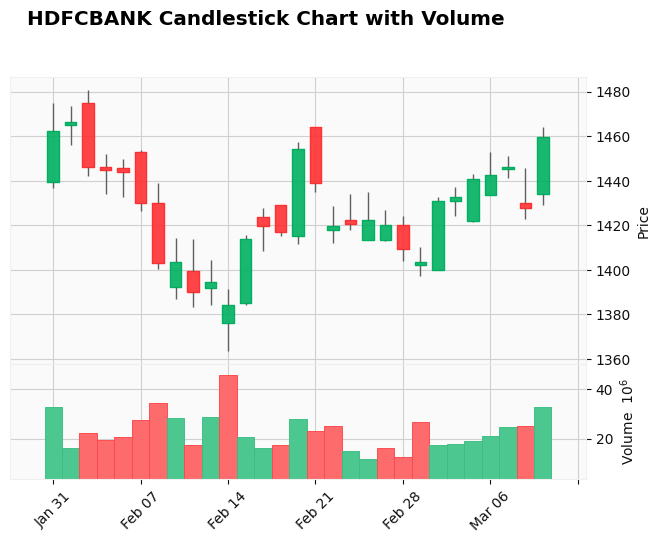

IGL
2024-01-31 00:00:00


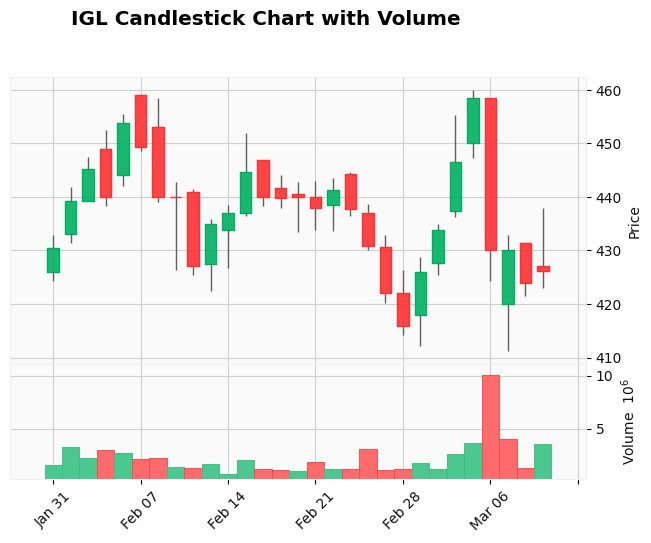

JSWSTEEL
2024-01-31 00:00:00


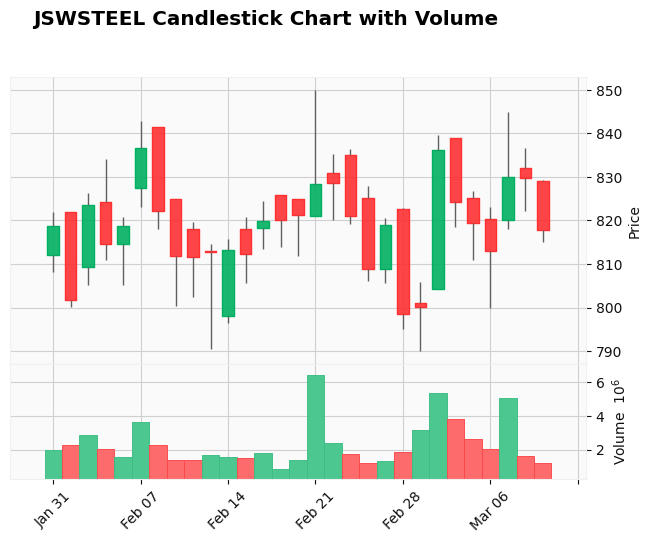

KALYANKJIL
2024-01-31 00:00:00


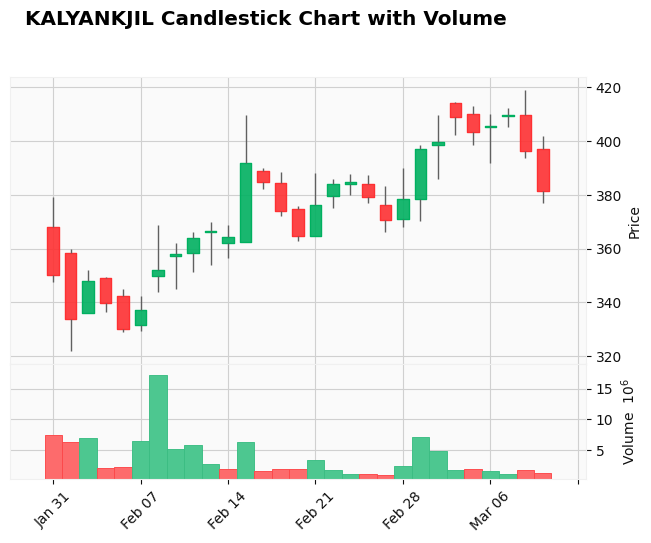

KARURVYSYA
2024-01-31 00:00:00


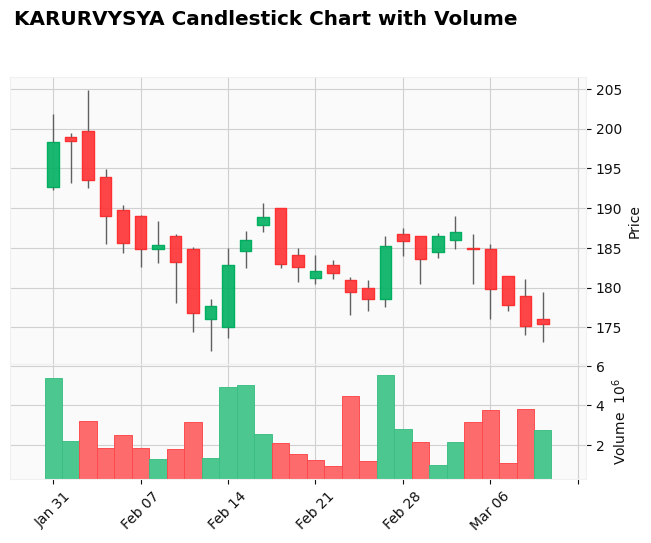

LATENTVIEW
2024-01-31 00:00:00


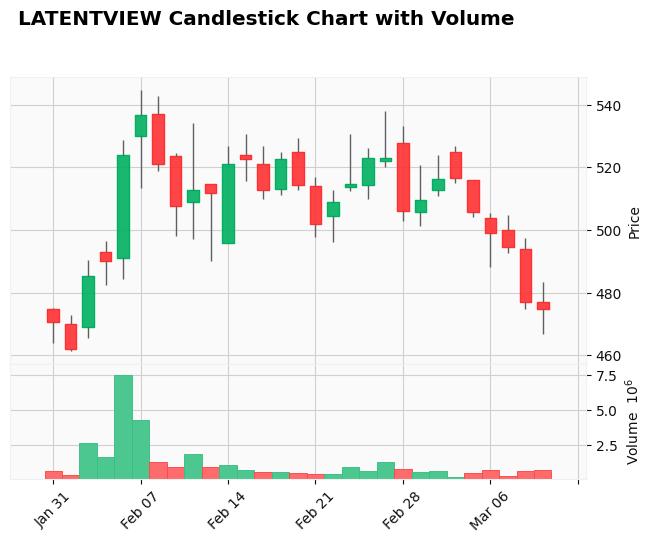

NOVAAGRI
2024-01-31 00:00:00


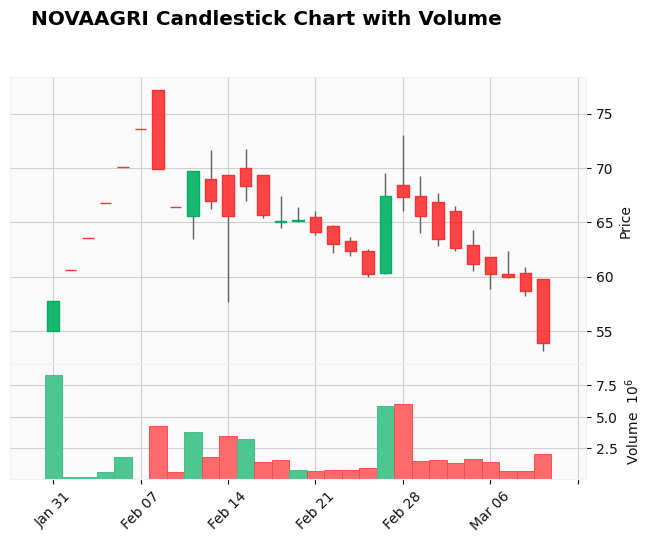

RANEENGINE
2024-01-31 00:00:00


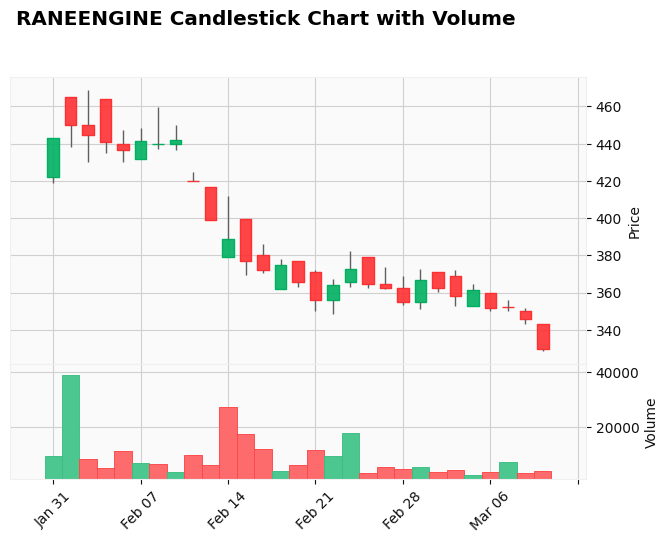

APLAPOLLO
2024-01-30 00:00:00


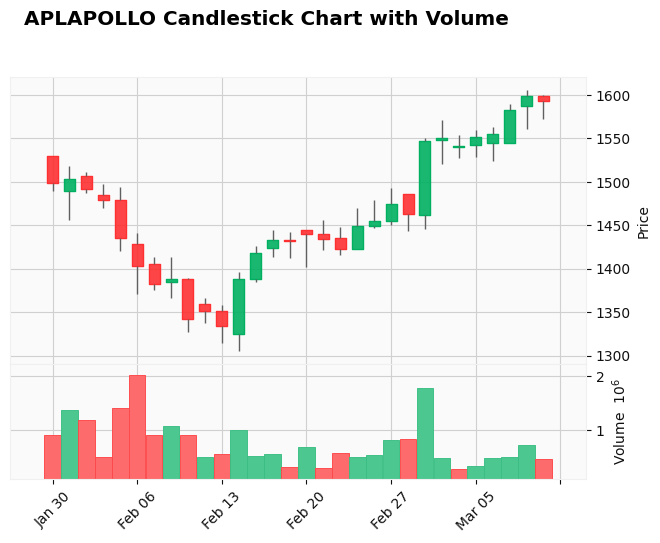

DALMIASUG
2024-01-30 00:00:00


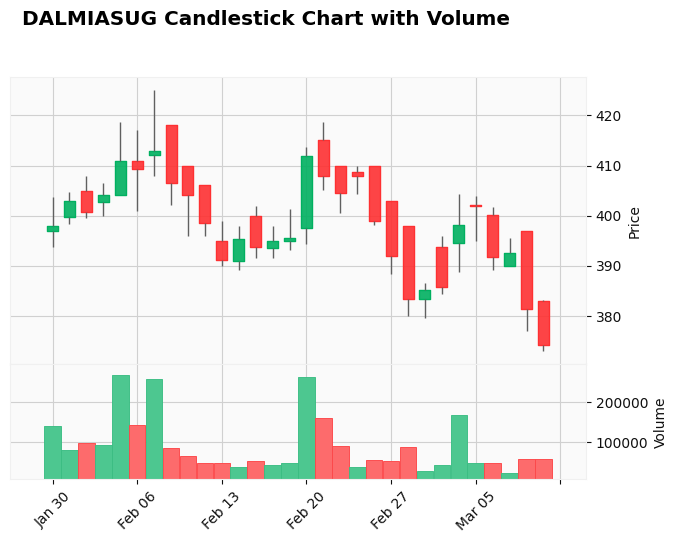

GEOJITFSL
2024-01-30 00:00:00


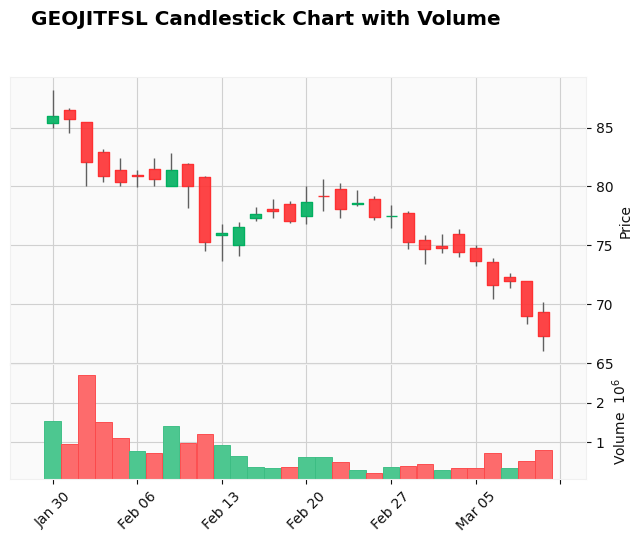

IEX
2024-01-30 00:00:00


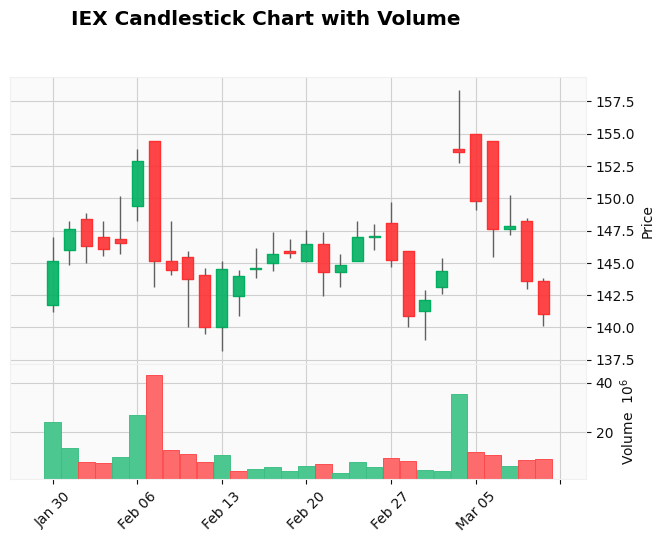

LODHA
2024-01-30 00:00:00


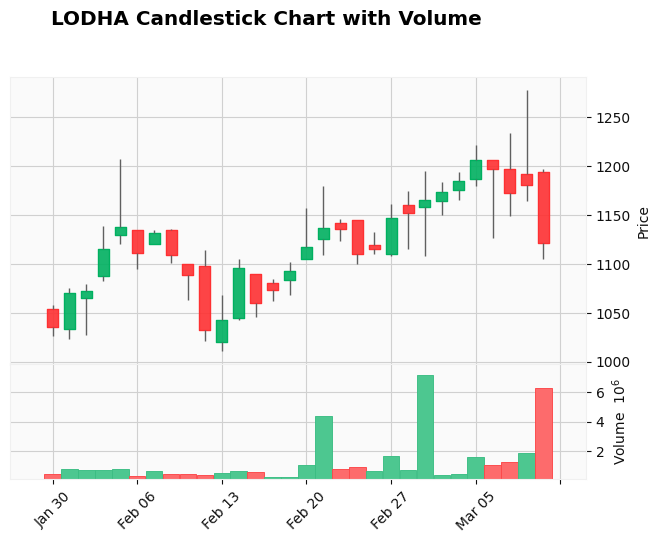

RELIANCE
2024-01-30 00:00:00


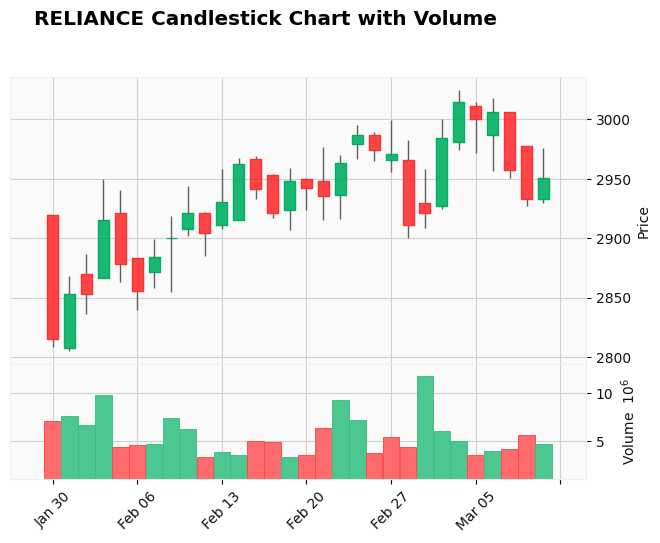

RELIANCE
2024-01-30 00:00:00


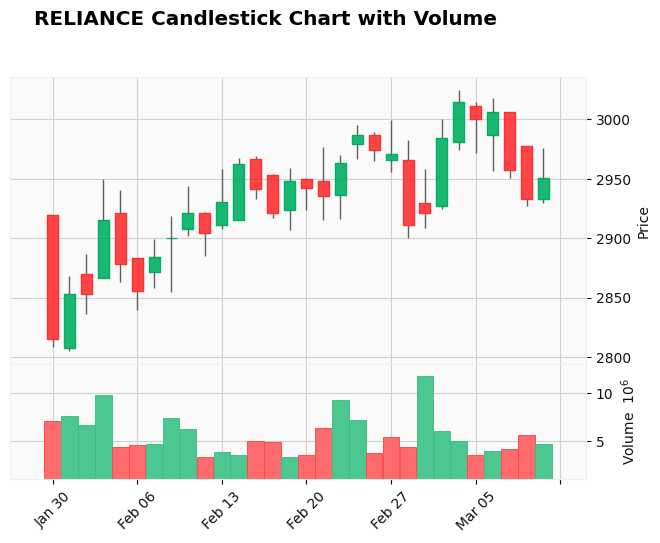

ANGELONE
2024-01-29 00:00:00


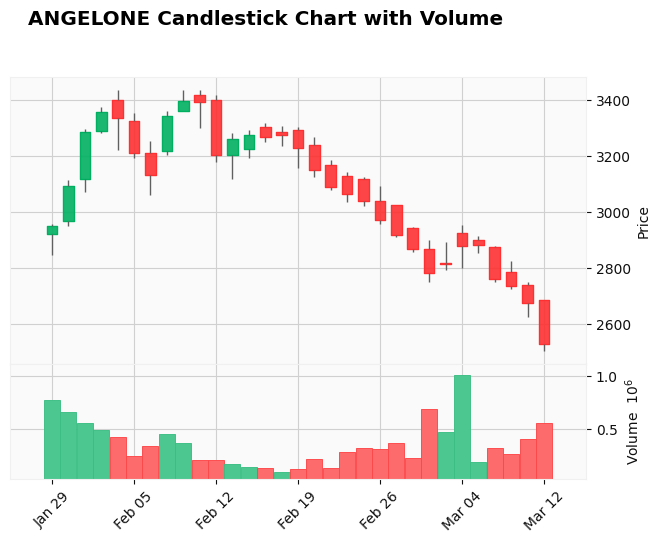

AZAD
2024-01-29 00:00:00


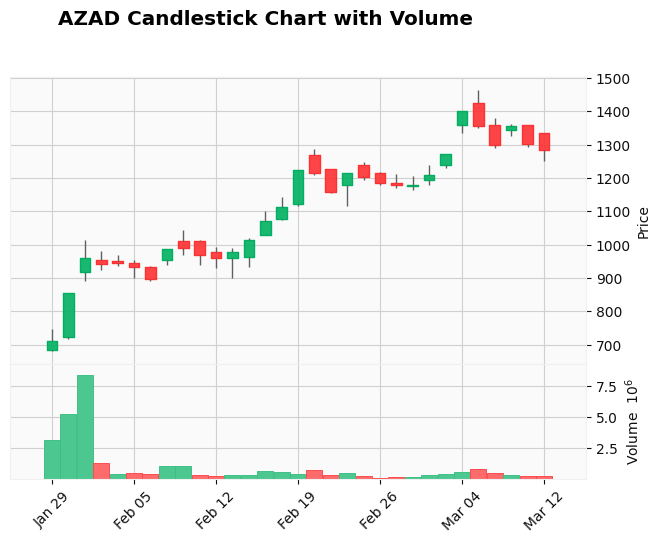

BHARTIARTL
2024-01-29 00:00:00


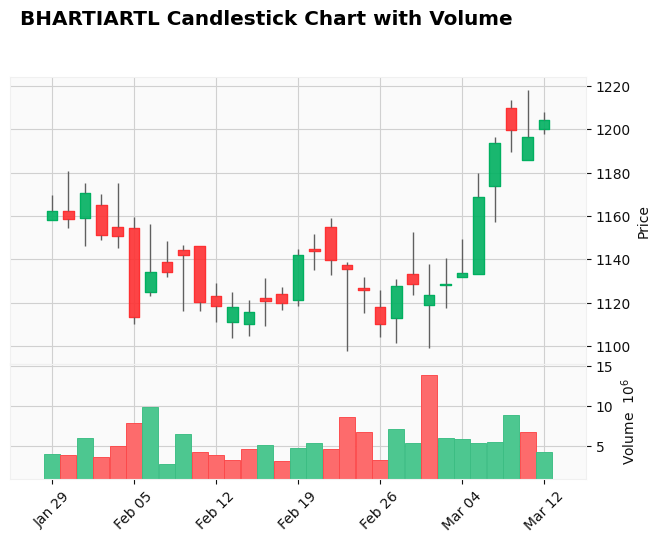

CANFINHOME
2024-01-29 00:00:00


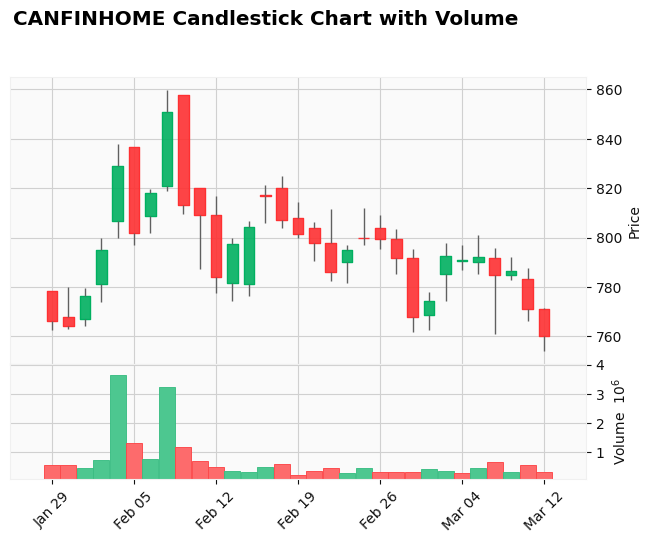

DALMIASUG
2024-01-29 00:00:00


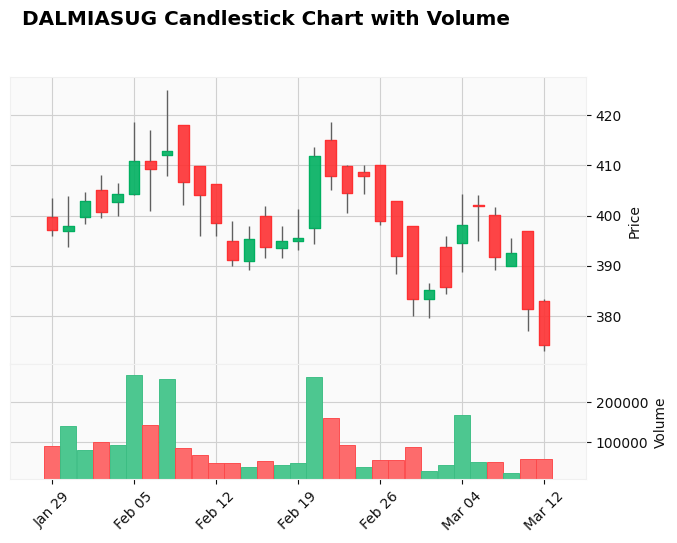

DALMIASUG
2024-01-29 00:00:00


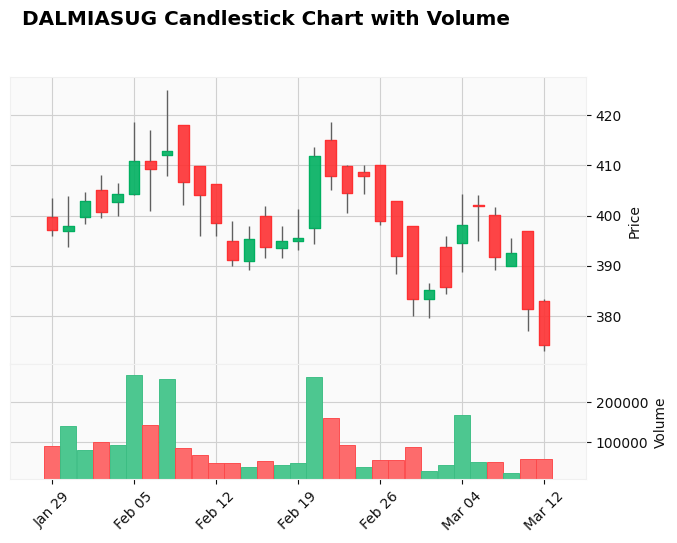

DCBBANK
2024-01-29 00:00:00


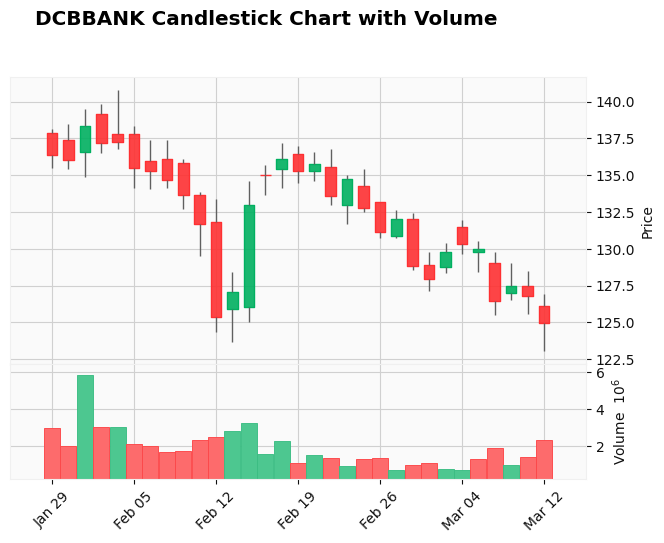

FEDERALBNK
2024-01-29 00:00:00


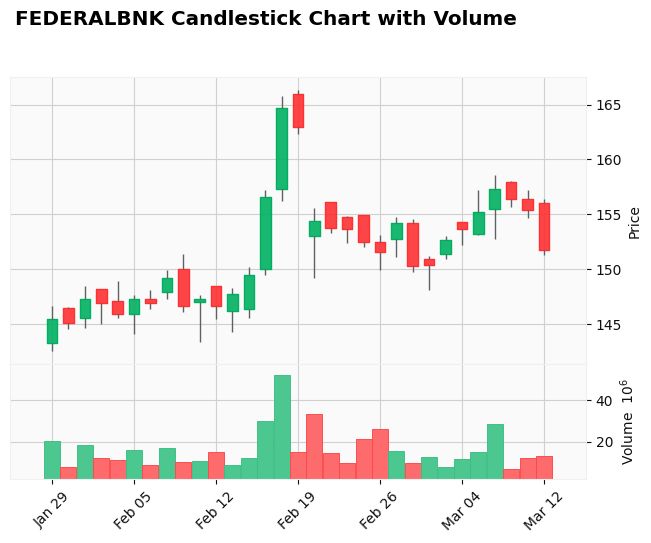

INOXWIND
2024-01-29 00:00:00


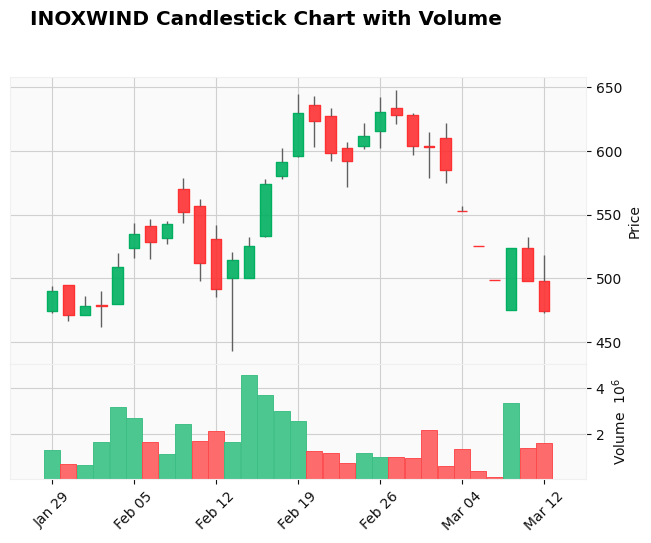

JMFINANCIL
2024-01-29 00:00:00


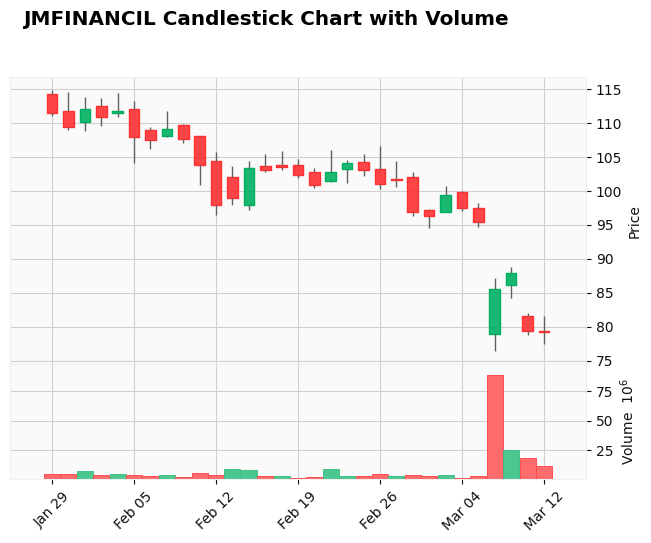

JSWSTEEL
2024-01-29 00:00:00


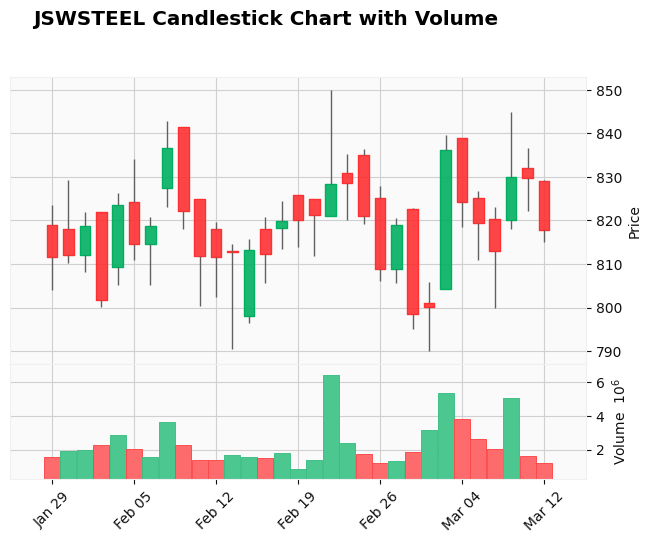

LATENTVIEW
2024-01-29 00:00:00


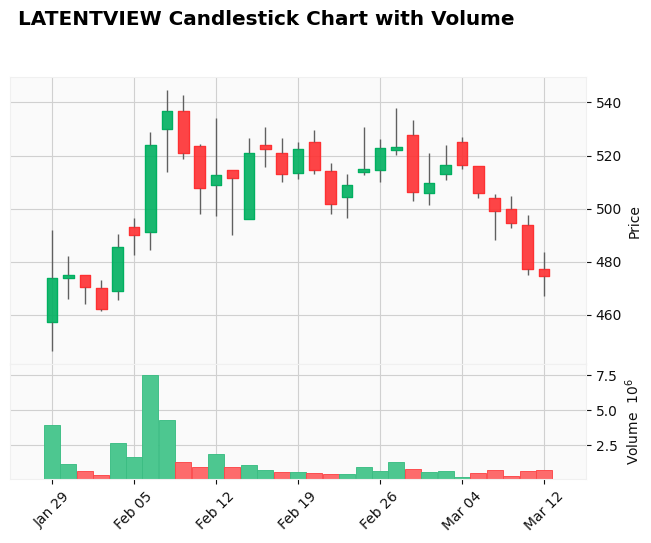

PETRONET
2024-01-29 00:00:00


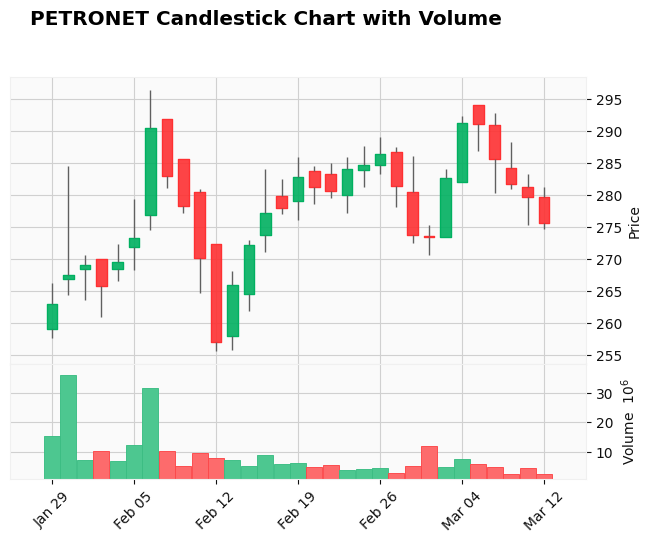

RELIANCE
2024-01-29 00:00:00


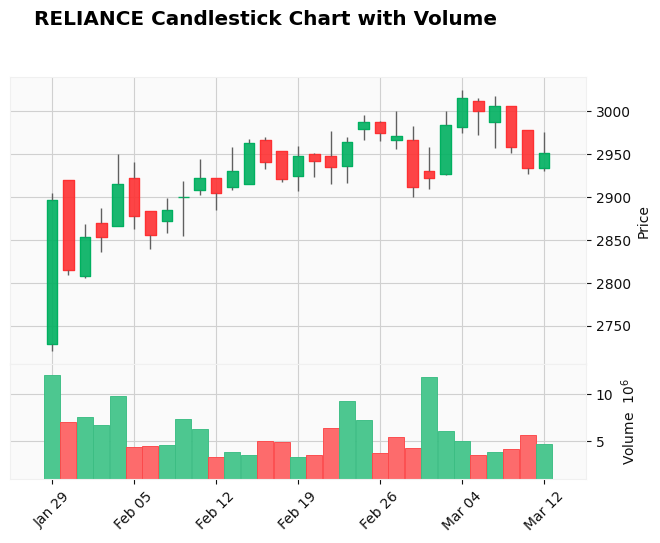

TATAPOWER
2024-01-29 00:00:00


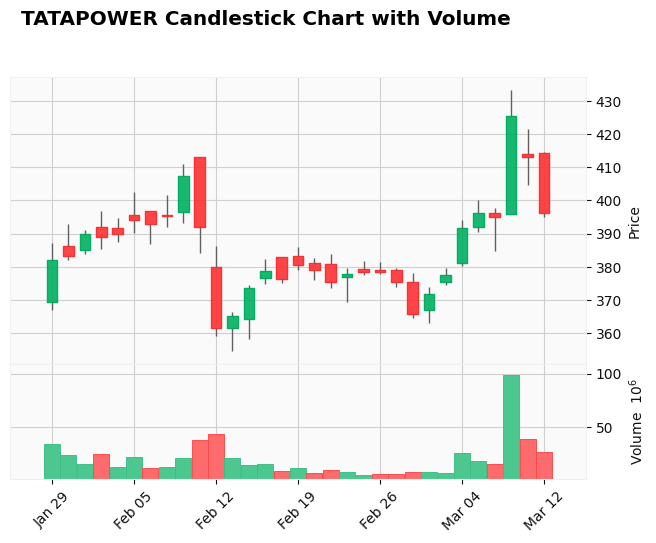

TATASTEEL
2024-01-29 00:00:00


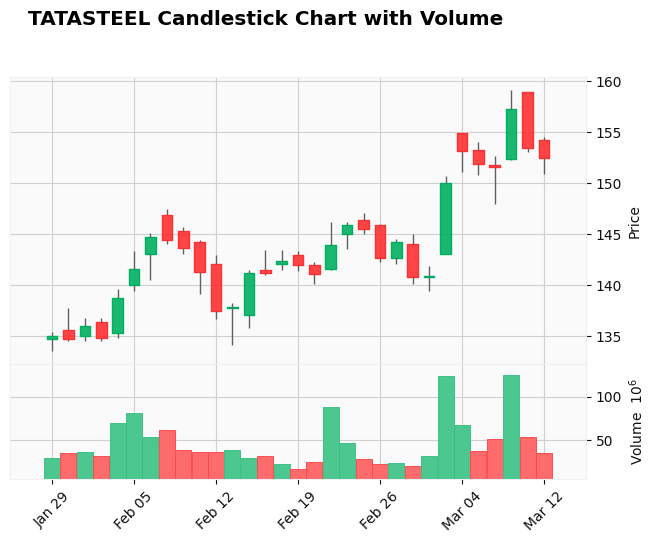

ZENTEC
2024-01-29 00:00:00


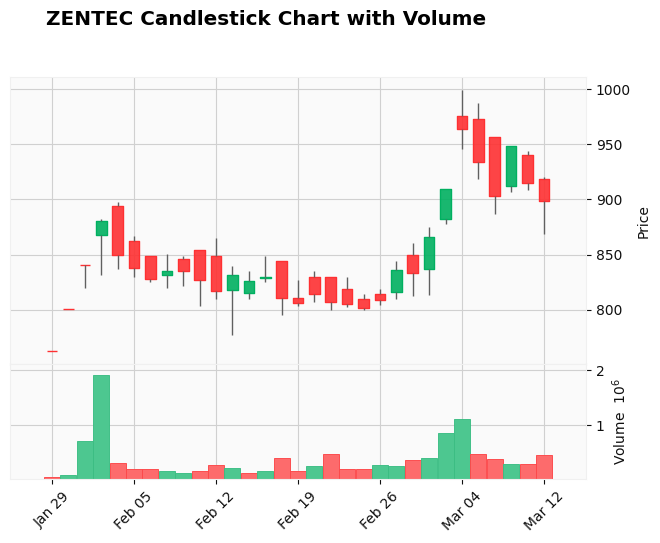

CANBK
2024-01-25 00:00:00


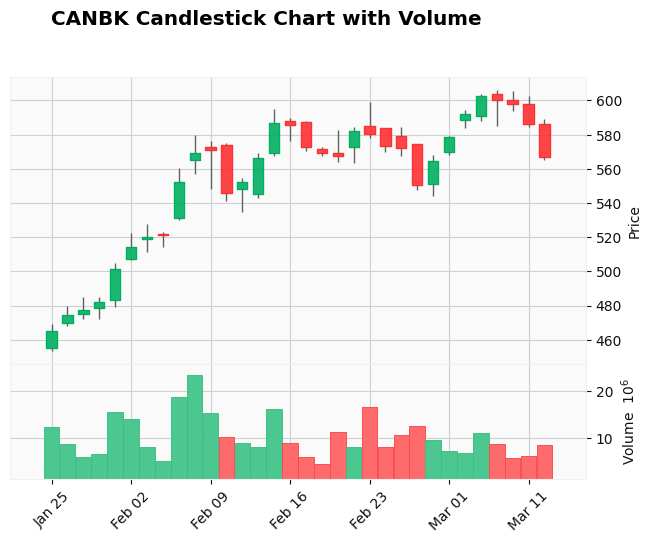

ELECON
2024-01-25 00:00:00


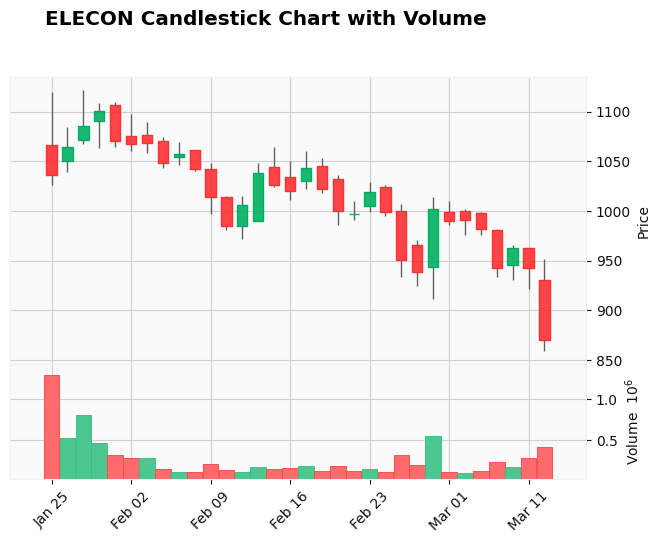

ELECON
2024-01-25 00:00:00


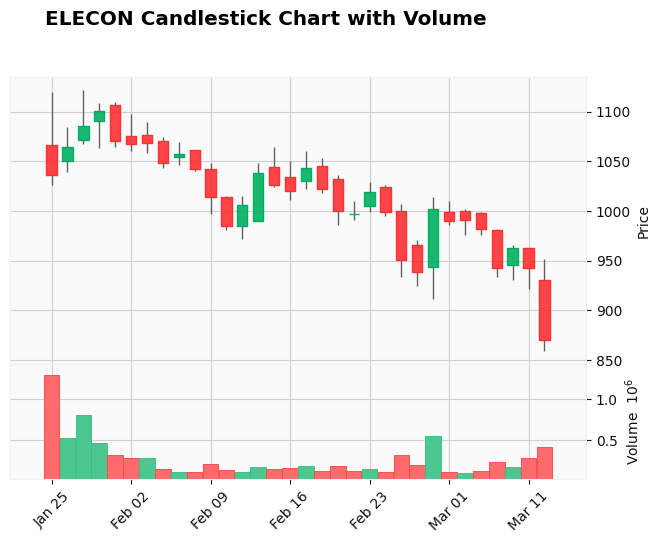

GRAVITA
2024-01-25 00:00:00


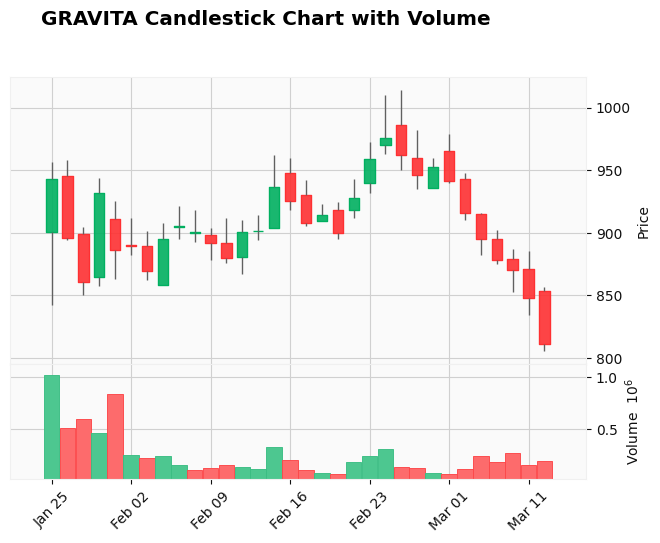

HAVELLS
2024-01-25 00:00:00


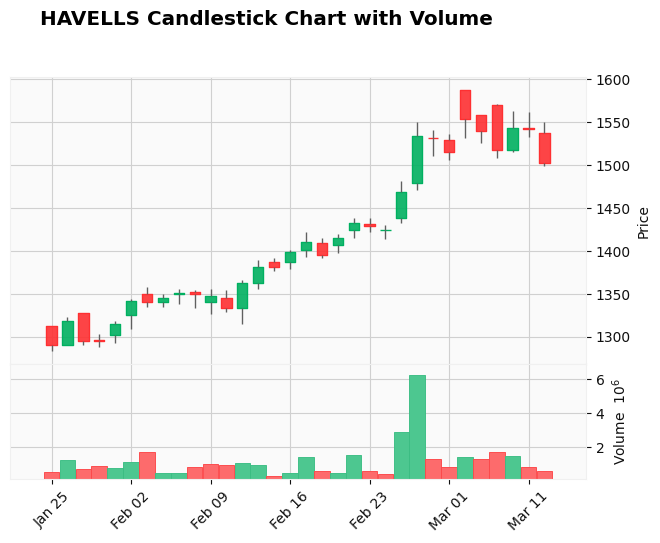

SOUTHBANK
2024-01-25 00:00:00


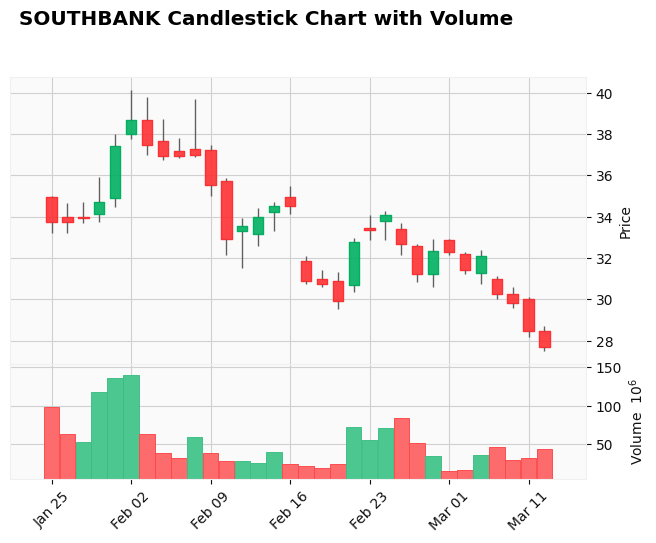

MGL
2024-01-25 00:00:00


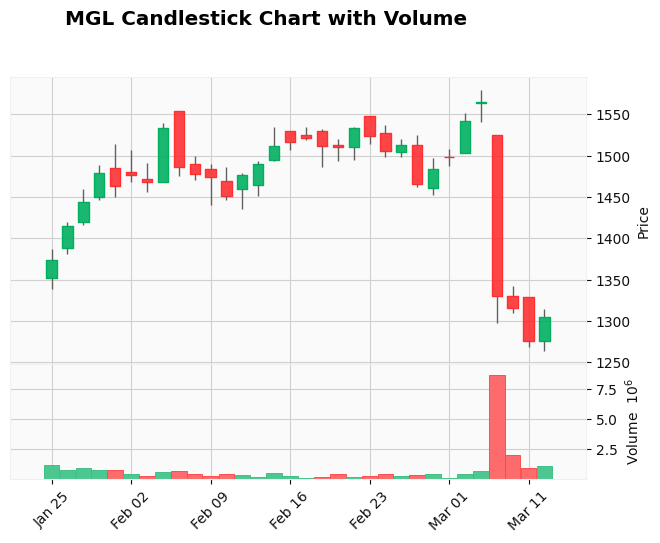

NETWEB
2024-01-25 00:00:00


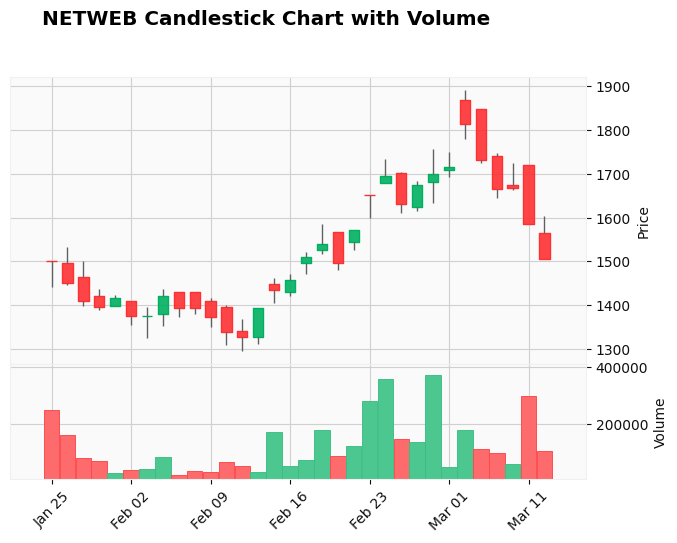

PNB
2024-01-25 00:00:00


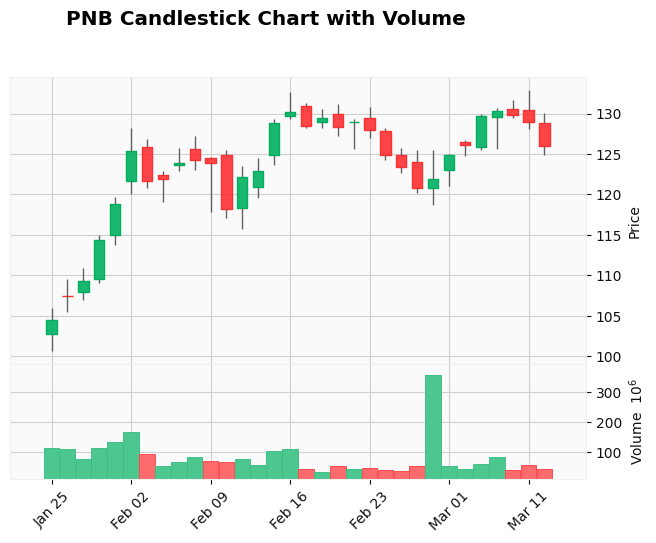

RAILTEL
2024-01-25 00:00:00


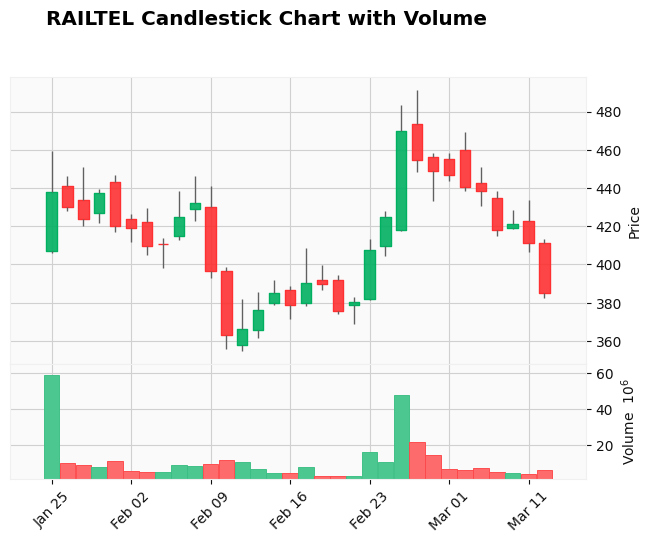

RALLIS
2024-01-25 00:00:00


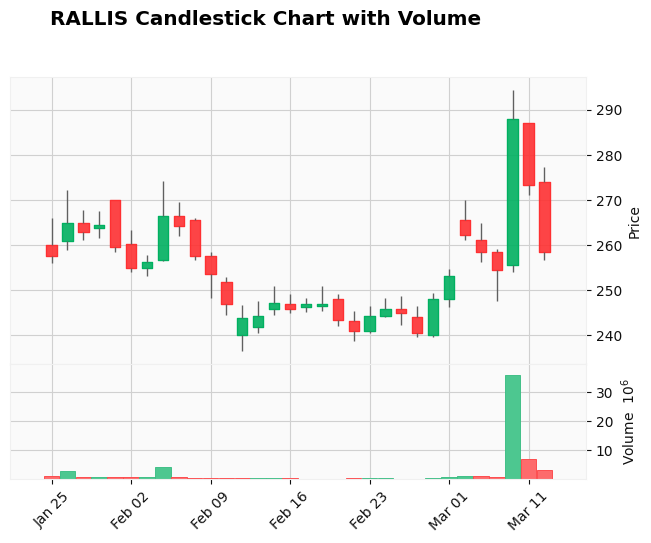

TVSMOTOR
2024-01-25 00:00:00


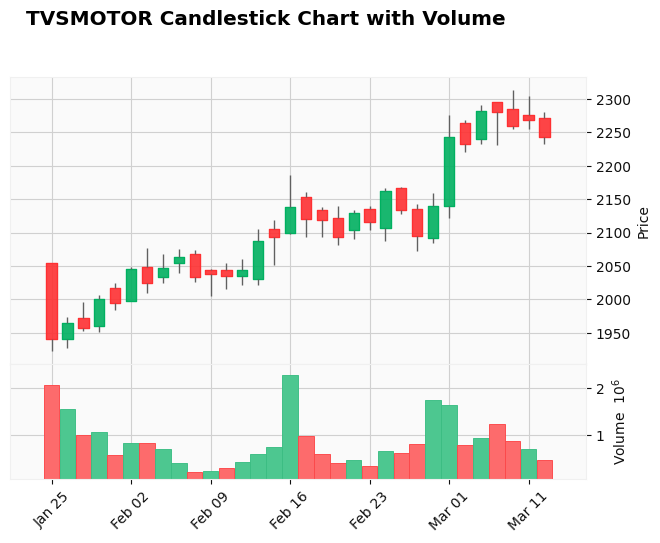

CHOICEIN
2024-01-24 00:00:00


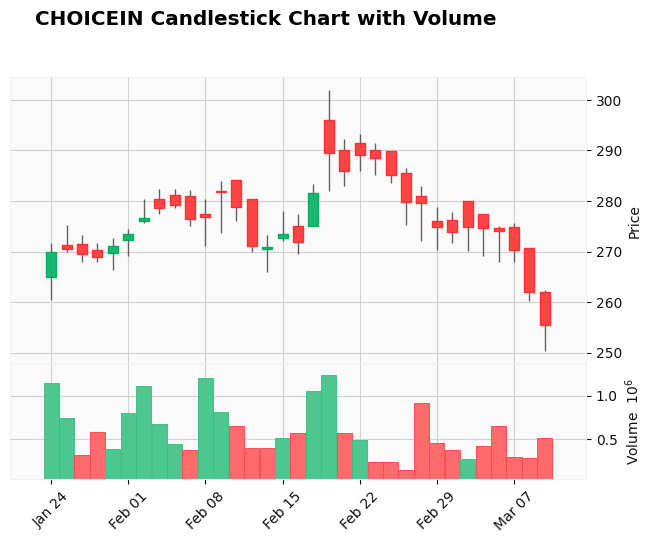

HDFCBANK
2024-01-24 00:00:00


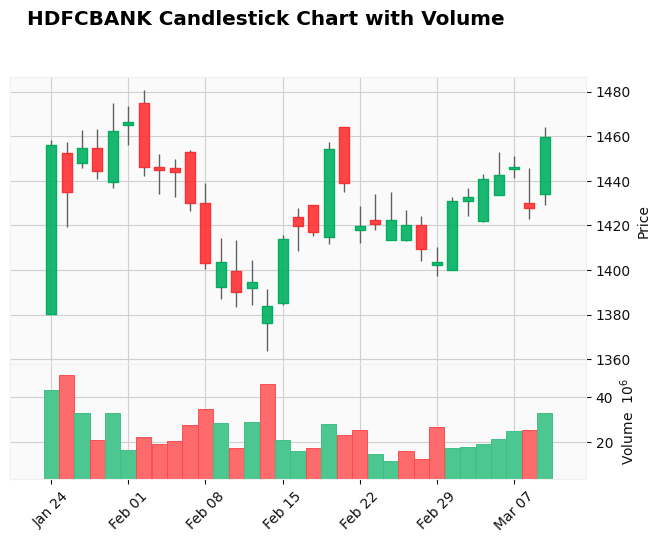

JKLAKSHMI
2024-01-24 00:00:00


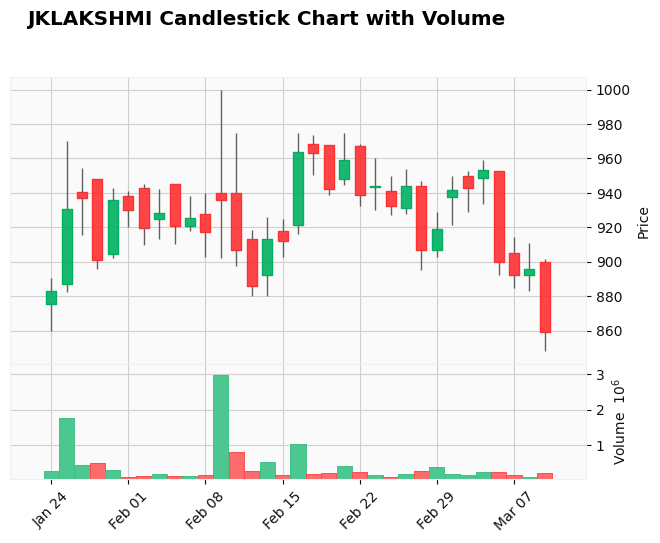

KARURVYSYA
2024-01-24 00:00:00


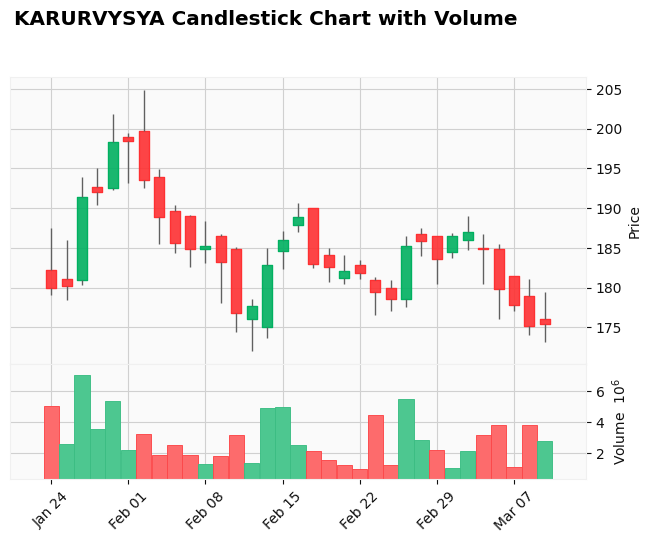

SCHAEFFLER
2024-01-24 00:00:00


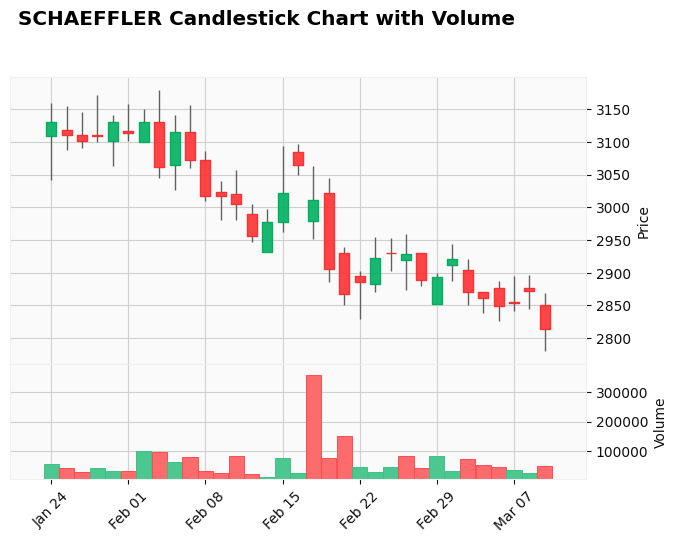

ZEEL
2024-01-24 00:00:00


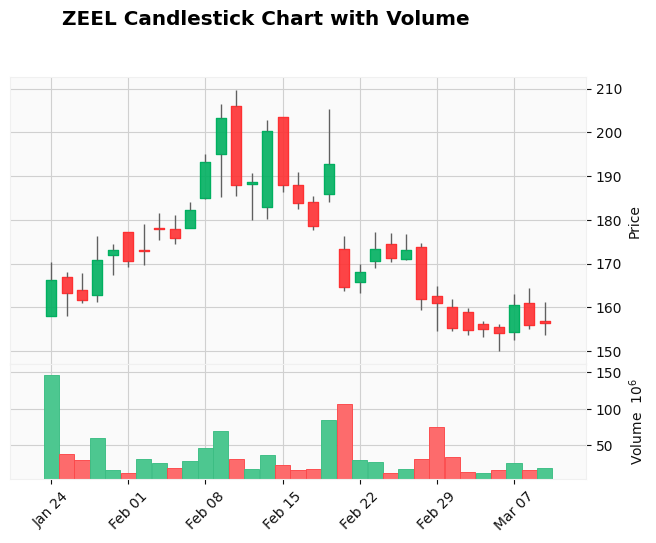

ZENSARTECH
2024-01-24 00:00:00


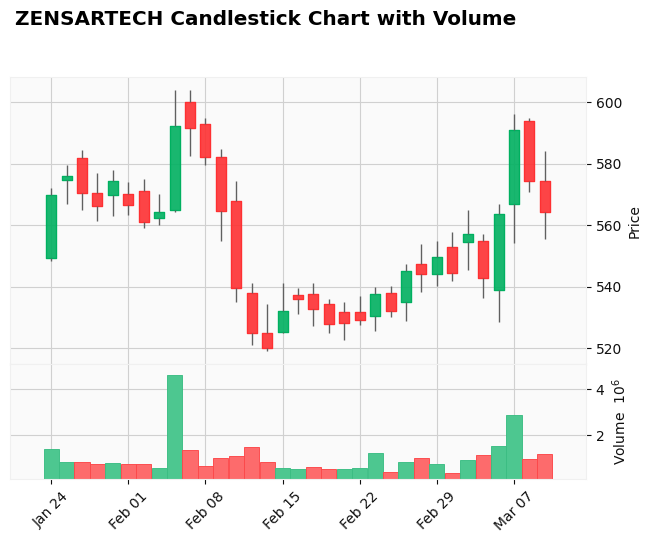

ALLSEC
2024-01-23 00:00:00


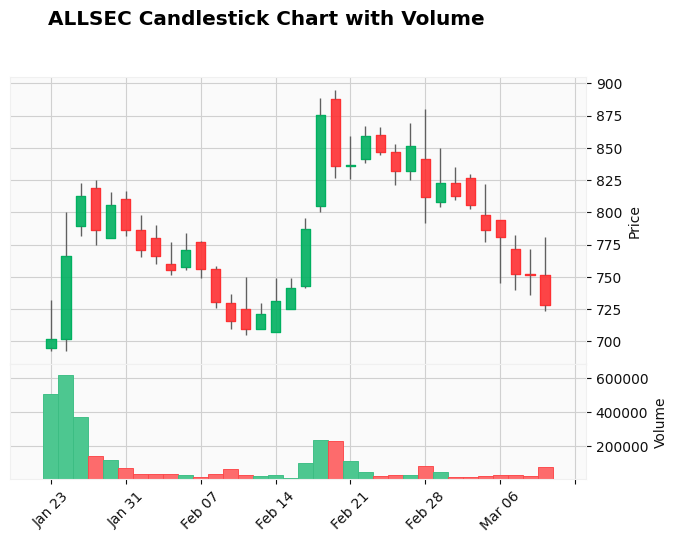

AXISBANK
2024-01-23 00:00:00


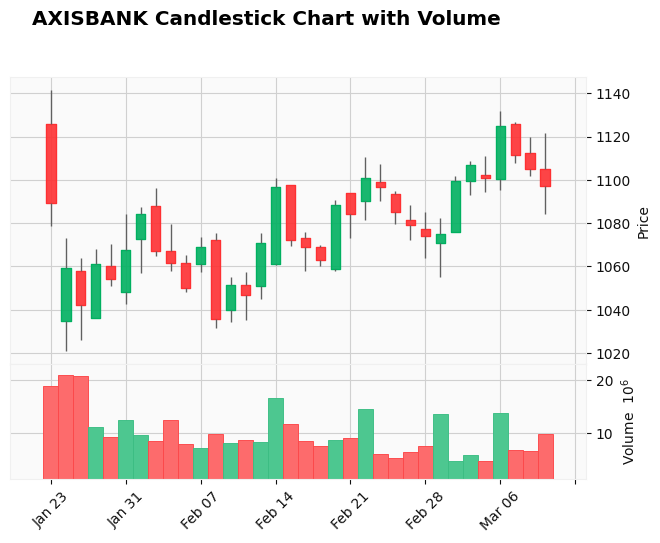

SBIN
2024-01-23 00:00:00


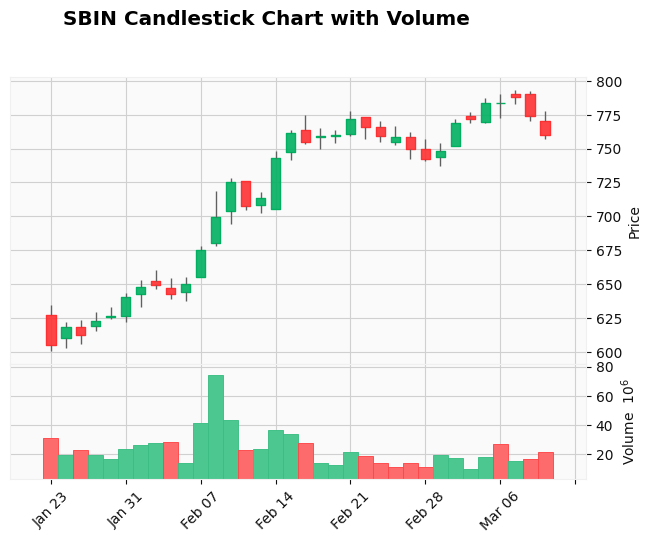

CANFINHOME
2024-01-23 00:00:00


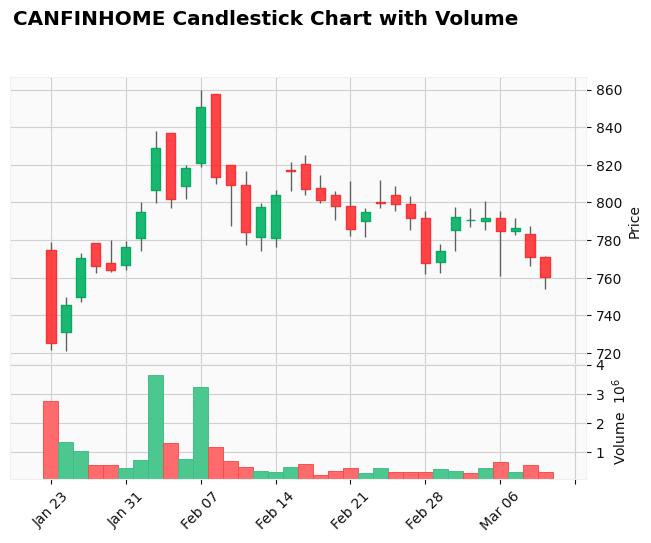

GREAVESCOT
2024-01-23 00:00:00


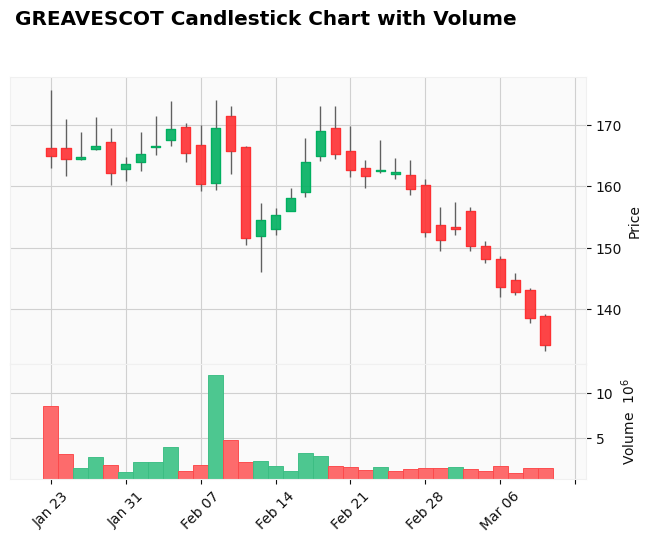

ICICIBANK
2024-01-23 00:00:00


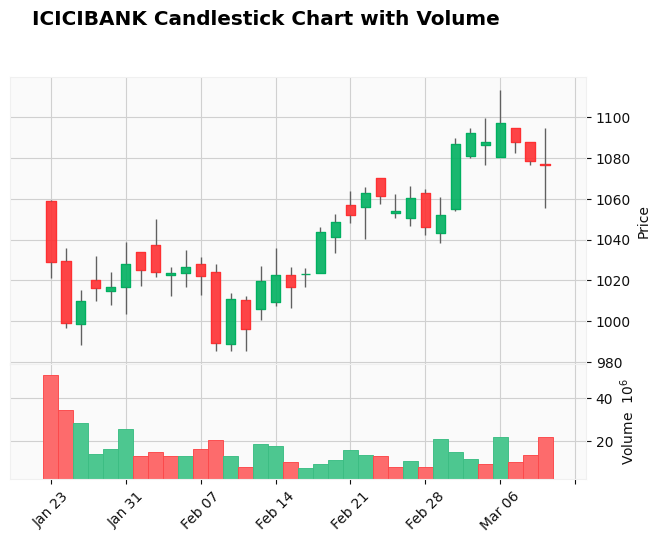

ICICIBANK
2024-01-23 00:00:00


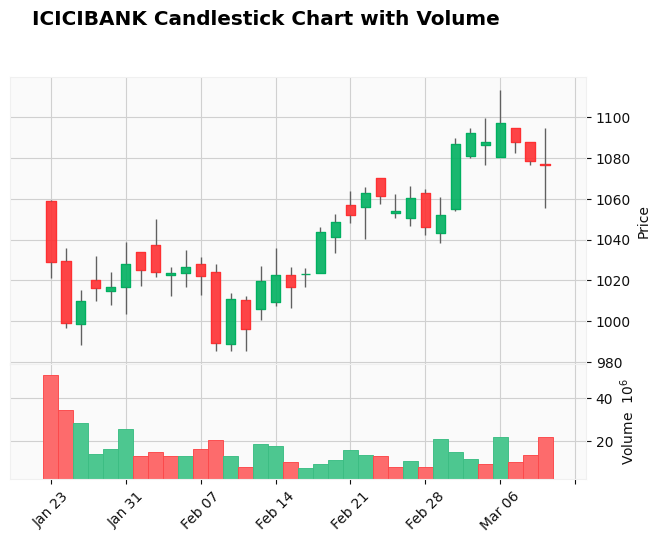

KOTAKBANK
2024-01-23 00:00:00


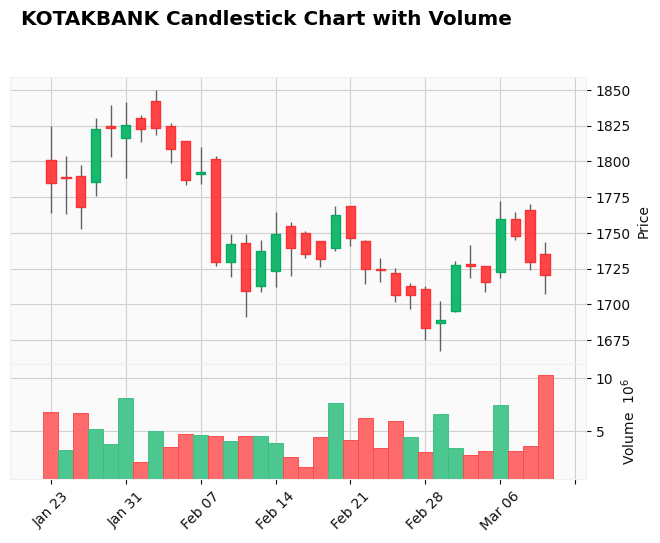

PERSISTENT
2024-01-23 00:00:00


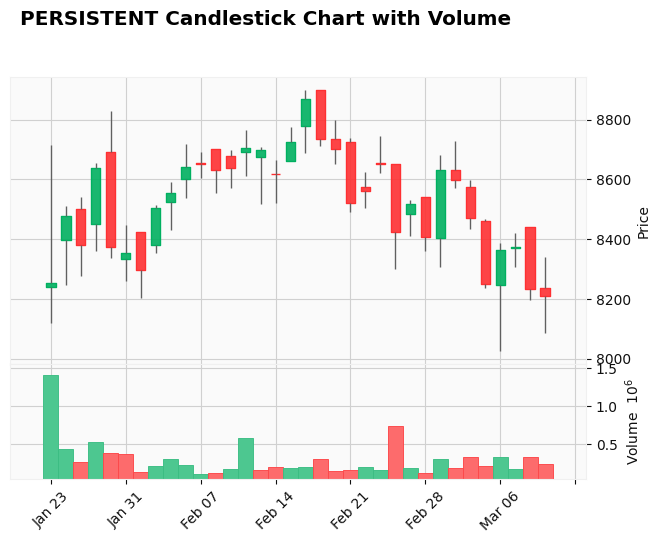

SPANDANA
2024-01-23 00:00:00


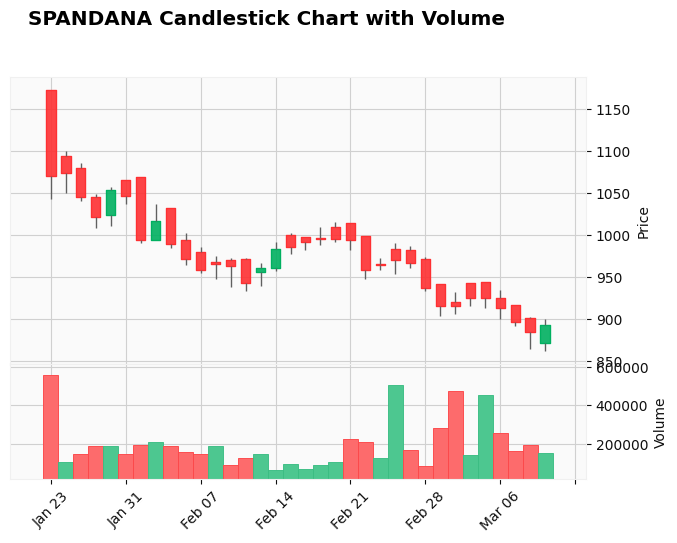

SPANDANA
2024-01-23 00:00:00


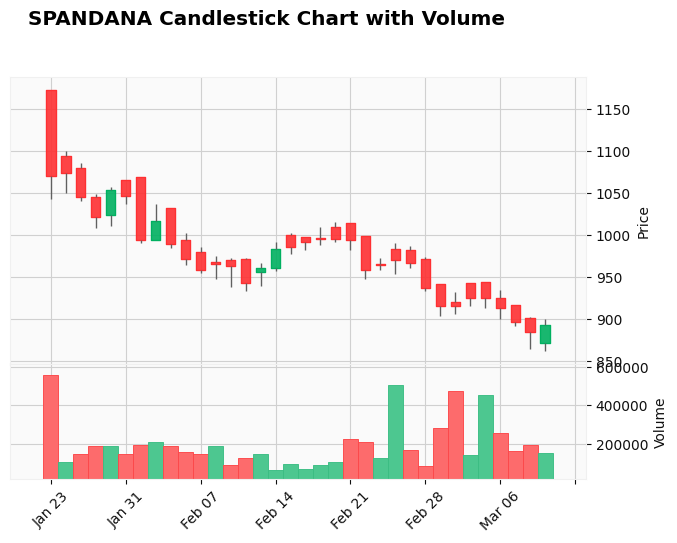

ICICIBANK
2024-01-21 00:00:00


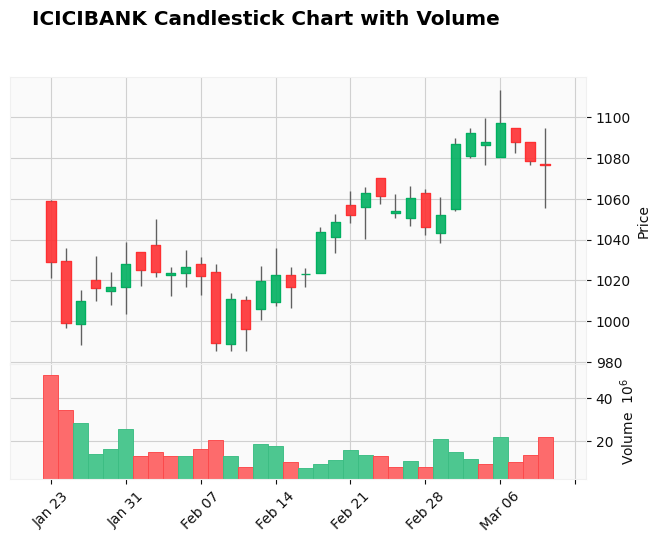

IDBI
2024-01-21 00:00:00


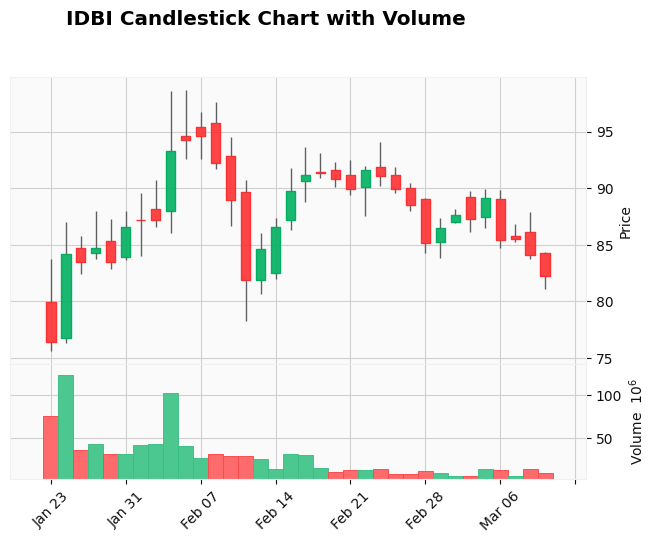

KOTAKBANK
2024-01-21 00:00:00


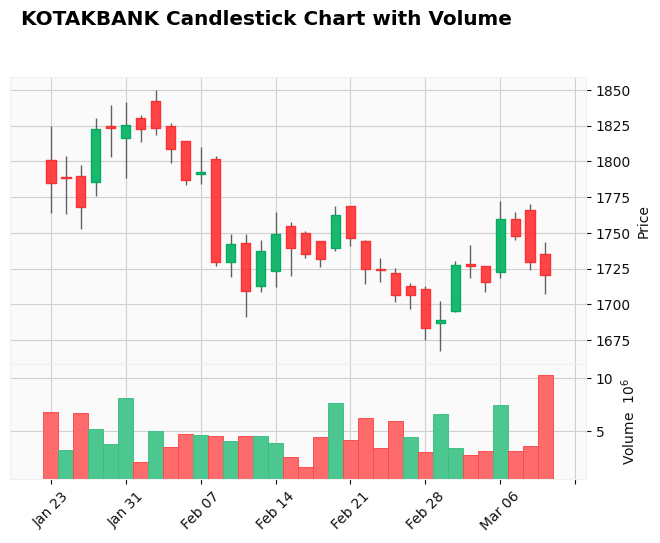

KOTAKBANK
2024-01-21 00:00:00


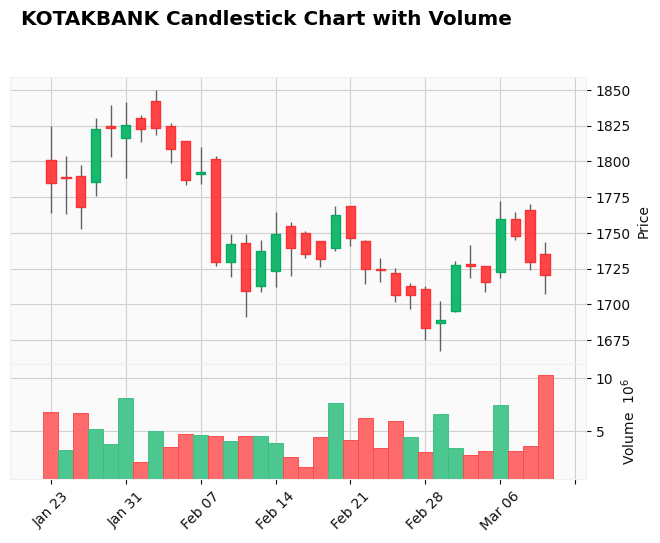

RBLBANK
2024-01-21 00:00:00


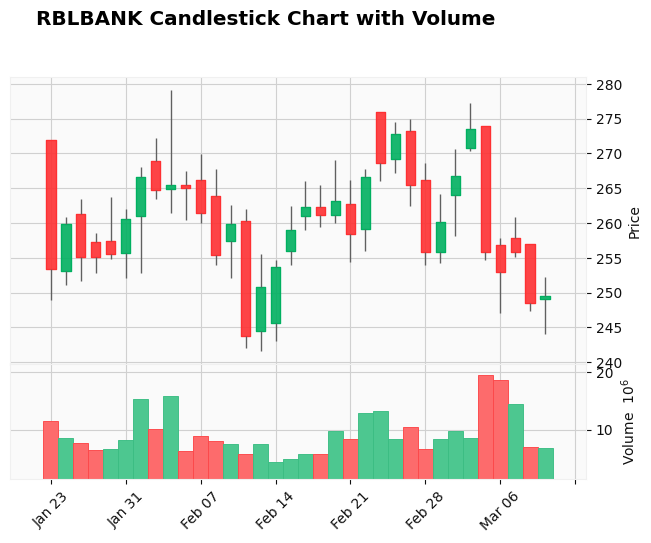

RELIANCE
2024-01-21 00:00:00


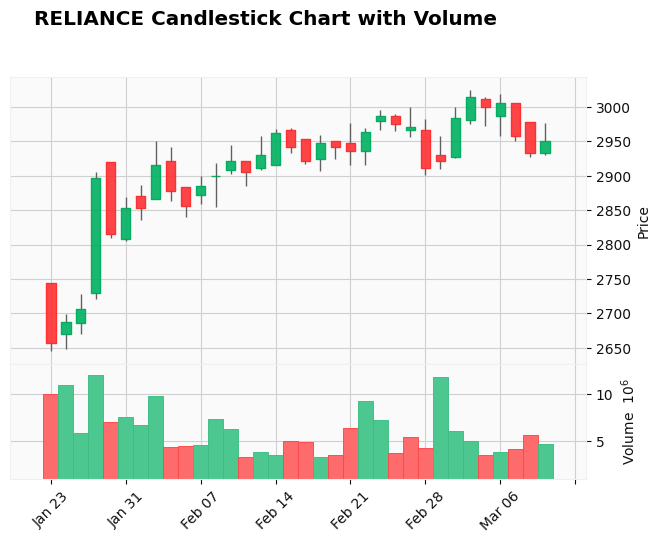

ZYDUSLIFE
2024-01-21 00:00:00


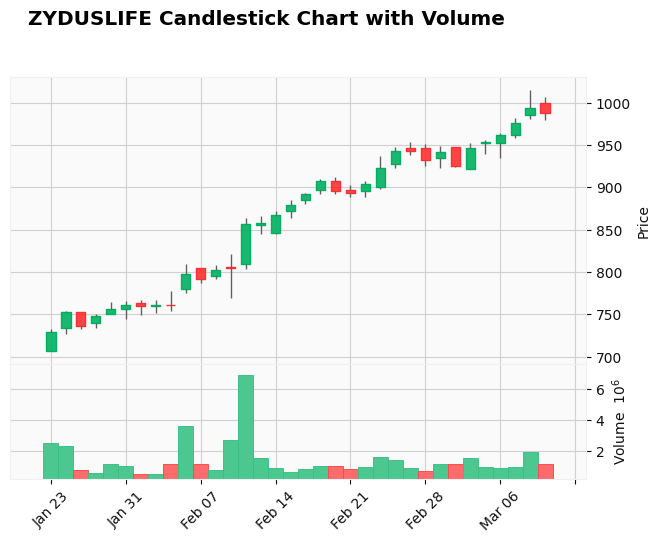

SBIN
2024-01-19 00:00:00


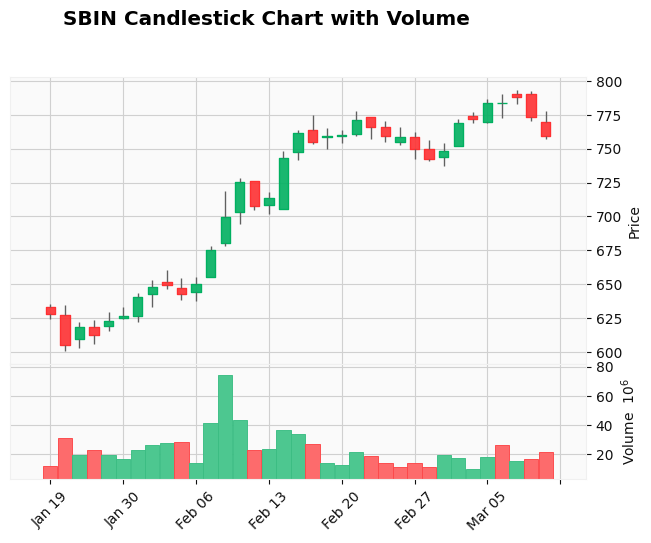

MAPMYINDIA
2024-01-19 00:00:00


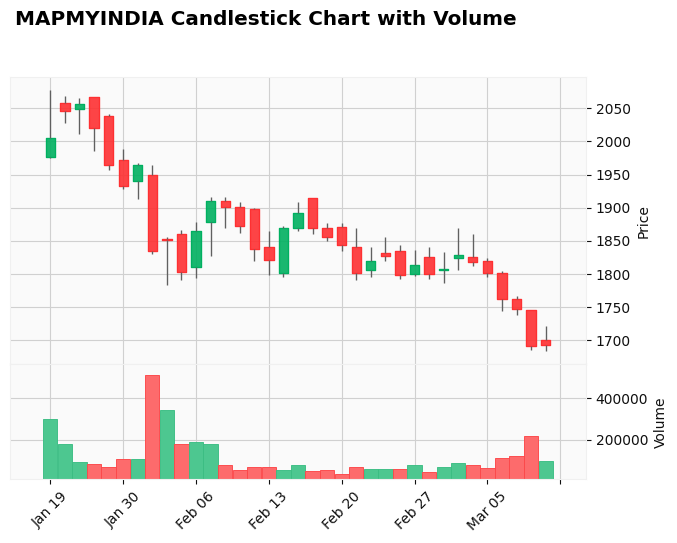

COALINDIA
2024-01-19 00:00:00


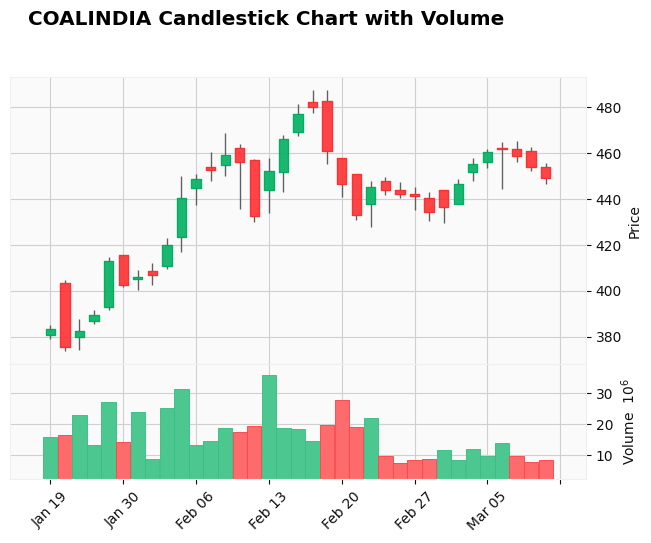

HDFCBANK
2024-01-19 00:00:00


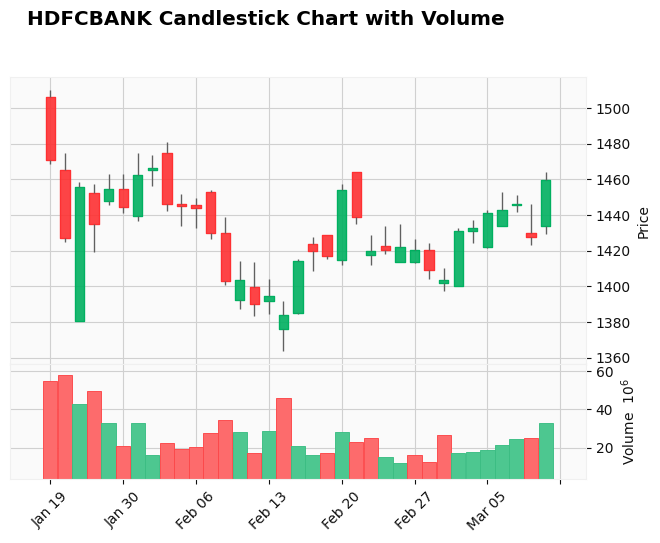

HDFCBANK
2024-01-19 00:00:00


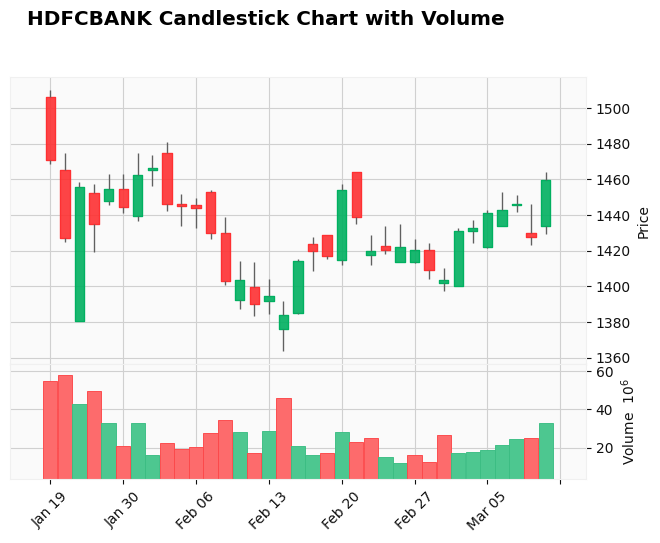

INDUSINDBK
2024-01-19 00:00:00


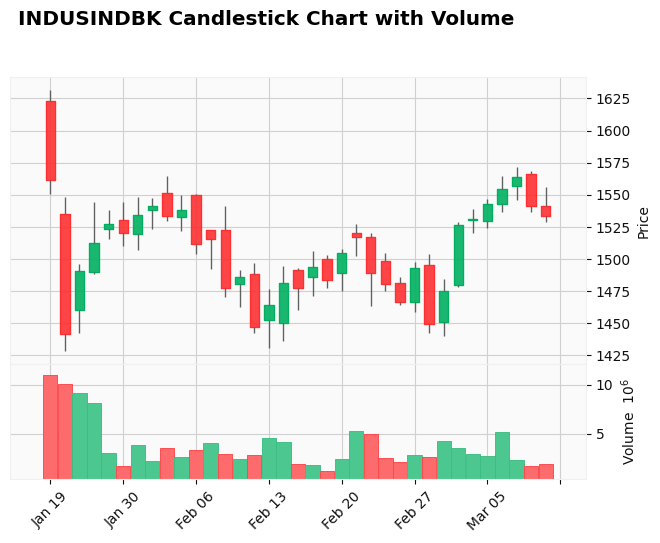

INDUSINDBK
2024-01-19 00:00:00


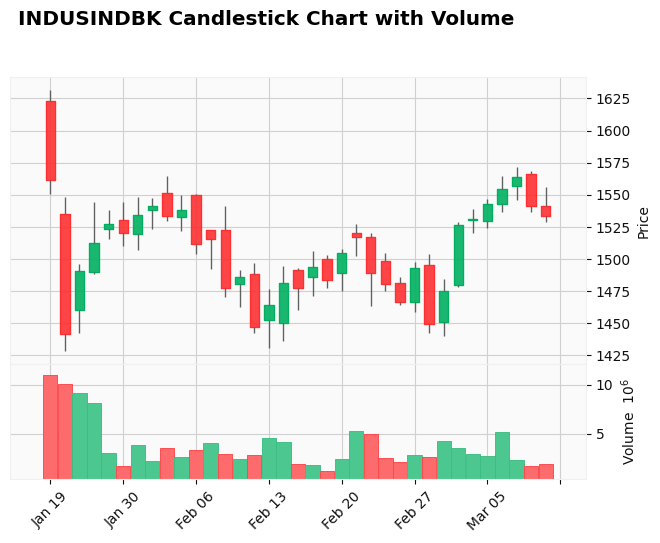

POONAWALLA
2024-01-19 00:00:00


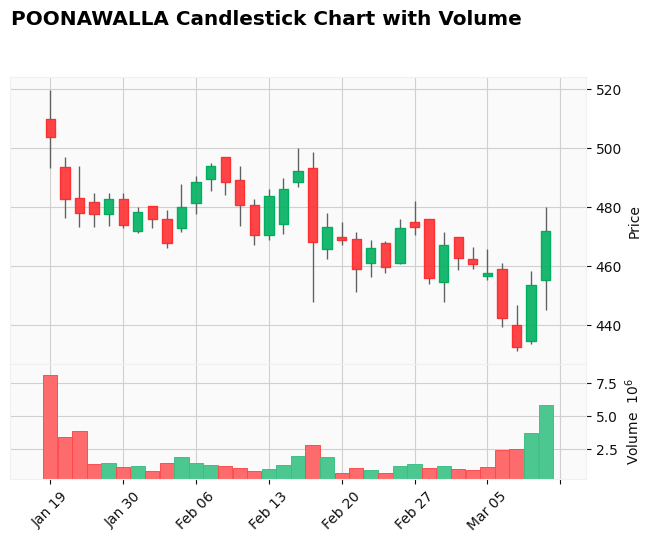

SHREDIGCEM
2024-01-19 00:00:00


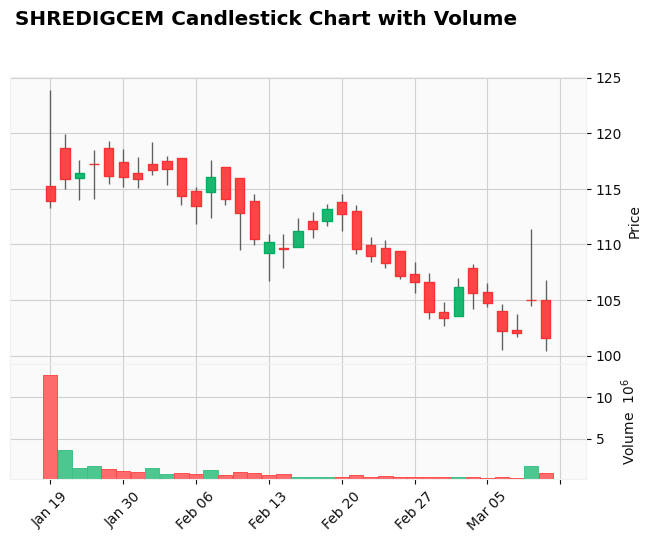

TATACOMM
2024-01-19 00:00:00


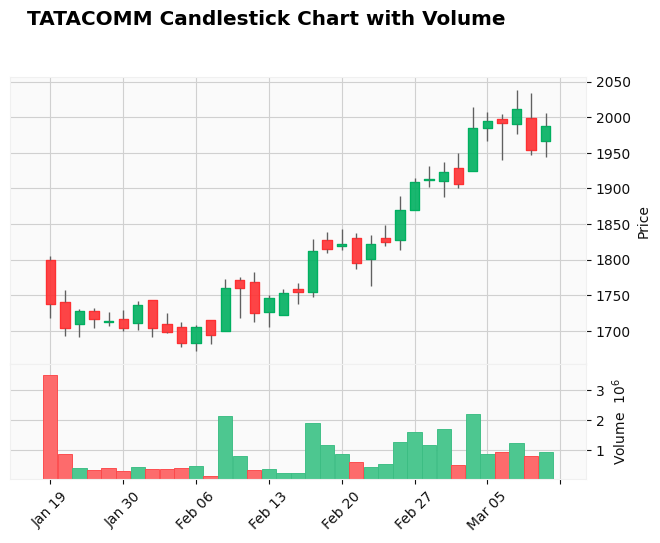

ULTRACEMCO
2024-01-19 00:00:00


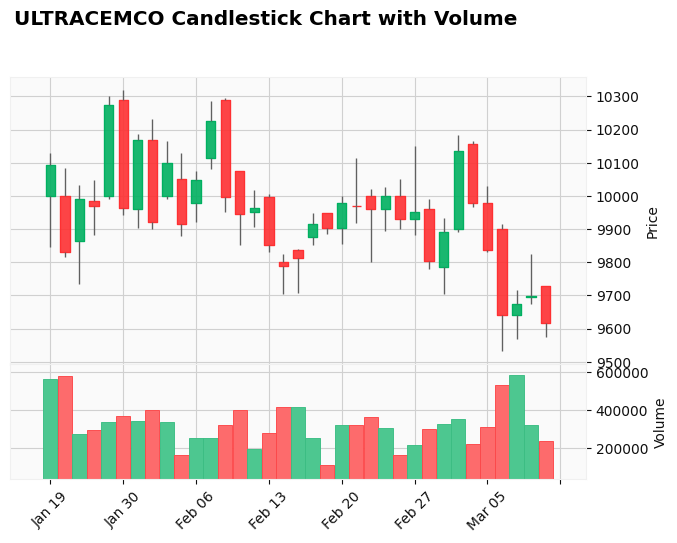

ULTRACEMCO
2024-01-19 00:00:00


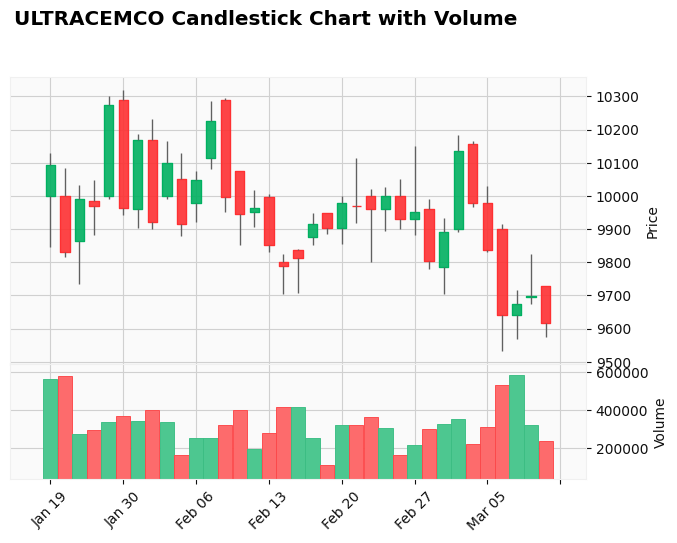

AARTIIND
2024-01-18 00:00:00


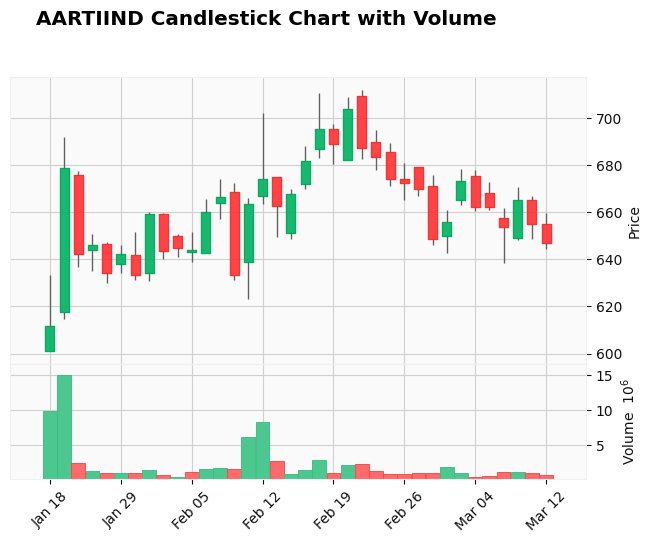

AHL
2024-01-18 00:00:00


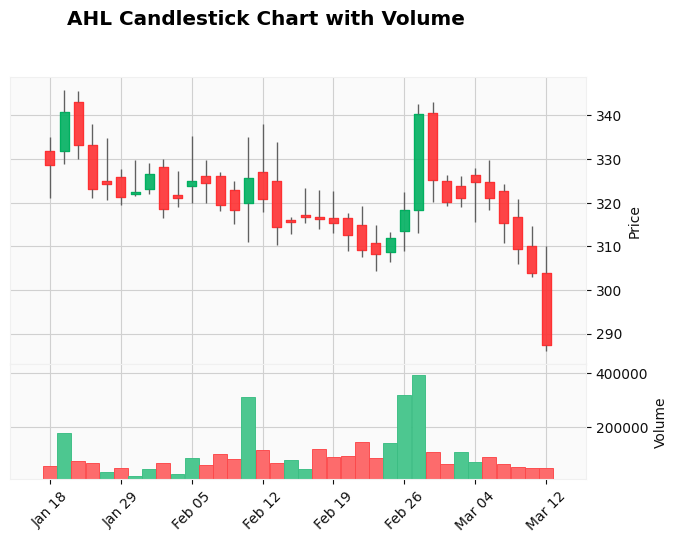

ASHOKLEY
2024-01-18 00:00:00


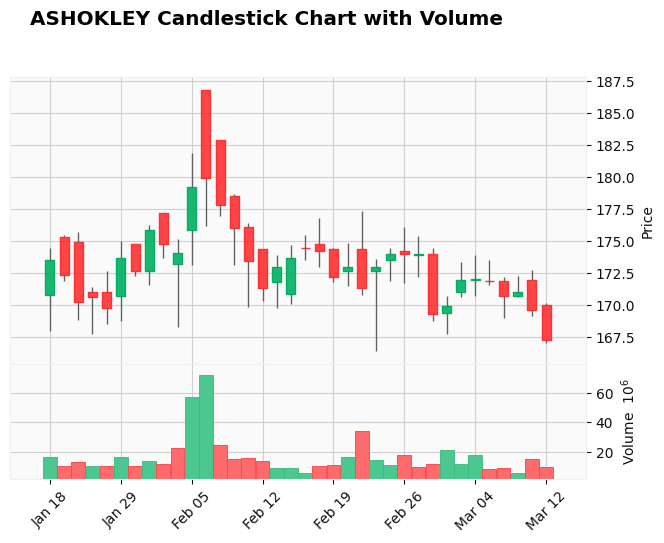

ASIANPAINT
2024-01-18 00:00:00


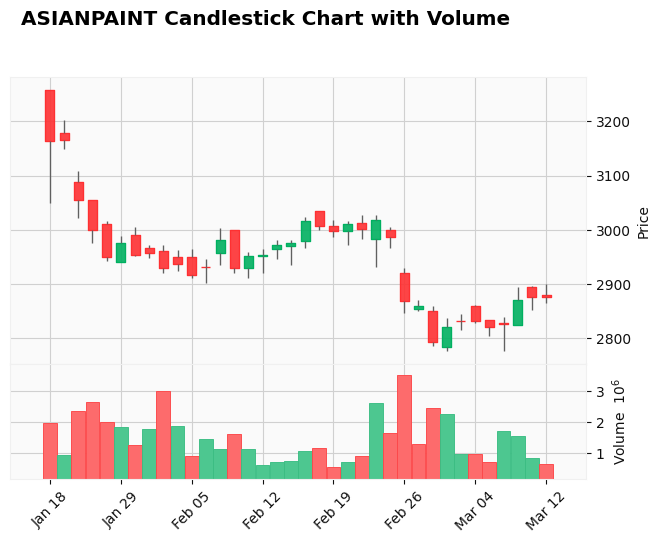

EMKAY
2024-01-18 00:00:00


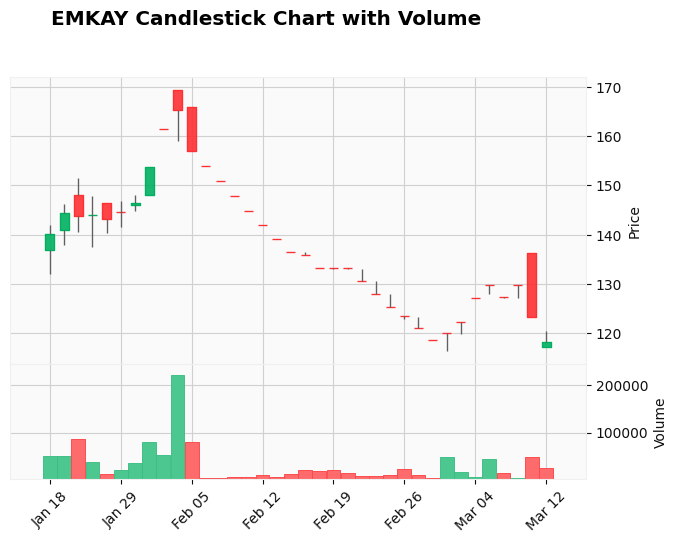

INTELLECT
2024-01-18 00:00:00


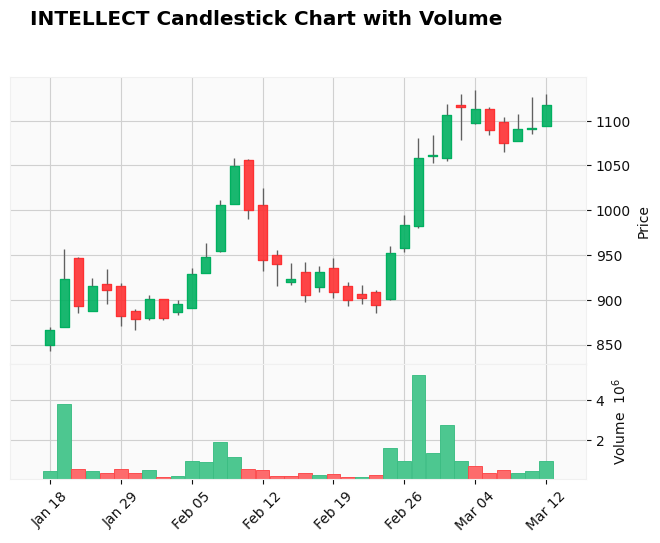

PURVA
2024-01-18 00:00:00


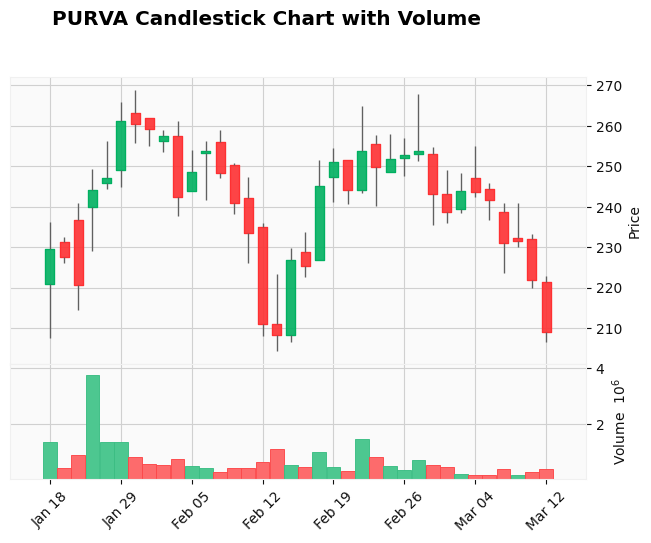

SHREECEM
2024-01-18 00:00:00


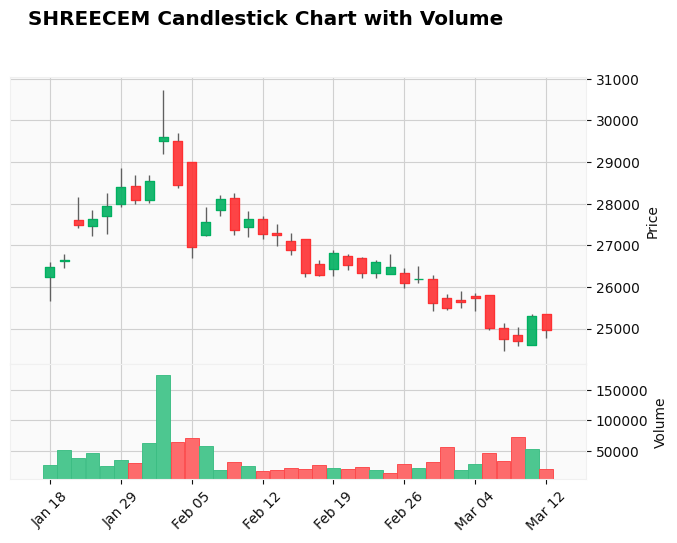

VIKASLIFE
2024-01-18 00:00:00


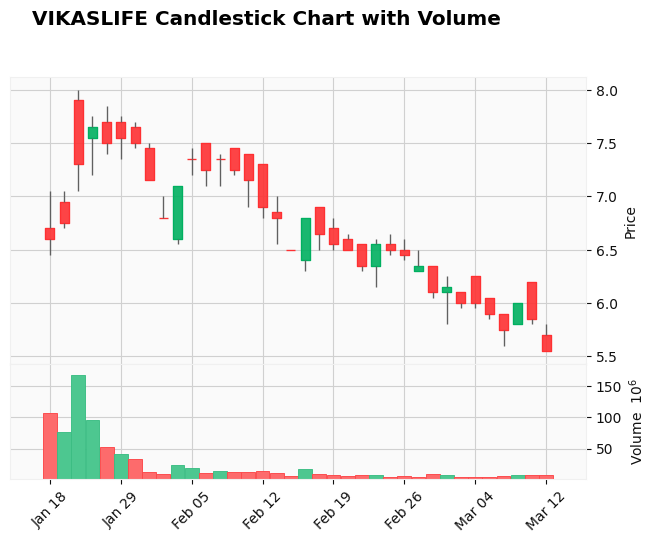

ASIANPAINT
2024-01-17 00:00:00


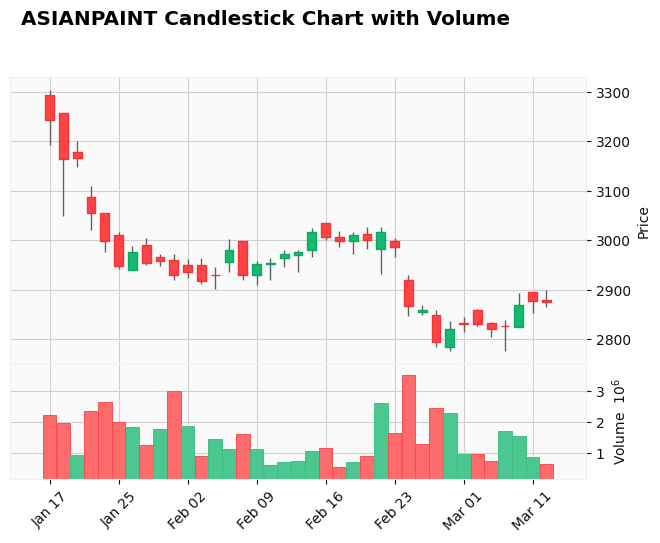

BAJAJ-AUTO
2024-01-17 00:00:00


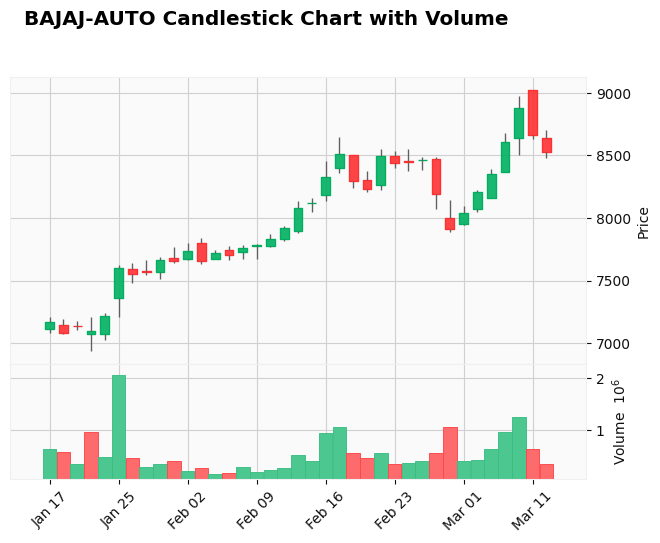

BPCL
2024-01-17 00:00:00


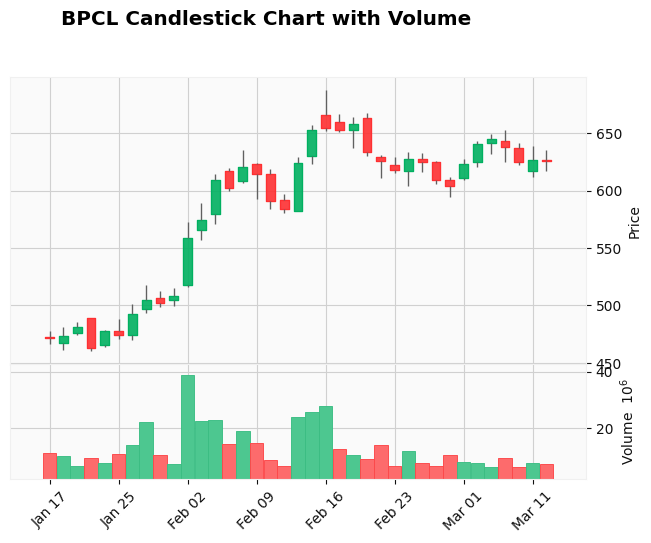

BSOFT
2024-01-17 00:00:00


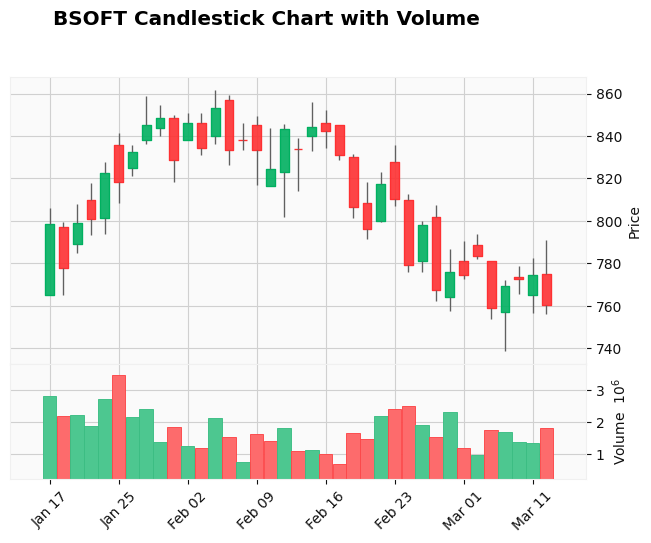

HDFCBANK
2024-01-17 00:00:00


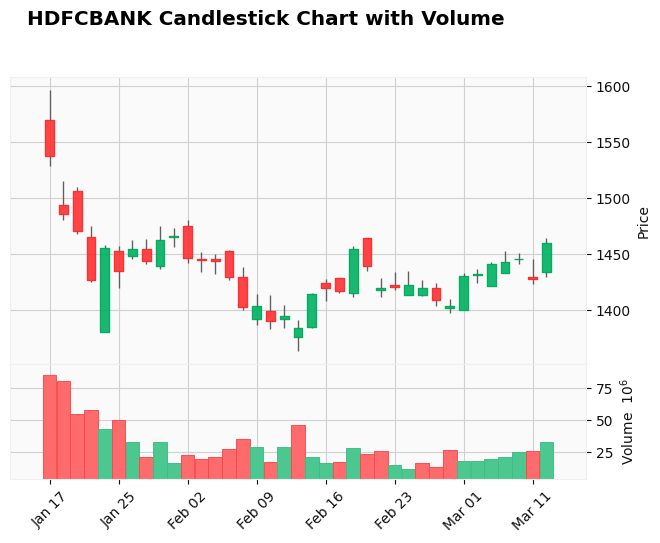

HDFCBANK
2024-01-17 00:00:00


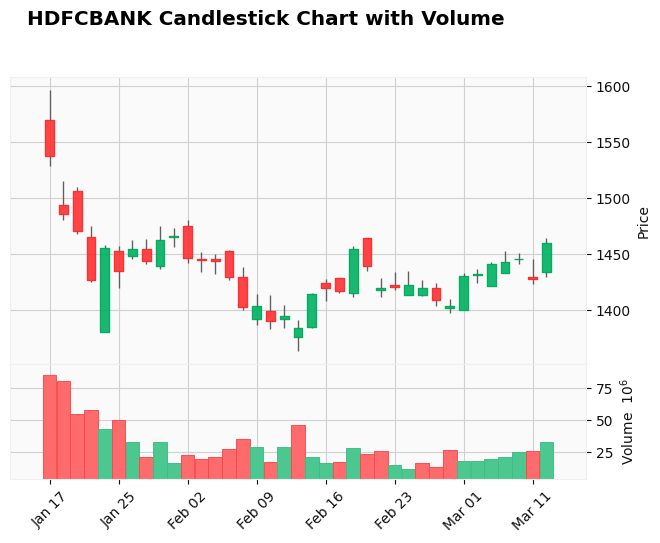

HDFCBANK
2024-01-17 00:00:00


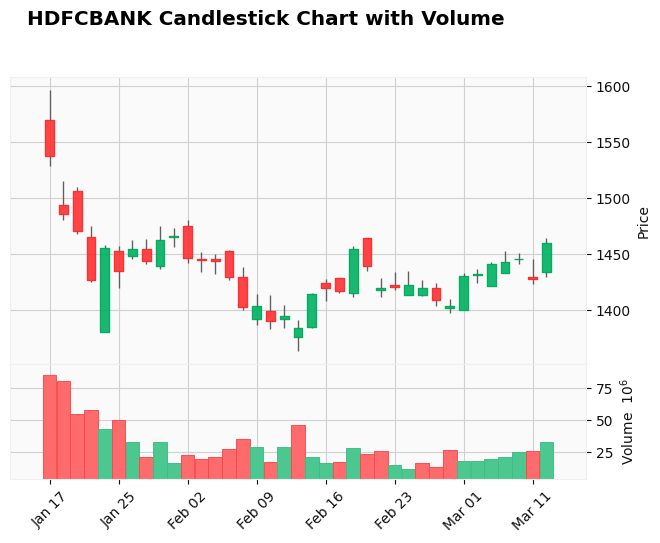

HSCL
2024-01-17 00:00:00


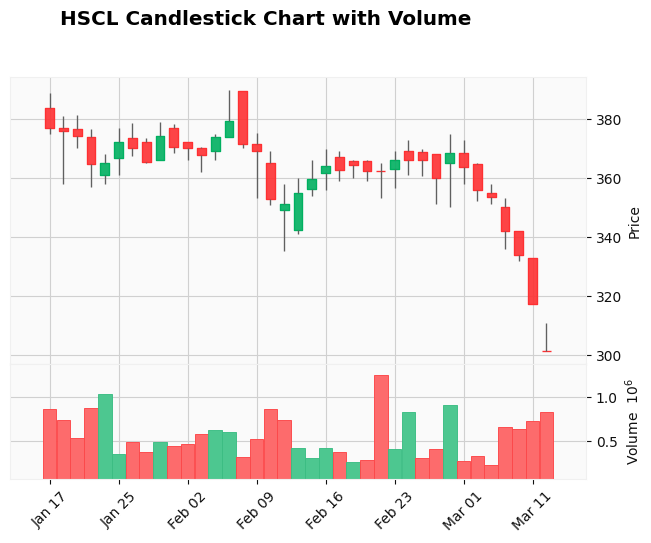

INFIBEAM
2024-01-17 00:00:00


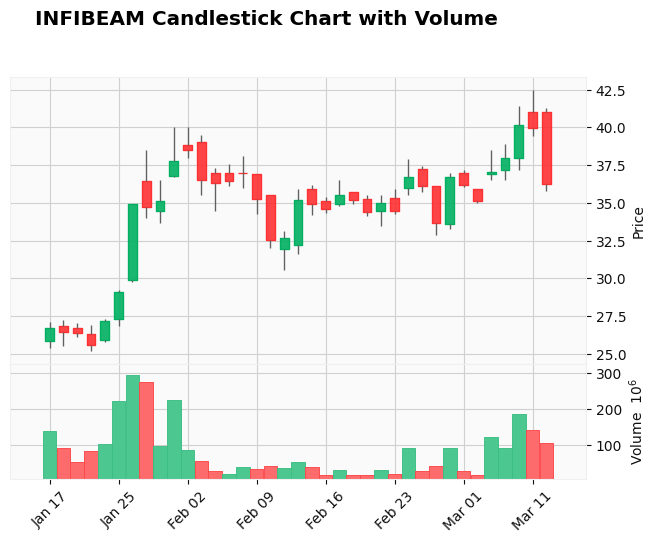

NEWGEN
2024-01-17 00:00:00


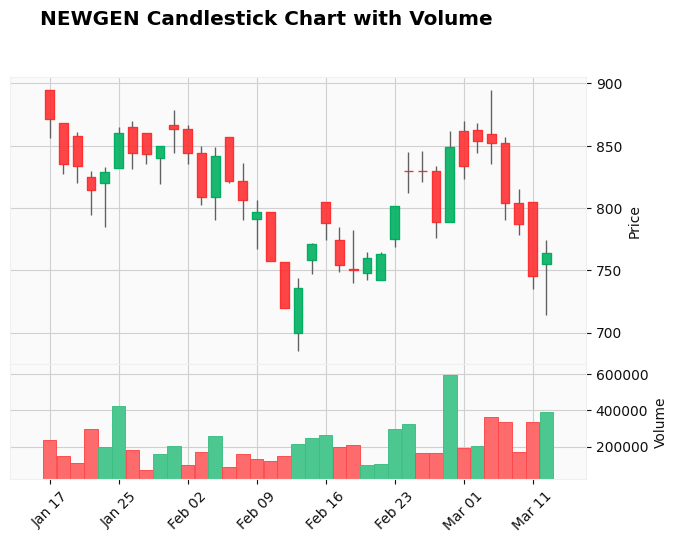

PPLPHARMA
2024-01-17 00:00:00


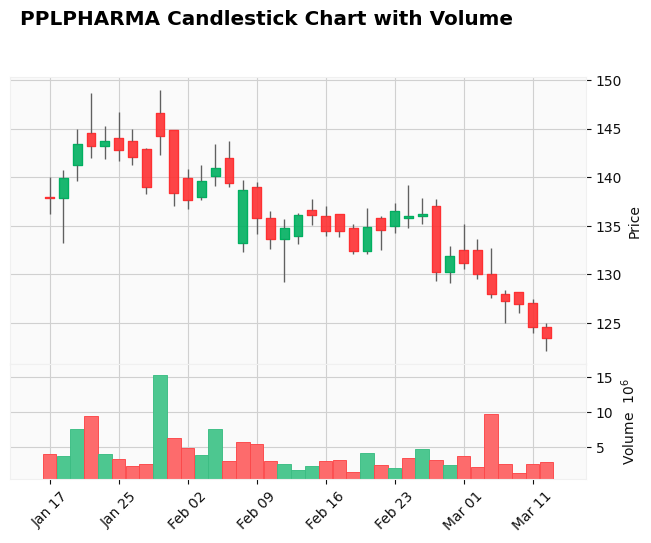

RVNL
2024-01-17 00:00:00


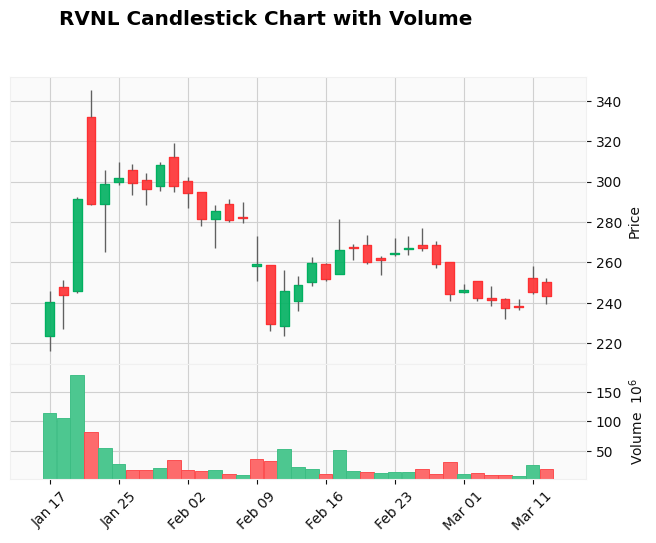

TCS
2024-01-17 00:00:00


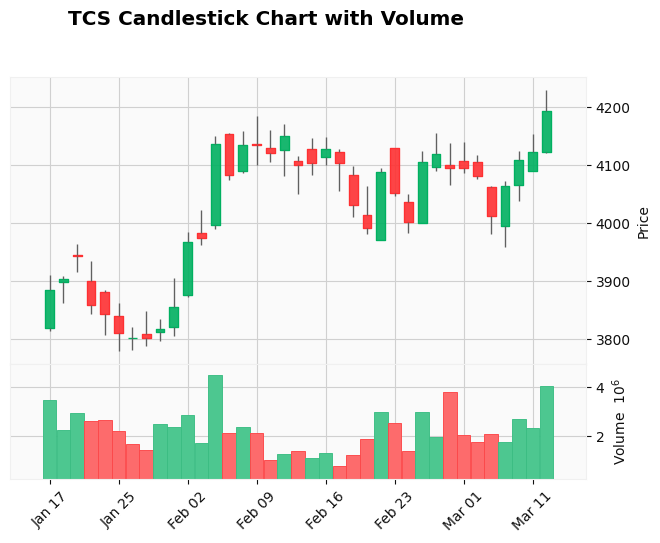

ASHOKLEY
2024-01-16 00:00:00


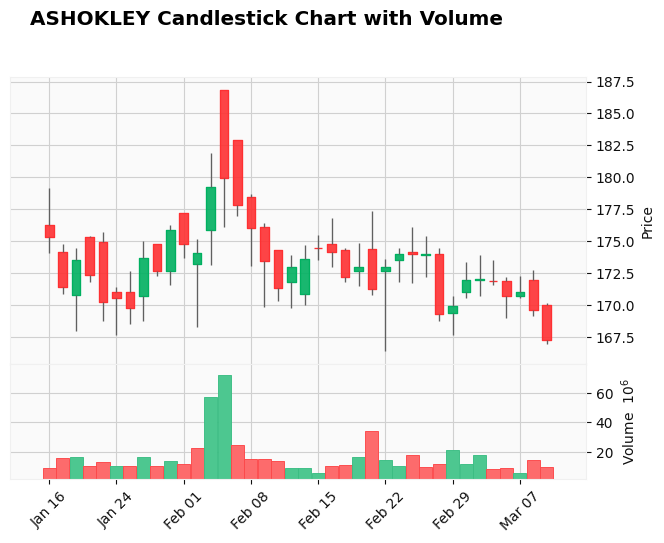

ASIANPAINT
2024-01-16 00:00:00


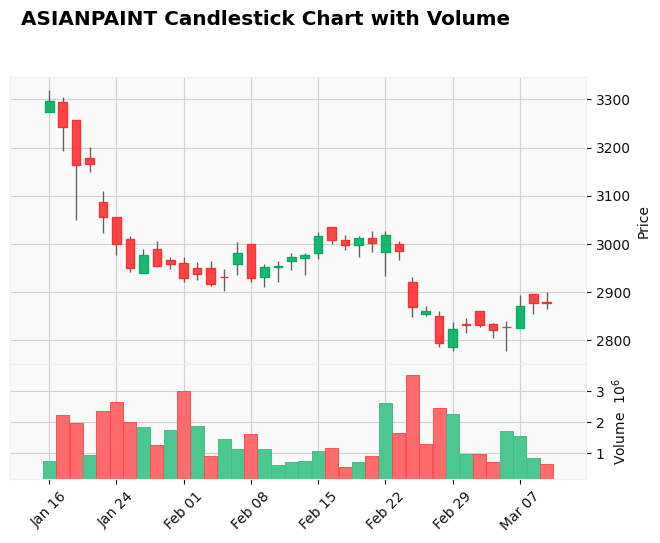

MAHABANK
2024-01-16 00:00:00


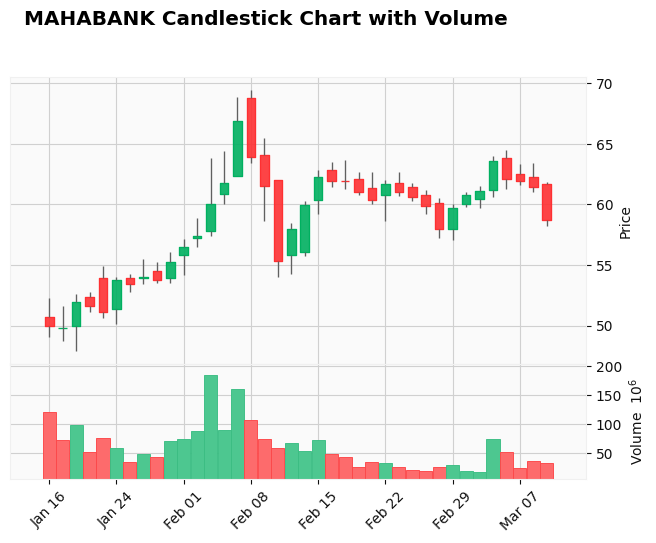

MAHABANK
2024-01-16 00:00:00


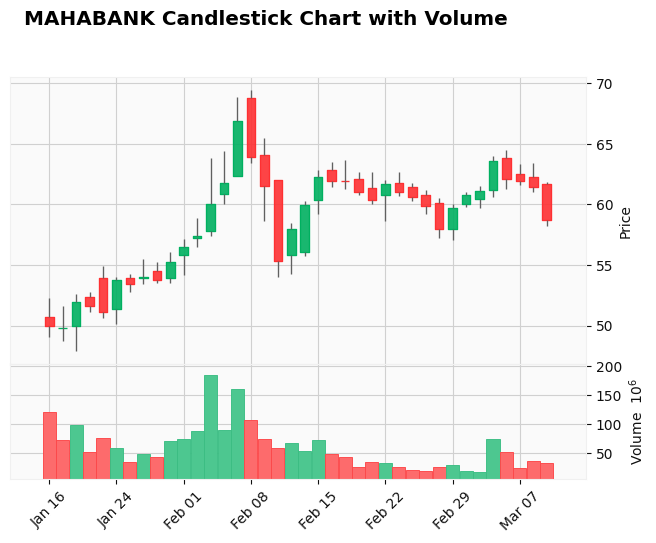

CGCL
2024-01-16 00:00:00


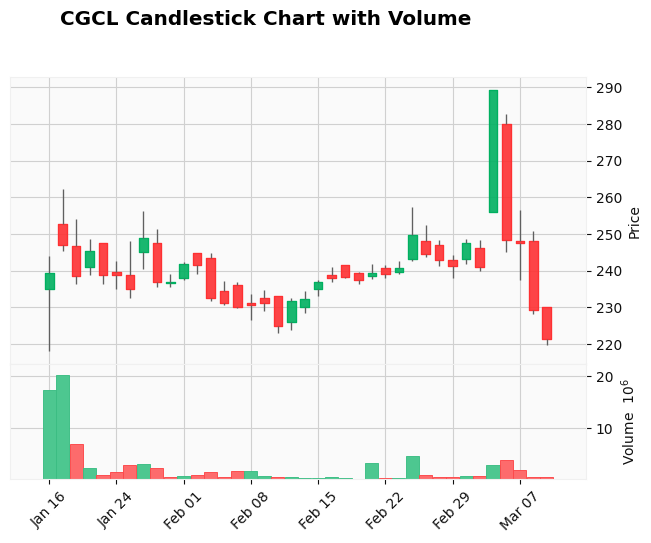

HSCL
2024-01-16 00:00:00


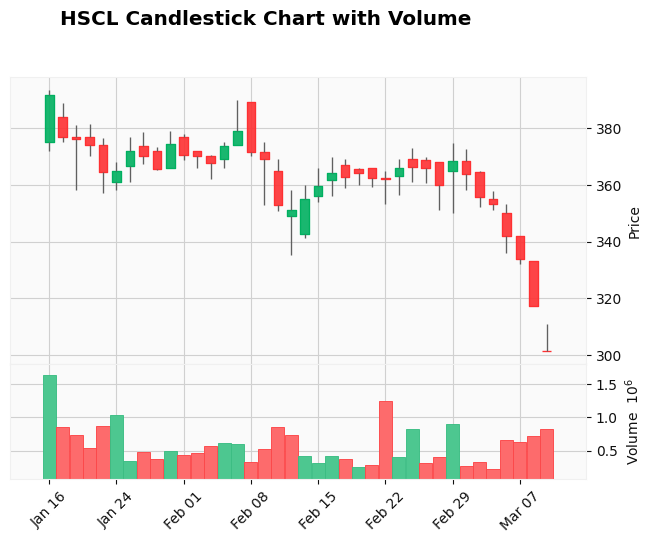

JIOFIN
2024-01-16 00:00:00


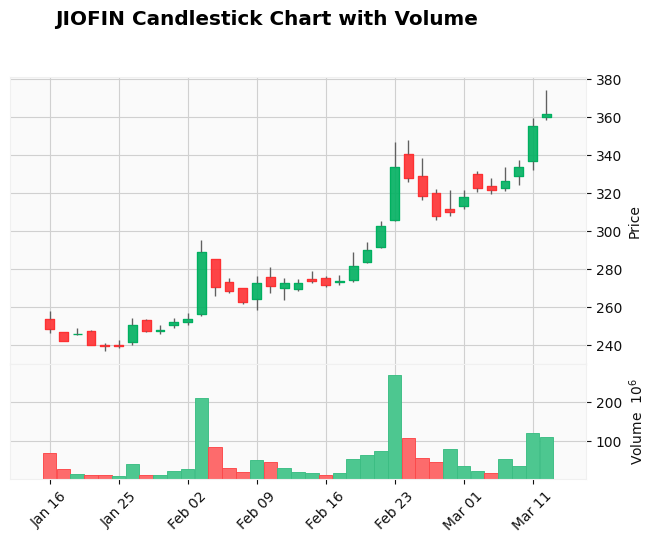

SURAJEST
2024-01-16 00:00:00


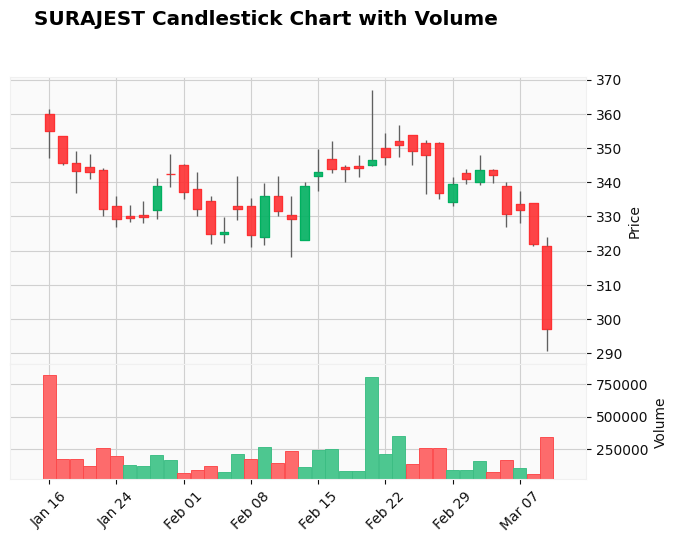

VPRPL
2024-01-16 00:00:00


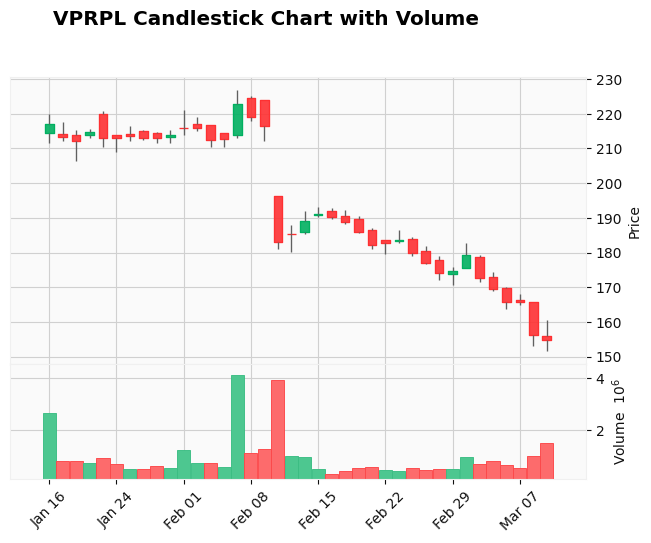

DMART
2024-01-15 00:00:00


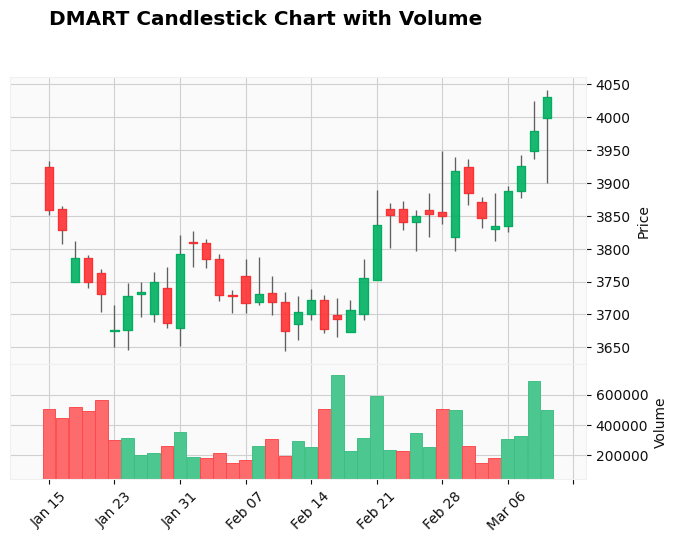

DMART
2024-01-15 00:00:00


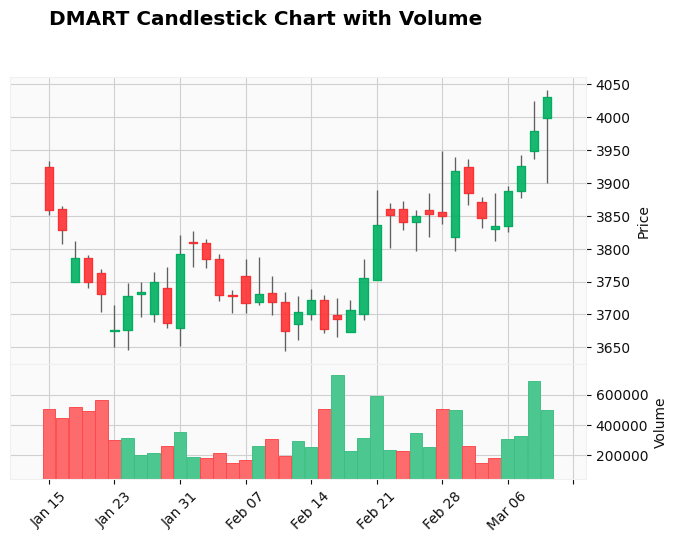

INDUSINDBK
2024-01-15 00:00:00


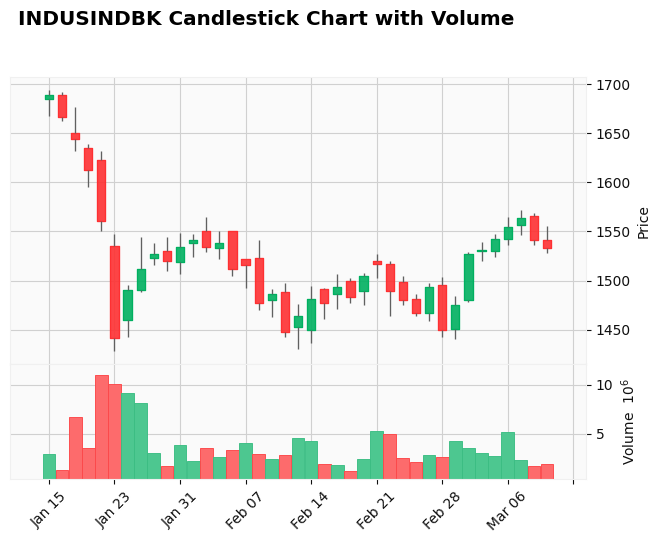

JUSTDIAL
2024-01-15 00:00:00


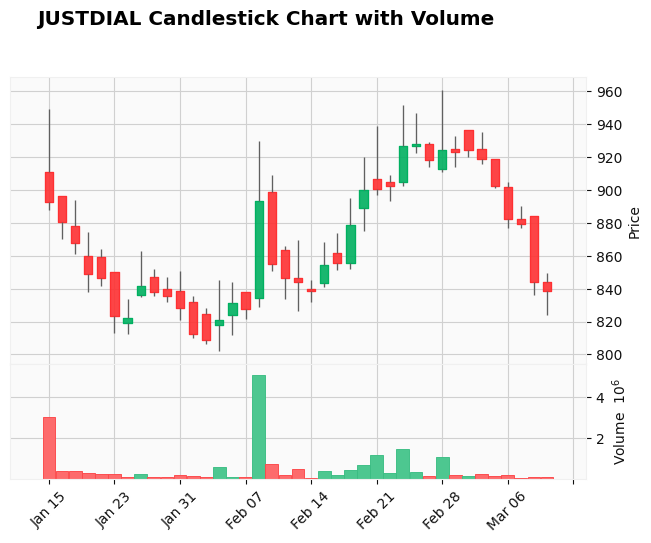

LUPIN
2024-01-15 00:00:00


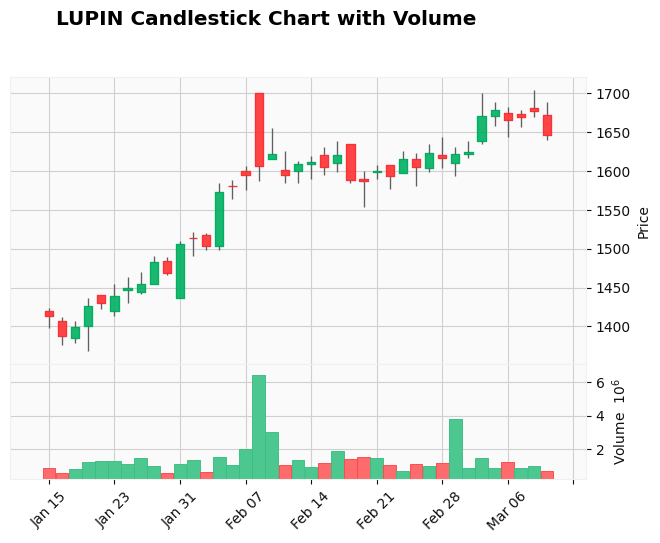

PIDILITIND
2024-01-15 00:00:00


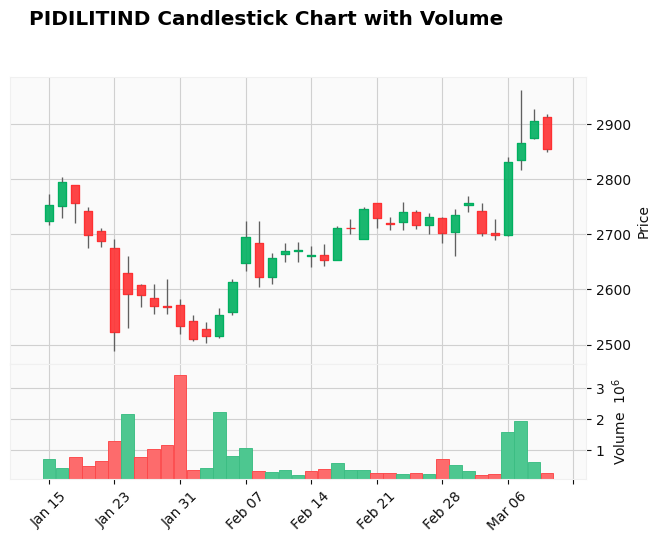

RELIANCE
2024-01-15 00:00:00


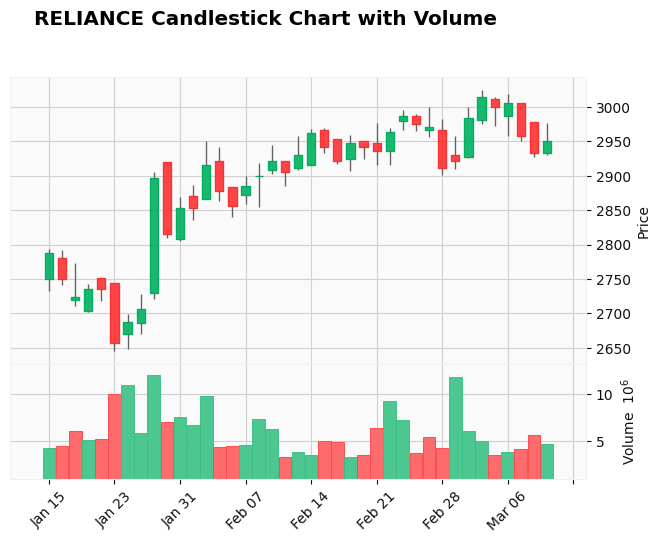

YESBANK
2024-01-15 00:00:00


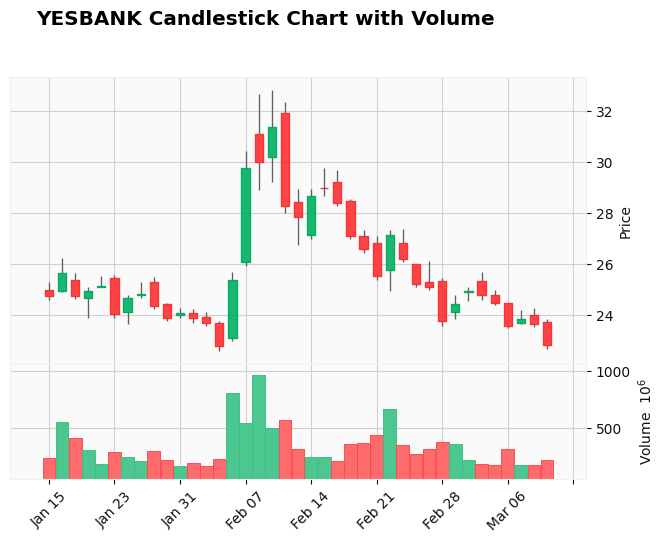

ASIANENE
2024-01-12 00:00:00


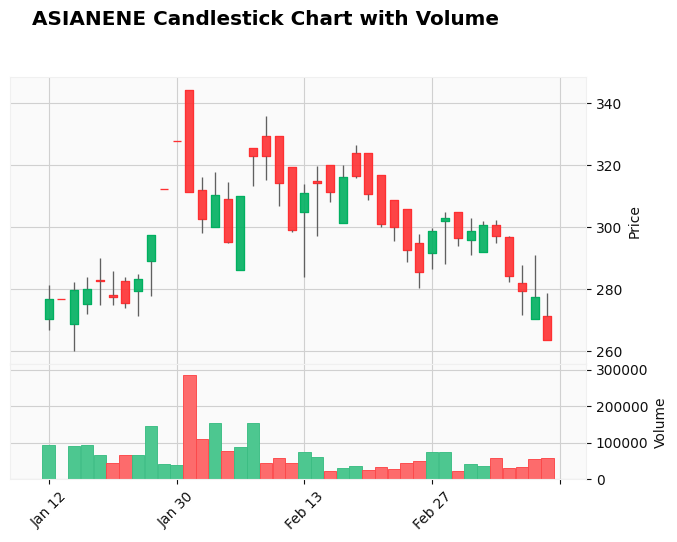

ASIANPAINT
2024-01-12 00:00:00


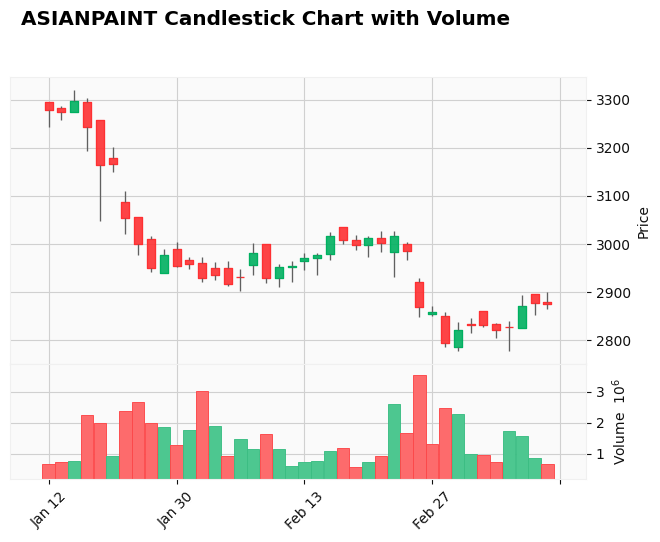

BEPL
2024-01-12 00:00:00


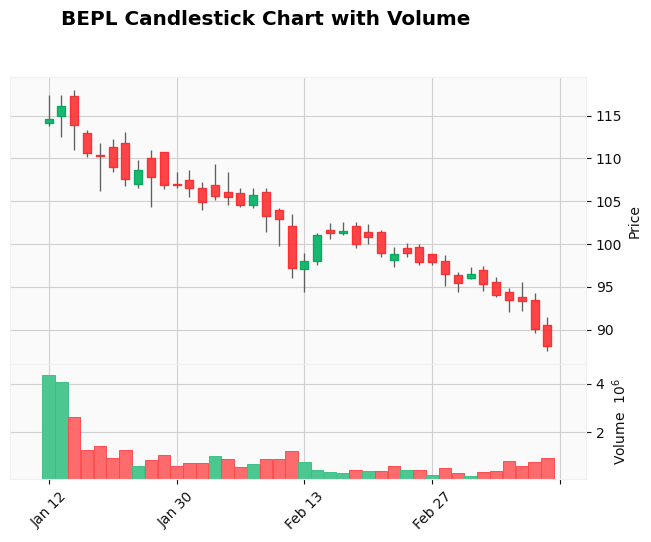

HCLTECH
2024-01-12 00:00:00


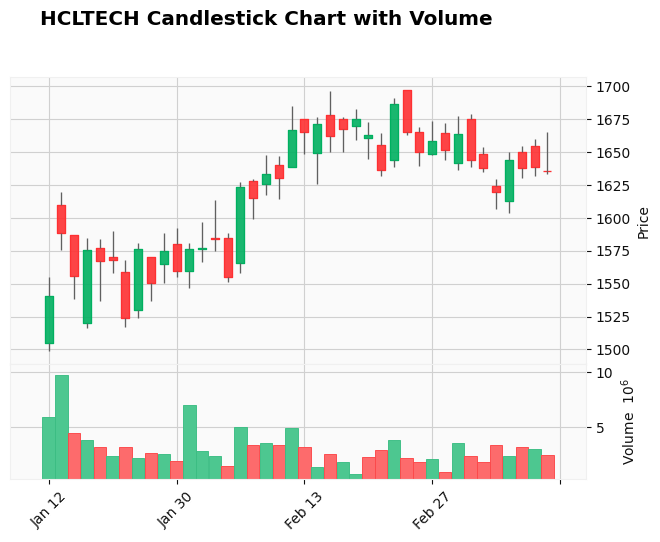

HEROMOTOCO
2024-01-12 00:00:00


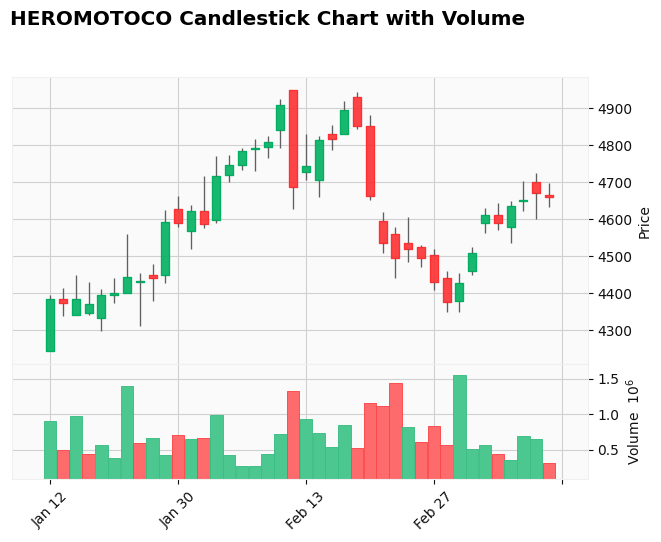

HEROMOTOCO
2024-01-12 00:00:00


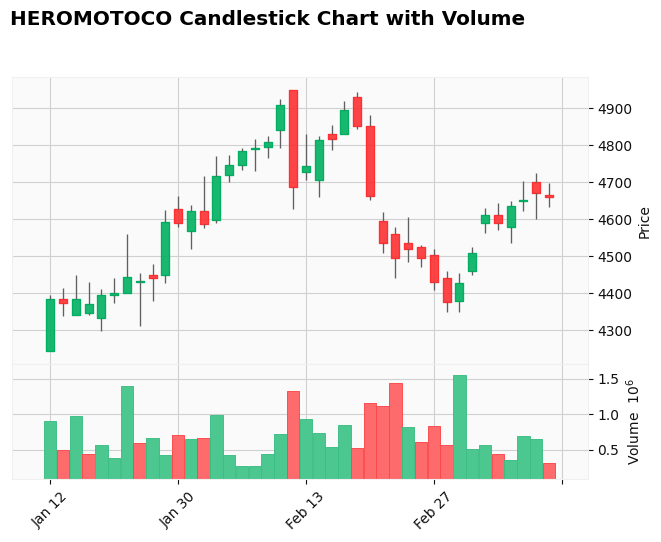

IKIO
2024-01-12 00:00:00


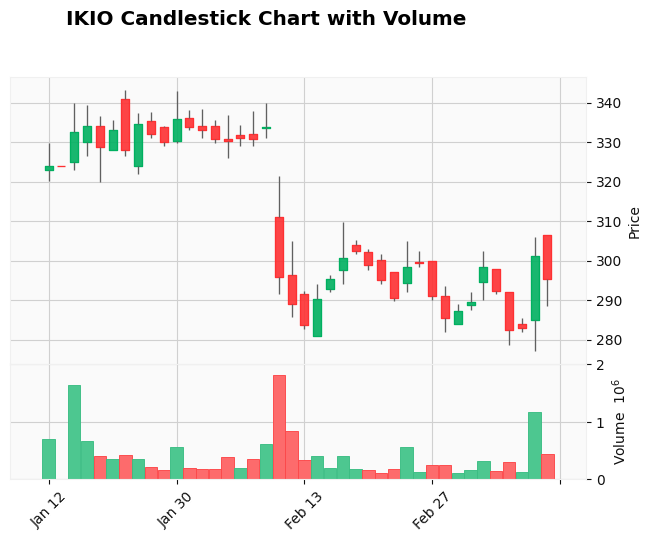

IGL
2024-01-12 00:00:00


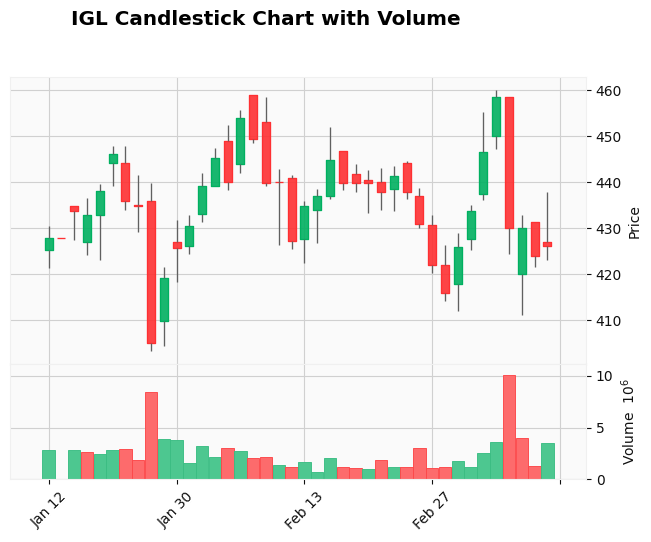

JMFINANCIL
2024-01-12 00:00:00


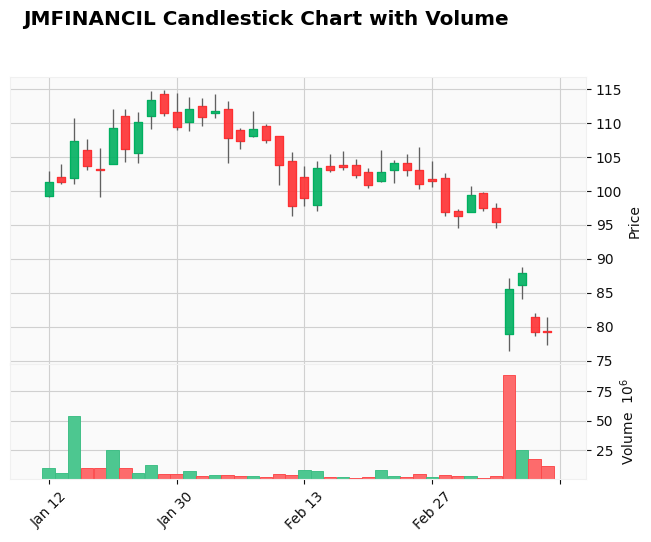

TCS
2024-01-12 00:00:00


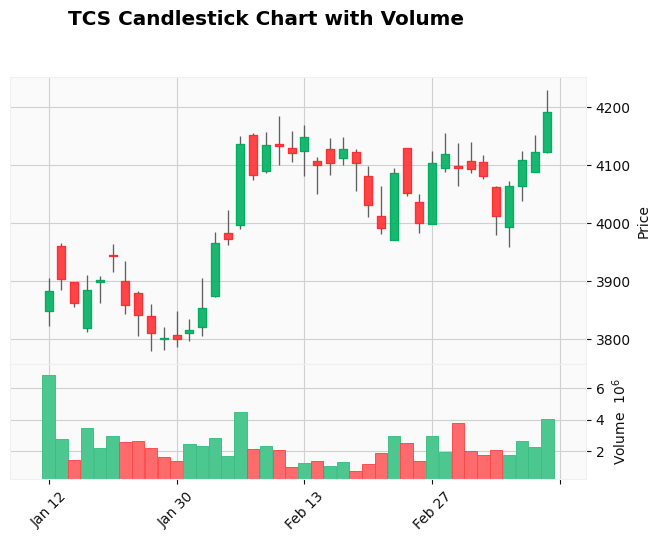

TCS
2024-01-12 00:00:00


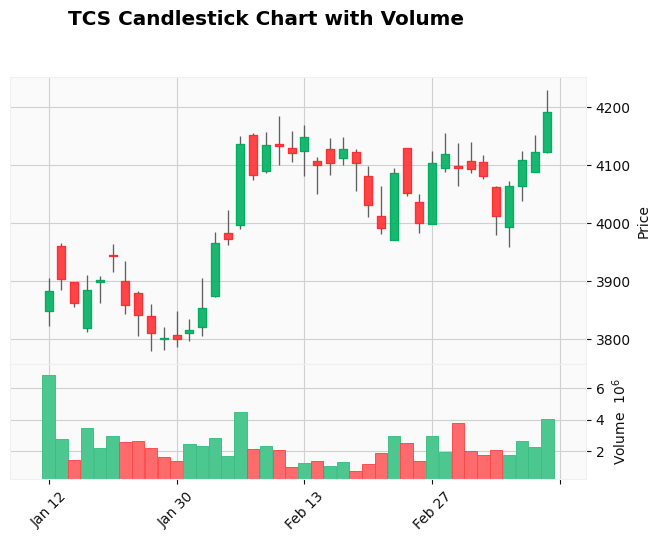

TECHM
2024-01-12 00:00:00


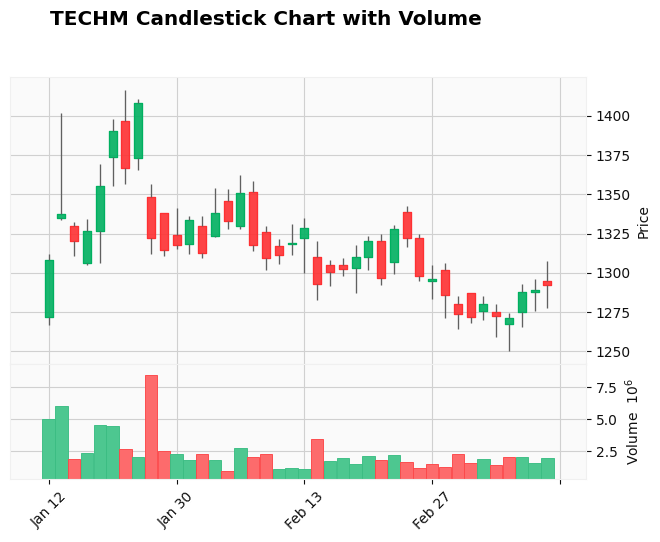

VENUSREM
2024-01-12 00:00:00


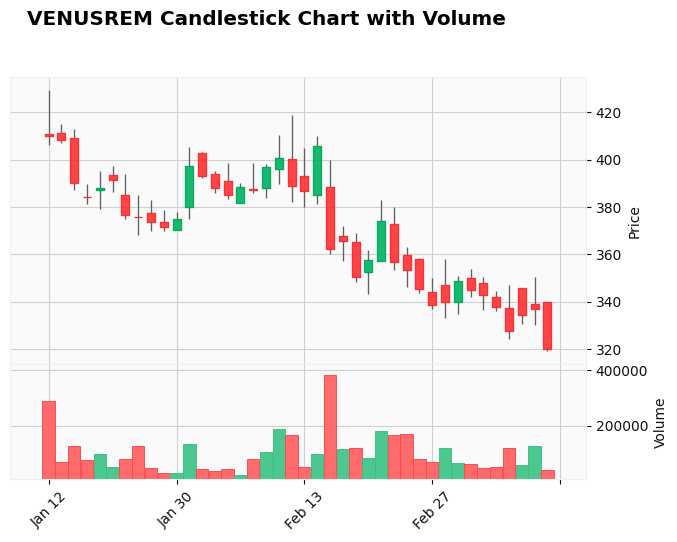

SBIN
2024-01-11 00:00:00


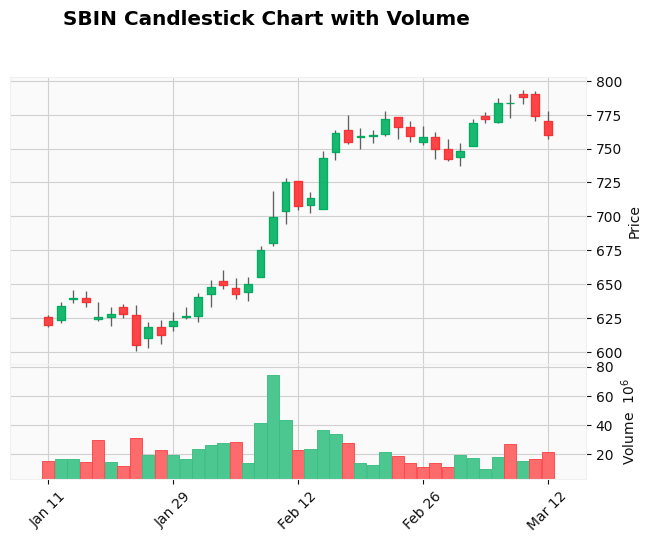

SBIN
2024-01-11 00:00:00


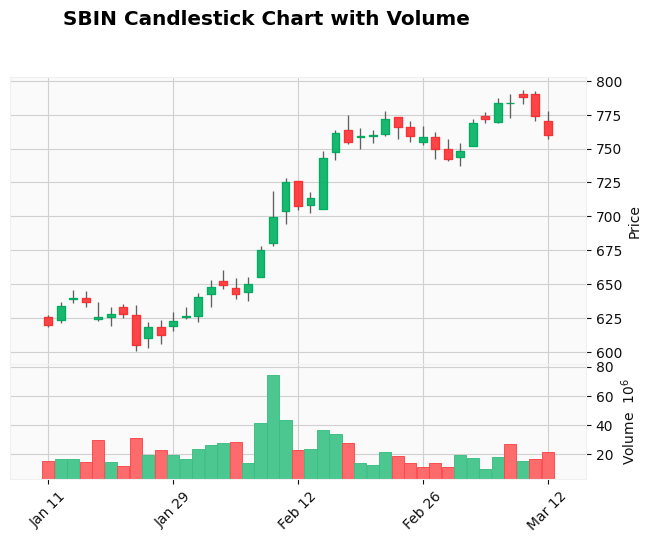

BPCL
2024-01-11 00:00:00


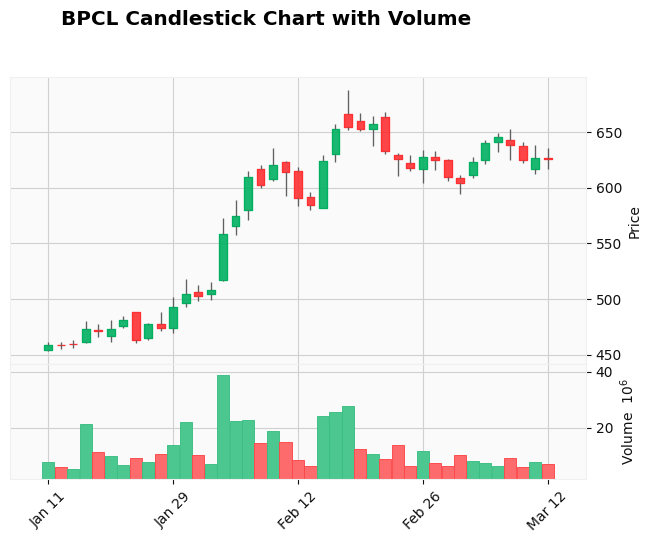

BHARTIARTL
2024-01-11 00:00:00


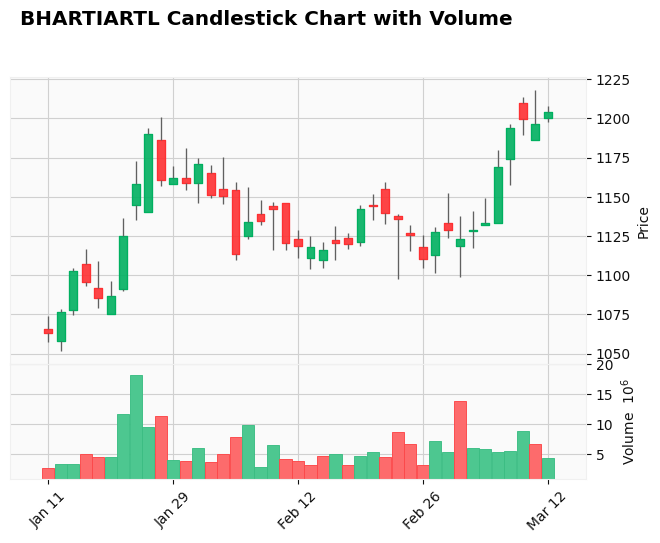

SOUTHBANK
2024-01-11 00:00:00


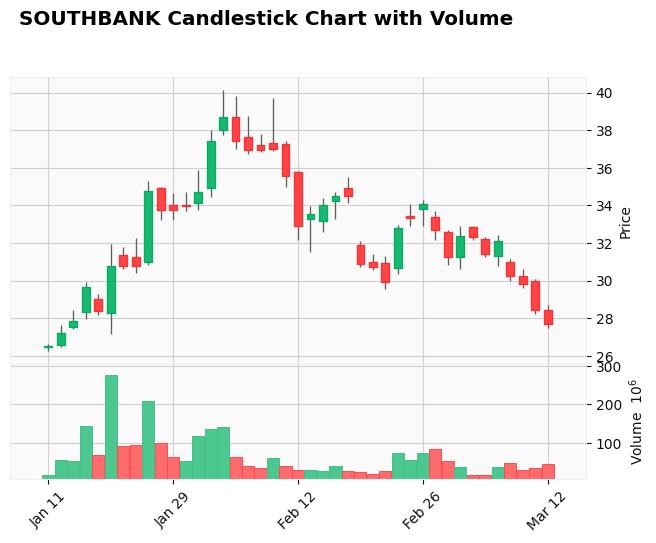

PNCINFRA
2024-01-11 00:00:00


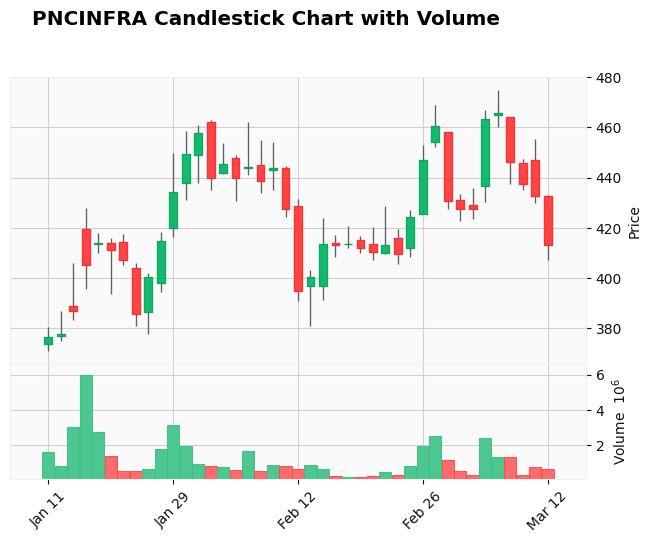

TCS
2024-01-11 00:00:00


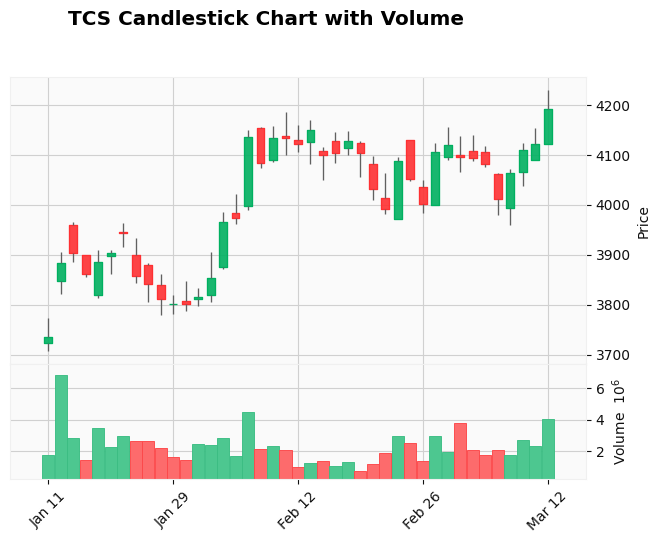

ASHOKA
2024-01-10 00:00:00


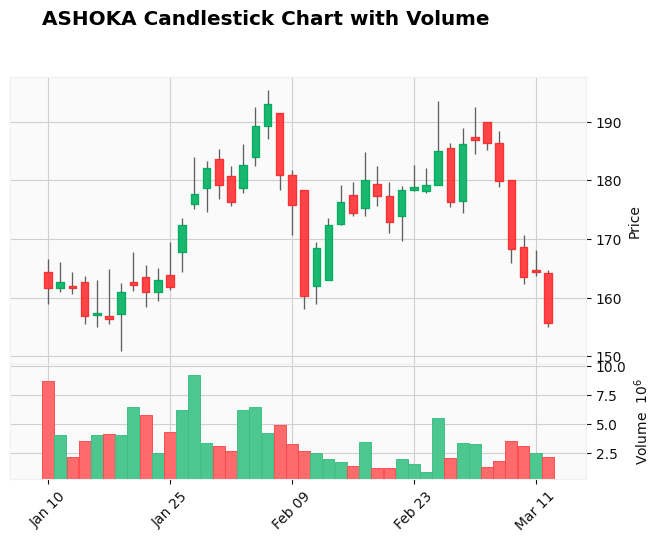

CHOICEIN
2024-01-10 00:00:00


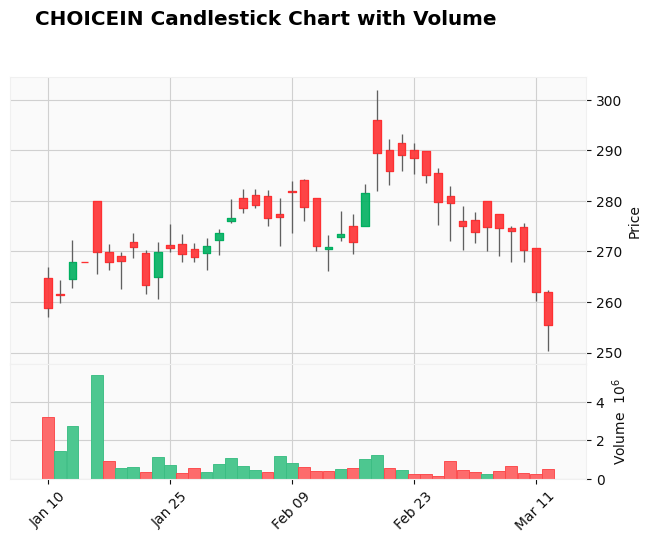

GEOJITFSL
2024-01-10 00:00:00


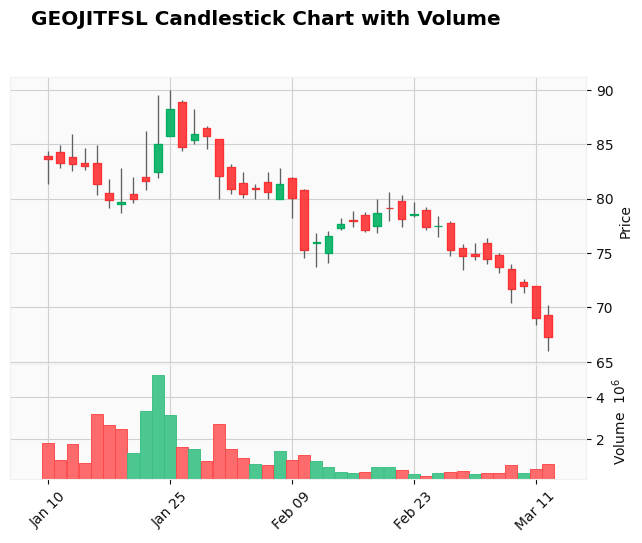

HCLTECH
2024-01-10 00:00:00


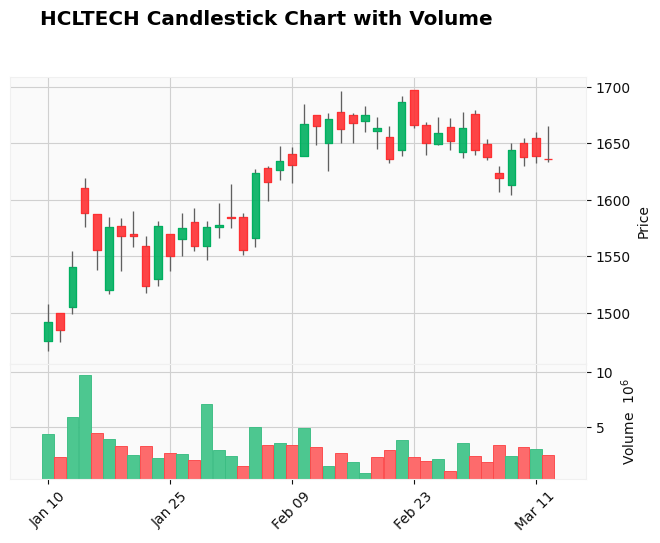

INDUSTOWER
2024-01-10 00:00:00


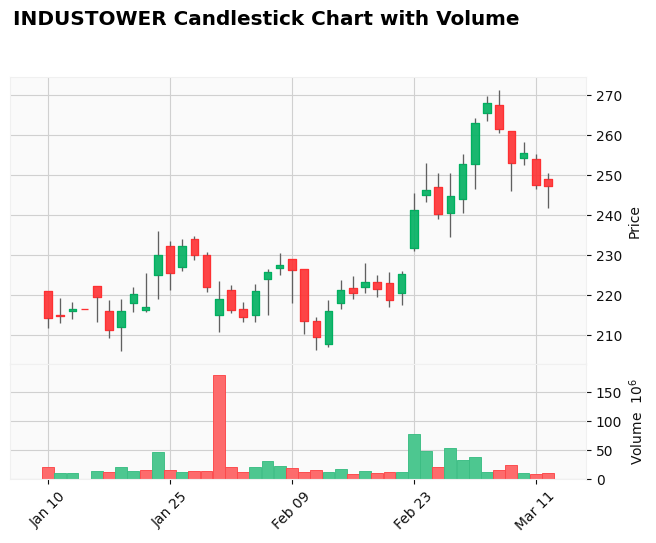

KPRMILL
2024-01-10 00:00:00


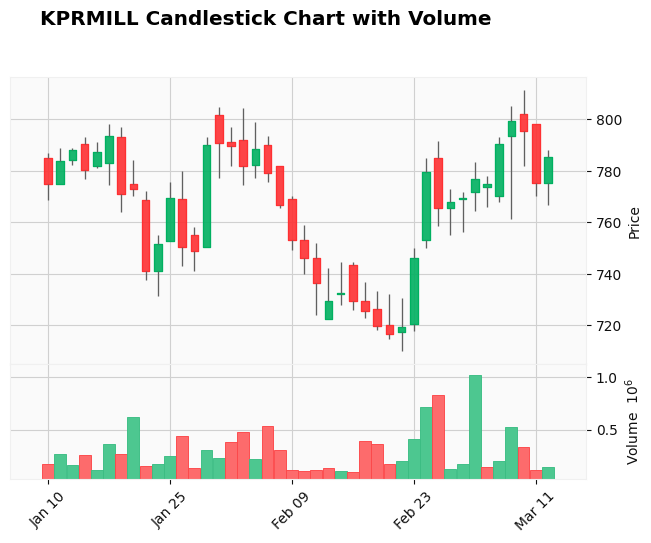

LATENTVIEW
2024-01-10 00:00:00


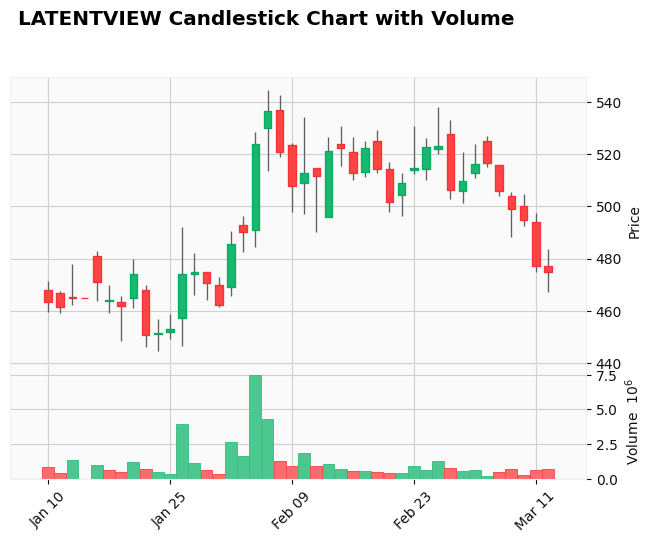

LICI
2024-01-10 00:00:00


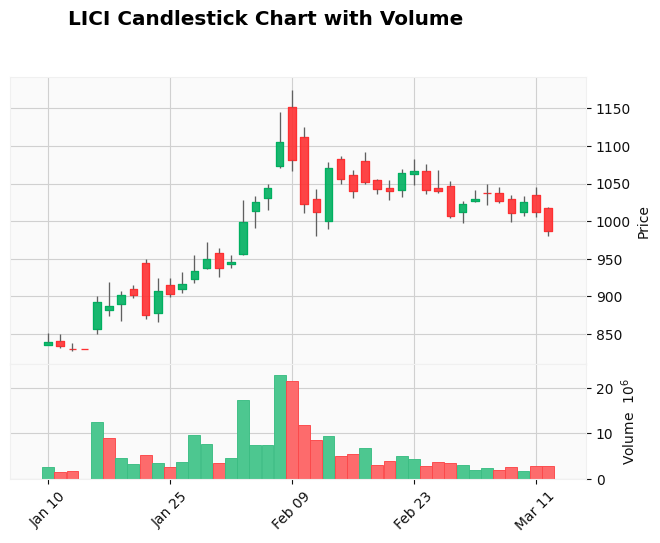

MARATHON
2024-01-10 00:00:00


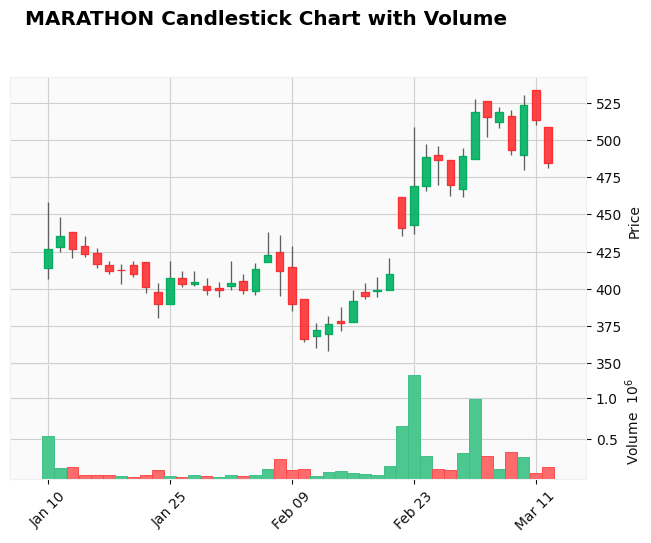

PRAJIND
2024-01-10 00:00:00


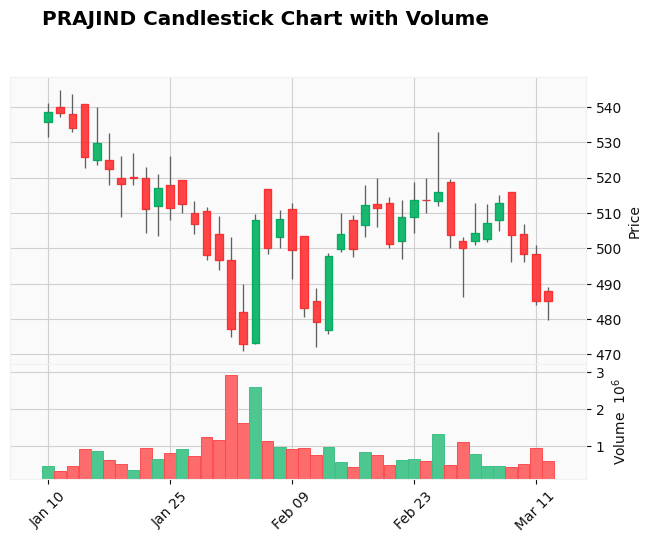

TANLA
2024-01-10 00:00:00


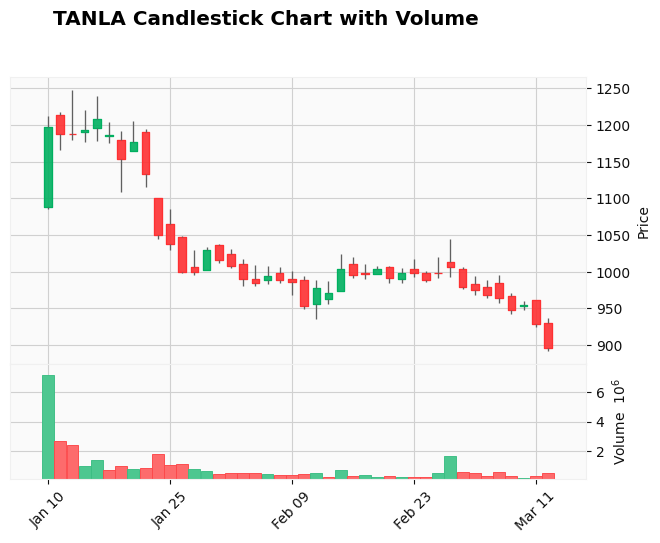

TANLA
2024-01-10 00:00:00


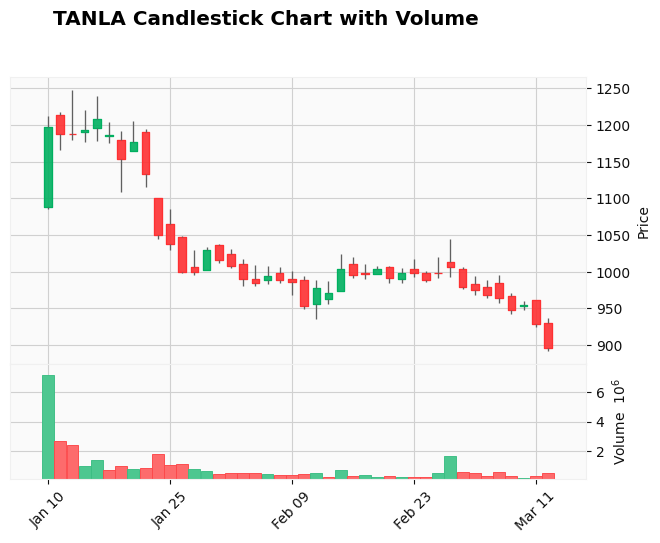

TCS
2024-01-10 00:00:00


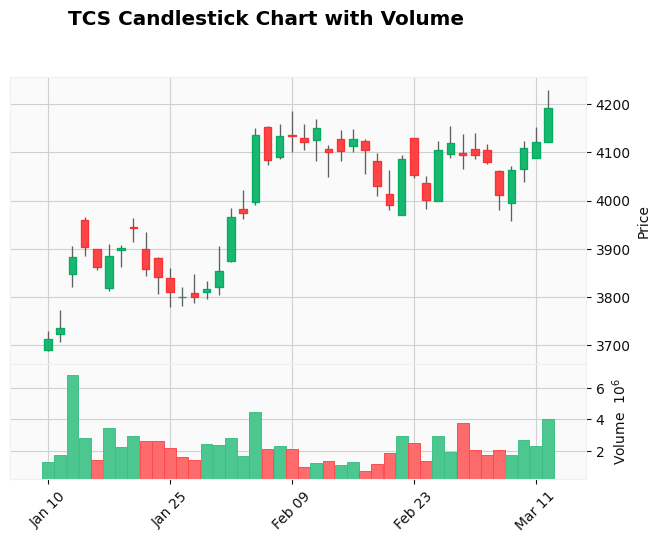

ZYDUSLIFE
2024-01-10 00:00:00


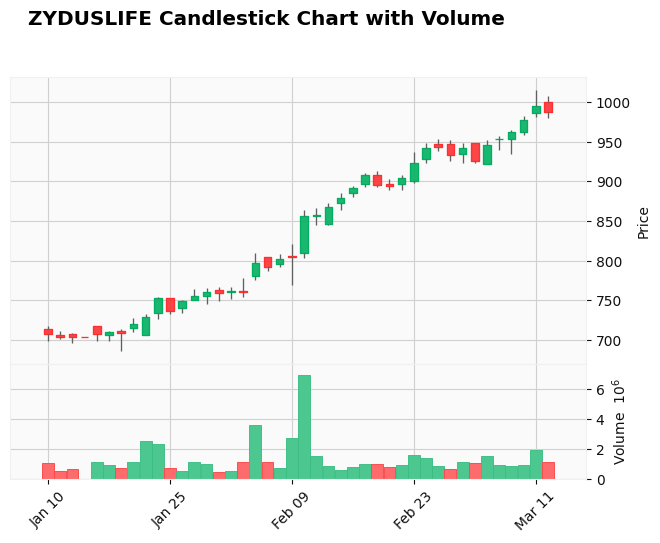

ADANIENSOL
2024-01-09 00:00:00


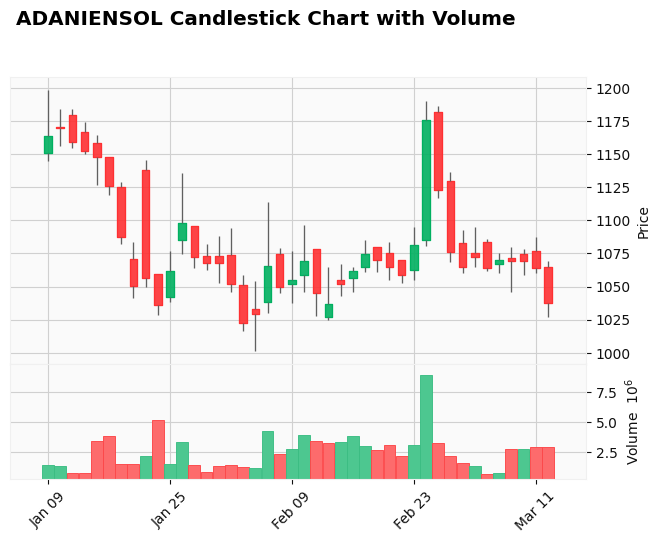

AETHER
2024-01-09 00:00:00


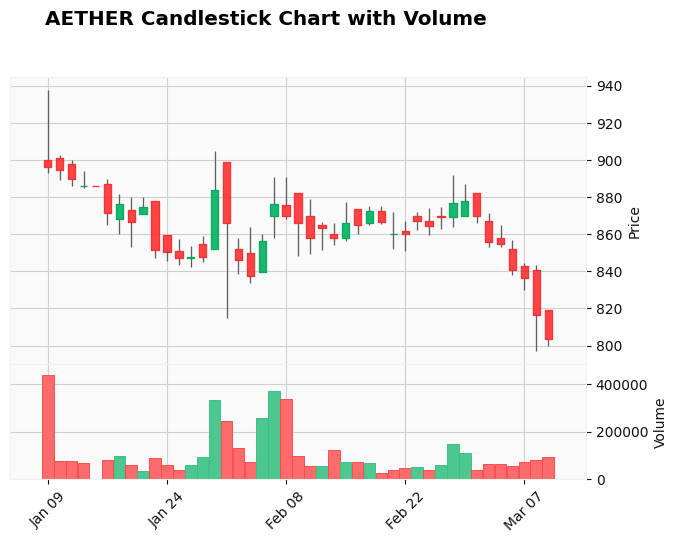

SBIN
2024-01-09 00:00:00


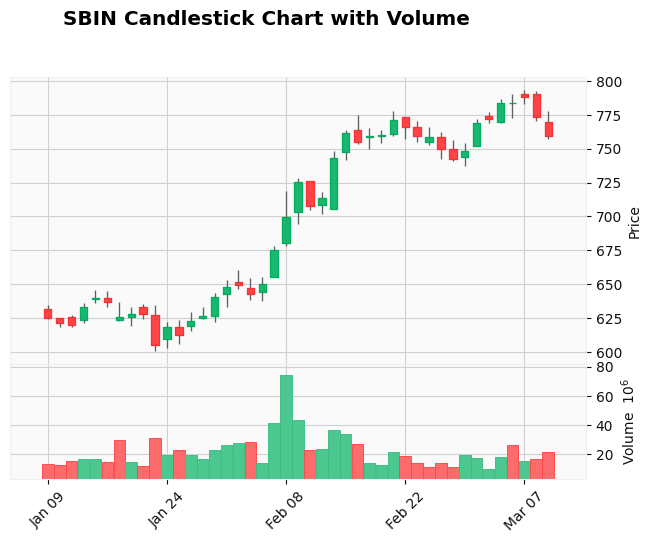

SBIN
2024-01-09 00:00:00


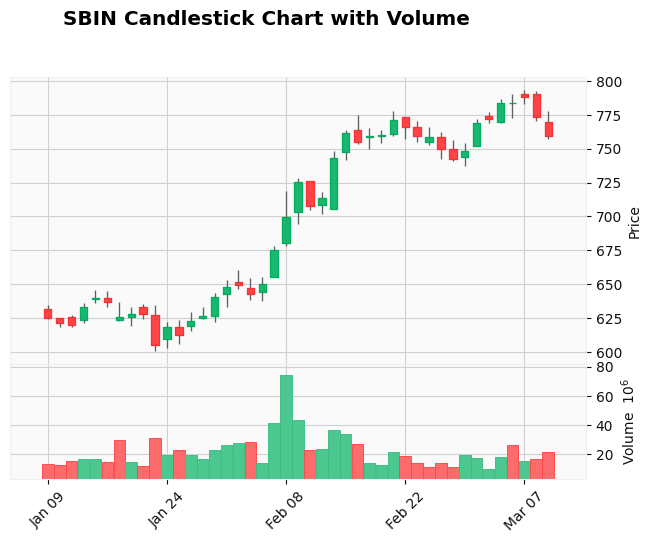

BATAINDIA
2024-01-09 00:00:00


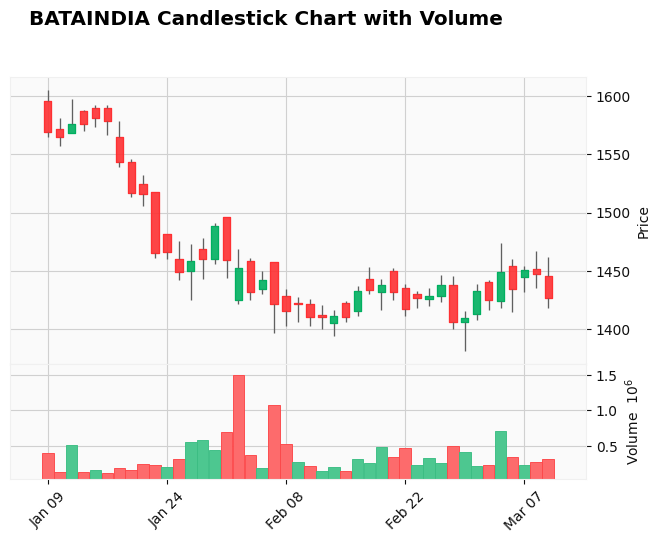

CESC
2024-01-09 00:00:00


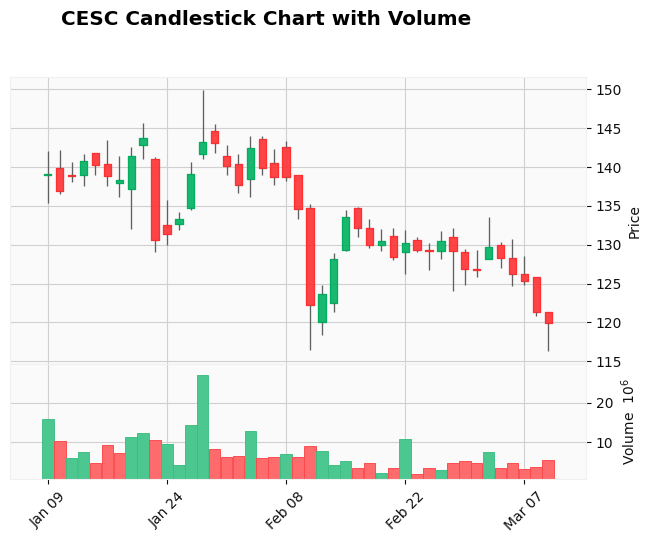

CESC
2024-01-09 00:00:00


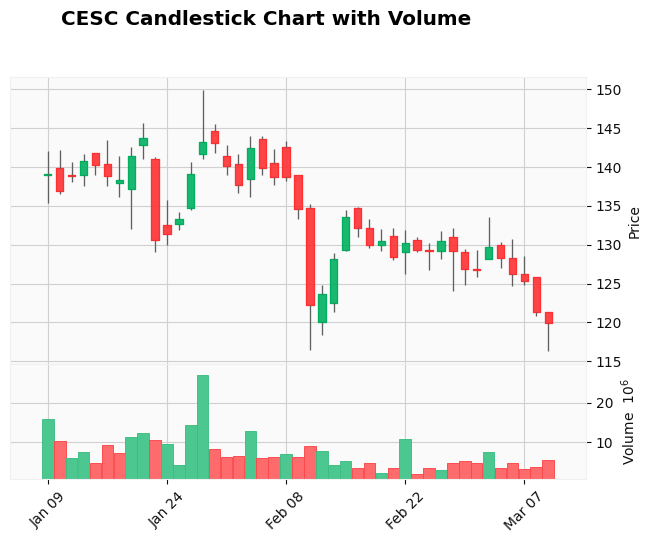

COROMANDEL
2024-01-09 00:00:00


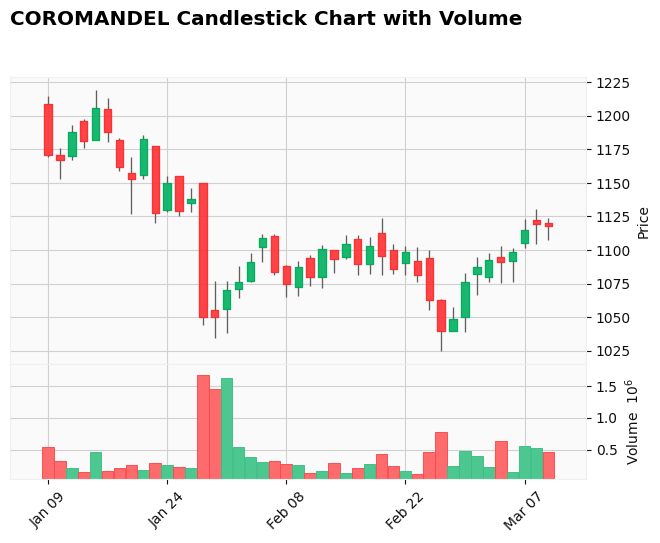

DATAMATICS
2024-01-09 00:00:00


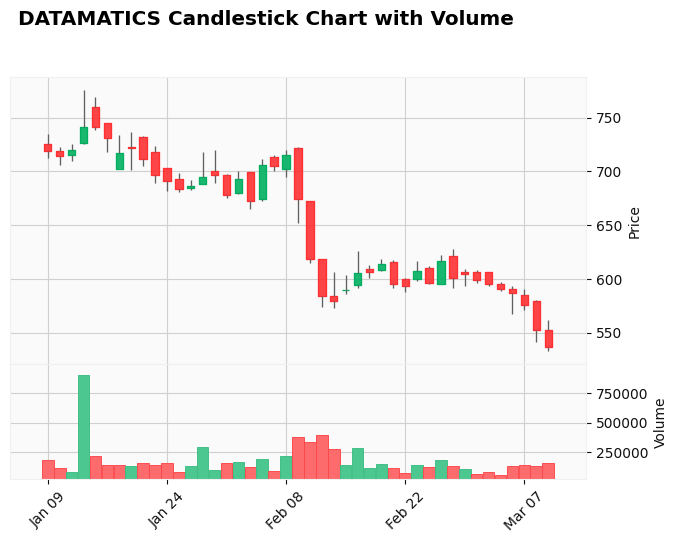

GENSOL
2024-01-09 00:00:00


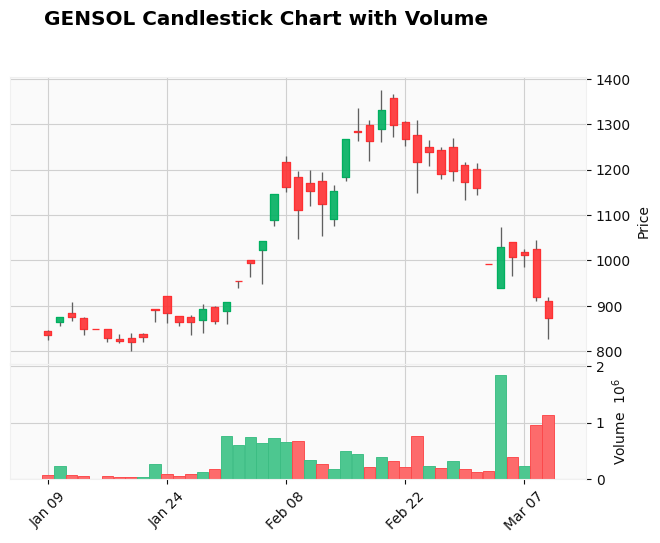

GRASIM
2024-01-09 00:00:00


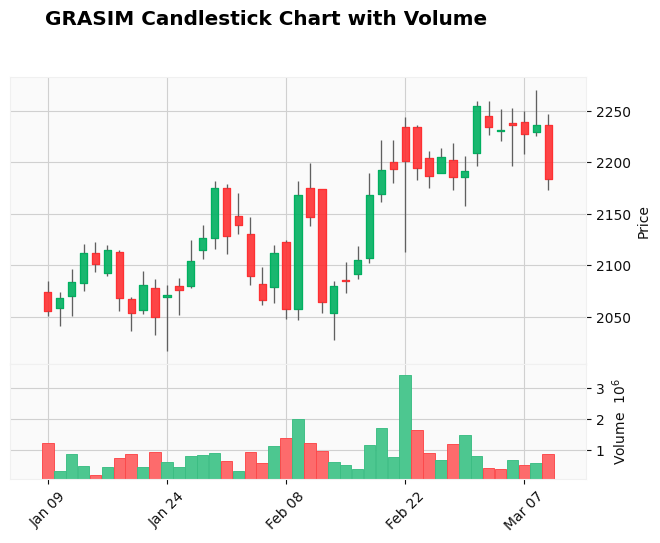

JSWSTEEL
2024-01-09 00:00:00


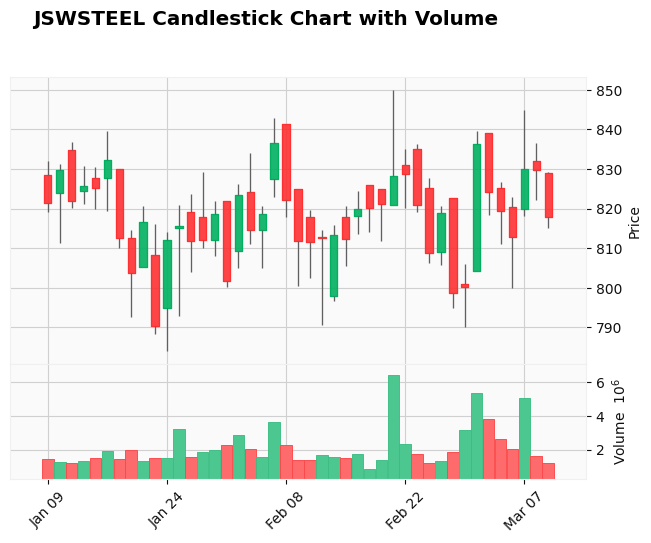

LICI
2024-01-09 00:00:00


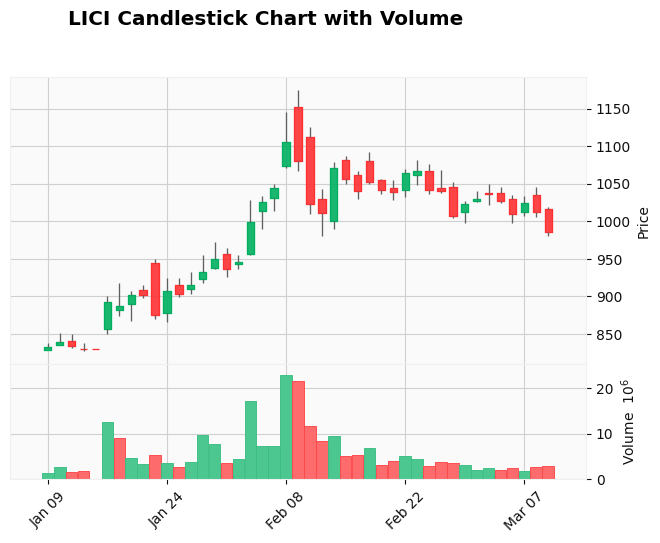

MOTILALOFS
2024-01-09 00:00:00


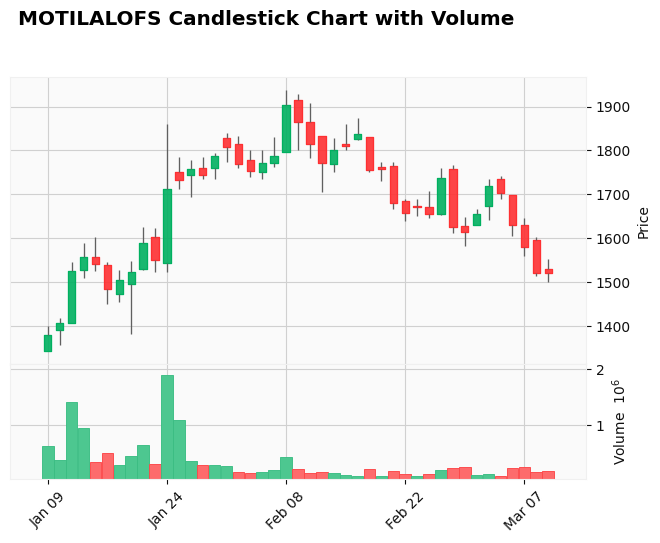

PRAJIND
2024-01-09 00:00:00


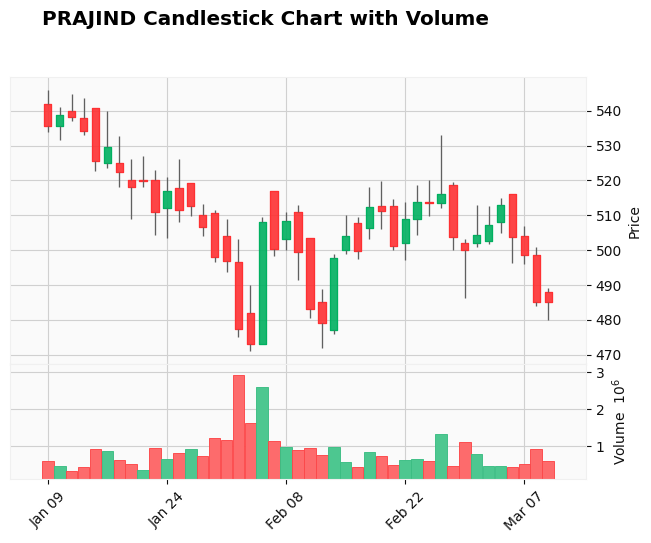

RUSHIL
2024-01-09 00:00:00


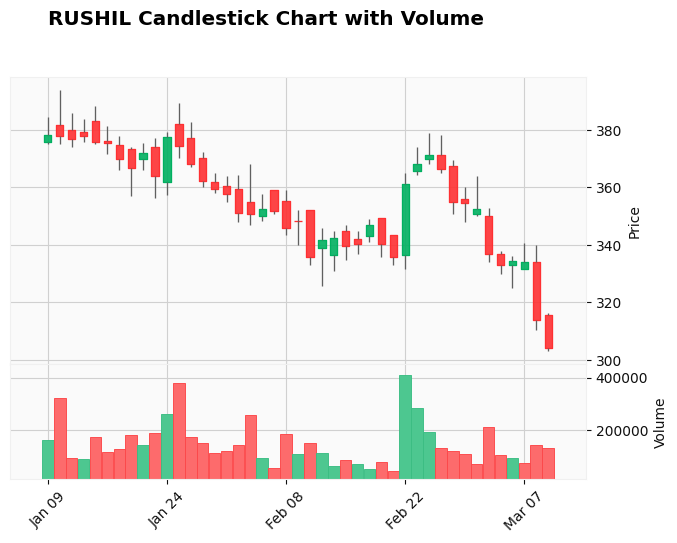

SAIL
2024-01-09 00:00:00


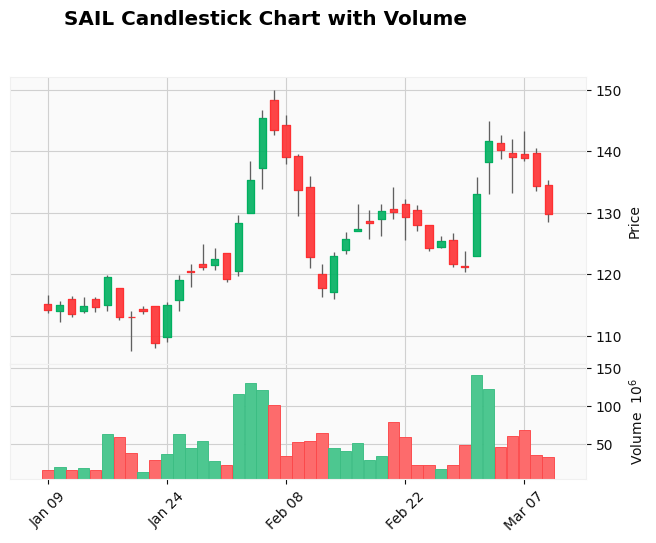

AWL
2024-01-08 00:00:00


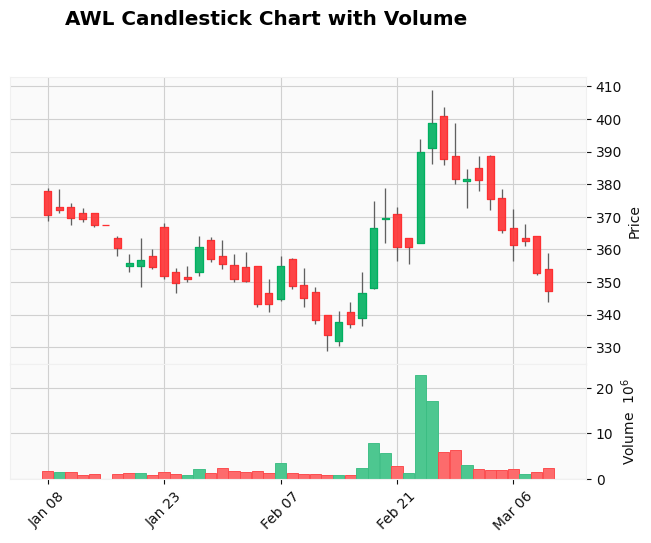

AMBUJACEM
2024-01-08 00:00:00


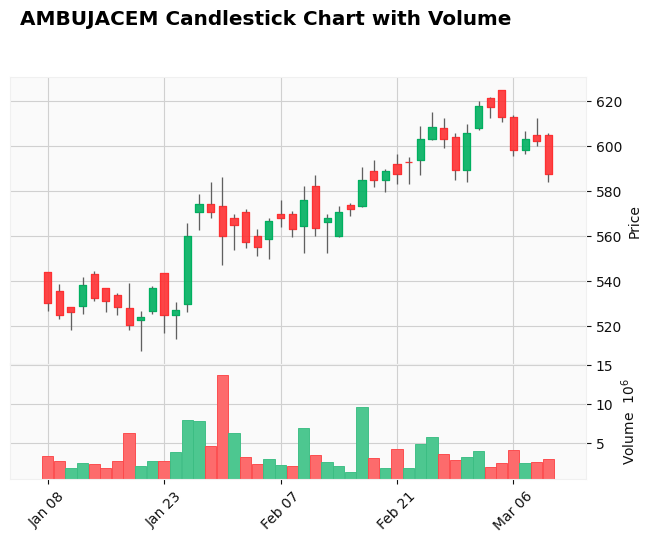

ASHOKLEY
2024-01-08 00:00:00


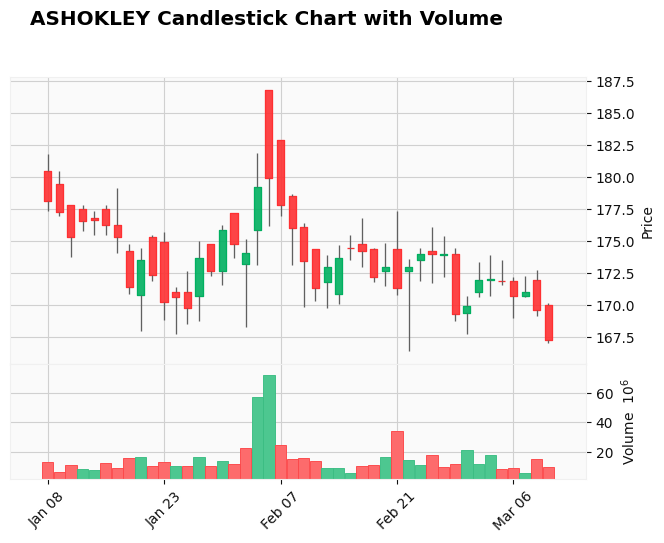

ASHOKLEY
2024-01-08 00:00:00


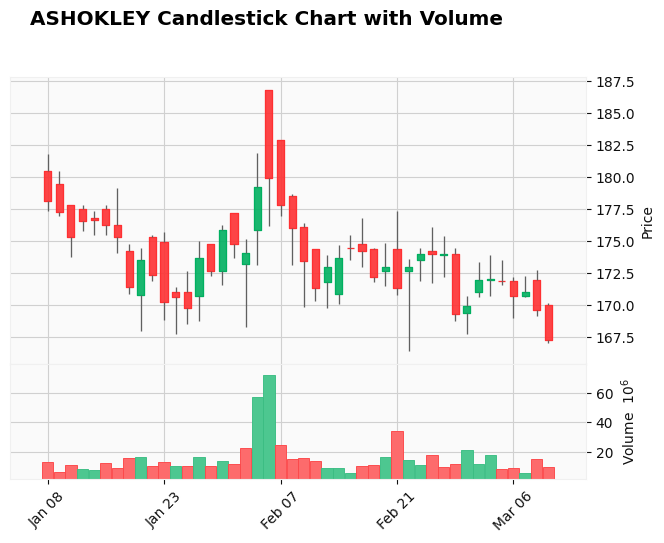

BAJFINANCE
2024-01-08 00:00:00


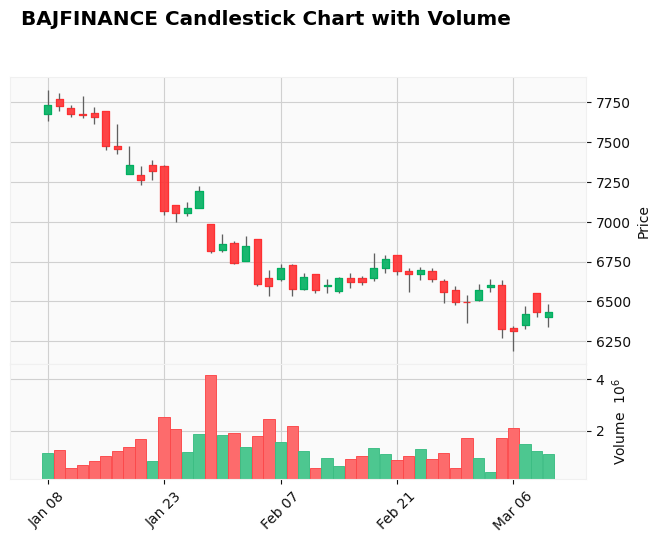

BANKBARODA
2024-01-08 00:00:00


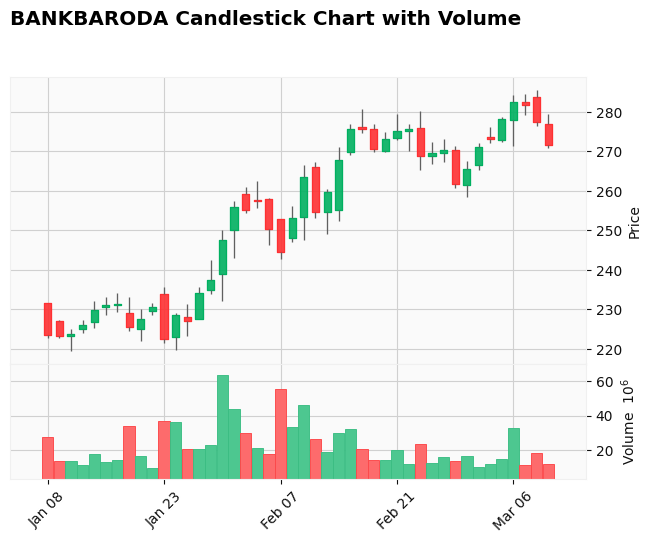

SBIN
2024-01-08 00:00:00


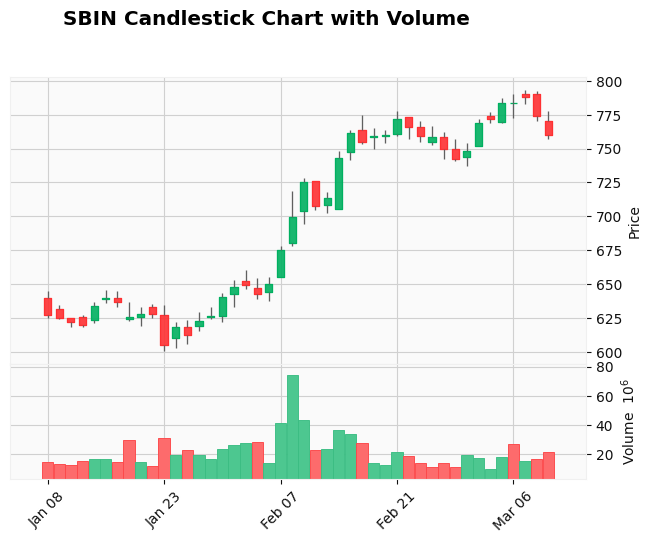

BLUEDART
2024-01-08 00:00:00


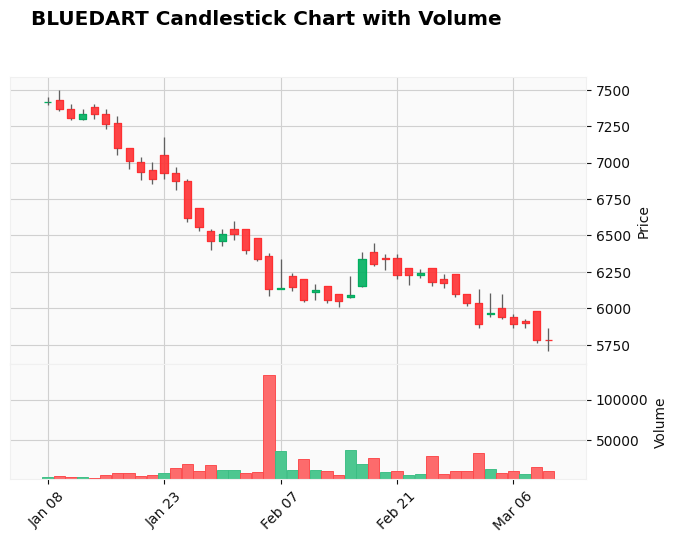

GEOJITFSL
2024-01-08 00:00:00


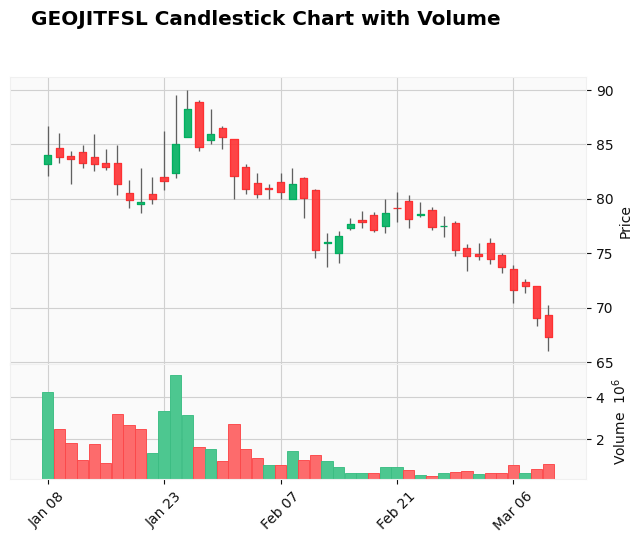

GREENPANEL
2024-01-08 00:00:00


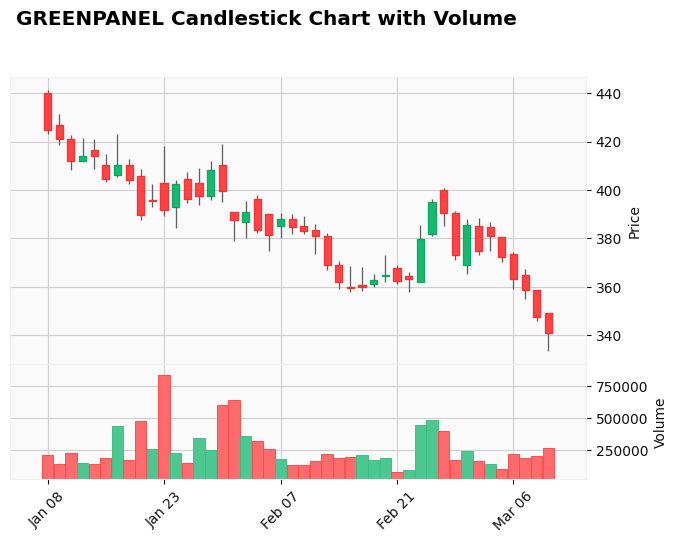

INDIGO
2024-01-08 00:00:00


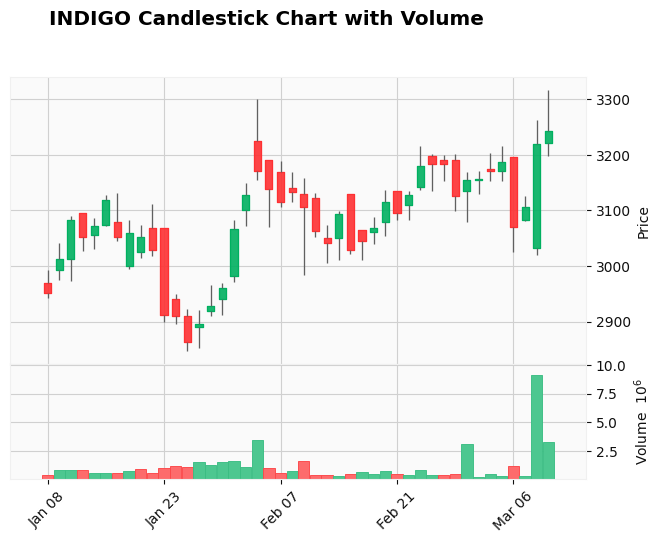

TATACOMM
2024-01-08 00:00:00


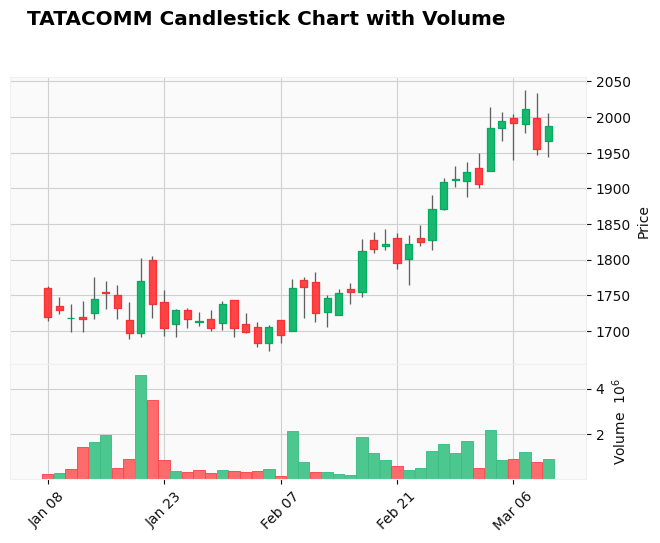

TITAN
2024-01-08 00:00:00


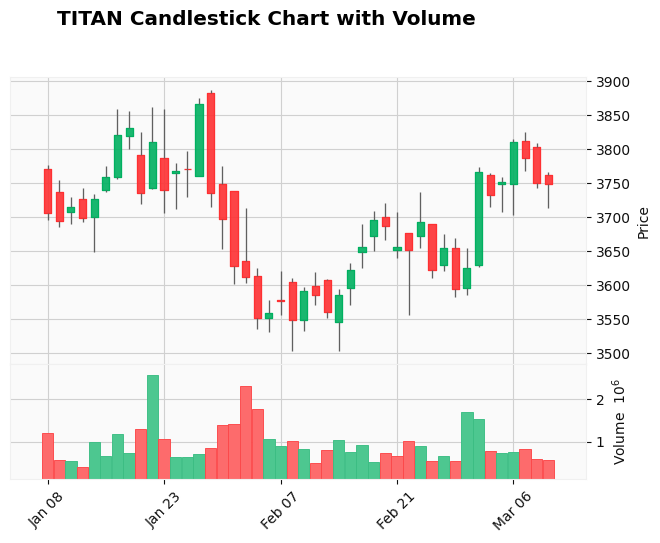

APLAPOLLO
2024-01-05 00:00:00


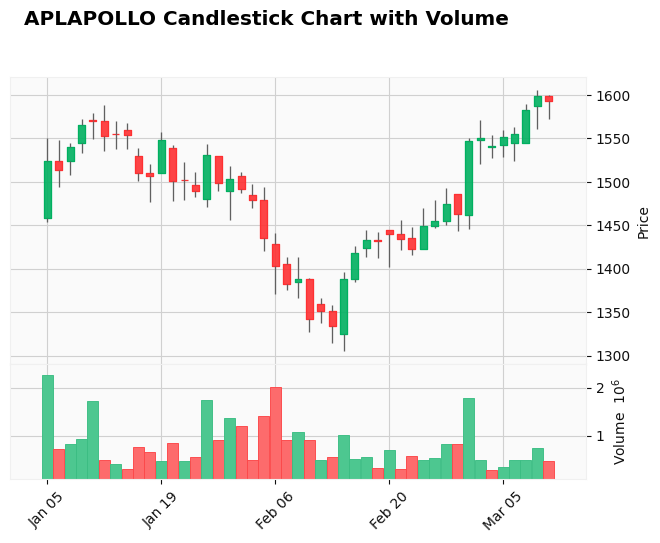

BAJFINANCE
2024-01-05 00:00:00


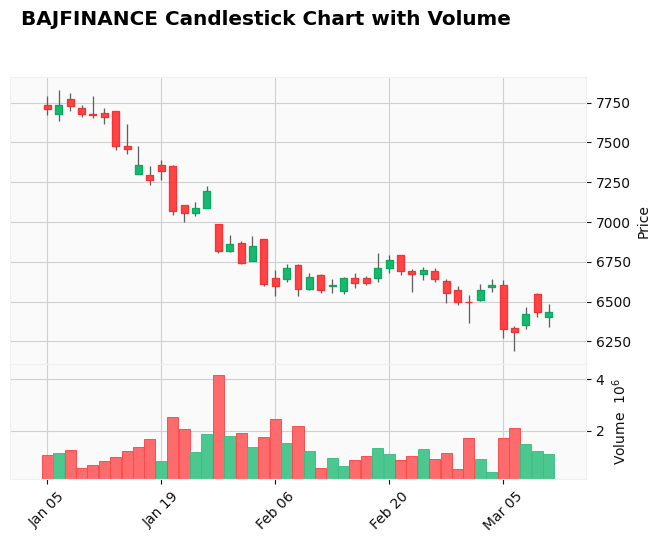

BANDHANBNK
2024-01-05 00:00:00


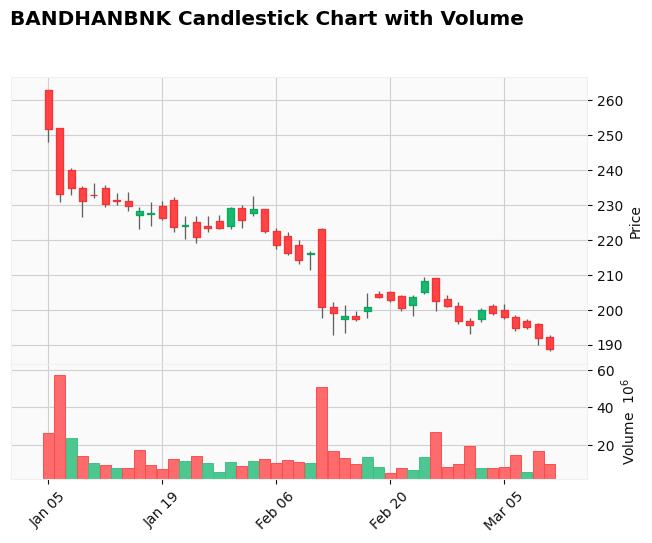

SBIN
2024-01-05 00:00:00


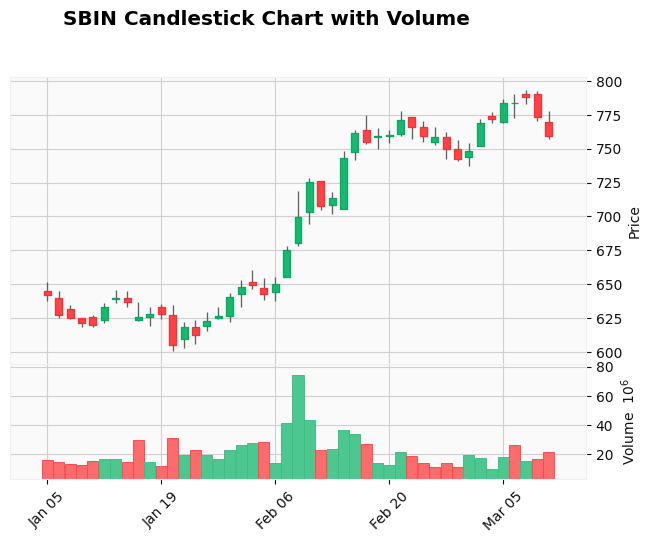

DEEPAKNTR
2024-01-05 00:00:00


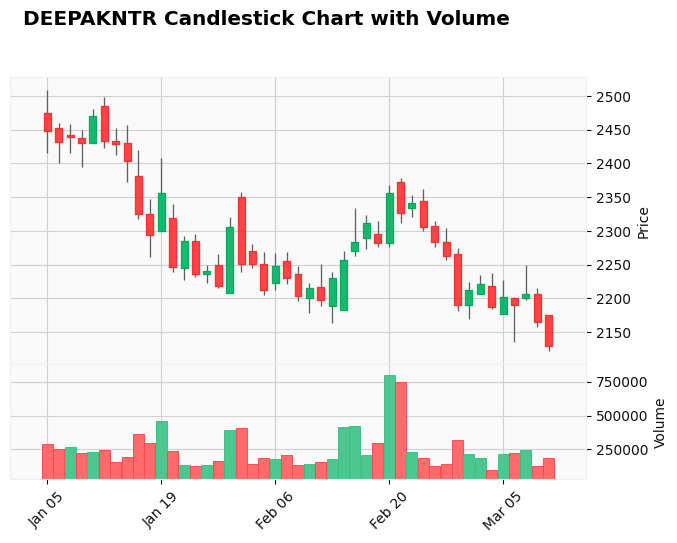

DHANBANK
2024-01-05 00:00:00


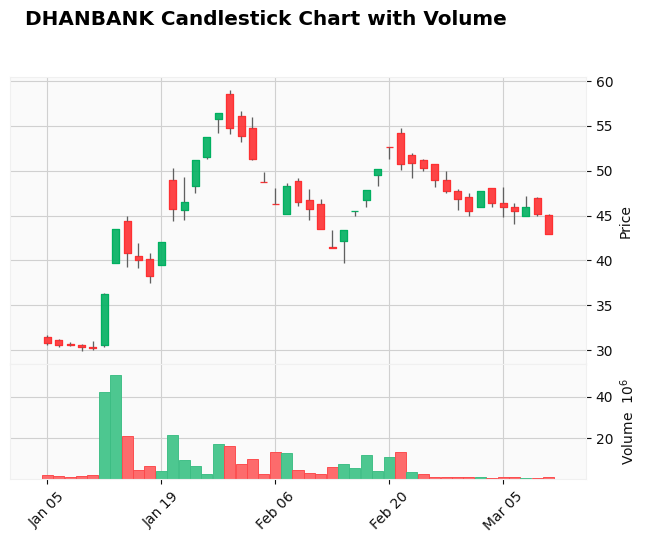

EXIDEIND
2024-01-05 00:00:00


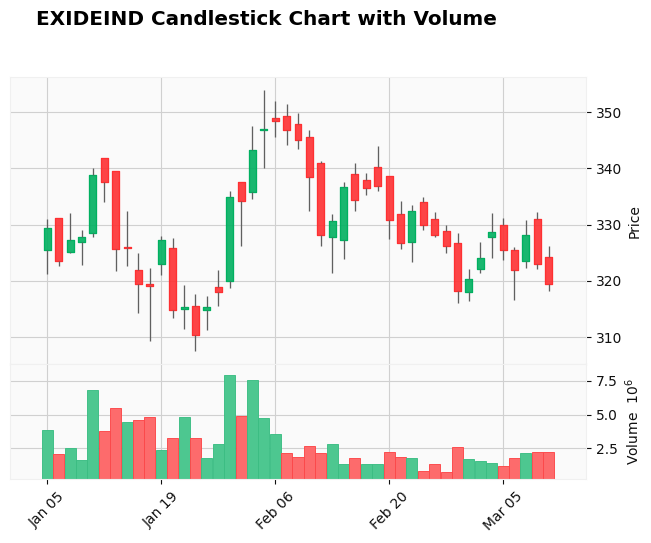

GRASIM
2024-01-05 00:00:00


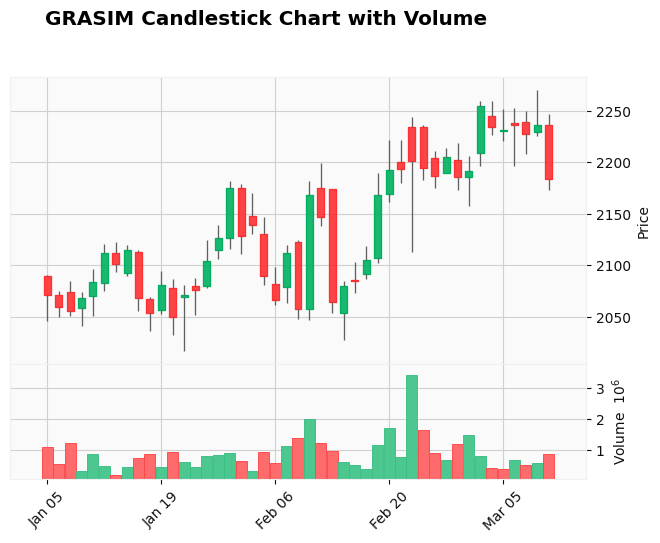

HDFCBANK
2024-01-05 00:00:00


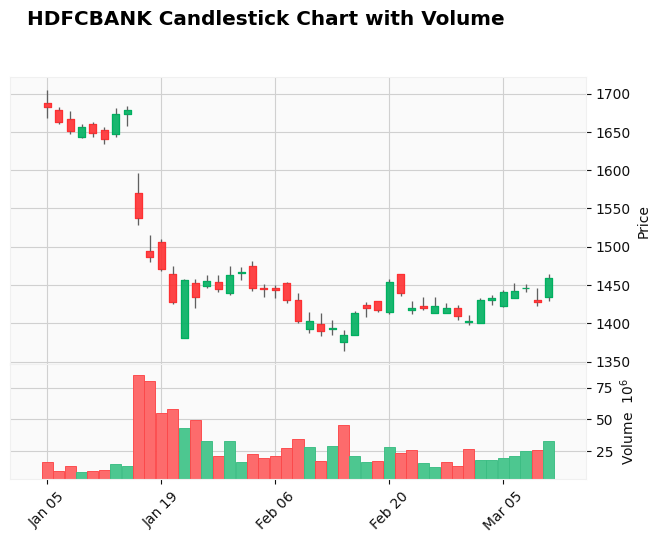

HDFCBANK
2024-01-05 00:00:00


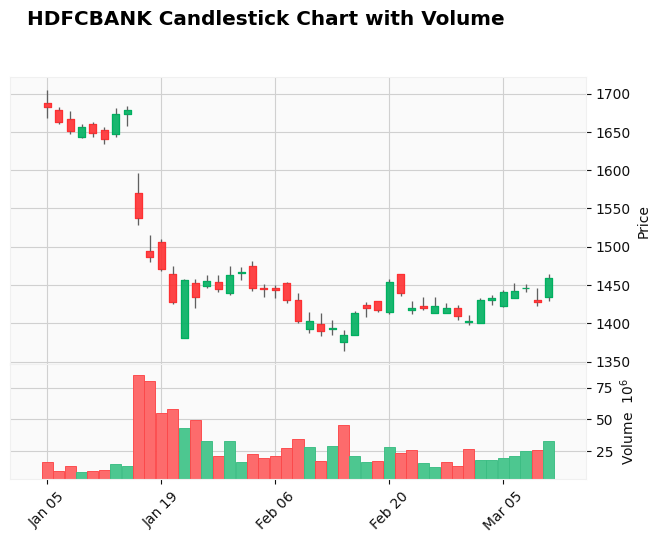

HDFCBANK
2024-01-05 00:00:00


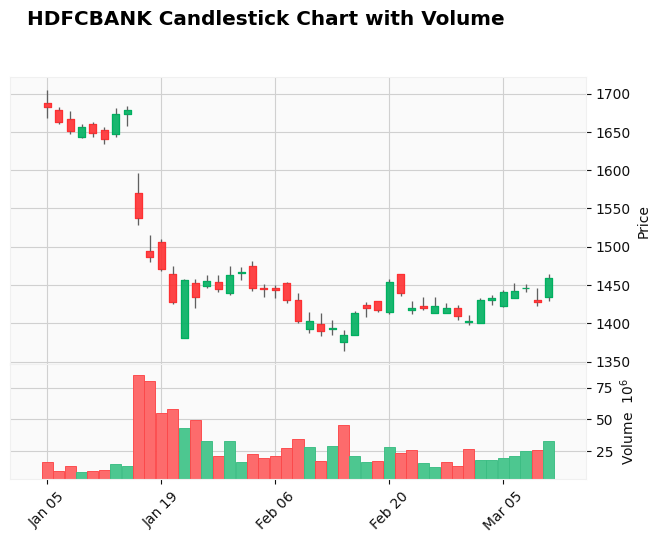

IIFL
2024-01-05 00:00:00


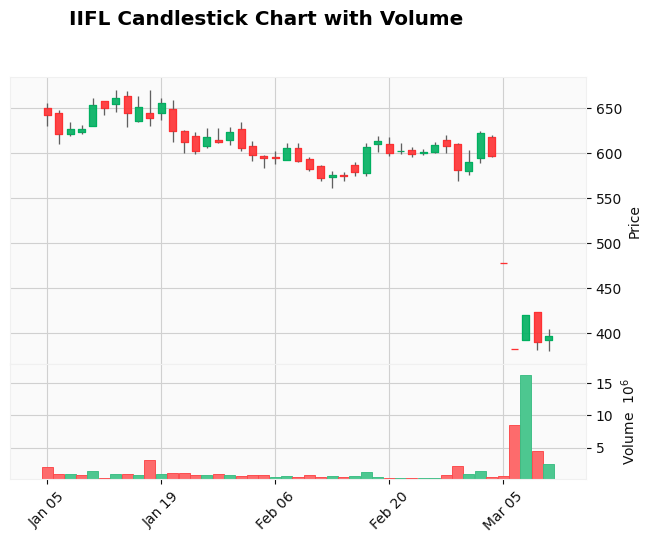

SOUTHBANK
2024-01-05 00:00:00


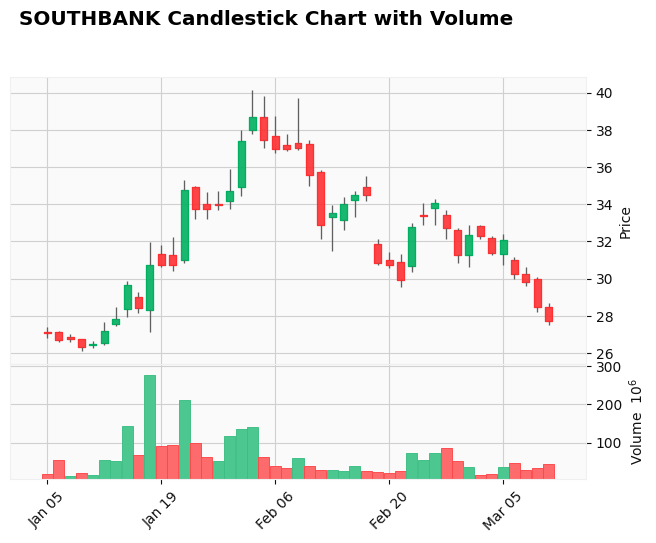

INDUSTOWER
2024-01-05 00:00:00


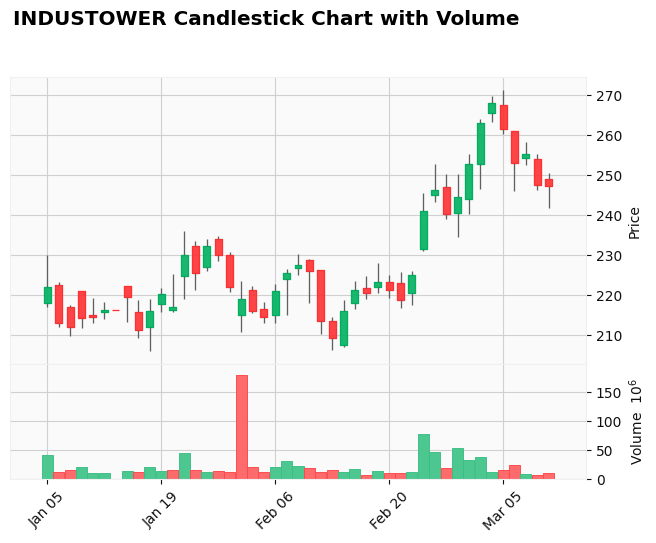

POWERGRID
2024-01-05 00:00:00


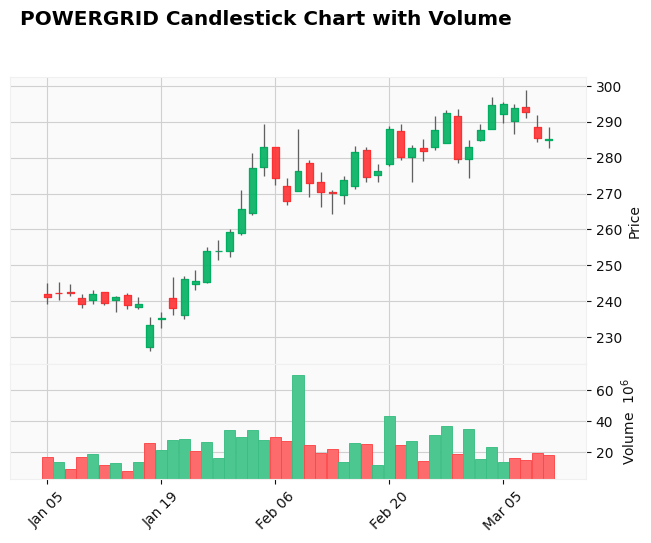

SHREECEM
2024-01-05 00:00:00


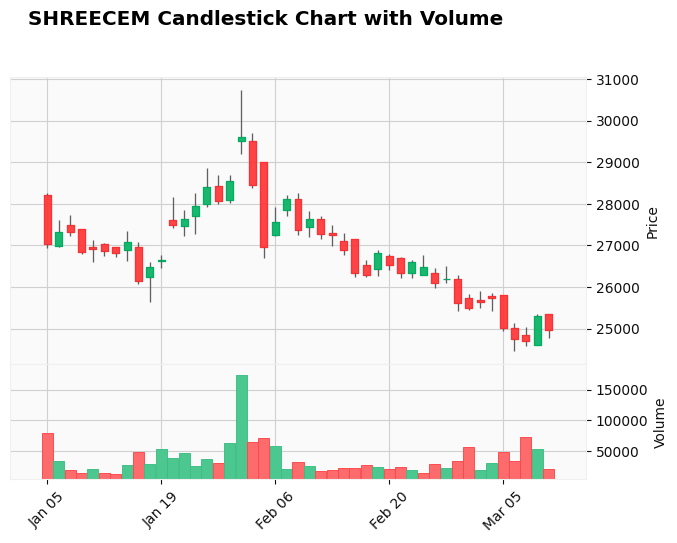

SBIN
2024-01-05 00:00:00


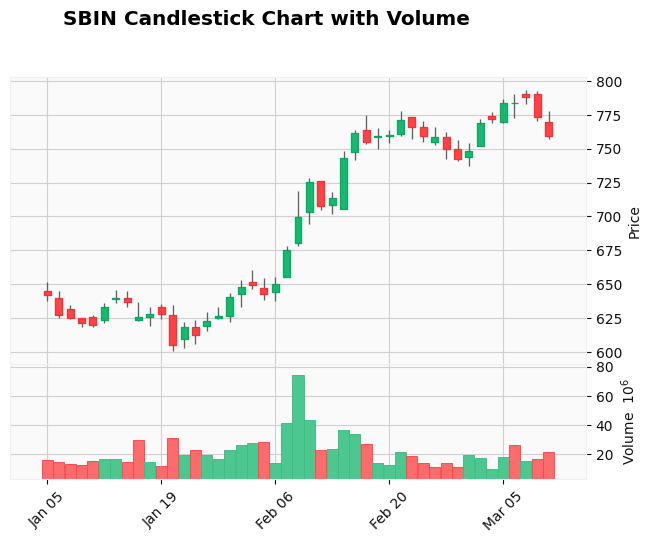

SUNTECK
2024-01-05 00:00:00


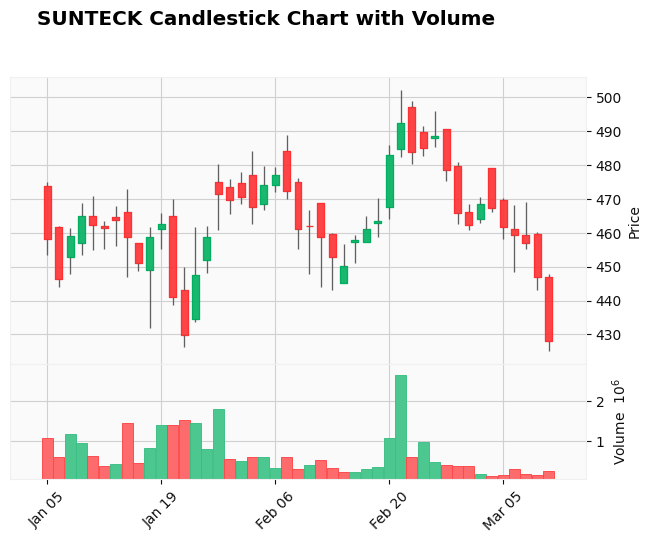

SUNTECK
2024-01-05 00:00:00


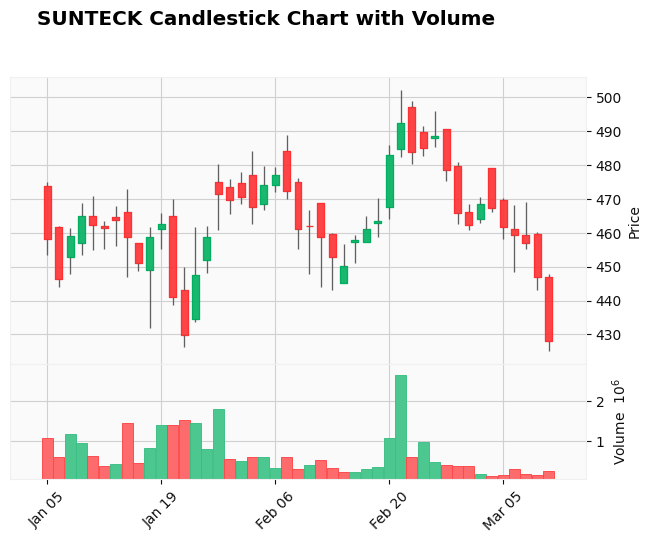

ANGELONE
2024-01-04 00:00:00


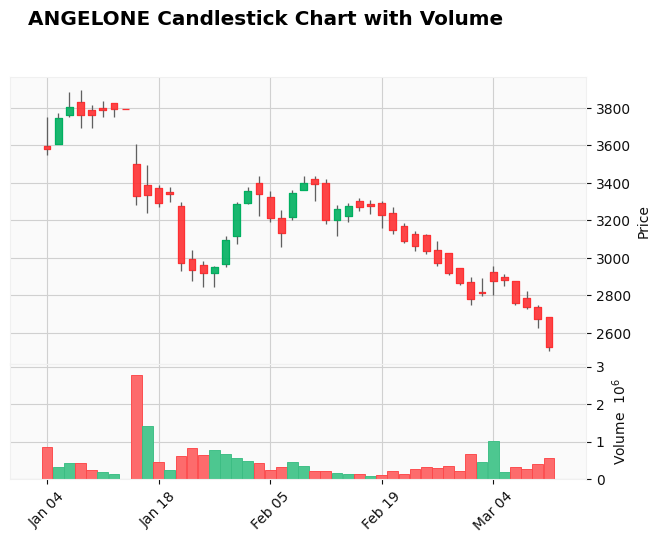

AUBANK
2024-01-04 00:00:00


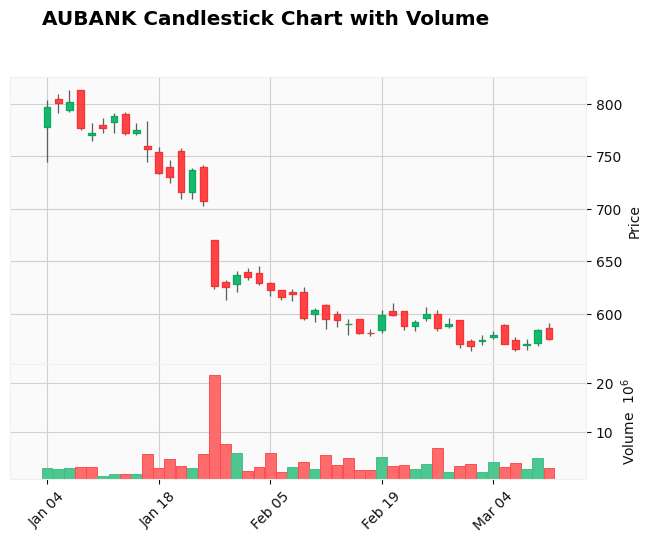

AXISBANK
2024-01-04 00:00:00


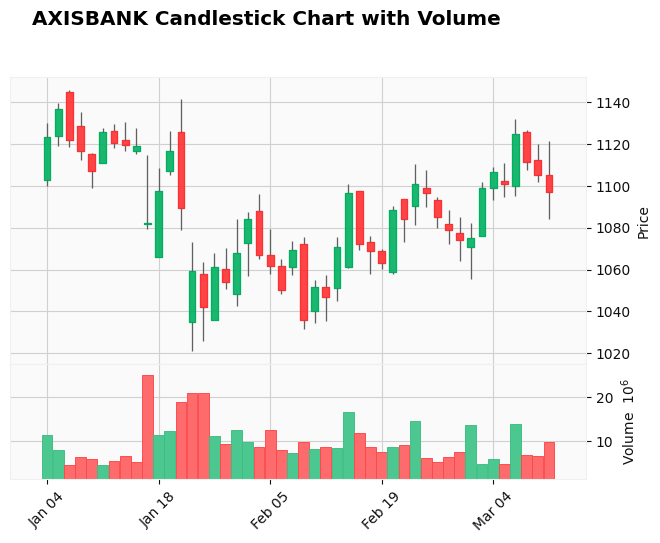

BAJFINANCE
2024-01-04 00:00:00


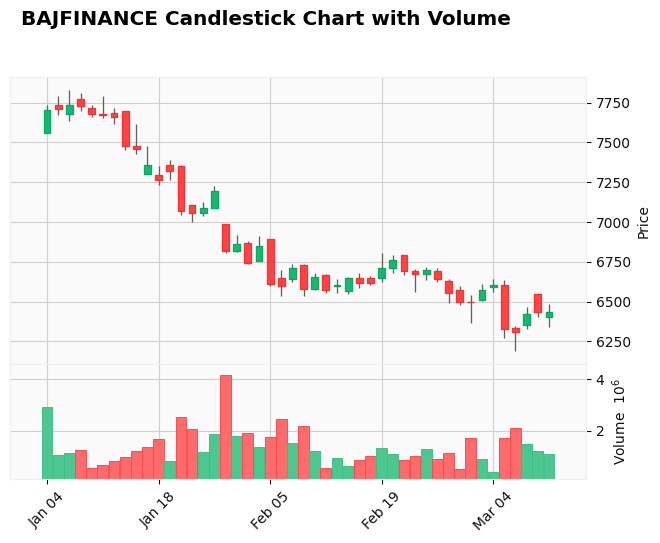

BAJFINANCE
2024-01-04 00:00:00


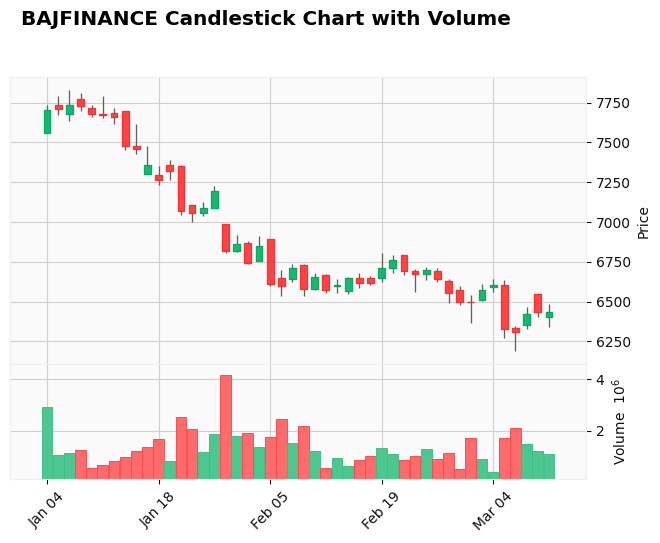

SBIN
2024-01-04 00:00:00


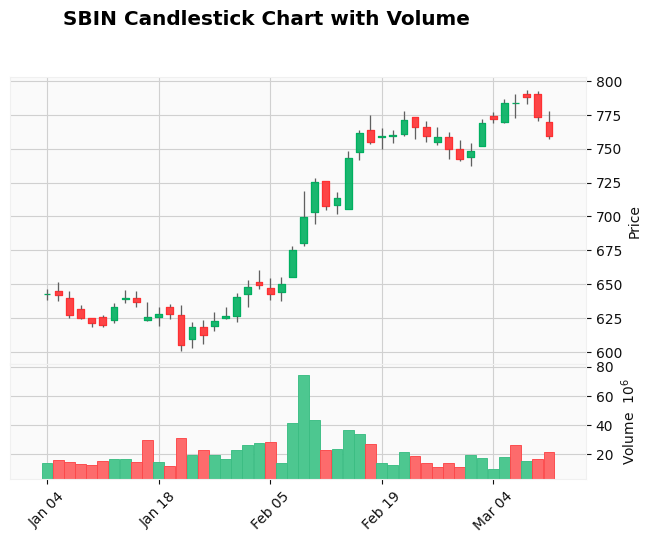

HEROMOTOCO
2024-01-04 00:00:00


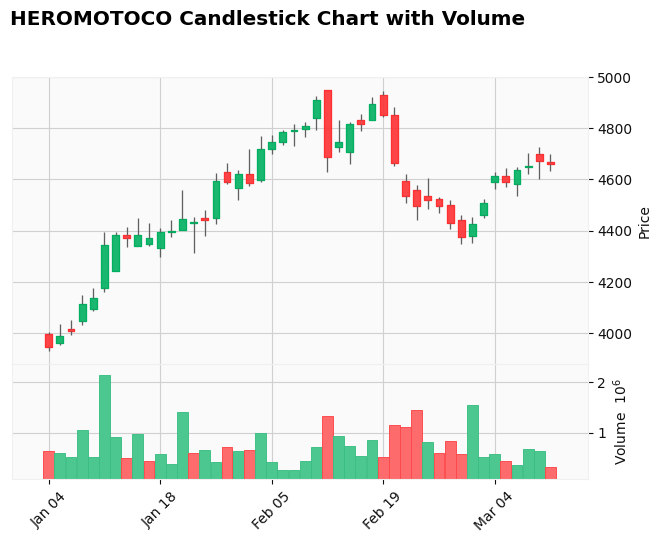

POONAWALLA
2024-01-04 00:00:00


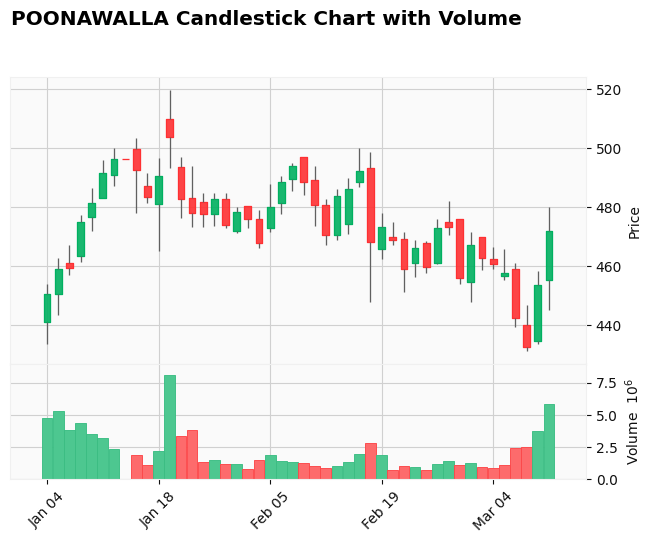

TATAMOTORS
2024-01-04 00:00:00


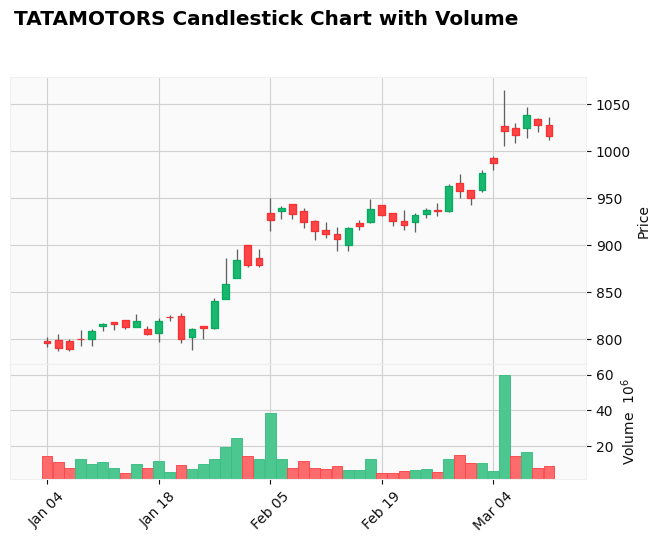

ADANIPORTS
2024-01-03 00:00:00


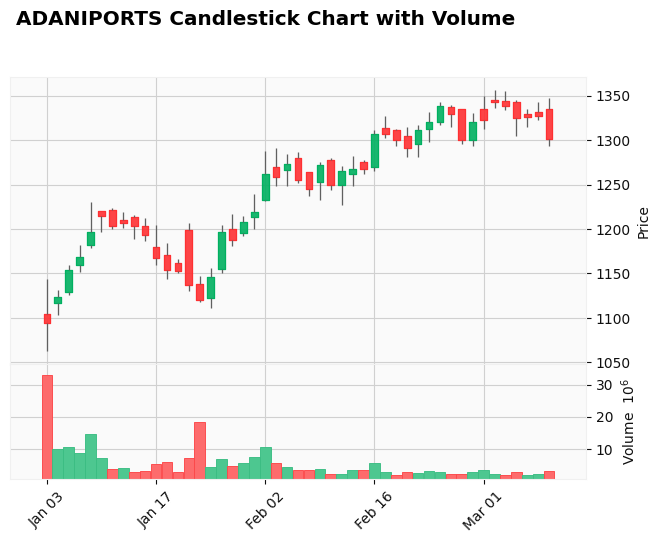

ATGL
2024-01-03 00:00:00


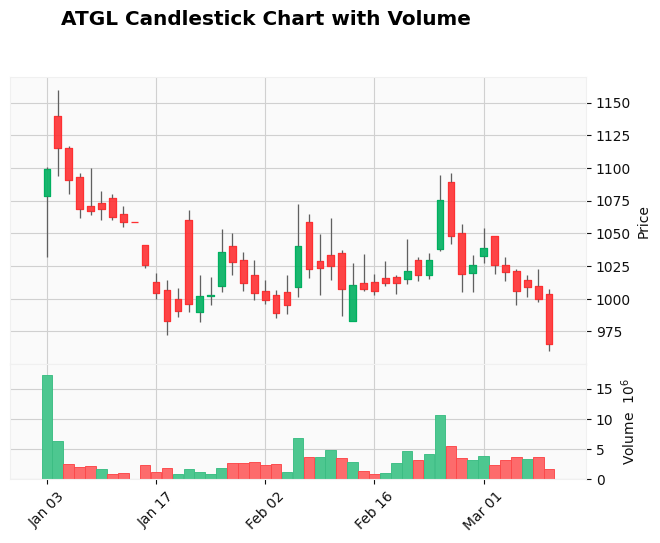

DMART
2024-01-03 00:00:00


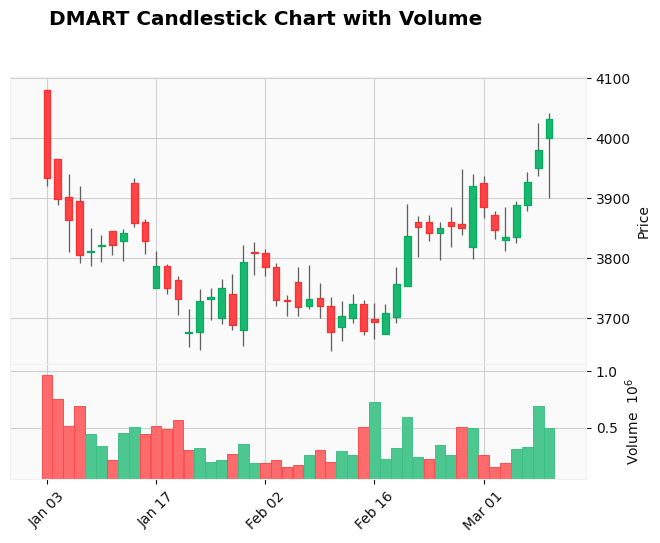

BAJAJ-AUTO
2024-01-03 00:00:00


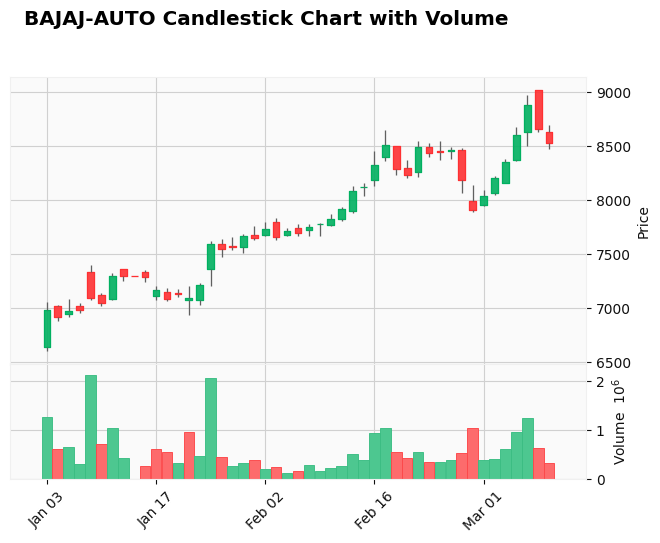

MAHABANK
2024-01-03 00:00:00


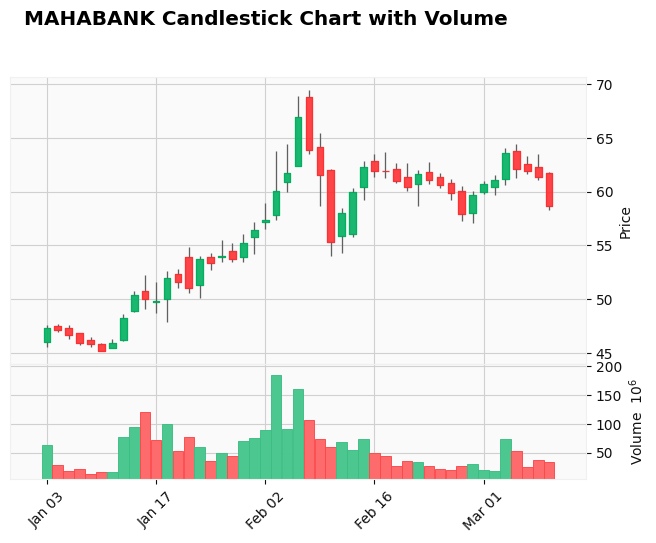

CMSINFO
2024-01-03 00:00:00


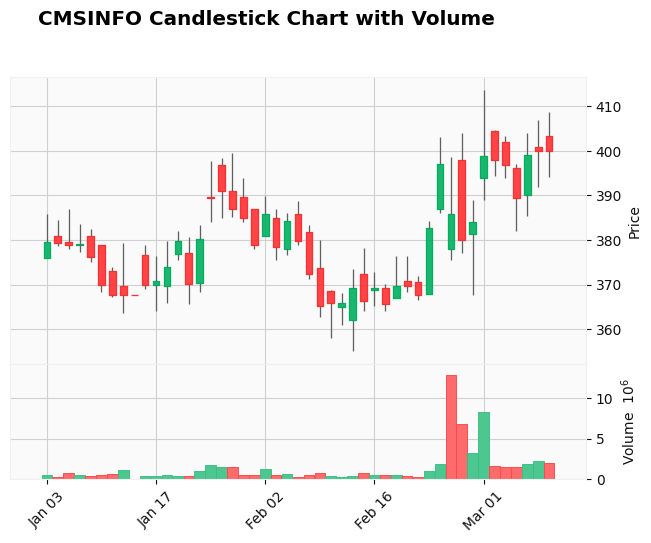

CMSINFO
2024-01-03 00:00:00


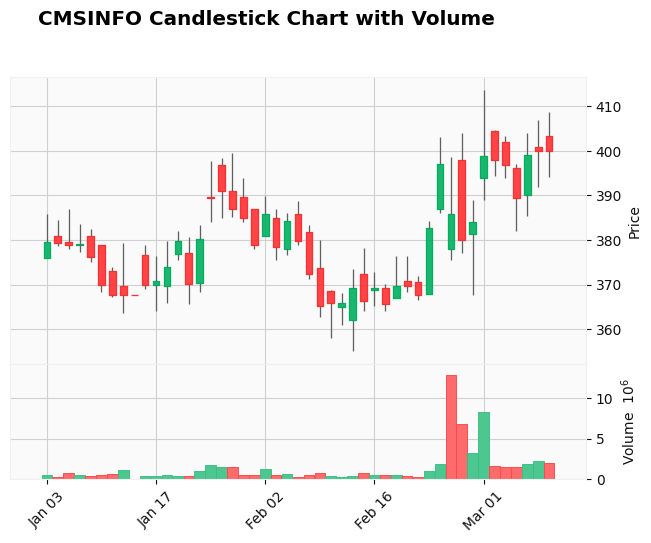

FEDERALBNK
2024-01-03 00:00:00


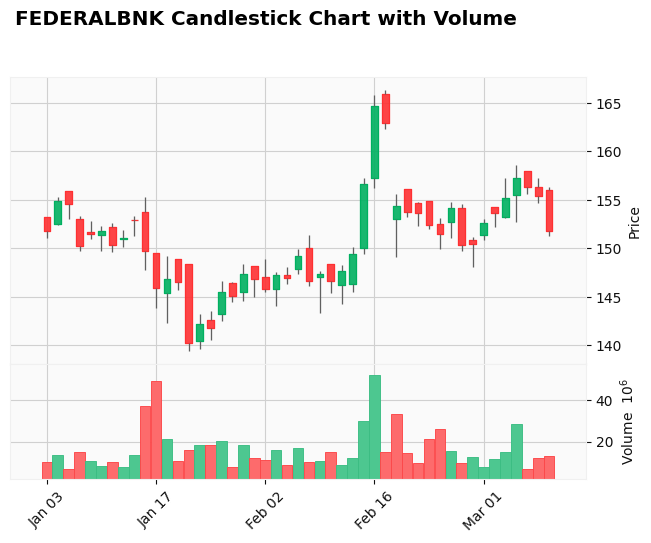

GEOJITFSL
2024-01-03 00:00:00


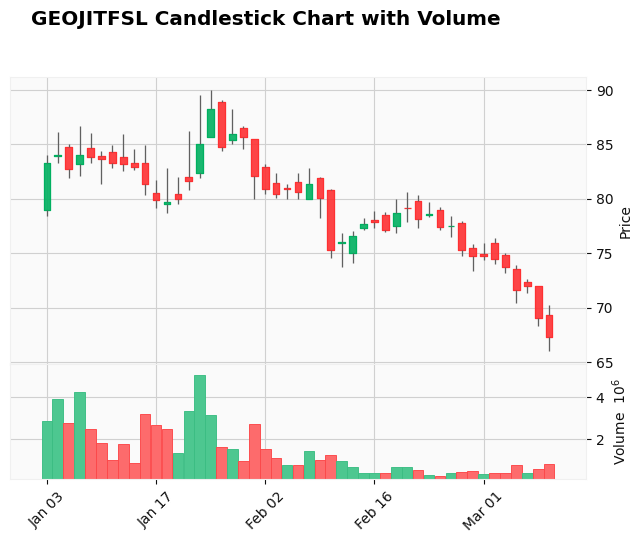

HSCL
2024-01-03 00:00:00


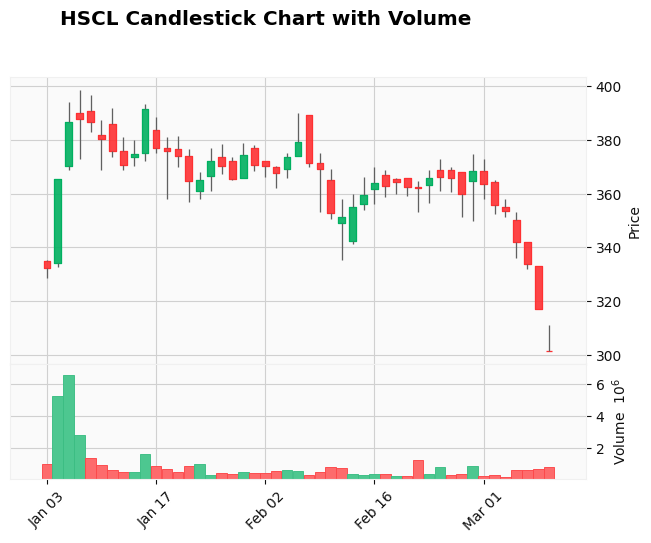

HINDZINC
2024-01-03 00:00:00


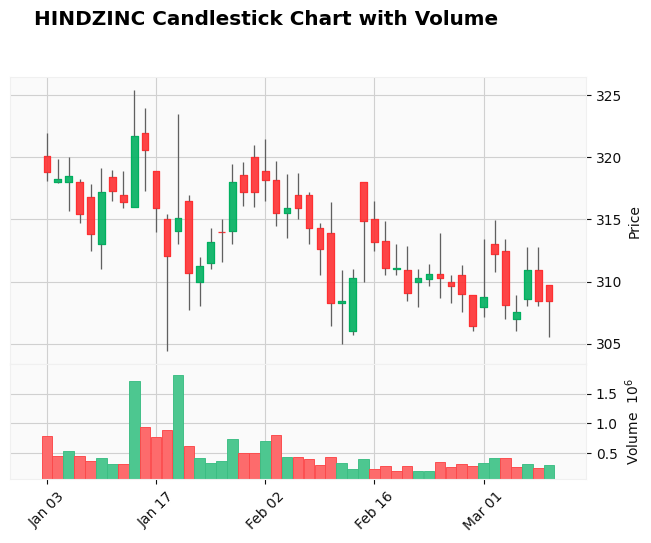

IGPL
2024-01-03 00:00:00


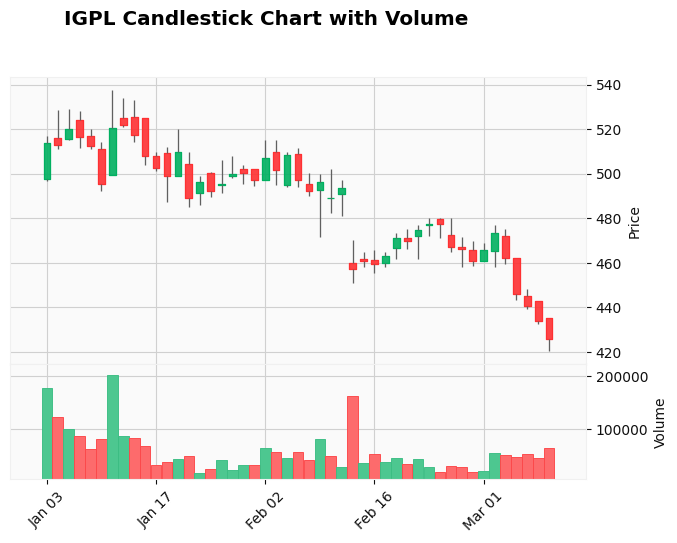

JTEKTINDIA
2024-01-03 00:00:00


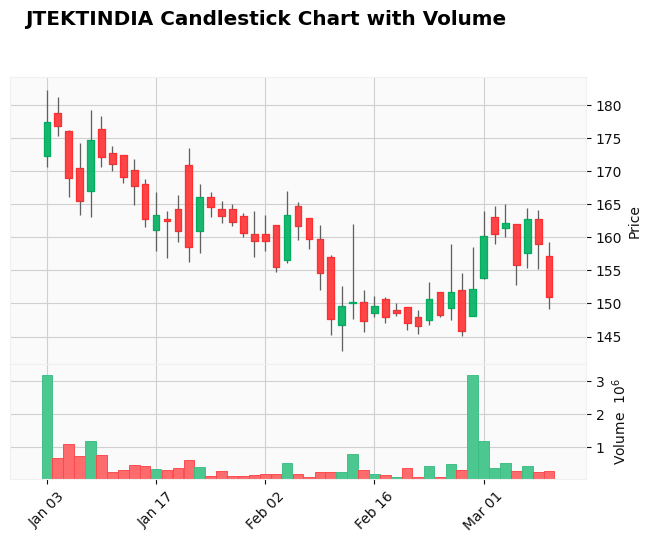

MANAPPURAM
2024-01-03 00:00:00


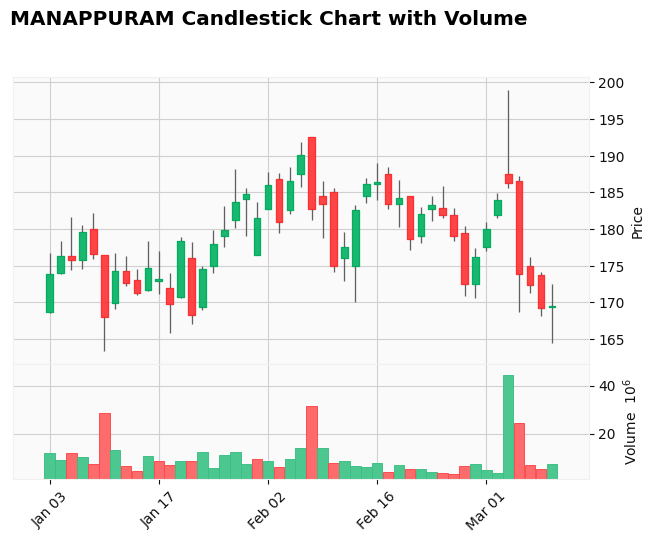

ONGC
2024-01-03 00:00:00


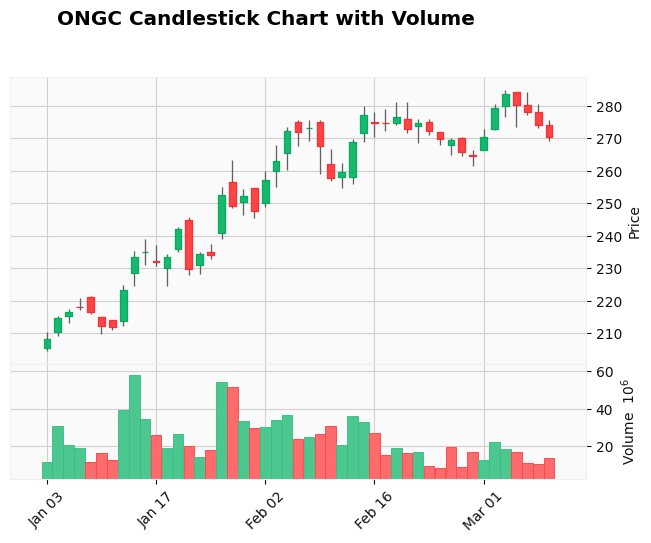

PETRONET
2024-01-03 00:00:00


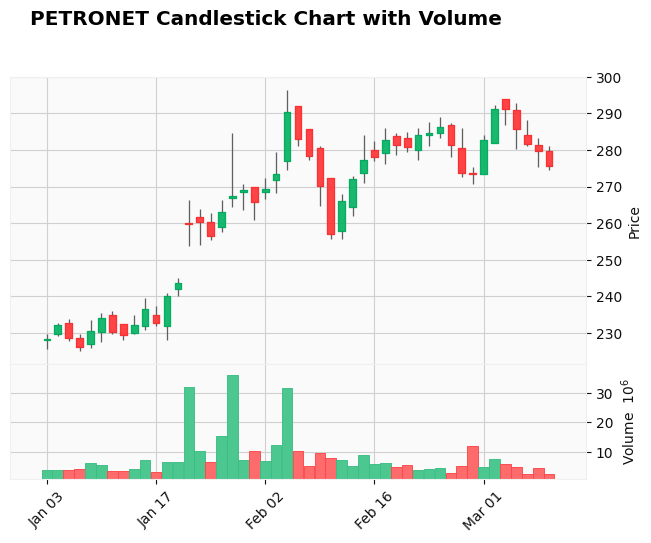

SBIN
2024-01-03 00:00:00


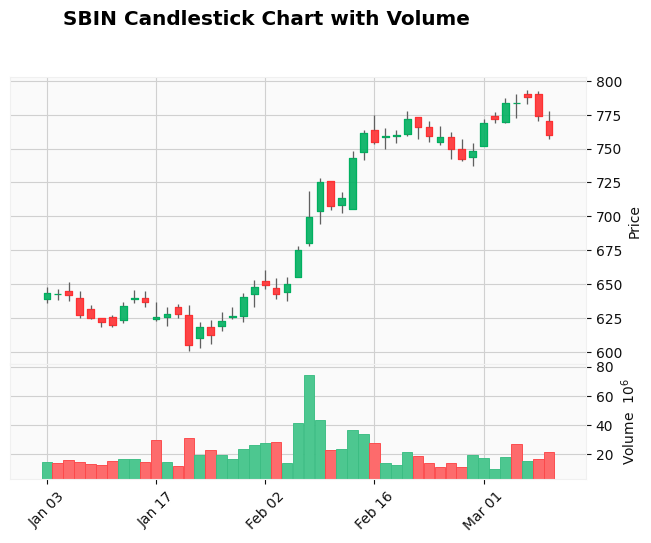

SWSOLAR
2024-01-03 00:00:00


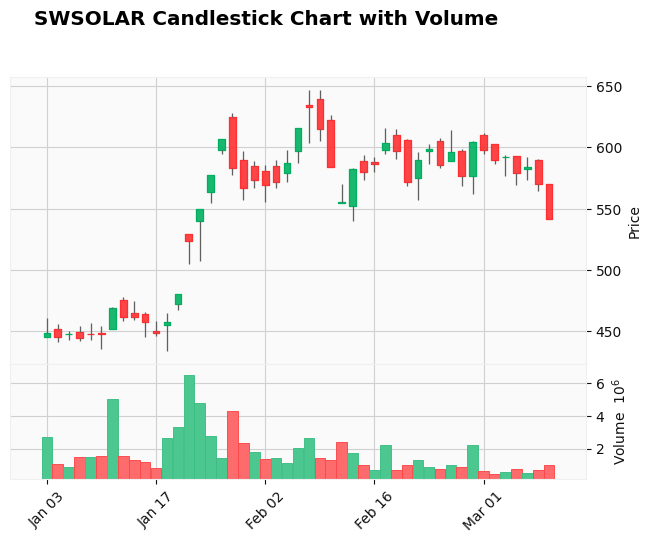

APLLTD
2024-01-02 00:00:00


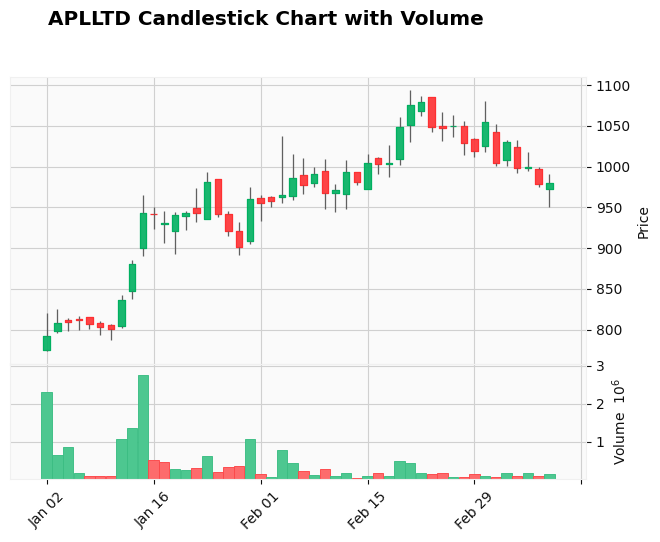

BEL
2024-01-02 00:00:00


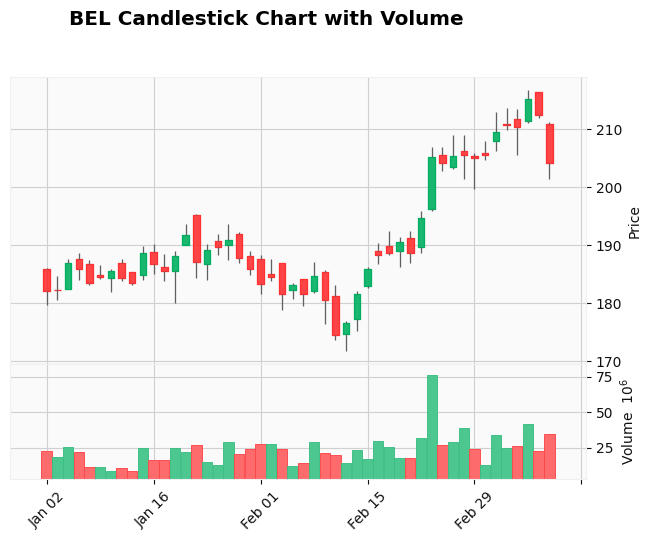

DALMIASUG
2024-01-02 00:00:00


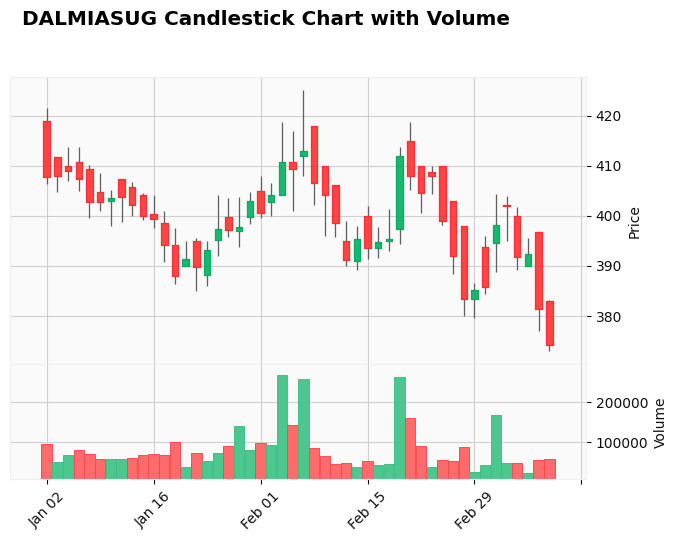

FEDERALBNK
2024-01-02 00:00:00


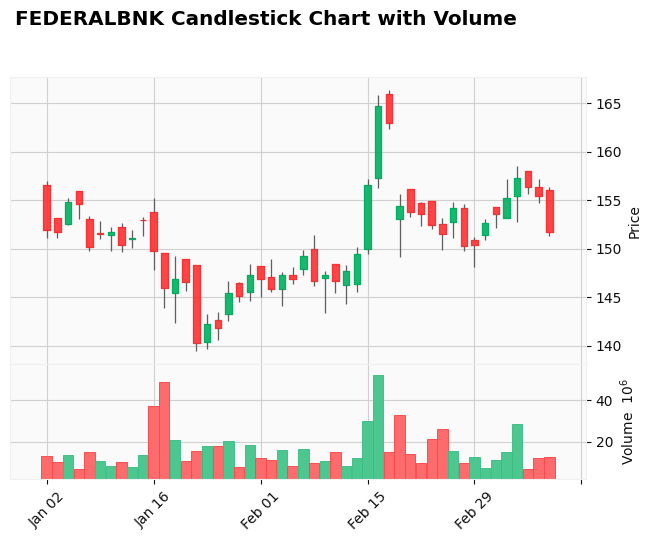

GEOJITFSL
2024-01-02 00:00:00


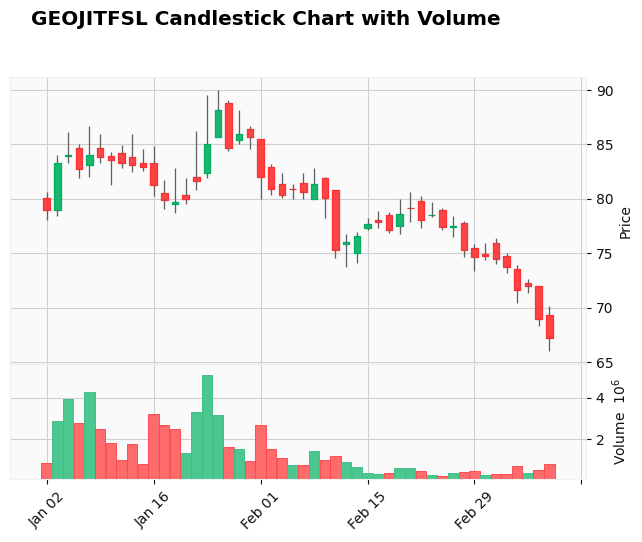

JSWSTEEL
2024-01-02 00:00:00


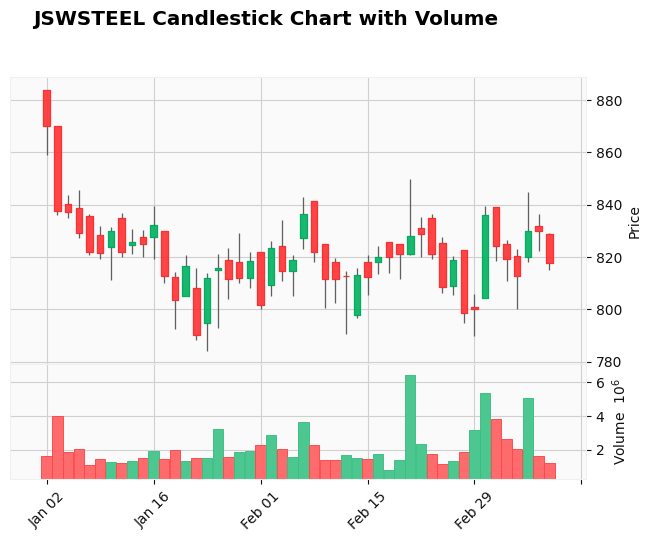

KARURVYSYA
2024-01-02 00:00:00


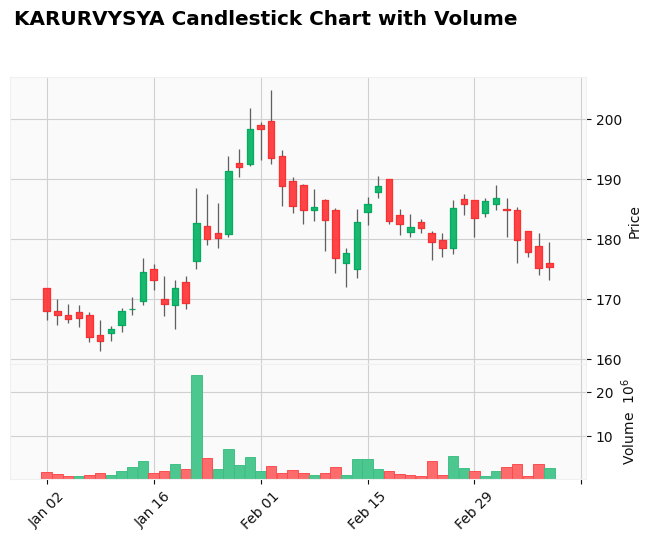

SBIN
2024-01-02 00:00:00


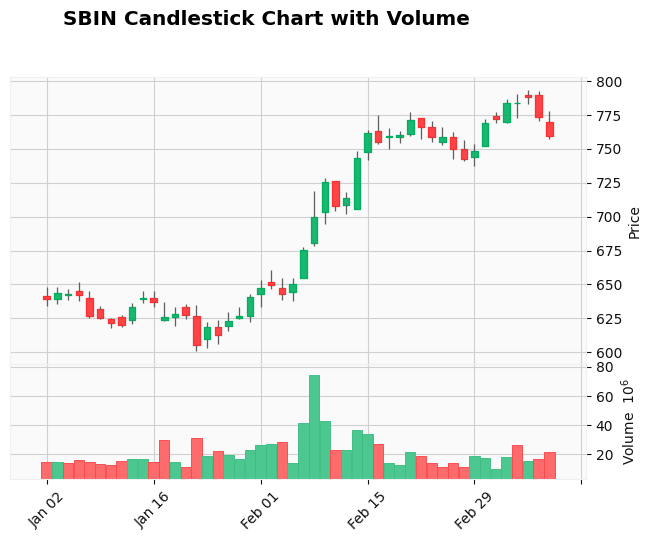

TRIL
2024-01-02 00:00:00


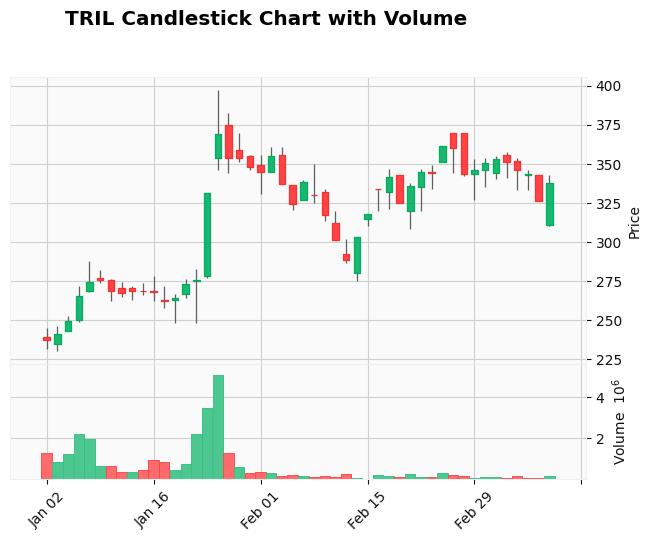

TVSMOTOR
2024-01-02 00:00:00


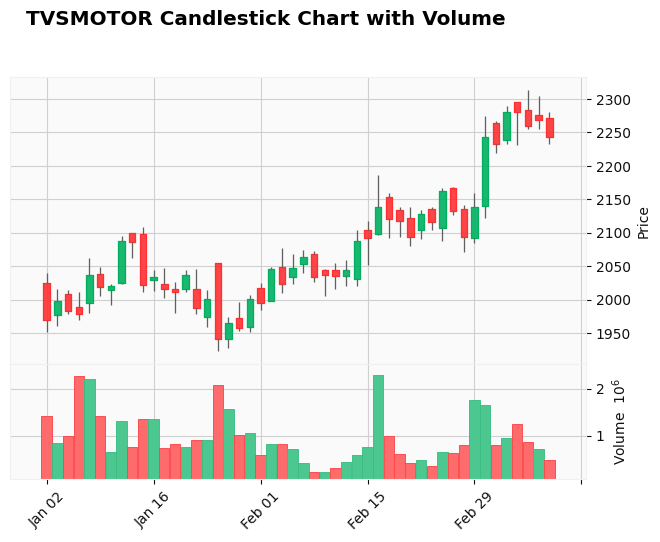

UBL
2024-01-02 00:00:00


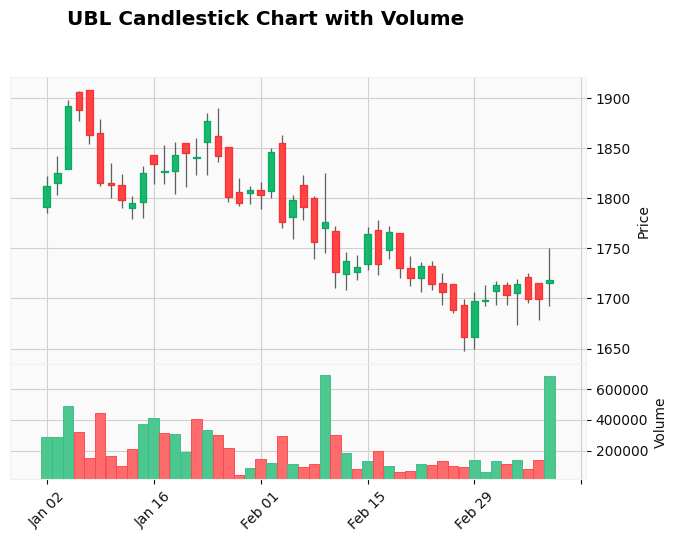

In [11]:
import mplfinance as mpf

# Iterate over stock_data_list
for stock_code, file_date, stock_data in stock_data_list:
    # Plot candlestick chart with volume
    print(stock_code)
    print(file_date)

    mpf.plot(stock_data, type='candle', volume=True, style='yahoo', title=f'{stock_code} Candlestick Chart with Volume')


C:\Users\91908\AppData\Local\Temp\ipykernel_16908\1179720172.py:184: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  merged_results[sheet_name] = pd.concat([merged_results[sheet_name], filtered_rows])
C:\Users\91908\AppData\Local\Temp\ipykernel_16908\1179720172.py:184: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  merged_results[sheet_name] = pd.concat([merged_results[sheet_name], filtered_rows])
C:\Users\91908\AppData\Local\Temp\ipykernel_16908\1179720172.py:184: FutureWarning: The behavior of Da


Sheet Name: Bulk Block Deals
+----------------------------------+-----------+--------------+------------+------------------------------------------------------------------------------------------------------+----------+-----------+----------+---------------------+---------------+------------+----------+-------------+------------------+-----------+-------------------+---------------------+---------------------+----------+
|              Stock               | Stock URL |     ISIN     |    Code    |                                             Client Name                                              | Exchange | Deal Type |  Action  |        Date         | Average Price |  Quantity  | Traded % | Close Price | Stock Deals Page | File Date | Last Traded Price | Percentage Traded % |     Stock Name      | Column12 |
+----------------------------------+-----------+--------------+------------+------------------------------------------------------------------------------------------------------

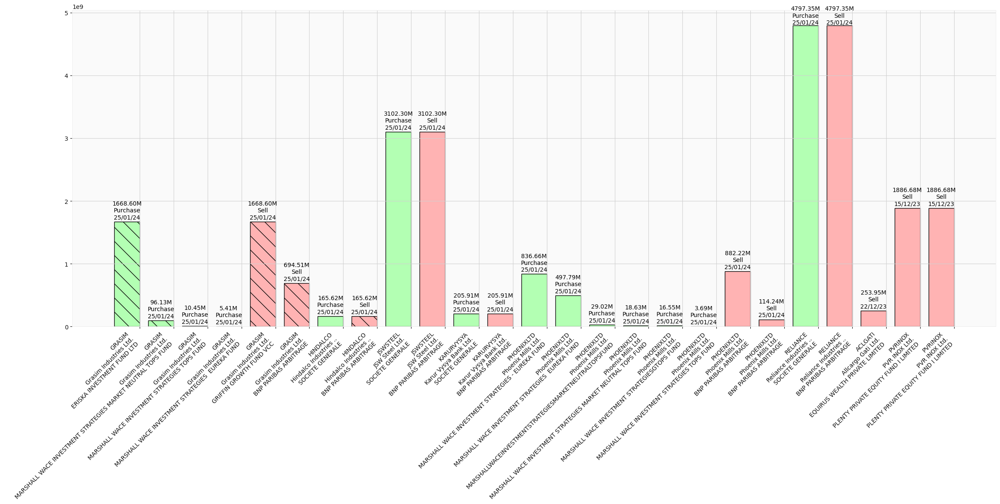

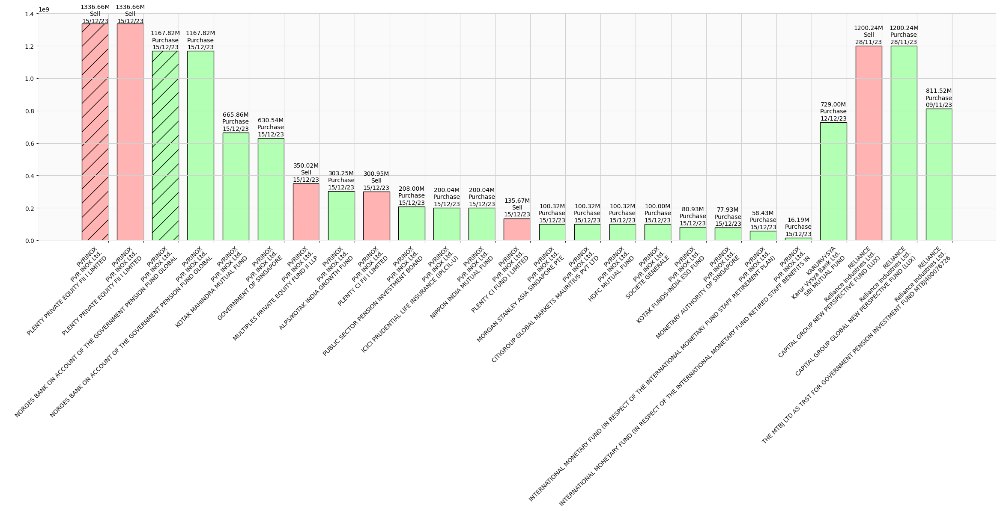

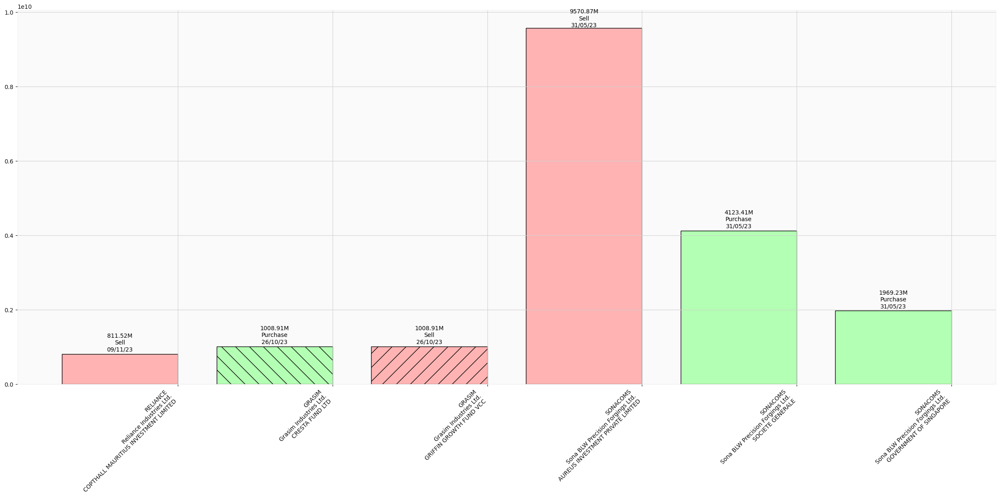

C:\Users\91908\AppData\Local\Temp\ipykernel_16908\1179720172.py:225: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  special_clients = sorted_rows[sorted_rows['Client Name'].astype(str).str.lower().str.contains('|'.join(clients_info['Client Code'].tolist()), na=False)]



Special Clients:
+----------------------------------+-----------+--------------+------------+---------------------------------------------------------------------------+----------+-----------+----------+---------------------+---------------+-----------+----------+-------------+------------------+-----------+-------------------+---------------------+---------------------+----------+
|              Stock               | Stock URL |     ISIN     |    Code    |                                Client Name                                | Exchange | Deal Type |  Action  |        Date         | Average Price | Quantity  | Traded % | Close Price | Stock Deals Page | File Date | Last Traded Price | Percentage Traded % |     Stock Name      | Column12 |
+----------------------------------+-----------+--------------+------------+---------------------------------------------------------------------------+----------+-----------+----------+---------------------+---------------+-----------+----------

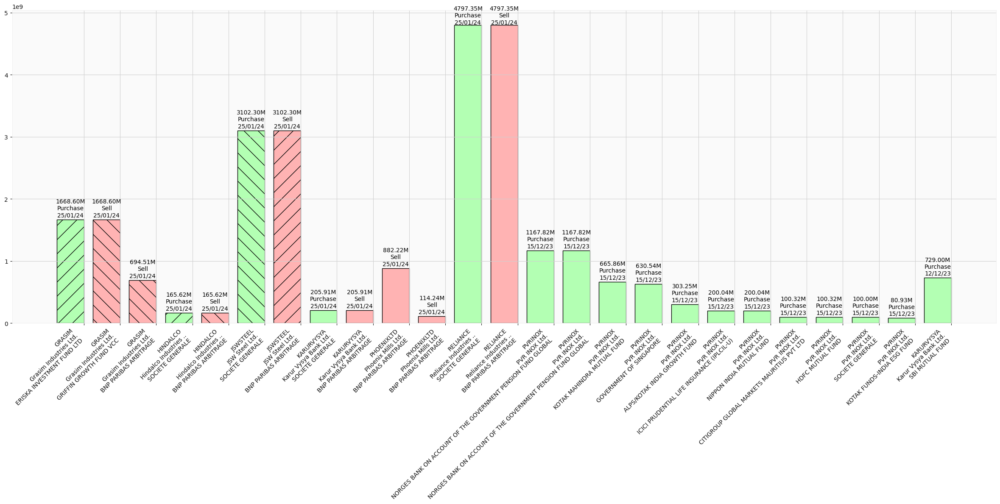

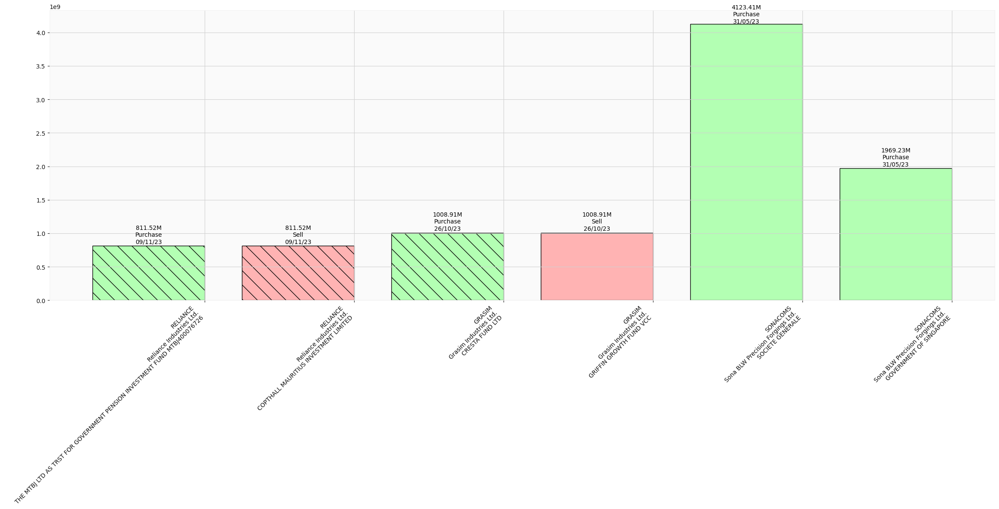


Sheet Name: Insider Disclosures
+-------------------------------+-----------+--------------+----------+------------------------------------------------------------------------------------------------------------------------------------------------------------------------+------------------------------+-------------+----------------------+-------------+--------------------------+-----------------------+------------+-------------------------+---------------+----------------------+-------------+------------------+-----------+-------------------+
|             Stock             | Stock URL |     ISIN     |   Code   |                                                                              Client Name                                                                               |       Client Category        |   Action    | Reported to Exchange |  Quantity   | Post Transaction Holding |       Traded %        | Avg. Price |         Period          | Security Type |         Mode         

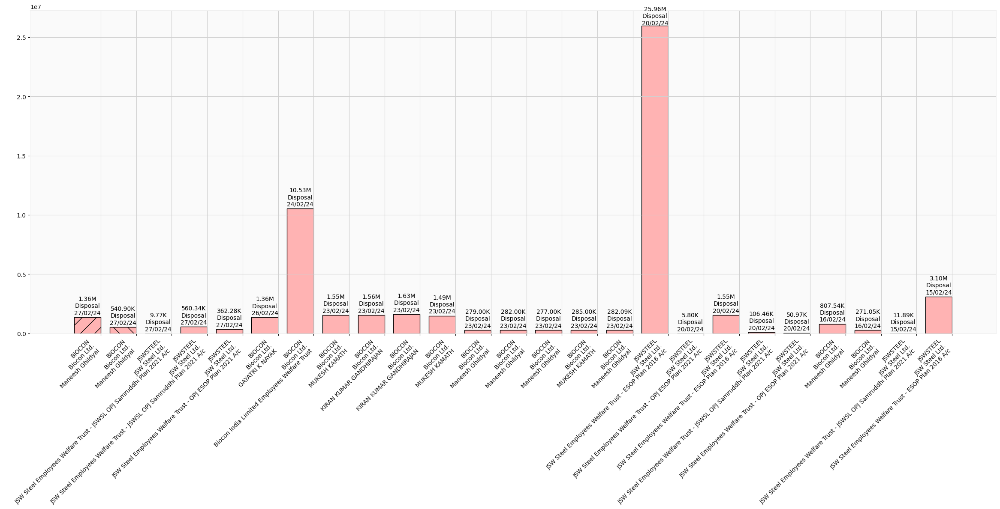

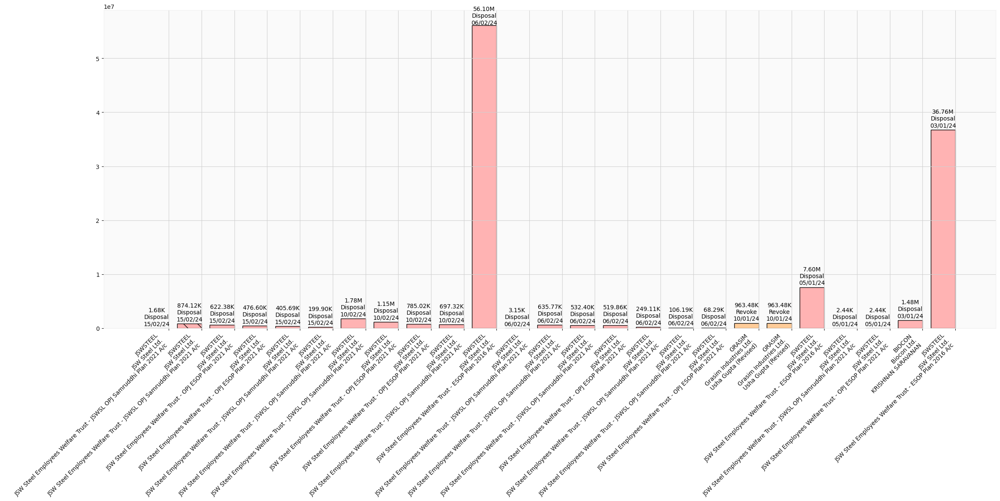

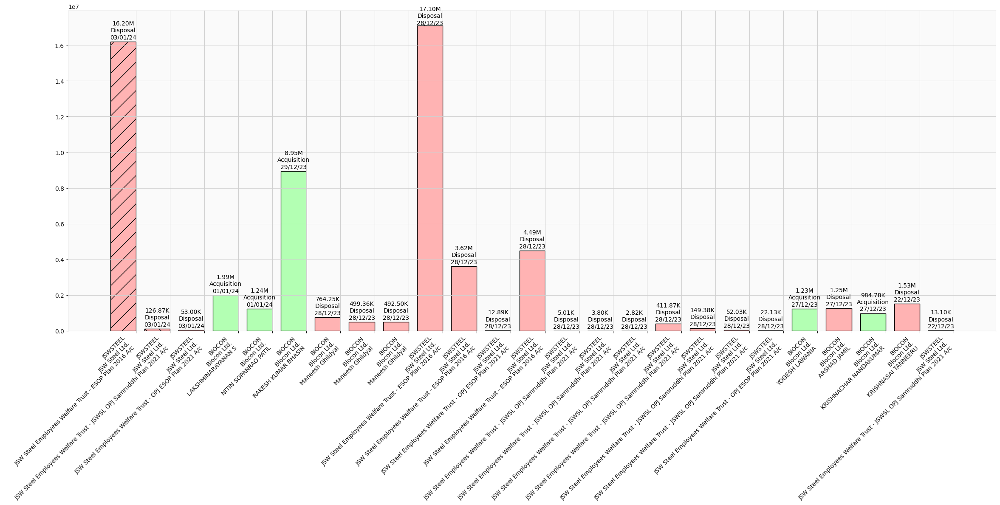

posx and posy should be finite values
posx and posy should be finite values


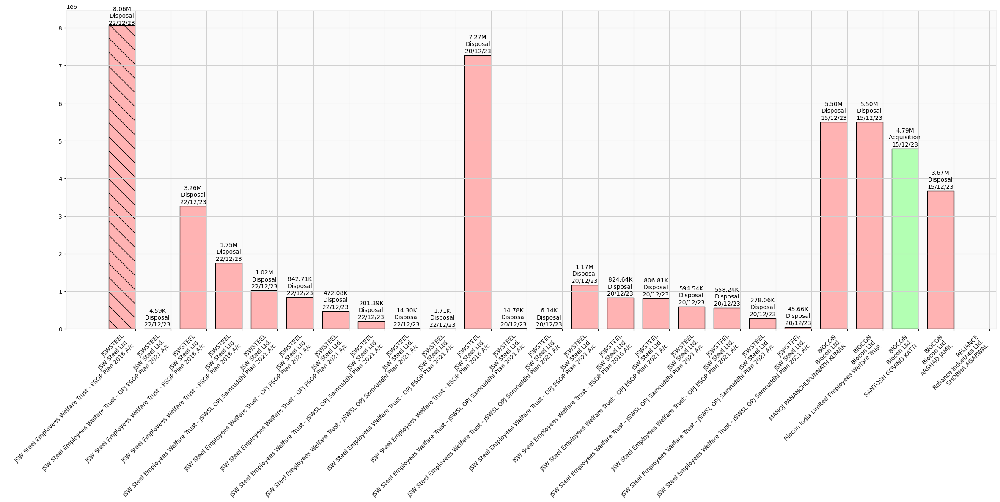

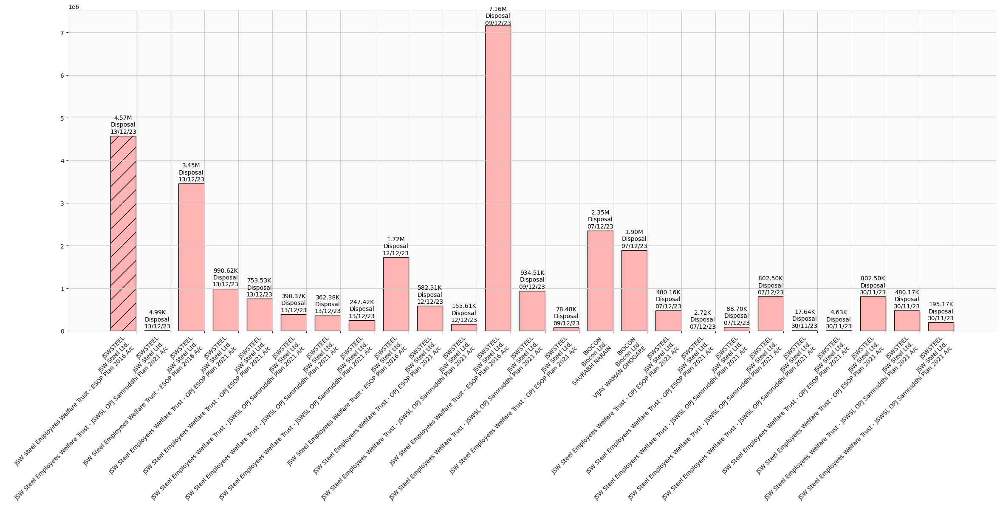

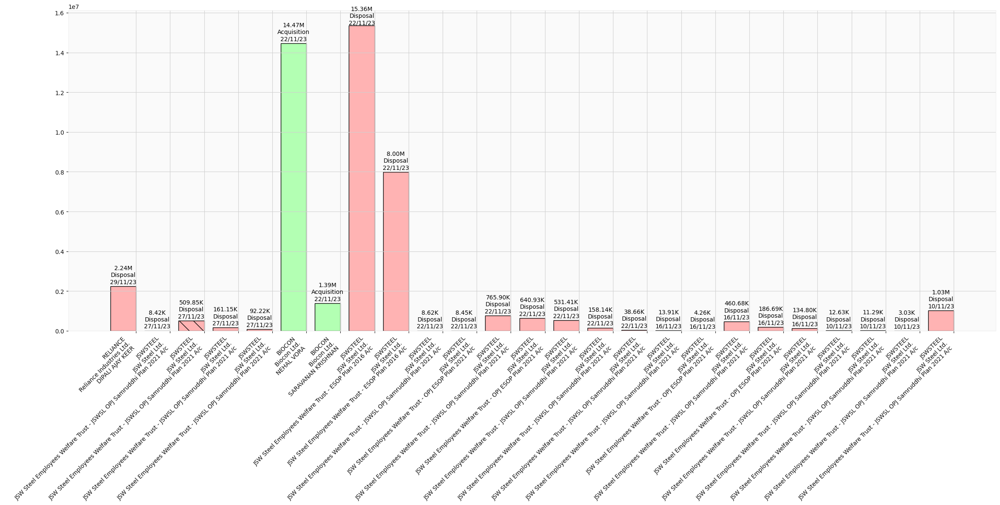

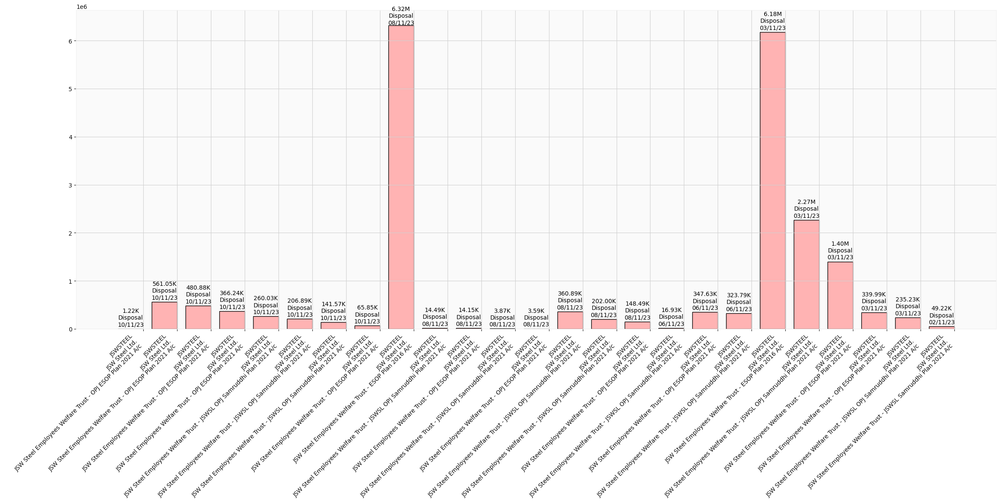

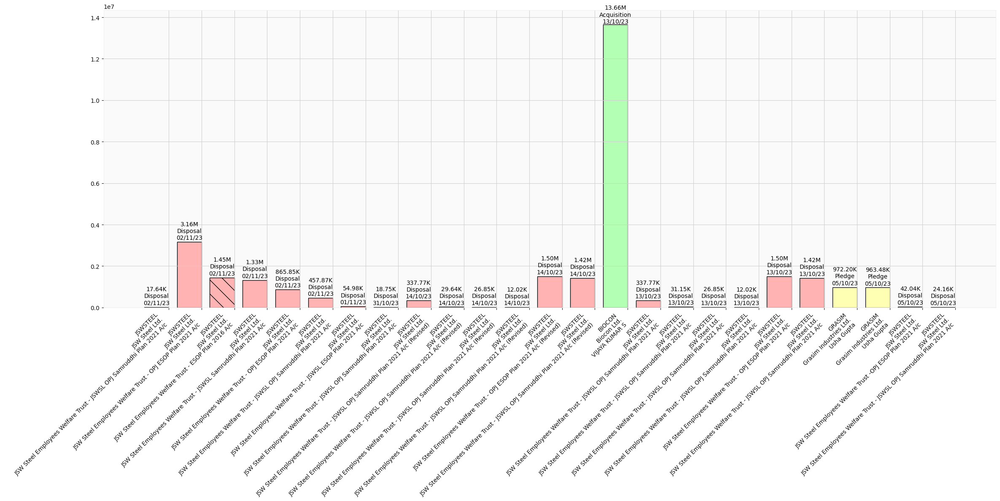

posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values


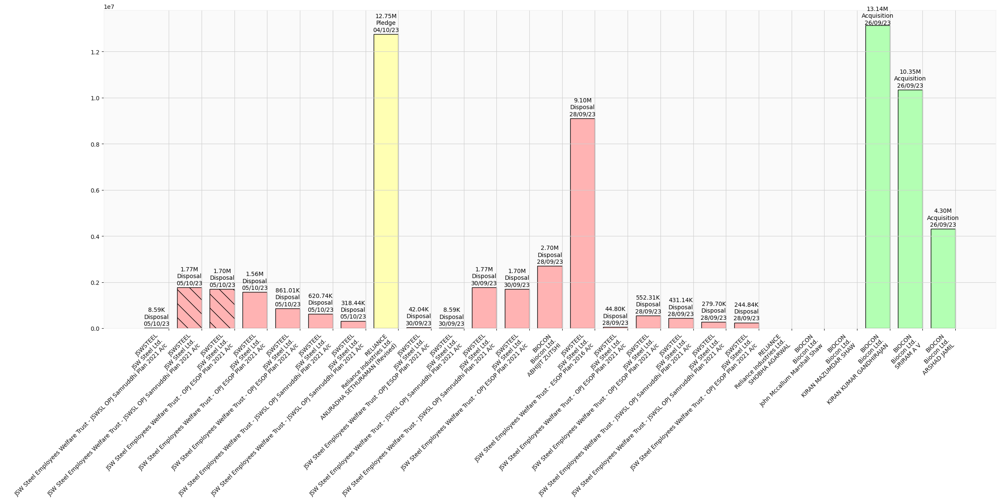

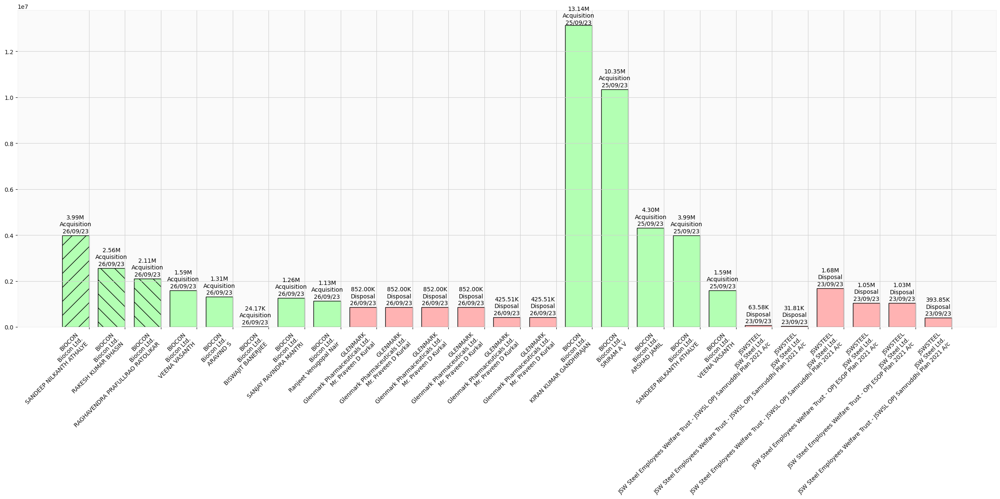

C:\Users\91908\AppData\Local\Temp\ipykernel_16908\1179720172.py:225: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  special_clients = sorted_rows[sorted_rows['Client Name'].astype(str).str.lower().str.contains('|'.join(clients_info['Client Code'].tolist()), na=False)]


No special clients present.

Sheet Name: SAST-Significant Acquisitions
+-----------------------------------------+-----------+--------------+------------+------------------------------------------------------------------------------------------------+-----------------+-------------+----------------------+-------------+--------------------------+----------+-------------------------+-----------------+-------------------+-------------+------------------+-----------+-------------------+
|                  Stock                  | Stock URL |     ISIN     |    Code    |                                          Client Name                                           | Client Category |   Action    | Reported to Exchange |  Quantity   | Post Transaction Holding | Traded % |         Period          | Regulation Type |       Mode        | Close Price | Stock Deals Page | File Date | Last Traded Price |
+-----------------------------------------+-----------+--------------+------------+------------

posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values


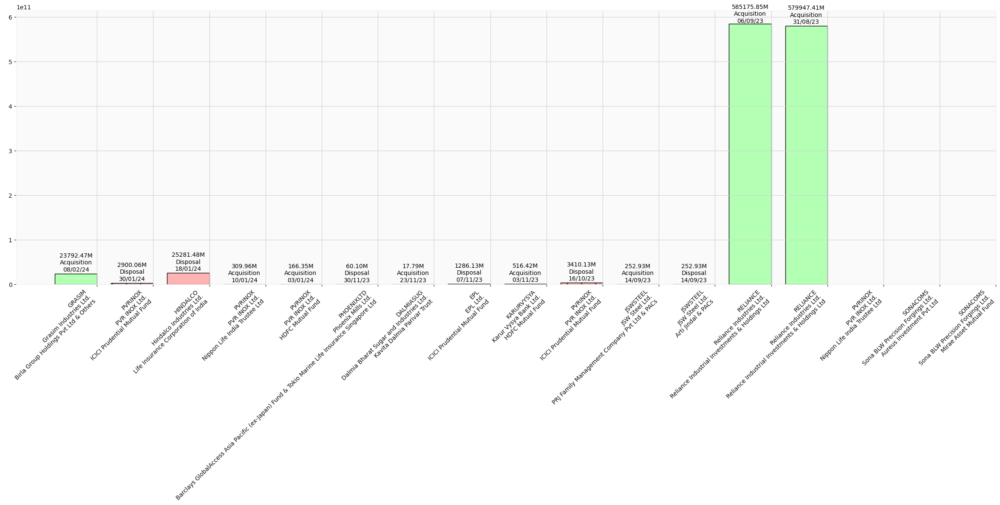

C:\Users\91908\AppData\Local\Temp\ipykernel_16908\1179720172.py:225: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  special_clients = sorted_rows[sorted_rows['Client Name'].astype(str).str.lower().str.contains('|'.join(clients_info['Client Code'].tolist()), na=False)]
posx and posy should be finite values



Special Clients:
+----------------------------------+-----------+--------------+------------+------------------------------------------------------------------------------------------------+-----------------+-------------+----------------------+-----------+--------------------------+----------+-------------------------+-----------------+--------+-------------+------------------+-----------+-------------------+
|              Stock               | Stock URL |     ISIN     |    Code    |                                          Client Name                                           | Client Category |   Action    | Reported to Exchange | Quantity  | Post Transaction Holding | Traded % |         Period          | Regulation Type |  Mode  | Close Price | Stock Deals Page | File Date | Last Traded Price |
+----------------------------------+-----------+--------------+------------+------------------------------------------------------------------------------------------------+---------------

posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values


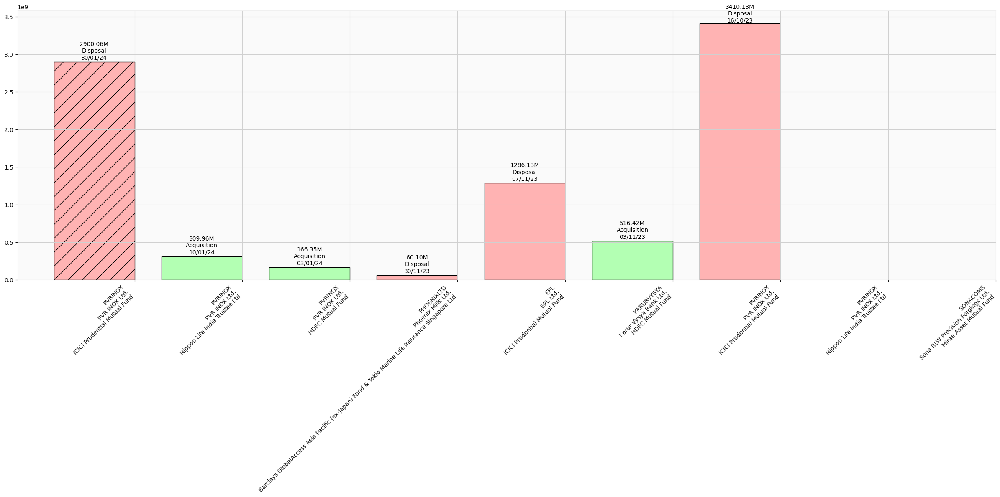

In [32]:
import os
import pandas as pd
from tabulate import tabulate
import smtplib
from email.mime.text import MIMEText
import matplotlib.pyplot as plt
import numpy as np
from datetime import datetime
import re

pd.set_option('mode.chained_assignment', None)


# Path to the Excel file with values to match
values_excel_path = r'C:\Users\91908\Documents\Raja\Share market\Analysis\Trendlyne\Data\Scrip\Scrip01022024.xlsx'

# Path to the folder with multiple Excel files
inbound_folder_path = r'C:\Users\91908\Documents\Raja\Share market\Analysis\Trendlyne\Data\Outbound'
outbound_folder_path = r'C:\Users\91908\Documents\Raja\Share market\Analysis\Trendlyne\Data\Outbound'

# Read values to match from the Excel file
values_df = pd.read_excel(values_excel_path)

# Extract the values from the relevant column (e.g., 'Scrip Code')
# values_to_match = values_df['Next 1000'].astype(str).str.lower().tolist()
# values_to_match = values_df['Scrip Code'].astype(str).str.lower().tolist()
# values_to_match = ['AAVAS']

first_cells = [data[0] for data in stock_data_list]
distinct_first_cells = list(set(first_cells))

values_to_match = distinct_first_cells



# print(values_to_match)
# Get a list of Excel files in the inbound folder
inbound_files = [os.path.join(inbound_folder_path, file) for file in os.listdir(inbound_folder_path) if file.endswith('.xlsx')]

# Your send_email function
def send_email(subject, body):
    # Configure email settings
    sender_email = "healthyplusrich@gmail.com"
    receiver_email = "akirabots@gmail.com"
    password = "password"

    # Create email message
    msg = MIMEText(body)
    msg['Subject'] = subject
    msg['From'] = sender_email
    msg['To'] = receiver_email

    # Send email
    try:
        # Send email
        with smtplib.SMTP('smtp.gmail.com', 587) as server:
            server.starttls()
            server.login(sender_email, password)
            server.sendmail(sender_email, receiver_email, msg.as_string())
            print("Email sent successfully")
    except Exception as e:
        print(f"Error sending email: {e}")

def display_top_transactions_charts(unique_action_row, max_charts=10):
    # Calculate the total number of charts
    rows_per_chart = 25  # You can adjust the value based on your requirements

    total_charts = int(np.ceil(len(unique_action_row) / rows_per_chart))

    # Iterate through the data and display a maximum of three charts for each set of 25 rows
    for chart_num in range(min(total_charts, max_charts)):
        start_index = chart_num * rows_per_chart
        end_index = (chart_num + 1) * rows_per_chart
        subset_data = unique_action_row.iloc[start_index:end_index]

        # Create a bar chart with unique patterns for bars with the same code
        plt.figure(figsize=(24, 12))
        
        # Adjust the width and spacing between bars
        width = 0.6
        spacing = 0.2

        # Define colors based on action
        mild_green = '#b3ffb3'  # Mild green color
        mild_red = '#ffb3b3'    # Mild red color
        mild_orange = '#ffcc99'  # Mild orange color
        mild_yellow = '#ffffb3'  # Mild yellow color

        colors = [
            mild_green if (isinstance(action, str) and action.lower() in ['acquisition', 'purchase']) else
            mild_red if (isinstance(action, str) and action.lower() in ['sell', 'disposal']) else
            mild_orange if (isinstance(action, str) and action.lower() == 'revoke') else
            mild_yellow for action in subset_data['Action']
        ]

        bars = plt.bar(np.arange(len(subset_data)) * (width + spacing), subset_data['Amount'], width=width, color=colors, edgecolor='black')

        # Display the 'Code' and 'Client Name' on the x-axis
        x_labels = [
            f"{code}\n{stock}\n{name}" 
            for code, stock, name,  in zip(subset_data['Code'],subset_data['Stock'], subset_data['Client Name'])
        ]
        
        # Center the labels between bars
        plt.xticks(np.arange(len(subset_data)) * (width + spacing) + width / 2, x_labels, rotation=45, ha='right')

        # Display the formatted amount, action, and file date on top of each bar
        for bar, amount, action, file_date in zip(bars, subset_data['Amount'], subset_data['Action'], subset_data['File Date']):
            formatted_amount = f'{amount / 1_000:.2f}K' if amount < 1_000_000 else f'{amount / 1_000_000:.2f}M'
            formatted_file_date = datetime.strptime(file_date, '%Y%m%d').strftime('%d/%m/%y')
            # Adjust the position calculation to ensure finite values
            position = min(bar.get_height() + 0.005 * max(subset_data['Amount']), max(subset_data['Amount']))

            plt.text(bar.get_x() + bar.get_width() / 2, position,
                     f'{formatted_amount}\n{action}\n{formatted_file_date}', ha='center', va='bottom')

        # Add unique patterns for bars with the same code
        unique_codes = subset_data['Code'].unique()
        for code, bar in zip(unique_codes, bars):
            indices = np.where(subset_data['Code'] == code)[0]
            if len(indices) > 1:
                for i, index in enumerate(indices):
                    bar.set_hatch('/')
                    if i % 2 == 1:
                        bar.set_hatch('\\')

        # Show the chart
        plt.tight_layout()
        plt.show()

def process_data(process_df, price_col='Average Price', quantity_col='Quantity'):
    # Calculate 'Amount' column

    process_df = process_df.copy()
    process_df['Amount'] = process_df[price_col] * process_df[quantity_col]

    # Get unique action rows
    unique_action_rows = process_df.groupby(['File Date', 'Code', 'Client Name']).filter(lambda x: x['Action'].nunique() == 1)
    print("Only Buy or Sell:")
    # print(tabulate(unique_action_rows, headers='keys', tablefmt='pretty', showindex=False))
    #Display Chart
    display_top_transactions_charts(unique_action_rows)

# Check if there are no files in the inbound folder
if not inbound_files:
    print("No files present in the inbound folder.")
else:
    # Dictionary to store results for each sheet name
    merged_results = {}

    # Iterate through each file
    for file_path in inbound_files:
        # Extract file date from the filename
        file_date = os.path.basename(file_path)[:8]
        # print(file_date)
        # Read all sheets from the Excel file into a dictionary of DataFrames
        dfs = pd.read_excel(file_path, sheet_name=None)
        # Iterate through each sheet
        # print("values_to_match")
        # print(values_to_match)
        for sheet_name, df in dfs.items():
            # Convert the fourth column to lowercase and filter rows
            # filtered_rows = df[df.iloc[:, 3].astype(str).str.lower().isin(map(str.lower, values_to_match))]
            filtered_rows = df[df['Code'].astype(str).str.lower().isin(map(str.lower, values_to_match))]

            #filtered_rows = df[df.iloc[:, 3].astype(str).str.lower().str.contains('|'.join(map(str.lower, values_to_match)))]
            #filtered_rows = df[df.iloc[:, 3].astype(str).str.lower().str.contains(r'\b(?:' + '|'.join(map(re.escape, map(str.lower, values_to_match))) + r')\b')]
            # print(df.iloc[:, 3].astype(str).str.lower())
            # Drop the specified columns
            # filtered_rows = filtered_rows.drop(columns=['Stock URL', 'ISIN', 'Stock Deals Page'])

            # Add a new column for file date | Modified for this error
            # filtered_rows['File Date'] = file_date Try using .loc[row_indexer,col_indexer] = value instead
            # print(filtered_rows)
           
            filtered_rows['File Date'] = file_date  # Below row was used but commented to check it is working for all files including 20240125-DailyDeals-Trendline
            # filtered_rows.loc[:, 'File Date'] = file_date

            # Check if the sheet name exists in the merged results dictionary
            if sheet_name not in merged_results:
                merged_results[sheet_name] = filtered_rows
            else:
                # Append the filtered rows to the existing sheet name
                merged_results[sheet_name] = pd.concat([merged_results[sheet_name], filtered_rows])
            


    # Display merged results
    for sheet_name, merged_df in merged_results.items():
        # Display the sheet name
        print(f"\nSheet Name: {sheet_name}")
    
        # Check if there are any rows in the merged result
        if not merged_df.empty:
            # Sort the result based on 'Code' and 'File Date'
            #sorted_rows = merged_df.sort_values(by=['Code', 'File Date'])
            sorted_rows = merged_df.sort_values(by=['File Date', 'Code'], ascending=[False, True])

            # Drop rows with NaN values in the 'code' column
            sorted_rows = sorted_rows.dropna(subset=['Code'])
            
            # Check if there are any rows left after dropping NaN values
            if not sorted_rows.empty:
                # Print the table if there are rows left
                # print(tabulate(sorted_rows, headers='keys', tablefmt='pretty', showindex=False))
            else:
                print("All rows have been dropped due to NaN values in 'code' column.")
            
            # Calculate the new column by multiplying "Average Price" and "Quantity" for 'Bulk Block Deals'
            if sheet_name == 'Bulk Block Deals':
                   process_data(sorted_rows, price_col='Average Price', quantity_col='Quantity')
            if sheet_name == 'Insider Disclosures':
                   process_data(sorted_rows, price_col='Avg. Price', quantity_col='Quantity')
            if sheet_name == 'SAST-Significant Acquisitions':
                   process_data(sorted_rows, price_col='Last Traded Price', quantity_col='Quantity')



            # Read the second sheet named 'Client' from Scrip.xlsx
            client_sheet_df = pd.read_excel(values_excel_path, sheet_name='Client', header=None, skiprows=1)
            clients_info = client_sheet_df.iloc[:, :2].rename(columns={0: 'Client Code', 1: 'Client Name'})
            clients_info['Client Code'] = clients_info['Client Code'].astype(str).str.lower()
    
            # Filter rows in sorted_rows where 'Client Name' partially matches 'Client Code' list
            special_clients = sorted_rows[sorted_rows['Client Name'].astype(str).str.lower().str.contains('|'.join(clients_info['Client Code'].tolist()), na=False)]
    
            # Send email with the result
            email_subject = f"Results for {sheet_name}"
            email_body = tabulate(sorted_rows, headers='keys', tablefmt='pretty', showindex=False)
            #send_email(email_subject, email_body)
    
            # # Move the file to the outbound folder after processing all sheets
            # outbound_file_path = os.path.join(outbound_folder_path, os.path.basename(file_path))
            # os.rename(file_path, outbound_file_path)
            # print(f"File moved to: {outbound_file_path}")
            
            # Display special clients in a separate tabular format
            if not special_clients.empty:
                print("\nSpecial Clients:")
                print(tabulate(special_clients, headers='keys', tablefmt='pretty', showindex=False))

                # Calculate the new column by multiplying "Average Price" and "Quantity" for 'Bulk Block Deals'
                if sheet_name == 'Bulk Block Deals':
                       process_data(special_clients, price_col='Average Price', quantity_col='Quantity')
                if sheet_name == 'Insider Disclosures':
                       process_data(special_clients, price_col='Avg. Price', quantity_col='Quantity')
                if sheet_name == 'SAST-Significant Acquisitions':
                       process_data(special_clients, price_col='Last Traded Price', quantity_col='Quantity')

                
                email_subject = f"Results for Special Client {sheet_name}"
                email_body = tabulate(special_clients, headers='keys', tablefmt='pretty', showindex=False)
                #send_email(email_subject, email_body)
                
            else:
                print("No special clients present.")
        else:
            print("No data present.")
pd.set_option('mode.chained_assignment', 'warn')
